The notebook uses the following references:
- https://github.com/udacity/deep-learning-v2-pytorch/blob/master/cycle-gan/CycleGAN_Solution.ipynb
- Machine Learning Mastery's implementation of Cycle GANs (from the book [Generative Adversarial Networks with Python](https://machinelearningmastery.com/generative_adversarial_networks/)).

In [1]:
%tensorflow_version 2.x

TensorFlow 2.x selected.


In [0]:
!wget https://gist.githubusercontent.com/sayakpaul/1e0f3ae671b62413d9ee98626a71f23d/raw/31df245ab4476db32563f6b86e3a22890df6e487/download_cyclegan_data.sh

In [0]:
!sh download_cyclegan_data.sh monet2photo

In [2]:
!ls monet2photo/

testA  testB  trainA  trainB


In [0]:
!apt-get install tree

In [3]:
!tree --dirsfirst --filelimit 10 monet2photo

monet2photo
├── testA [121 entries exceeds filelimit, not opening dir]
├── testB [751 entries exceeds filelimit, not opening dir]
├── trainA [1072 entries exceeds filelimit, not opening dir]
└── trainB [6287 entries exceeds filelimit, not opening dir]

4 directories, 0 files


In [0]:
# imports
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from os import listdir
import numpy as np
from tqdm import tqdm

In [0]:
# load all images in a directory into memory
def load_images(path, size=(128,128)):
    data_list = list()
    
    # enumerate filenames in directory, assume all are images
    for filename in tqdm(listdir(path)):
        # load and resize the image
        pixels = load_img(path + filename, target_size=size)
        # convert to numpy array
        pixels = img_to_array(pixels)
        # store
        data_list.append(pixels)
    
    return np.array(data_list)

In [6]:
# dataset path
path = "monet2photo/"

# load dataset A
dataA1 = load_images(path + "trainA/") 
dataA2 = load_images(path + "testA/") 
dataA = np.concatenate([dataA1, dataA2])
print("Loaded dataA: ", dataA.shape)

# load dataset B
dataB1 = load_images(path + "trainB/") 
dataB2 = load_images(path + "testB/") 
dataB = np.concatenate([dataB1, dataB2])
print("Loaded dataB: ", dataB.shape)

  1%|          | 63/6287 [00:00<00:10, 621.88it/s]

Loaded dataA:  (1193, 128, 128, 3)


100%|██████████| 751/751 [00:01<00:00, 677.06it/s]


Loaded dataB:  (7038, 128, 128, 3)


In [0]:
import matplotlib.pyplot as plt

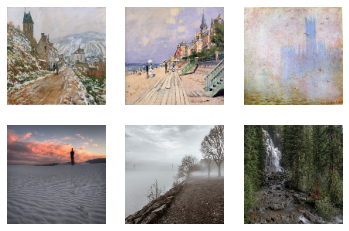

In [8]:
n_samples = 3

# plot source images
for i in range(n_samples): 
    plt.subplot(2, n_samples, 1 + i) 
    plt.axis("off") 
    plt.imshow(dataA[i].astype("int"))
 
# plot target image
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + n_samples + i) 
    plt.axis("off") 
    plt.imshow(dataB[i].astype("int"))   

In [0]:
# needed for instance normalization
!pip install -q  --no-deps tensorflow-addons~=0.7

In [0]:
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.optimizers import *
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import tensorflow_addons as tfa

In [0]:
# define the discriminator model
def define_discriminator(image_shape):
    # source image input
    in_image = Input(shape=image_shape)

    # init
    init = RandomNormal(stddev=0.02)
    
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(in_image)
    d = LeakyReLU(alpha=0.2)(d)

    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)

    # second last output layer
    d = Conv2D(512, (4,4), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)

    # patch output
    patch_out = Conv2D(1, (4,4), padding="same", kernel_initializer=init)(d) 
    
    # define model
    model = Model(in_image, patch_out)
    
    return model 

In [0]:
# generator a resnet block
def resnet_block(n_filters, input_layer):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # first layer convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(input_layer) 
    g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
    g = Activation("relu")(g)
    
    # second convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(g) 
    g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
    
    # concatenate merge channel-wise with input layer
    g = Concatenate()([g, input_layer])
    
    return g

In [0]:
# define the standalone generator model
def define_generator(image_shape=(256,256,3), n_resnet=6):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# image input
	in_image = Input(shape=image_shape)

	# c7s1-64
	g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# d128
	g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# d256
	g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# R256
	for _ in range(n_resnet):
		g = resnet_block(256, g)

	# u128
	g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# u64
	g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# c7s1-3
	g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	out_image = Activation('tanh')(g)

	# define model
	model = Model(in_image, out_image)

	return model

In [13]:
# discriminator
discriminator = define_discriminator((128,128,3))
discriminator.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 128)       131200    
_________________________________________________________________
instance_normalization (Inst (None, 32, 32, 128)       256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 256)       524544

In [14]:
# generator
generator = define_generator()
generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 256, 256, 64) 9472        input_2[0][0]                    
__________________________________________________________________________________________________
instance_normalization_4 (Insta (None, 256, 256, 64) 128         conv2d_6[0][0]                   
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 64) 0           instance_normalization_4[0][0]   
____________________________________________________________________________________________

In [0]:
# # output omitted for brevity
# from tensorflow.keras.utils import plot_model
# plot_model(discriminator, "discriminator.png", show_shapes=True)
# plot_model(generator, "generator.png", show_shapes=True)

In [0]:
# input shape
image_shape = (128, 128, 3)

# generator: A -> B
g_model_AtoB = define_generator(image_shape, n_resnet=6)
# generator: B -> A
g_model_BtoA = define_generator(image_shape, n_resnet=6)

# discriminator: A -> [real/fake]
d_model_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_model_B = define_discriminator(image_shape)

In [0]:
import tensorflow as tf

In [0]:
def real_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "real"?
    # label for real is 1
    ones = tf.ones_like(len(D_out), dtype=tf.float32)
    return mse(D_out, ones)

def fake_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "fake"?
    # label for fake is 0
    zeros = tf.zeros_like(len(D_out), dtype=tf.float32)
    return mse(D_out, zeros)

def cycle_consistency_loss(real_im, reconstructed_im, lambda_weight):
    mae = tf.keras.losses.MeanAbsoluteError()
    # calculate reconstruction loss 
    # as absolute value difference between the real and reconstructed images
    reconstr_loss = mae(real_im, reconstructed_im)
    # return weighted loss
    return lambda_weight*reconstr_loss 

In [0]:
# these values come from the original paper
###########################################

# hyperparams for Adam optimizer
lr=0.0002
beta1=0.5
beta2=0.999 # default value

# create optimizers for the generators and discriminators
g_AtoB_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
g_BtoA_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_A_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_B_opt = Adam(lr, beta_1=beta1, beta_2=beta2)

In [0]:
@tf.function
def train_discriminator_A(dA, gBA, images_B, images_A, d_model_A_opt):
    with tf.GradientTape() as tape:
        # discriminator A
        dA_real_logits = dA(images_A)
        dA_real_loss = real_mse_loss(dA_real_logits)

        # discriminator A on fake stuff
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        dA_fake_loss = fake_mse_loss(dA_fake_logits)

        # total dA loss
        total_dA_loss = dA_real_loss + dA_fake_loss

    # compute gradients and backprop
    dA_grads = tape.gradient(total_dA_loss, dA.trainable_variables)
    d_model_A_opt.apply_gradients(zip(dA_grads, dA.trainable_variables))

    return total_dA_loss

# <-------------------------------------------------------------------->

@tf.function
def train_discriminator_B(dB, gAB, images_A, images_B, d_model_B_opt):
    with tf.GradientTape() as tape:
        # discriminator B
        dB_real_logits = dB(images_B)
        dB_real_loss = real_mse_loss(dB_real_logits)

        # discriminator B on fake stuff
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        dB_fake_loss = fake_mse_loss(dB_fake_logits)

        # total dA loss
        total_dB_loss = dB_real_loss + dB_fake_loss

    # compute gradients and backprop
    dB_grads = tape.gradient(total_dB_loss, dB.trainable_variables)
    d_model_B_opt.apply_gradients(zip(dB_grads, dB.trainable_variables))

    return total_dB_loss

In [0]:
@tf.function
def train_generator_AB(dB, gAB, gBA, images_A, images_B, g_AtoB_opt):
    ###### Generator AB ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain A to domain B, compute loss (weight 1) via
        # discriminator B
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        gAB_loss = real_mse_loss(dB_fake_logits)

        # identity loss (weight 5)
        identity_B = gAB(images_B)
        id_loss = cycle_consistency_loss(images_B, identity_B, 5)

        # cycle consistency loss (weight 10)
        reconstructed_A = gBA(fake_B)
        reconstructed_A_loss = cycle_consistency_loss(images_A, reconstructed_A, 10)

        # total loss
        total_gAB_loss = gAB_loss + id_loss + reconstructed_A_loss
    
    # compute gradients and backprop
    gAB_grads = tape.gradient(total_gAB_loss, gAB.trainable_variables)
    g_AtoB_opt.apply_gradients(zip(gAB_grads, gAB.trainable_variables))

    return total_gAB_loss
    
# <-------------------------------------------------------------------->

@tf.function
def train_generator_BA(dA, gBA, gAB, images_B, images_A, g_BtoA_opt):
    ###### Generator BA ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain B to domain A, compute loss (weight 1) via
        # discriminator A
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        gBA_loss = real_mse_loss(dA_fake_logits)

        # identity loss (weight 5)
        identity_A = gBA(images_A)
        id_loss = cycle_consistency_loss(images_A, identity_A, 5)

        # cycle consistency loss (weight 10)
        reconstructed_B = gAB(fake_A)
        reconstructed_B_loss = cycle_consistency_loss(images_B, reconstructed_B, 10)

        # total loss
        total_gBA_loss = gBA_loss + id_loss + reconstructed_B_loss
    
    # compute gradients and backprop
    gBA_grads = tape.gradient(total_gBA_loss, gBA.trainable_variables)
    g_BtoA_opt.apply_gradients(zip(gBA_grads, gBA.trainable_variables))

    return total_gBA_loss

In [0]:
# # check if everything works (should be run only once)

# sample_Images_A = dataA[32].reshape(1, 128, 128, 3)
# sample_Images_B = dataB[32].reshape(1, 128, 128, 3)

# print(train_discriminator_A(d_model_A, g_model_BtoA, sample_Images_B, sample_Images_A, d_model_A_opt))
# print(train_discriminator_B(d_model_B, g_model_AtoB, sample_Images_A, sample_Images_B, d_model_B_opt))

# print(train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, sample_Images_A, sample_Images_B, g_AtoB_opt))
# print(train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, sample_Images_B, sample_Images_A, g_BtoA_opt))

In [0]:
# select a random sample of images from the dataset
def select_sample(dataset, n_samples):
	# choose random instances
	ix = np.random.randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	return X

# plot the image, the translation, and the reconstruction
def show_plot(imagesX, imagesY1, imagesY2):
	images = np.vstack((imagesX, imagesY1, imagesY2))
	titles = ['Real', 'Generated', 'Reconstructed']
	# scale from [-1,1] to [0,1]
	images = (images + 1) / 2.0
	# plot images row by row
	for i in range(len(images)):
		# define subplot
		plt.subplot(1, len(images), 1 + i)
		# turn off axis
		plt.axis('off')
		# plot raw pixel data
		plt.imshow(images[i])
		# title
		plt.title(titles[i])
	plt.show()
 
def show_model_progress(gAB, gBA, dataA, dataB):
	# A -> B -> A
	print("[INFO] Domain A to Domain B")
	real_A = select_sample(dataA, 1)
	B_generated  = gAB.predict(real_A)
	A_reconstructed = gBA.predict(B_generated)
	show_plot(real_A, B_generated, A_reconstructed)

	# B -> A -> B
	print("[INFO] Domain B to Domain A")
	real_B = select_sample(dataB, 1)
	A_generated  = gBA.predict(real_B)
	B_reconstructed = gAB.predict(A_generated)
	show_plot(real_B, A_generated, B_reconstructed)

In [0]:
# scale data to ([-1, 1]) and convert to TF Dataset
scaled_dataA = (dataA - 127.5) / 127.5
scaled_dataB = (dataB - 127.5) / 127.5
data_A_TF = tf.data.Dataset.from_tensor_slices(scaled_dataA).batch(16).prefetch(100)
data_B_TF = tf.data.Dataset.from_tensor_slices(scaled_dataB).batch(16).prefetch(100)

In [0]:
# metrics to keep track of the mean loss for each epoch
gen_AB_metric = tf.keras.metrics.Mean()
gen_BA_metric = tf.keras.metrics.Mean()
disc_A_metric = tf.keras.metrics.Mean()
disc_B_metric = tf.keras.metrics.Mean()

In [24]:
!nvidia-smi

Thu Mar 26 12:32:11 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P0    33W / 250W |    871MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
# constants
visualize_every = 50
epochs = 100
steps_per_epoch = min(len(dataA)//16, len(dataB)//16)

  0%|          | 0/100 [00:00<?, ?it/s]

epoch: 0 step: 0 dA_loss: 1.057 dB_loss: 1.173 gAB_loss :7.314 gBA_loss: 7.549
[INFO] Domain A to Domain B


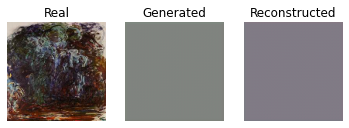

[INFO] Domain B to Domain A


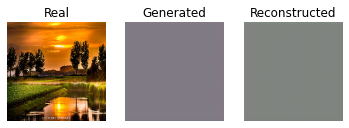

epoch: 0 step: 1 dA_loss: 0.953 dB_loss: 1.052 gAB_loss :7.338 gBA_loss: 7.778
epoch: 0 step: 2 dA_loss: 0.873 dB_loss: 0.952 gAB_loss :7.097 gBA_loss: 7.455
epoch: 0 step: 3 dA_loss: 0.809 dB_loss: 0.871 gAB_loss :6.967 gBA_loss: 7.515
epoch: 0 step: 4 dA_loss: 0.749 dB_loss: 0.806 gAB_loss :6.422 gBA_loss: 7.043
epoch: 0 step: 5 dA_loss: 0.705 dB_loss: 0.752 gAB_loss :7.206 gBA_loss: 7.756
epoch: 0 step: 6 dA_loss: 0.665 dB_loss: 0.707 gAB_loss :6.408 gBA_loss: 6.864
epoch: 0 step: 7 dA_loss: 0.633 dB_loss: 0.669 gAB_loss :7.327 gBA_loss: 7.788
epoch: 0 step: 8 dA_loss: 0.606 dB_loss: 0.632 gAB_loss :6.797 gBA_loss: 7.502
epoch: 0 step: 9 dA_loss: 0.585 dB_loss: 0.608 gAB_loss :6.956 gBA_loss: 7.169
epoch: 0 step: 10 dA_loss: 0.567 dB_loss: 0.585 gAB_loss :7.072 gBA_loss: 7.260
epoch: 0 step: 11 dA_loss: 0.550 dB_loss: 0.568 gAB_loss :6.661 gBA_loss: 6.916
epoch: 0 step: 12 dA_loss: 0.539 dB_loss: 0.553 gAB_loss :6.955 gBA_loss: 7.342
epoch: 0 step: 13 dA_loss: 0.528 dB_loss: 0.540 g

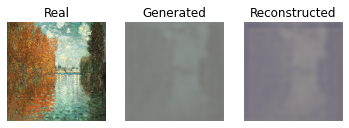

[INFO] Domain B to Domain A


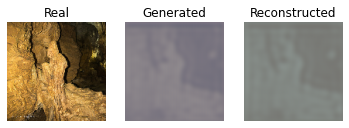

epoch: 0 step: 51 dA_loss: 0.059 dB_loss: 0.053 gAB_loss :6.701 gBA_loss: 6.948
epoch: 0 step: 52 dA_loss: 0.044 dB_loss: 0.044 gAB_loss :7.002 gBA_loss: 7.129
epoch: 0 step: 53 dA_loss: 0.038 dB_loss: 0.039 gAB_loss :6.561 gBA_loss: 7.341
epoch: 0 step: 54 dA_loss: 0.032 dB_loss: 0.034 gAB_loss :6.510 gBA_loss: 7.390
epoch: 0 step: 55 dA_loss: 0.030 dB_loss: 0.034 gAB_loss :6.832 gBA_loss: 7.212
epoch: 0 step: 56 dA_loss: 0.024 dB_loss: 0.028 gAB_loss :6.936 gBA_loss: 7.390
epoch: 0 step: 57 dA_loss: 0.024 dB_loss: 0.023 gAB_loss :6.672 gBA_loss: 7.241
epoch: 0 step: 58 dA_loss: 0.021 dB_loss: 0.021 gAB_loss :6.777 gBA_loss: 7.263
epoch: 0 step: 59 dA_loss: 0.017 dB_loss: 0.017 gAB_loss :6.617 gBA_loss: 7.276
epoch: 0 step: 60 dA_loss: 0.015 dB_loss: 0.016 gAB_loss :7.162 gBA_loss: 7.596
epoch: 0 step: 61 dA_loss: 0.013 dB_loss: 0.016 gAB_loss :6.902 gBA_loss: 6.867
epoch: 0 step: 62 dA_loss: 0.012 dB_loss: 0.012 gAB_loss :6.962 gBA_loss: 7.302
epoch: 0 step: 63 dA_loss: 0.010 dB_loss

  1%|          | 1/100 [02:07<3:31:02, 127.91s/it]

epoch: 0 step: 73 dA_loss: 0.009 dB_loss: 0.007 gAB_loss :7.196 gBA_loss: 7.811
epoch: 1 step: 0 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :6.758 gBA_loss: 7.083
[INFO] Domain A to Domain B


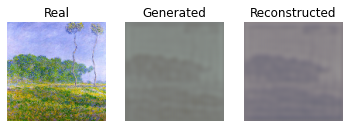

[INFO] Domain B to Domain A


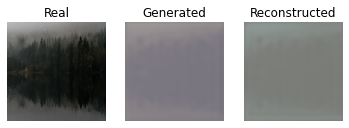

epoch: 1 step: 1 dA_loss: 0.006 dB_loss: 0.004 gAB_loss :6.820 gBA_loss: 7.372
epoch: 1 step: 2 dA_loss: 0.007 dB_loss: 0.004 gAB_loss :6.710 gBA_loss: 7.151
epoch: 1 step: 3 dA_loss: 0.011 dB_loss: 0.003 gAB_loss :6.680 gBA_loss: 7.295
epoch: 1 step: 4 dA_loss: 0.014 dB_loss: 0.003 gAB_loss :6.211 gBA_loss: 6.882
epoch: 1 step: 5 dA_loss: 0.005 dB_loss: 0.003 gAB_loss :7.062 gBA_loss: 7.709
epoch: 1 step: 6 dA_loss: 0.006 dB_loss: 0.004 gAB_loss :6.398 gBA_loss: 6.927
epoch: 1 step: 7 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :7.340 gBA_loss: 7.851
epoch: 1 step: 8 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :6.904 gBA_loss: 7.662
epoch: 1 step: 9 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :7.165 gBA_loss: 7.418
epoch: 1 step: 10 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :7.292 gBA_loss: 7.520
epoch: 1 step: 11 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :6.926 gBA_loss: 7.208
epoch: 1 step: 12 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :7.276 gBA_loss: 7.671
epoch: 1 step: 13 dA_loss: 0.003 dB_loss: 0.002 g

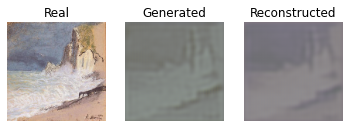

[INFO] Domain B to Domain A


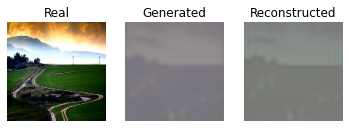

epoch: 1 step: 51 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.748 gBA_loss: 6.995
epoch: 1 step: 52 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.013 gBA_loss: 7.118
epoch: 1 step: 53 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.556 gBA_loss: 7.314
epoch: 1 step: 54 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.495 gBA_loss: 7.354
epoch: 1 step: 55 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.851 gBA_loss: 7.192
epoch: 1 step: 56 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.929 gBA_loss: 7.367
epoch: 1 step: 57 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.669 gBA_loss: 7.220
epoch: 1 step: 58 dA_loss: 0.010 dB_loss: 0.000 gAB_loss :6.786 gBA_loss: 7.248
epoch: 1 step: 59 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.580 gBA_loss: 7.212
epoch: 1 step: 60 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.109 gBA_loss: 7.525
epoch: 1 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.867 gBA_loss: 6.802
epoch: 1 step: 62 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.922 gBA_loss: 7.236
epoch: 1 step: 63 dA_loss: 0.001 dB_loss

  2%|▏         | 2/100 [03:46<3:14:30, 119.09s/it]

epoch: 1 step: 73 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.123 gBA_loss: 7.666
epoch: 2 step: 0 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.692 gBA_loss: 6.949
[INFO] Domain A to Domain B


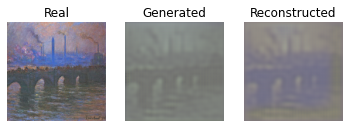

[INFO] Domain B to Domain A


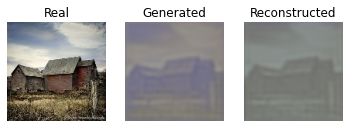

epoch: 2 step: 1 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.764 gBA_loss: 7.263
epoch: 2 step: 2 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.684 gBA_loss: 7.061
epoch: 2 step: 3 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.638 gBA_loss: 7.214
epoch: 2 step: 4 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.213 gBA_loss: 7.077
epoch: 2 step: 5 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :7.277 gBA_loss: 7.979
epoch: 2 step: 6 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.848 gBA_loss: 7.312
epoch: 2 step: 7 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.812 gBA_loss: 8.080
epoch: 2 step: 8 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :7.347 gBA_loss: 7.896
epoch: 2 step: 9 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.658 gBA_loss: 7.741
epoch: 2 step: 10 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.659 gBA_loss: 8.066
epoch: 2 step: 11 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.247 gBA_loss: 7.455
epoch: 2 step: 12 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.575 gBA_loss: 8.011
epoch: 2 step: 13 dA_loss: 0.001 dB_loss: 0.001 g

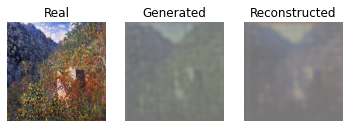

[INFO] Domain B to Domain A


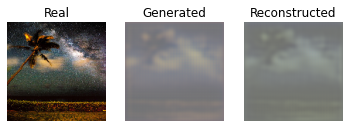

epoch: 2 step: 51 dA_loss: 0.014 dB_loss: 0.000 gAB_loss :6.630 gBA_loss: 6.678
epoch: 2 step: 52 dA_loss: 0.013 dB_loss: 0.000 gAB_loss :6.877 gBA_loss: 6.824
epoch: 2 step: 53 dA_loss: 0.009 dB_loss: 0.000 gAB_loss :6.397 gBA_loss: 7.056
epoch: 2 step: 54 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.334 gBA_loss: 7.123
epoch: 2 step: 55 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :6.721 gBA_loss: 6.994
epoch: 2 step: 56 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.782 gBA_loss: 7.188
epoch: 2 step: 57 dA_loss: 0.009 dB_loss: 0.000 gAB_loss :6.529 gBA_loss: 7.036
epoch: 2 step: 58 dA_loss: 0.023 dB_loss: 0.000 gAB_loss :6.656 gBA_loss: 7.072
epoch: 2 step: 59 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :6.434 gBA_loss: 6.998
epoch: 2 step: 60 dA_loss: 0.011 dB_loss: 0.000 gAB_loss :6.951 gBA_loss: 7.339
epoch: 2 step: 61 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.729 gBA_loss: 6.664
epoch: 2 step: 62 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.785 gBA_loss: 7.089
epoch: 2 step: 63 dA_loss: 0.001 dB_loss

  3%|▎         | 3/100 [05:24<3:02:24, 112.83s/it]

epoch: 2 step: 73 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.987 gBA_loss: 7.616
epoch: 3 step: 0 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :6.544 gBA_loss: 6.869
[INFO] Domain A to Domain B


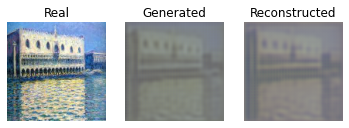

[INFO] Domain B to Domain A


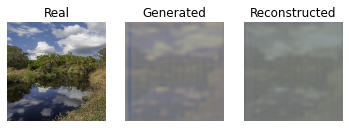

epoch: 3 step: 1 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.539 gBA_loss: 7.121
epoch: 3 step: 2 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.443 gBA_loss: 6.898
epoch: 3 step: 3 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.413 gBA_loss: 7.034
epoch: 3 step: 4 dA_loss: 0.012 dB_loss: 0.001 gAB_loss :5.960 gBA_loss: 6.632
epoch: 3 step: 5 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.784 gBA_loss: 7.444
epoch: 3 step: 6 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.149 gBA_loss: 6.677
epoch: 3 step: 7 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.042 gBA_loss: 7.513
epoch: 3 step: 8 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.636 gBA_loss: 7.343
epoch: 3 step: 9 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.939 gBA_loss: 7.193
epoch: 3 step: 10 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :7.010 gBA_loss: 7.206
epoch: 3 step: 11 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.641 gBA_loss: 6.887
epoch: 3 step: 12 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.983 gBA_loss: 7.321
epoch: 3 step: 13 dA_loss: 0.001 dB_loss: 0.000 g

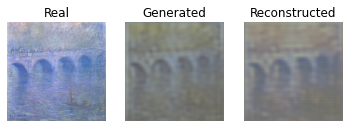

[INFO] Domain B to Domain A


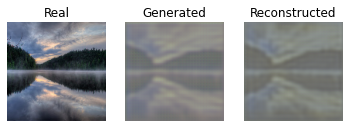

epoch: 3 step: 51 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.467 gBA_loss: 6.669
epoch: 3 step: 52 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.708 gBA_loss: 6.751
epoch: 3 step: 53 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :6.212 gBA_loss: 6.936
epoch: 3 step: 54 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.210 gBA_loss: 7.060
epoch: 3 step: 55 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.569 gBA_loss: 6.894
epoch: 3 step: 56 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.624 gBA_loss: 7.082
epoch: 3 step: 57 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.406 gBA_loss: 6.912
epoch: 3 step: 58 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :6.548 gBA_loss: 6.963
epoch: 3 step: 59 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.282 gBA_loss: 6.871
epoch: 3 step: 60 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.764 gBA_loss: 7.141
epoch: 3 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.587 gBA_loss: 6.473
epoch: 3 step: 62 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.654 gBA_loss: 6.917
epoch: 3 step: 63 dA_loss: 0.001 dB_loss

  4%|▍         | 4/100 [07:02<2:53:21, 108.35s/it]

epoch: 3 step: 73 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.990 gBA_loss: 7.527
epoch: 4 step: 0 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.451 gBA_loss: 6.755
[INFO] Domain A to Domain B


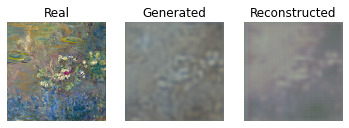

[INFO] Domain B to Domain A


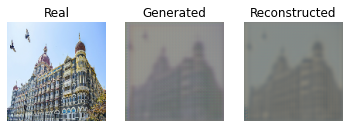

epoch: 4 step: 1 dA_loss: 0.004 dB_loss: 0.000 gAB_loss :6.432 gBA_loss: 6.976
epoch: 4 step: 2 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.342 gBA_loss: 6.757
epoch: 4 step: 3 dA_loss: 0.004 dB_loss: 0.000 gAB_loss :6.307 gBA_loss: 6.892
epoch: 4 step: 4 dA_loss: 0.059 dB_loss: 0.000 gAB_loss :5.860 gBA_loss: 6.476
epoch: 4 step: 5 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.666 gBA_loss: 7.269
epoch: 4 step: 6 dA_loss: 0.008 dB_loss: 0.000 gAB_loss :6.051 gBA_loss: 6.533
epoch: 4 step: 7 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.895 gBA_loss: 7.325
epoch: 4 step: 8 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.503 gBA_loss: 7.185
epoch: 4 step: 9 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.842 gBA_loss: 7.080
epoch: 4 step: 10 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.877 gBA_loss: 7.051
epoch: 4 step: 11 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.533 gBA_loss: 6.738
epoch: 4 step: 12 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :6.887 gBA_loss: 7.214
epoch: 4 step: 13 dA_loss: 0.001 dB_loss: 0.000 g

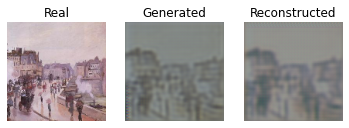

[INFO] Domain B to Domain A


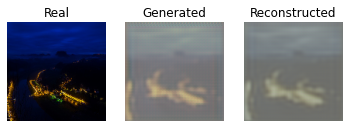

epoch: 4 step: 51 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.337 gBA_loss: 6.481
epoch: 4 step: 52 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.554 gBA_loss: 6.543
epoch: 4 step: 53 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.047 gBA_loss: 6.726
epoch: 4 step: 54 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :5.990 gBA_loss: 6.791
epoch: 4 step: 55 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.345 gBA_loss: 6.767
epoch: 4 step: 56 dA_loss: 0.001 dB_loss: 0.038 gAB_loss :6.529 gBA_loss: 6.933
epoch: 4 step: 57 dA_loss: 0.009 dB_loss: 0.744 gAB_loss :5.697 gBA_loss: 6.730
epoch: 4 step: 58 dA_loss: 0.012 dB_loss: 0.283 gAB_loss :5.915 gBA_loss: 6.796
epoch: 4 step: 59 dA_loss: 0.004 dB_loss: 0.202 gAB_loss :5.810 gBA_loss: 6.663
epoch: 4 step: 60 dA_loss: 0.004 dB_loss: 0.093 gAB_loss :6.370 gBA_loss: 6.983
epoch: 4 step: 61 dA_loss: 0.002 dB_loss: 0.156 gAB_loss :6.180 gBA_loss: 6.359
epoch: 4 step: 62 dA_loss: 0.002 dB_loss: 0.055 gAB_loss :6.303 gBA_loss: 6.823
epoch: 4 step: 63 dA_loss: 0.001 dB_loss

  5%|▌         | 5/100 [08:40<2:46:33, 105.20s/it]

epoch: 4 step: 73 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :6.674 gBA_loss: 7.276
epoch: 5 step: 0 dA_loss: 0.015 dB_loss: 0.002 gAB_loss :6.256 gBA_loss: 6.528
[INFO] Domain A to Domain B


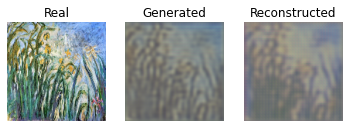

[INFO] Domain B to Domain A


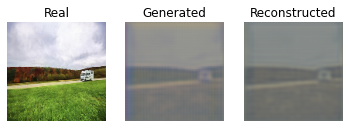

epoch: 5 step: 1 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :6.218 gBA_loss: 6.763
epoch: 5 step: 2 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.130 gBA_loss: 6.537
epoch: 5 step: 3 dA_loss: 0.010 dB_loss: 0.001 gAB_loss :6.120 gBA_loss: 6.680
epoch: 5 step: 4 dA_loss: 0.094 dB_loss: 0.002 gAB_loss :5.689 gBA_loss: 6.291
epoch: 5 step: 5 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.474 gBA_loss: 7.086
epoch: 5 step: 6 dA_loss: 0.060 dB_loss: 0.002 gAB_loss :5.899 gBA_loss: 6.359
epoch: 5 step: 7 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.725 gBA_loss: 7.109
epoch: 5 step: 8 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :6.374 gBA_loss: 7.020
epoch: 5 step: 9 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.760 gBA_loss: 6.977
epoch: 5 step: 10 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.759 gBA_loss: 6.904
epoch: 5 step: 11 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.370 gBA_loss: 6.585
epoch: 5 step: 12 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.719 gBA_loss: 6.989
epoch: 5 step: 13 dA_loss: 0.001 dB_loss: 0.001 g

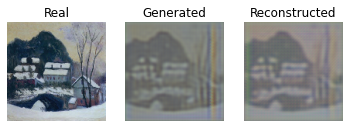

[INFO] Domain B to Domain A


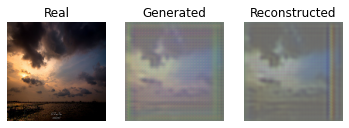

epoch: 5 step: 51 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.249 gBA_loss: 6.495
epoch: 5 step: 52 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :6.551 gBA_loss: 6.472
epoch: 5 step: 53 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :6.016 gBA_loss: 6.614
epoch: 5 step: 54 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.942 gBA_loss: 6.656
epoch: 5 step: 55 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :6.353 gBA_loss: 6.555
epoch: 5 step: 56 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.362 gBA_loss: 6.787
epoch: 5 step: 57 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :6.193 gBA_loss: 6.600
epoch: 5 step: 58 dA_loss: 0.032 dB_loss: 0.002 gAB_loss :6.364 gBA_loss: 6.353
epoch: 5 step: 59 dA_loss: 0.684 dB_loss: 0.001 gAB_loss :6.283 gBA_loss: 7.120
epoch: 5 step: 60 dA_loss: 0.123 dB_loss: 0.001 gAB_loss :6.641 gBA_loss: 7.162
epoch: 5 step: 61 dA_loss: 0.202 dB_loss: 0.002 gAB_loss :6.388 gBA_loss: 6.331
epoch: 5 step: 62 dA_loss: 0.144 dB_loss: 0.001 gAB_loss :6.433 gBA_loss: 6.582
epoch: 5 step: 63 dA_loss: 0.031 dB_loss

  6%|▌         | 6/100 [10:18<2:41:21, 102.99s/it]

epoch: 5 step: 73 dA_loss: 0.004 dB_loss: 0.028 gAB_loss :6.641 gBA_loss: 7.115
epoch: 6 step: 0 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :6.210 gBA_loss: 6.388
[INFO] Domain A to Domain B


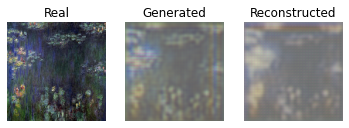

[INFO] Domain B to Domain A


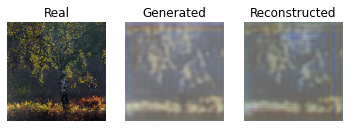

epoch: 6 step: 1 dA_loss: 0.013 dB_loss: 0.009 gAB_loss :6.104 gBA_loss: 6.619
epoch: 6 step: 2 dA_loss: 0.004 dB_loss: 0.003 gAB_loss :6.012 gBA_loss: 6.405
epoch: 6 step: 3 dA_loss: 0.011 dB_loss: 0.002 gAB_loss :6.012 gBA_loss: 6.554
epoch: 6 step: 4 dA_loss: 0.103 dB_loss: 0.002 gAB_loss :5.580 gBA_loss: 6.176
epoch: 6 step: 5 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.347 gBA_loss: 6.956
epoch: 6 step: 6 dA_loss: 0.053 dB_loss: 0.002 gAB_loss :5.807 gBA_loss: 6.255
epoch: 6 step: 7 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.593 gBA_loss: 6.950
epoch: 6 step: 8 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.240 gBA_loss: 6.860
epoch: 6 step: 9 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.665 gBA_loss: 6.872
epoch: 6 step: 10 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.647 gBA_loss: 6.768
epoch: 6 step: 11 dA_loss: 0.005 dB_loss: 0.002 gAB_loss :6.269 gBA_loss: 6.472
epoch: 6 step: 12 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :6.649 gBA_loss: 6.926
epoch: 6 step: 13 dA_loss: 0.004 dB_loss: 0.001 g

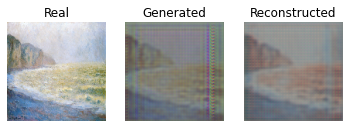

[INFO] Domain B to Domain A


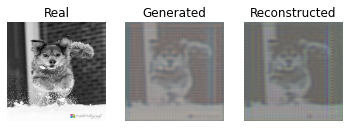

epoch: 6 step: 51 dA_loss: 0.007 dB_loss: 0.001 gAB_loss :6.226 gBA_loss: 6.292
epoch: 6 step: 52 dA_loss: 0.014 dB_loss: 0.001 gAB_loss :6.416 gBA_loss: 6.406
epoch: 6 step: 53 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :5.891 gBA_loss: 6.605
epoch: 6 step: 54 dA_loss: 0.006 dB_loss: 0.014 gAB_loss :5.716 gBA_loss: 6.791
epoch: 6 step: 55 dA_loss: 0.001 dB_loss: 0.161 gAB_loss :6.559 gBA_loss: 6.510
epoch: 6 step: 56 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :6.413 gBA_loss: 6.658
epoch: 6 step: 57 dA_loss: 0.057 dB_loss: 0.052 gAB_loss :6.048 gBA_loss: 6.413
epoch: 6 step: 58 dA_loss: 0.051 dB_loss: 0.018 gAB_loss :6.168 gBA_loss: 6.465
epoch: 6 step: 59 dA_loss: 0.021 dB_loss: 0.010 gAB_loss :5.820 gBA_loss: 6.368
epoch: 6 step: 60 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :6.307 gBA_loss: 6.666
epoch: 6 step: 61 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :6.173 gBA_loss: 6.066
epoch: 6 step: 62 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.248 gBA_loss: 6.469
epoch: 6 step: 63 dA_loss: 0.001 dB_loss

  7%|▋         | 7/100 [11:56<2:37:15, 101.45s/it]

epoch: 6 step: 73 dA_loss: 0.002 dB_loss: 0.082 gAB_loss :6.683 gBA_loss: 6.990
epoch: 7 step: 0 dA_loss: 0.002 dB_loss: 0.173 gAB_loss :6.124 gBA_loss: 6.231
[INFO] Domain A to Domain B


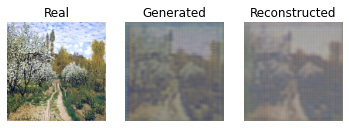

[INFO] Domain B to Domain A


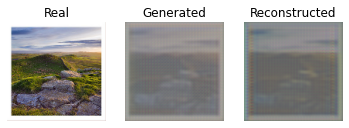

epoch: 7 step: 1 dA_loss: 0.002 dB_loss: 0.023 gAB_loss :5.952 gBA_loss: 6.468
epoch: 7 step: 2 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :5.821 gBA_loss: 6.275
epoch: 7 step: 3 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :5.850 gBA_loss: 6.407
epoch: 7 step: 4 dA_loss: 0.080 dB_loss: 0.010 gAB_loss :5.484 gBA_loss: 6.057
epoch: 7 step: 5 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :6.235 gBA_loss: 6.823
epoch: 7 step: 6 dA_loss: 0.071 dB_loss: 0.022 gAB_loss :5.692 gBA_loss: 6.163
epoch: 7 step: 7 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :6.432 gBA_loss: 6.789
epoch: 7 step: 8 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :6.088 gBA_loss: 6.746
epoch: 7 step: 9 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :6.619 gBA_loss: 6.769
epoch: 7 step: 10 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.554 gBA_loss: 6.611
epoch: 7 step: 11 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :6.163 gBA_loss: 6.280
epoch: 7 step: 12 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.520 gBA_loss: 6.687
epoch: 7 step: 13 dA_loss: 0.001 dB_loss: 0.001 g

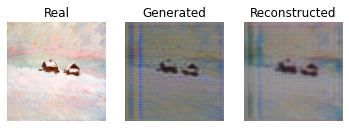

[INFO] Domain B to Domain A


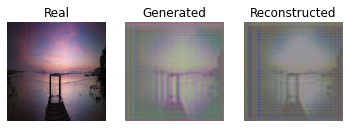

epoch: 7 step: 51 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.125 gBA_loss: 6.315
epoch: 7 step: 52 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.246 gBA_loss: 6.243
epoch: 7 step: 53 dA_loss: 0.025 dB_loss: 0.001 gAB_loss :5.711 gBA_loss: 6.353
epoch: 7 step: 54 dA_loss: 0.002 dB_loss: 0.006 gAB_loss :5.626 gBA_loss: 6.396
epoch: 7 step: 55 dA_loss: 0.001 dB_loss: 0.062 gAB_loss :6.087 gBA_loss: 6.334
epoch: 7 step: 56 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :6.152 gBA_loss: 6.506
epoch: 7 step: 57 dA_loss: 0.030 dB_loss: 0.001 gAB_loss :5.951 gBA_loss: 6.256
epoch: 7 step: 58 dA_loss: 0.046 dB_loss: 0.002 gAB_loss :6.143 gBA_loss: 6.208
epoch: 7 step: 59 dA_loss: 0.199 dB_loss: 0.001 gAB_loss :5.817 gBA_loss: 6.348
epoch: 7 step: 60 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :6.244 gBA_loss: 6.628
epoch: 7 step: 61 dA_loss: 0.048 dB_loss: 0.001 gAB_loss :6.098 gBA_loss: 6.001
epoch: 7 step: 62 dA_loss: 0.148 dB_loss: 0.000 gAB_loss :6.163 gBA_loss: 6.305
epoch: 7 step: 63 dA_loss: 0.016 dB_loss

  8%|▊         | 8/100 [13:33<2:33:54, 100.37s/it]

epoch: 7 step: 73 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :6.171 gBA_loss: 6.629
epoch: 8 step: 0 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :5.932 gBA_loss: 6.005
[INFO] Domain A to Domain B


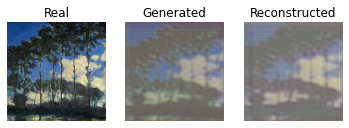

[INFO] Domain B to Domain A


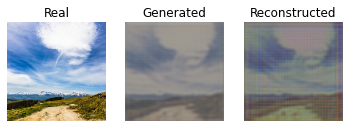

epoch: 8 step: 1 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.869 gBA_loss: 6.260
epoch: 8 step: 2 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.795 gBA_loss: 6.090
epoch: 8 step: 3 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.797 gBA_loss: 6.239
epoch: 8 step: 4 dA_loss: 0.091 dB_loss: 0.001 gAB_loss :5.376 gBA_loss: 5.922
epoch: 8 step: 5 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.101 gBA_loss: 6.666
epoch: 8 step: 6 dA_loss: 0.063 dB_loss: 0.008 gAB_loss :5.592 gBA_loss: 6.009
epoch: 8 step: 7 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.301 gBA_loss: 6.587
epoch: 8 step: 8 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :5.976 gBA_loss: 6.555
epoch: 8 step: 9 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.461 gBA_loss: 6.629
epoch: 8 step: 10 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.393 gBA_loss: 6.454
epoch: 8 step: 11 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.994 gBA_loss: 6.144
epoch: 8 step: 12 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.381 gBA_loss: 6.527
epoch: 8 step: 13 dA_loss: 0.001 dB_loss: 0.000 g

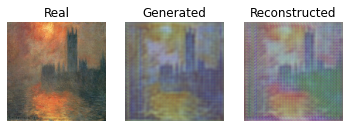

[INFO] Domain B to Domain A


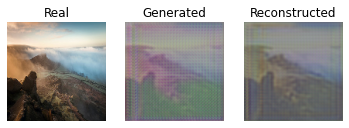

epoch: 8 step: 51 dA_loss: 0.009 dB_loss: 0.000 gAB_loss :5.997 gBA_loss: 6.079
epoch: 8 step: 52 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.118 gBA_loss: 6.054
epoch: 8 step: 53 dA_loss: 0.006 dB_loss: 0.000 gAB_loss :5.581 gBA_loss: 6.220
epoch: 8 step: 54 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :5.541 gBA_loss: 6.276
epoch: 8 step: 55 dA_loss: 0.003 dB_loss: 0.060 gAB_loss :6.015 gBA_loss: 6.256
epoch: 8 step: 56 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :6.098 gBA_loss: 6.440
epoch: 8 step: 57 dA_loss: 0.033 dB_loss: 0.001 gAB_loss :5.858 gBA_loss: 6.172
epoch: 8 step: 58 dA_loss: 0.079 dB_loss: 0.001 gAB_loss :6.106 gBA_loss: 6.435
epoch: 8 step: 59 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :5.663 gBA_loss: 6.130
epoch: 8 step: 60 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.081 gBA_loss: 6.394
epoch: 8 step: 61 dA_loss: 0.003 dB_loss: 0.000 gAB_loss :5.979 gBA_loss: 5.837
epoch: 8 step: 62 dA_loss: 0.004 dB_loss: 0.000 gAB_loss :6.051 gBA_loss: 6.219
epoch: 8 step: 63 dA_loss: 0.001 dB_loss

  9%|▉         | 9/100 [15:11<2:31:05, 99.63s/it] 

epoch: 8 step: 73 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.098 gBA_loss: 6.552
epoch: 9 step: 0 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.781 gBA_loss: 5.914
[INFO] Domain A to Domain B


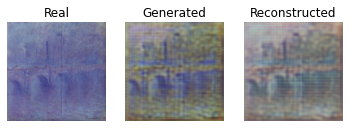

[INFO] Domain B to Domain A


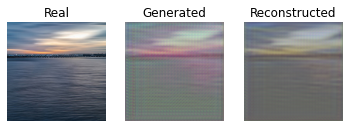

epoch: 9 step: 1 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.714 gBA_loss: 6.156
epoch: 9 step: 2 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.664 gBA_loss: 5.977
epoch: 9 step: 3 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.718 gBA_loss: 6.142
epoch: 9 step: 4 dA_loss: 0.075 dB_loss: 0.001 gAB_loss :5.319 gBA_loss: 5.824
epoch: 9 step: 5 dA_loss: 0.004 dB_loss: 0.000 gAB_loss :6.018 gBA_loss: 6.628
epoch: 9 step: 6 dA_loss: 0.055 dB_loss: 0.002 gAB_loss :5.559 gBA_loss: 5.962
epoch: 9 step: 7 dA_loss: 0.005 dB_loss: 0.000 gAB_loss :6.225 gBA_loss: 6.535
epoch: 9 step: 8 dA_loss: 0.022 dB_loss: 0.000 gAB_loss :5.921 gBA_loss: 6.562
epoch: 9 step: 9 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.436 gBA_loss: 6.685
epoch: 9 step: 10 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.317 gBA_loss: 6.438
epoch: 9 step: 11 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :5.910 gBA_loss: 6.070
epoch: 9 step: 12 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.275 gBA_loss: 6.427
epoch: 9 step: 13 dA_loss: 0.001 dB_loss: 0.000 g

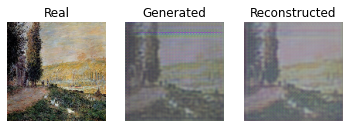

[INFO] Domain B to Domain A


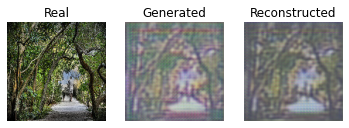

epoch: 9 step: 51 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :5.834 gBA_loss: 6.005
epoch: 9 step: 52 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.968 gBA_loss: 5.921
epoch: 9 step: 53 dA_loss: 0.043 dB_loss: 0.000 gAB_loss :5.426 gBA_loss: 6.011
epoch: 9 step: 54 dA_loss: 0.016 dB_loss: 0.008 gAB_loss :5.306 gBA_loss: 6.106
epoch: 9 step: 55 dA_loss: 0.002 dB_loss: 0.127 gAB_loss :6.183 gBA_loss: 5.986
epoch: 9 step: 56 dA_loss: 0.004 dB_loss: 0.045 gAB_loss :6.003 gBA_loss: 6.193
epoch: 9 step: 57 dA_loss: 0.039 dB_loss: 0.066 gAB_loss :5.633 gBA_loss: 6.019
epoch: 9 step: 58 dA_loss: 0.084 dB_loss: 0.022 gAB_loss :5.871 gBA_loss: 6.330
epoch: 9 step: 59 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :5.490 gBA_loss: 6.039
epoch: 9 step: 60 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :5.955 gBA_loss: 6.304
epoch: 9 step: 61 dA_loss: 0.001 dB_loss: 0.026 gAB_loss :5.692 gBA_loss: 6.168
epoch: 9 step: 62 dA_loss: 0.003 dB_loss: 0.212 gAB_loss :6.488 gBA_loss: 6.276
epoch: 9 step: 63 dA_loss: 0.001 dB_loss

 10%|█         | 10/100 [16:49<2:28:37, 99.09s/it]

epoch: 9 step: 73 dA_loss: 0.006 dB_loss: 0.001 gAB_loss :6.024 gBA_loss: 6.283
epoch: 10 step: 0 dA_loss: 0.004 dB_loss: 0.028 gAB_loss :5.630 gBA_loss: 5.705
[INFO] Domain A to Domain B


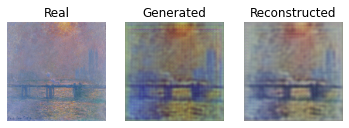

[INFO] Domain B to Domain A


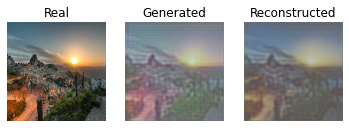

epoch: 10 step: 1 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :5.516 gBA_loss: 6.006
epoch: 10 step: 2 dA_loss: 0.001 dB_loss: 0.024 gAB_loss :5.617 gBA_loss: 5.835
epoch: 10 step: 3 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :5.670 gBA_loss: 6.020
epoch: 10 step: 4 dA_loss: 0.069 dB_loss: 0.004 gAB_loss :5.234 gBA_loss: 5.691
epoch: 10 step: 5 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.906 gBA_loss: 6.464
epoch: 10 step: 6 dA_loss: 0.064 dB_loss: 0.124 gAB_loss :5.373 gBA_loss: 5.835
epoch: 10 step: 7 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :6.013 gBA_loss: 6.322
epoch: 10 step: 8 dA_loss: 0.003 dB_loss: 0.004 gAB_loss :5.742 gBA_loss: 6.309
epoch: 10 step: 9 dA_loss: 0.008 dB_loss: 0.002 gAB_loss :6.312 gBA_loss: 6.499
epoch: 10 step: 10 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.200 gBA_loss: 6.277
epoch: 10 step: 11 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :5.808 gBA_loss: 5.957
epoch: 10 step: 12 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.175 gBA_loss: 6.323
epoch: 10 step: 13 dA_loss: 0.001 dB_

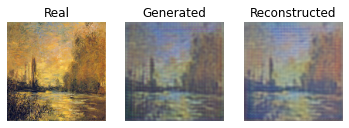

[INFO] Domain B to Domain A


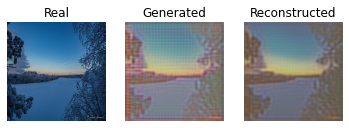

epoch: 10 step: 51 dA_loss: 0.014 dB_loss: 0.000 gAB_loss :5.742 gBA_loss: 5.744
epoch: 10 step: 52 dA_loss: 0.015 dB_loss: 0.001 gAB_loss :5.883 gBA_loss: 5.768
epoch: 10 step: 53 dA_loss: 0.011 dB_loss: 0.000 gAB_loss :5.320 gBA_loss: 5.853
epoch: 10 step: 54 dA_loss: 0.008 dB_loss: 0.008 gAB_loss :5.251 gBA_loss: 5.918
epoch: 10 step: 55 dA_loss: 0.001 dB_loss: 0.065 gAB_loss :5.841 gBA_loss: 5.850
epoch: 10 step: 56 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :5.792 gBA_loss: 6.075
epoch: 10 step: 57 dA_loss: 0.061 dB_loss: 0.001 gAB_loss :5.599 gBA_loss: 5.863
epoch: 10 step: 58 dA_loss: 0.061 dB_loss: 0.001 gAB_loss :5.872 gBA_loss: 6.064
epoch: 10 step: 59 dA_loss: 0.007 dB_loss: 0.000 gAB_loss :5.437 gBA_loss: 5.832
epoch: 10 step: 60 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :5.902 gBA_loss: 6.159
epoch: 10 step: 61 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.834 gBA_loss: 5.684
epoch: 10 step: 62 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :5.871 gBA_loss: 6.028
epoch: 10 step: 63 dA_loss: 

 11%|█         | 11/100 [18:27<2:26:25, 98.72s/it]

epoch: 10 step: 73 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.894 gBA_loss: 6.338
epoch: 11 step: 0 dA_loss: 0.001 dB_loss: 0.026 gAB_loss :5.525 gBA_loss: 5.793
[INFO] Domain A to Domain B


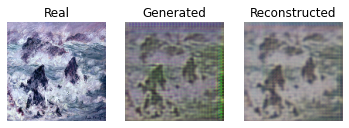

[INFO] Domain B to Domain A


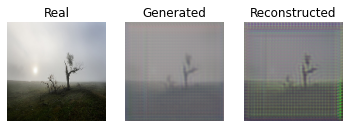

epoch: 11 step: 1 dA_loss: 0.001 dB_loss: 0.023 gAB_loss :5.610 gBA_loss: 5.950
epoch: 11 step: 2 dA_loss: 0.000 dB_loss: 0.003 gAB_loss :5.502 gBA_loss: 5.756
epoch: 11 step: 3 dA_loss: 0.027 dB_loss: 0.007 gAB_loss :5.540 gBA_loss: 5.894
epoch: 11 step: 4 dA_loss: 0.065 dB_loss: 0.004 gAB_loss :5.118 gBA_loss: 5.557
epoch: 11 step: 5 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :5.781 gBA_loss: 6.328
epoch: 11 step: 6 dA_loss: 0.090 dB_loss: 0.056 gAB_loss :5.335 gBA_loss: 5.869
epoch: 11 step: 7 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :5.866 gBA_loss: 6.302
epoch: 11 step: 8 dA_loss: 0.023 dB_loss: 0.009 gAB_loss :5.704 gBA_loss: 6.282
epoch: 11 step: 9 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :6.347 gBA_loss: 6.419
epoch: 11 step: 10 dA_loss: 0.005 dB_loss: 0.002 gAB_loss :6.205 gBA_loss: 6.143
epoch: 11 step: 11 dA_loss: 0.016 dB_loss: 0.002 gAB_loss :5.799 gBA_loss: 5.884
epoch: 11 step: 12 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.124 gBA_loss: 6.212
epoch: 11 step: 13 dA_loss: 0.002 dB_

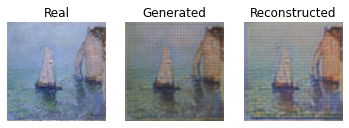

[INFO] Domain B to Domain A


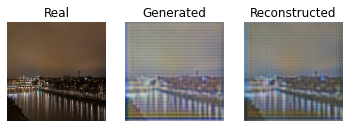

epoch: 11 step: 51 dA_loss: 0.260 dB_loss: 0.079 gAB_loss :5.802 gBA_loss: 5.882
epoch: 11 step: 52 dA_loss: 0.014 dB_loss: 0.003 gAB_loss :5.829 gBA_loss: 5.808
epoch: 11 step: 53 dA_loss: 0.146 dB_loss: 0.002 gAB_loss :5.236 gBA_loss: 5.766
epoch: 11 step: 54 dA_loss: 0.085 dB_loss: 0.045 gAB_loss :5.176 gBA_loss: 5.775
epoch: 11 step: 55 dA_loss: 0.010 dB_loss: 0.064 gAB_loss :5.704 gBA_loss: 5.746
epoch: 11 step: 56 dA_loss: 0.054 dB_loss: 0.040 gAB_loss :5.746 gBA_loss: 5.933
epoch: 11 step: 57 dA_loss: 0.112 dB_loss: 0.003 gAB_loss :5.600 gBA_loss: 5.695
epoch: 11 step: 58 dA_loss: 0.165 dB_loss: 0.025 gAB_loss :5.853 gBA_loss: 5.875
epoch: 11 step: 59 dA_loss: 0.022 dB_loss: 0.001 gAB_loss :5.316 gBA_loss: 5.526
epoch: 11 step: 60 dA_loss: 0.010 dB_loss: 0.001 gAB_loss :5.731 gBA_loss: 5.846
epoch: 11 step: 61 dA_loss: 0.006 dB_loss: 0.059 gAB_loss :5.677 gBA_loss: 5.434
epoch: 11 step: 62 dA_loss: 0.022 dB_loss: 0.001 gAB_loss :5.734 gBA_loss: 5.810
epoch: 11 step: 63 dA_loss: 

 12%|█▏        | 12/100 [20:05<2:24:24, 98.46s/it]

epoch: 11 step: 73 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.820 gBA_loss: 6.169
epoch: 12 step: 0 dA_loss: 0.003 dB_loss: 0.066 gAB_loss :5.436 gBA_loss: 5.683
[INFO] Domain A to Domain B


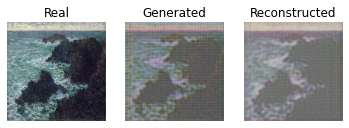

[INFO] Domain B to Domain A


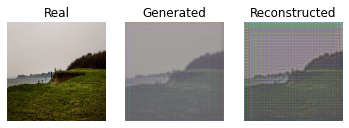

epoch: 12 step: 1 dA_loss: 0.001 dB_loss: 0.189 gAB_loss :5.579 gBA_loss: 5.850
epoch: 12 step: 2 dA_loss: 0.001 dB_loss: 0.268 gAB_loss :5.382 gBA_loss: 5.682
epoch: 12 step: 3 dA_loss: 0.048 dB_loss: 0.128 gAB_loss :5.296 gBA_loss: 5.806
epoch: 12 step: 4 dA_loss: 0.114 dB_loss: 0.030 gAB_loss :4.815 gBA_loss: 5.474
epoch: 12 step: 5 dA_loss: 0.003 dB_loss: 0.032 gAB_loss :5.521 gBA_loss: 6.217
epoch: 12 step: 6 dA_loss: 0.069 dB_loss: 0.073 gAB_loss :5.180 gBA_loss: 5.600
epoch: 12 step: 7 dA_loss: 0.048 dB_loss: 0.011 gAB_loss :5.823 gBA_loss: 6.144
epoch: 12 step: 8 dA_loss: 0.015 dB_loss: 0.038 gAB_loss :5.586 gBA_loss: 6.189
epoch: 12 step: 9 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :6.165 gBA_loss: 6.396
epoch: 12 step: 10 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :6.018 gBA_loss: 6.047
epoch: 12 step: 11 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :5.634 gBA_loss: 5.707
epoch: 12 step: 12 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :6.022 gBA_loss: 6.065
epoch: 12 step: 13 dA_loss: 0.004 dB_

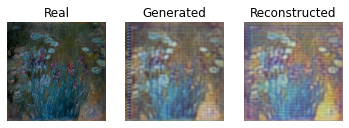

[INFO] Domain B to Domain A


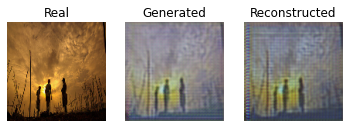

epoch: 12 step: 51 dA_loss: 0.216 dB_loss: 0.017 gAB_loss :5.585 gBA_loss: 5.774
epoch: 12 step: 52 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :5.704 gBA_loss: 5.686
epoch: 12 step: 53 dA_loss: 0.391 dB_loss: 0.008 gAB_loss :5.259 gBA_loss: 5.573
epoch: 12 step: 54 dA_loss: 0.214 dB_loss: 0.012 gAB_loss :5.188 gBA_loss: 5.508
epoch: 12 step: 55 dA_loss: 0.024 dB_loss: 0.069 gAB_loss :5.730 gBA_loss: 5.468
epoch: 12 step: 56 dA_loss: 0.049 dB_loss: 0.004 gAB_loss :5.614 gBA_loss: 5.712
epoch: 12 step: 57 dA_loss: 0.104 dB_loss: 0.003 gAB_loss :5.432 gBA_loss: 5.508
epoch: 12 step: 58 dA_loss: 0.097 dB_loss: 0.001 gAB_loss :5.738 gBA_loss: 5.748
epoch: 12 step: 59 dA_loss: 0.014 dB_loss: 0.001 gAB_loss :5.209 gBA_loss: 5.397
epoch: 12 step: 60 dA_loss: 0.019 dB_loss: 0.001 gAB_loss :5.646 gBA_loss: 5.735
epoch: 12 step: 61 dA_loss: 0.014 dB_loss: 0.030 gAB_loss :5.604 gBA_loss: 5.421
epoch: 12 step: 62 dA_loss: 0.030 dB_loss: 0.009 gAB_loss :5.739 gBA_loss: 5.809
epoch: 12 step: 63 dA_loss: 

 13%|█▎        | 13/100 [21:43<2:22:29, 98.27s/it]

epoch: 12 step: 73 dA_loss: 0.032 dB_loss: 0.001 gAB_loss :5.735 gBA_loss: 5.925
epoch: 13 step: 0 dA_loss: 0.011 dB_loss: 0.044 gAB_loss :5.419 gBA_loss: 5.425
[INFO] Domain A to Domain B


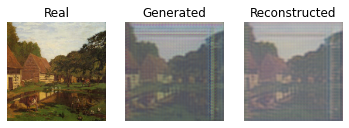

[INFO] Domain B to Domain A


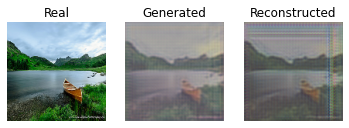

epoch: 13 step: 1 dA_loss: 0.004 dB_loss: 0.003 gAB_loss :5.314 gBA_loss: 5.667
epoch: 13 step: 2 dA_loss: 0.004 dB_loss: 0.003 gAB_loss :5.326 gBA_loss: 5.519
epoch: 13 step: 3 dA_loss: 0.044 dB_loss: 0.002 gAB_loss :5.439 gBA_loss: 5.682
epoch: 13 step: 4 dA_loss: 0.156 dB_loss: 0.002 gAB_loss :5.118 gBA_loss: 5.455
epoch: 13 step: 5 dA_loss: 0.203 dB_loss: 0.001 gAB_loss :5.772 gBA_loss: 6.460
epoch: 13 step: 6 dA_loss: 0.264 dB_loss: 0.053 gAB_loss :5.332 gBA_loss: 5.832
epoch: 13 step: 7 dA_loss: 0.025 dB_loss: 0.005 gAB_loss :5.767 gBA_loss: 6.052
epoch: 13 step: 8 dA_loss: 0.241 dB_loss: 0.004 gAB_loss :5.587 gBA_loss: 5.994
epoch: 13 step: 9 dA_loss: 0.013 dB_loss: 0.007 gAB_loss :6.236 gBA_loss: 6.210
epoch: 13 step: 10 dA_loss: 0.012 dB_loss: 0.002 gAB_loss :6.048 gBA_loss: 5.837
epoch: 13 step: 11 dA_loss: 0.008 dB_loss: 0.002 gAB_loss :5.616 gBA_loss: 5.502
epoch: 13 step: 12 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :5.942 gBA_loss: 5.864
epoch: 13 step: 13 dA_loss: 0.091 dB_

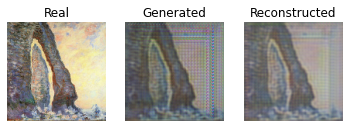

[INFO] Domain B to Domain A


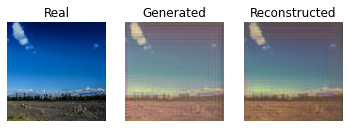

epoch: 13 step: 51 dA_loss: 0.013 dB_loss: 0.009 gAB_loss :5.480 gBA_loss: 5.421
epoch: 13 step: 52 dA_loss: 0.051 dB_loss: 0.004 gAB_loss :5.608 gBA_loss: 5.462
epoch: 13 step: 53 dA_loss: 0.089 dB_loss: 0.004 gAB_loss :5.166 gBA_loss: 5.490
epoch: 13 step: 54 dA_loss: 0.056 dB_loss: 0.003 gAB_loss :5.110 gBA_loss: 5.566
epoch: 13 step: 55 dA_loss: 0.001 dB_loss: 0.072 gAB_loss :5.675 gBA_loss: 5.543
epoch: 13 step: 56 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :5.576 gBA_loss: 5.779
epoch: 13 step: 57 dA_loss: 0.069 dB_loss: 0.001 gAB_loss :5.402 gBA_loss: 5.501
epoch: 13 step: 58 dA_loss: 0.062 dB_loss: 0.001 gAB_loss :5.716 gBA_loss: 5.758
epoch: 13 step: 59 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :5.153 gBA_loss: 5.373
epoch: 13 step: 60 dA_loss: 0.008 dB_loss: 0.001 gAB_loss :5.582 gBA_loss: 5.703
epoch: 13 step: 61 dA_loss: 0.003 dB_loss: 0.047 gAB_loss :5.559 gBA_loss: 5.389
epoch: 13 step: 62 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.592 gBA_loss: 5.724
epoch: 13 step: 63 dA_loss: 

 14%|█▍        | 14/100 [23:21<2:20:50, 98.27s/it]

epoch: 13 step: 73 dA_loss: 0.033 dB_loss: 0.012 gAB_loss :5.666 gBA_loss: 5.700
epoch: 14 step: 0 dA_loss: 0.033 dB_loss: 0.047 gAB_loss :5.383 gBA_loss: 5.204
[INFO] Domain A to Domain B


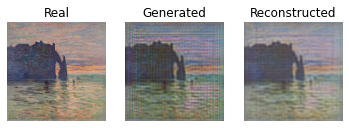

[INFO] Domain B to Domain A


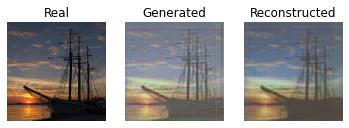

epoch: 14 step: 1 dA_loss: 0.010 dB_loss: 0.001 gAB_loss :5.217 gBA_loss: 5.461
epoch: 14 step: 2 dA_loss: 0.007 dB_loss: 0.002 gAB_loss :5.171 gBA_loss: 5.381
epoch: 14 step: 3 dA_loss: 0.027 dB_loss: 0.002 gAB_loss :5.305 gBA_loss: 5.565
epoch: 14 step: 4 dA_loss: 0.128 dB_loss: 0.002 gAB_loss :4.970 gBA_loss: 5.256
epoch: 14 step: 5 dA_loss: 0.096 dB_loss: 0.001 gAB_loss :5.621 gBA_loss: 6.236
epoch: 14 step: 6 dA_loss: 0.223 dB_loss: 0.076 gAB_loss :5.039 gBA_loss: 5.827
epoch: 14 step: 7 dA_loss: 0.001 dB_loss: 0.168 gAB_loss :5.963 gBA_loss: 5.932
epoch: 14 step: 8 dA_loss: 0.087 dB_loss: 0.293 gAB_loss :5.532 gBA_loss: 5.949
epoch: 14 step: 9 dA_loss: 0.003 dB_loss: 0.167 gAB_loss :5.959 gBA_loss: 6.163
epoch: 14 step: 10 dA_loss: 0.004 dB_loss: 0.081 gAB_loss :5.597 gBA_loss: 5.775
epoch: 14 step: 11 dA_loss: 0.004 dB_loss: 0.046 gAB_loss :5.190 gBA_loss: 5.437
epoch: 14 step: 12 dA_loss: 0.003 dB_loss: 0.061 gAB_loss :5.619 gBA_loss: 5.817
epoch: 14 step: 13 dA_loss: 0.005 dB_

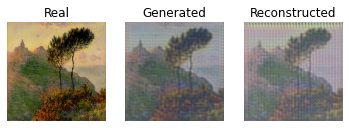

[INFO] Domain B to Domain A


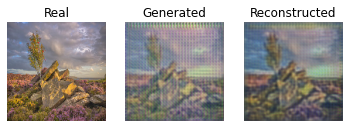

epoch: 14 step: 51 dA_loss: 0.066 dB_loss: 0.048 gAB_loss :5.379 gBA_loss: 5.523
epoch: 14 step: 52 dA_loss: 0.005 dB_loss: 0.050 gAB_loss :5.677 gBA_loss: 5.373
epoch: 14 step: 53 dA_loss: 0.098 dB_loss: 0.002 gAB_loss :5.099 gBA_loss: 5.363
epoch: 14 step: 54 dA_loss: 0.061 dB_loss: 0.072 gAB_loss :4.997 gBA_loss: 5.443
epoch: 14 step: 55 dA_loss: 0.004 dB_loss: 0.071 gAB_loss :5.545 gBA_loss: 5.393
epoch: 14 step: 56 dA_loss: 0.009 dB_loss: 0.002 gAB_loss :5.403 gBA_loss: 5.638
epoch: 14 step: 57 dA_loss: 0.078 dB_loss: 0.020 gAB_loss :5.175 gBA_loss: 5.374
epoch: 14 step: 58 dA_loss: 0.070 dB_loss: 0.003 gAB_loss :5.523 gBA_loss: 5.647
epoch: 14 step: 59 dA_loss: 0.008 dB_loss: 0.002 gAB_loss :4.991 gBA_loss: 5.290
epoch: 14 step: 60 dA_loss: 0.006 dB_loss: 0.001 gAB_loss :5.456 gBA_loss: 5.644
epoch: 14 step: 61 dA_loss: 0.002 dB_loss: 0.050 gAB_loss :5.445 gBA_loss: 5.329
epoch: 14 step: 62 dA_loss: 0.041 dB_loss: 0.004 gAB_loss :5.503 gBA_loss: 5.608
epoch: 14 step: 63 dA_loss: 

 15%|█▌        | 15/100 [24:59<2:19:01, 98.14s/it]

epoch: 14 step: 73 dA_loss: 0.020 dB_loss: 0.000 gAB_loss :5.526 gBA_loss: 5.616
epoch: 15 step: 0 dA_loss: 0.027 dB_loss: 0.060 gAB_loss :5.256 gBA_loss: 5.146
[INFO] Domain A to Domain B


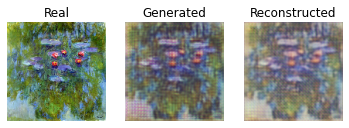

[INFO] Domain B to Domain A


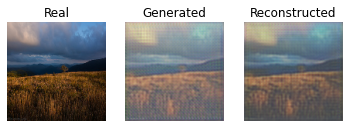

epoch: 15 step: 1 dA_loss: 0.007 dB_loss: 0.001 gAB_loss :5.085 gBA_loss: 5.346
epoch: 15 step: 2 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :5.049 gBA_loss: 5.256
epoch: 15 step: 3 dA_loss: 0.066 dB_loss: 0.001 gAB_loss :5.187 gBA_loss: 5.474
epoch: 15 step: 4 dA_loss: 0.172 dB_loss: 0.000 gAB_loss :4.844 gBA_loss: 5.167
epoch: 15 step: 5 dA_loss: 0.021 dB_loss: 0.001 gAB_loss :5.450 gBA_loss: 6.003
epoch: 15 step: 6 dA_loss: 0.182 dB_loss: 0.059 gAB_loss :5.088 gBA_loss: 5.472
epoch: 15 step: 7 dA_loss: 0.016 dB_loss: 0.004 gAB_loss :5.549 gBA_loss: 5.822
epoch: 15 step: 8 dA_loss: 0.096 dB_loss: 0.010 gAB_loss :5.518 gBA_loss: 5.818
epoch: 15 step: 9 dA_loss: 0.040 dB_loss: 0.001 gAB_loss :6.165 gBA_loss: 6.202
epoch: 15 step: 10 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.894 gBA_loss: 5.834
epoch: 15 step: 11 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.438 gBA_loss: 5.451
epoch: 15 step: 12 dA_loss: 0.001 dB_loss: 0.047 gAB_loss :5.744 gBA_loss: 5.763
epoch: 15 step: 13 dA_loss: 0.028 dB_

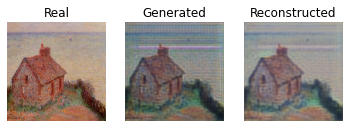

[INFO] Domain B to Domain A


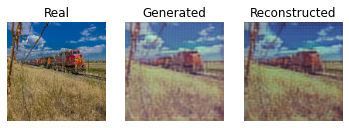

epoch: 15 step: 51 dA_loss: 0.014 dB_loss: 0.042 gAB_loss :4.981 gBA_loss: 5.276
epoch: 15 step: 52 dA_loss: 0.006 dB_loss: 0.218 gAB_loss :5.658 gBA_loss: 5.140
epoch: 15 step: 53 dA_loss: 0.057 dB_loss: 0.143 gAB_loss :4.993 gBA_loss: 5.126
epoch: 15 step: 54 dA_loss: 0.059 dB_loss: 0.079 gAB_loss :4.890 gBA_loss: 5.302
epoch: 15 step: 55 dA_loss: 0.012 dB_loss: 0.066 gAB_loss :5.456 gBA_loss: 5.295
epoch: 15 step: 56 dA_loss: 0.007 dB_loss: 0.004 gAB_loss :5.308 gBA_loss: 5.592
epoch: 15 step: 57 dA_loss: 0.070 dB_loss: 0.008 gAB_loss :5.111 gBA_loss: 5.337
epoch: 15 step: 58 dA_loss: 0.065 dB_loss: 0.004 gAB_loss :5.467 gBA_loss: 5.632
epoch: 15 step: 59 dA_loss: 0.004 dB_loss: 0.005 gAB_loss :4.896 gBA_loss: 5.184
epoch: 15 step: 60 dA_loss: 0.019 dB_loss: 0.002 gAB_loss :5.367 gBA_loss: 5.571
epoch: 15 step: 61 dA_loss: 0.001 dB_loss: 0.112 gAB_loss :5.367 gBA_loss: 5.262
epoch: 15 step: 62 dA_loss: 0.044 dB_loss: 0.003 gAB_loss :5.402 gBA_loss: 5.521
epoch: 15 step: 63 dA_loss: 

 16%|█▌        | 16/100 [26:37<2:17:16, 98.05s/it]

epoch: 15 step: 73 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.396 gBA_loss: 5.637
epoch: 16 step: 0 dA_loss: 0.030 dB_loss: 0.060 gAB_loss :5.168 gBA_loss: 5.153
[INFO] Domain A to Domain B


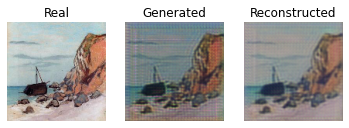

[INFO] Domain B to Domain A


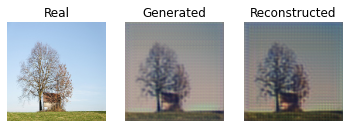

epoch: 16 step: 1 dA_loss: 0.002 dB_loss: 0.006 gAB_loss :5.034 gBA_loss: 5.299
epoch: 16 step: 2 dA_loss: 0.007 dB_loss: 0.001 gAB_loss :5.029 gBA_loss: 5.194
epoch: 16 step: 3 dA_loss: 0.105 dB_loss: 0.000 gAB_loss :5.155 gBA_loss: 5.502
epoch: 16 step: 4 dA_loss: 0.208 dB_loss: 0.000 gAB_loss :4.815 gBA_loss: 5.210
epoch: 16 step: 5 dA_loss: 0.056 dB_loss: 0.000 gAB_loss :5.382 gBA_loss: 5.914
epoch: 16 step: 6 dA_loss: 0.209 dB_loss: 0.077 gAB_loss :5.032 gBA_loss: 5.415
epoch: 16 step: 7 dA_loss: 0.008 dB_loss: 0.001 gAB_loss :5.423 gBA_loss: 5.578
epoch: 16 step: 8 dA_loss: 0.190 dB_loss: 0.007 gAB_loss :5.289 gBA_loss: 5.694
epoch: 16 step: 9 dA_loss: 0.011 dB_loss: 0.021 gAB_loss :6.037 gBA_loss: 5.976
epoch: 16 step: 10 dA_loss: 0.010 dB_loss: 0.001 gAB_loss :5.770 gBA_loss: 5.558
epoch: 16 step: 11 dA_loss: 0.007 dB_loss: 0.005 gAB_loss :5.338 gBA_loss: 5.209
epoch: 16 step: 12 dA_loss: 0.004 dB_loss: 0.099 gAB_loss :5.638 gBA_loss: 5.540
epoch: 16 step: 13 dA_loss: 0.006 dB_

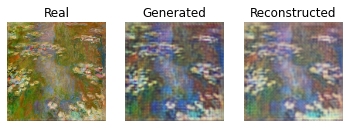

[INFO] Domain B to Domain A


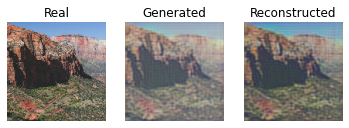

epoch: 16 step: 51 dA_loss: 0.006 dB_loss: 0.047 gAB_loss :5.184 gBA_loss: 5.211
epoch: 16 step: 52 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :5.353 gBA_loss: 5.079
epoch: 16 step: 53 dA_loss: 0.063 dB_loss: 0.016 gAB_loss :4.885 gBA_loss: 5.037
epoch: 16 step: 54 dA_loss: 0.059 dB_loss: 0.070 gAB_loss :4.864 gBA_loss: 5.210
epoch: 16 step: 55 dA_loss: 0.037 dB_loss: 0.067 gAB_loss :5.458 gBA_loss: 5.308
epoch: 16 step: 56 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :5.287 gBA_loss: 5.546
epoch: 16 step: 57 dA_loss: 0.125 dB_loss: 0.063 gAB_loss :5.007 gBA_loss: 5.256
epoch: 16 step: 58 dA_loss: 0.092 dB_loss: 0.003 gAB_loss :5.293 gBA_loss: 5.542
epoch: 16 step: 59 dA_loss: 0.007 dB_loss: 0.023 gAB_loss :4.824 gBA_loss: 5.049
epoch: 16 step: 60 dA_loss: 0.006 dB_loss: 0.002 gAB_loss :5.287 gBA_loss: 5.335
epoch: 16 step: 61 dA_loss: 0.029 dB_loss: 0.076 gAB_loss :5.346 gBA_loss: 5.141
epoch: 16 step: 62 dA_loss: 0.056 dB_loss: 0.001 gAB_loss :5.379 gBA_loss: 5.408
epoch: 16 step: 63 dA_loss: 

 17%|█▋        | 17/100 [28:15<2:15:33, 98.00s/it]

epoch: 16 step: 73 dA_loss: 0.040 dB_loss: 0.001 gAB_loss :5.395 gBA_loss: 5.378
epoch: 17 step: 0 dA_loss: 0.036 dB_loss: 0.152 gAB_loss :5.105 gBA_loss: 4.850
[INFO] Domain A to Domain B


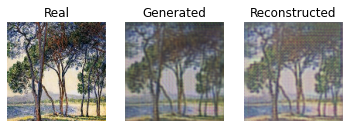

[INFO] Domain B to Domain A


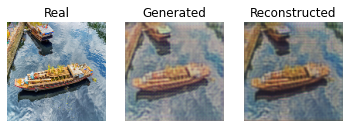

epoch: 17 step: 1 dA_loss: 0.089 dB_loss: 0.003 gAB_loss :4.891 gBA_loss: 5.156
epoch: 17 step: 2 dA_loss: 0.036 dB_loss: 0.006 gAB_loss :4.868 gBA_loss: 5.206
epoch: 17 step: 3 dA_loss: 0.064 dB_loss: 0.008 gAB_loss :5.016 gBA_loss: 5.433
epoch: 17 step: 4 dA_loss: 0.250 dB_loss: 0.004 gAB_loss :4.720 gBA_loss: 5.102
epoch: 17 step: 5 dA_loss: 0.051 dB_loss: 0.002 gAB_loss :5.318 gBA_loss: 5.800
epoch: 17 step: 6 dA_loss: 0.156 dB_loss: 0.074 gAB_loss :5.006 gBA_loss: 5.277
epoch: 17 step: 7 dA_loss: 0.022 dB_loss: 0.003 gAB_loss :5.399 gBA_loss: 5.435
epoch: 17 step: 8 dA_loss: 0.108 dB_loss: 0.011 gAB_loss :5.299 gBA_loss: 5.654
epoch: 17 step: 9 dA_loss: 0.029 dB_loss: 0.004 gAB_loss :5.933 gBA_loss: 6.052
epoch: 17 step: 10 dA_loss: 0.004 dB_loss: 0.004 gAB_loss :5.702 gBA_loss: 5.642
epoch: 17 step: 11 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :5.318 gBA_loss: 5.274
epoch: 17 step: 12 dA_loss: 0.001 dB_loss: 0.066 gAB_loss :5.535 gBA_loss: 5.770
epoch: 17 step: 13 dA_loss: 0.016 dB_

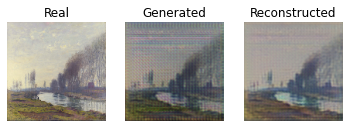

[INFO] Domain B to Domain A


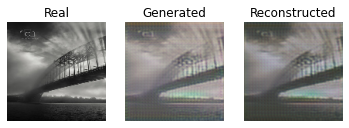

epoch: 17 step: 51 dA_loss: 0.027 dB_loss: 0.067 gAB_loss :5.249 gBA_loss: 5.214
epoch: 17 step: 52 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :5.276 gBA_loss: 5.015
epoch: 17 step: 53 dA_loss: 0.109 dB_loss: 0.001 gAB_loss :4.661 gBA_loss: 4.960
epoch: 17 step: 54 dA_loss: 0.074 dB_loss: 0.061 gAB_loss :4.680 gBA_loss: 5.165
epoch: 17 step: 55 dA_loss: 0.018 dB_loss: 0.062 gAB_loss :5.320 gBA_loss: 5.247
epoch: 17 step: 56 dA_loss: 0.022 dB_loss: 0.006 gAB_loss :5.180 gBA_loss: 5.451
epoch: 17 step: 57 dA_loss: 0.061 dB_loss: 0.002 gAB_loss :5.026 gBA_loss: 5.185
epoch: 17 step: 58 dA_loss: 0.125 dB_loss: 0.003 gAB_loss :5.422 gBA_loss: 5.480
epoch: 17 step: 59 dA_loss: 0.027 dB_loss: 0.000 gAB_loss :4.773 gBA_loss: 4.926
epoch: 17 step: 60 dA_loss: 0.018 dB_loss: 0.000 gAB_loss :5.199 gBA_loss: 5.243
epoch: 17 step: 61 dA_loss: 0.017 dB_loss: 0.063 gAB_loss :5.292 gBA_loss: 5.091
epoch: 17 step: 62 dA_loss: 0.054 dB_loss: 0.001 gAB_loss :5.337 gBA_loss: 5.341
epoch: 17 step: 63 dA_loss: 

 18%|█▊        | 18/100 [29:52<2:13:54, 97.98s/it]

epoch: 17 step: 73 dA_loss: 0.026 dB_loss: 0.001 gAB_loss :5.331 gBA_loss: 5.293
epoch: 18 step: 0 dA_loss: 0.062 dB_loss: 0.138 gAB_loss :5.089 gBA_loss: 5.008
[INFO] Domain A to Domain B


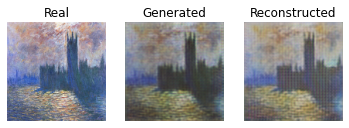

[INFO] Domain B to Domain A


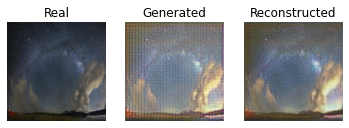

epoch: 18 step: 1 dA_loss: 0.008 dB_loss: 0.003 gAB_loss :4.852 gBA_loss: 5.193
epoch: 18 step: 2 dA_loss: 0.006 dB_loss: 0.004 gAB_loss :4.834 gBA_loss: 5.105
epoch: 18 step: 3 dA_loss: 0.060 dB_loss: 0.002 gAB_loss :4.989 gBA_loss: 5.297
epoch: 18 step: 4 dA_loss: 0.226 dB_loss: 0.001 gAB_loss :4.666 gBA_loss: 4.963
epoch: 18 step: 5 dA_loss: 0.035 dB_loss: 0.001 gAB_loss :5.259 gBA_loss: 5.615
epoch: 18 step: 6 dA_loss: 0.616 dB_loss: 0.103 gAB_loss :5.075 gBA_loss: 5.512
epoch: 18 step: 7 dA_loss: 0.014 dB_loss: 0.008 gAB_loss :5.363 gBA_loss: 5.633
epoch: 18 step: 8 dA_loss: 0.296 dB_loss: 0.064 gAB_loss :5.312 gBA_loss: 5.680
epoch: 18 step: 9 dA_loss: 0.130 dB_loss: 0.005 gAB_loss :5.932 gBA_loss: 5.901
epoch: 18 step: 10 dA_loss: 0.022 dB_loss: 0.001 gAB_loss :5.624 gBA_loss: 5.384
epoch: 18 step: 11 dA_loss: 0.064 dB_loss: 0.001 gAB_loss :5.195 gBA_loss: 4.995
epoch: 18 step: 12 dA_loss: 0.011 dB_loss: 0.061 gAB_loss :5.518 gBA_loss: 5.305
epoch: 18 step: 13 dA_loss: 0.119 dB_

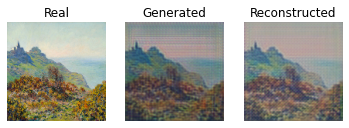

[INFO] Domain B to Domain A


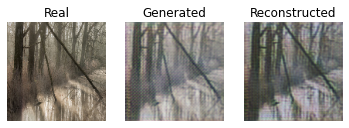

epoch: 18 step: 51 dA_loss: 0.065 dB_loss: 0.065 gAB_loss :5.218 gBA_loss: 5.062
epoch: 18 step: 52 dA_loss: 0.040 dB_loss: 0.021 gAB_loss :5.190 gBA_loss: 5.106
epoch: 18 step: 53 dA_loss: 0.101 dB_loss: 0.105 gAB_loss :4.805 gBA_loss: 4.992
epoch: 18 step: 54 dA_loss: 0.087 dB_loss: 0.117 gAB_loss :4.747 gBA_loss: 5.102
epoch: 18 step: 55 dA_loss: 0.007 dB_loss: 0.125 gAB_loss :5.278 gBA_loss: 5.090
epoch: 18 step: 56 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :5.075 gBA_loss: 5.337
epoch: 18 step: 57 dA_loss: 0.063 dB_loss: 0.011 gAB_loss :4.871 gBA_loss: 5.114
epoch: 18 step: 58 dA_loss: 0.127 dB_loss: 0.005 gAB_loss :5.316 gBA_loss: 5.467
epoch: 18 step: 59 dA_loss: 0.053 dB_loss: 0.004 gAB_loss :4.679 gBA_loss: 4.853
epoch: 18 step: 60 dA_loss: 0.034 dB_loss: 0.016 gAB_loss :5.185 gBA_loss: 5.321
epoch: 18 step: 61 dA_loss: 0.006 dB_loss: 0.129 gAB_loss :5.306 gBA_loss: 5.121
epoch: 18 step: 62 dA_loss: 0.054 dB_loss: 0.001 gAB_loss :5.335 gBA_loss: 5.313
epoch: 18 step: 63 dA_loss: 

 19%|█▉        | 19/100 [31:30<2:12:16, 97.98s/it]

epoch: 18 step: 73 dA_loss: 0.012 dB_loss: 0.005 gAB_loss :5.149 gBA_loss: 5.230
epoch: 19 step: 0 dA_loss: 0.090 dB_loss: 0.103 gAB_loss :4.939 gBA_loss: 4.979
[INFO] Domain A to Domain B


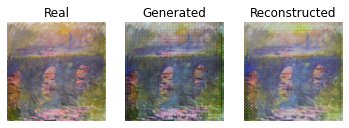

[INFO] Domain B to Domain A


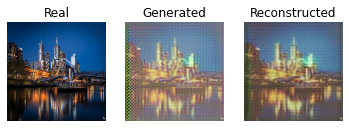

epoch: 19 step: 1 dA_loss: 0.039 dB_loss: 0.086 gAB_loss :4.934 gBA_loss: 5.105
epoch: 19 step: 2 dA_loss: 0.013 dB_loss: 0.055 gAB_loss :4.893 gBA_loss: 5.002
epoch: 19 step: 3 dA_loss: 0.121 dB_loss: 0.002 gAB_loss :4.984 gBA_loss: 5.329
epoch: 19 step: 4 dA_loss: 0.229 dB_loss: 0.001 gAB_loss :4.607 gBA_loss: 5.033
epoch: 19 step: 5 dA_loss: 0.018 dB_loss: 0.004 gAB_loss :5.153 gBA_loss: 5.752
epoch: 19 step: 6 dA_loss: 0.216 dB_loss: 0.075 gAB_loss :4.905 gBA_loss: 5.337
epoch: 19 step: 7 dA_loss: 0.008 dB_loss: 0.034 gAB_loss :5.359 gBA_loss: 5.315
epoch: 19 step: 8 dA_loss: 0.069 dB_loss: 0.062 gAB_loss :5.246 gBA_loss: 5.529
epoch: 19 step: 9 dA_loss: 0.010 dB_loss: 0.043 gAB_loss :5.820 gBA_loss: 5.851
epoch: 19 step: 10 dA_loss: 0.009 dB_loss: 0.029 gAB_loss :5.439 gBA_loss: 5.379
epoch: 19 step: 11 dA_loss: 0.032 dB_loss: 0.004 gAB_loss :5.000 gBA_loss: 5.075
epoch: 19 step: 12 dA_loss: 0.002 dB_loss: 0.057 gAB_loss :5.327 gBA_loss: 5.392
epoch: 19 step: 13 dA_loss: 0.117 dB_

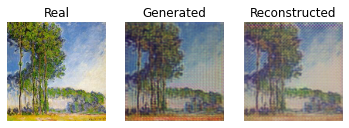

[INFO] Domain B to Domain A


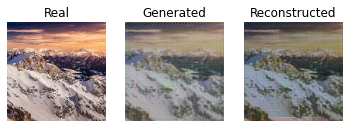

epoch: 19 step: 51 dA_loss: 0.196 dB_loss: 0.046 gAB_loss :4.955 gBA_loss: 5.132
epoch: 19 step: 52 dA_loss: 0.062 dB_loss: 0.277 gAB_loss :5.448 gBA_loss: 4.837
epoch: 19 step: 53 dA_loss: 0.132 dB_loss: 0.232 gAB_loss :4.703 gBA_loss: 4.695
epoch: 19 step: 54 dA_loss: 0.091 dB_loss: 0.139 gAB_loss :4.549 gBA_loss: 4.848
epoch: 19 step: 55 dA_loss: 0.023 dB_loss: 0.065 gAB_loss :5.136 gBA_loss: 4.894
epoch: 19 step: 56 dA_loss: 0.019 dB_loss: 0.011 gAB_loss :4.925 gBA_loss: 5.150
epoch: 19 step: 57 dA_loss: 0.096 dB_loss: 0.012 gAB_loss :4.772 gBA_loss: 4.888
epoch: 19 step: 58 dA_loss: 0.122 dB_loss: 0.014 gAB_loss :5.281 gBA_loss: 5.378
epoch: 19 step: 59 dA_loss: 0.055 dB_loss: 0.005 gAB_loss :4.654 gBA_loss: 4.864
epoch: 19 step: 60 dA_loss: 0.010 dB_loss: 0.008 gAB_loss :5.073 gBA_loss: 5.181
epoch: 19 step: 61 dA_loss: 0.029 dB_loss: 0.126 gAB_loss :5.182 gBA_loss: 5.016
epoch: 19 step: 62 dA_loss: 0.078 dB_loss: 0.006 gAB_loss :5.252 gBA_loss: 5.193
epoch: 19 step: 63 dA_loss: 

 20%|██        | 20/100 [33:08<2:10:36, 97.96s/it]

epoch: 19 step: 73 dA_loss: 0.060 dB_loss: 0.089 gAB_loss :4.774 gBA_loss: 5.171
epoch: 20 step: 0 dA_loss: 0.053 dB_loss: 0.178 gAB_loss :4.628 gBA_loss: 4.737
[INFO] Domain A to Domain B


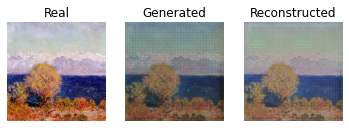

[INFO] Domain B to Domain A


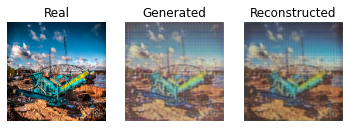

epoch: 20 step: 1 dA_loss: 0.071 dB_loss: 0.148 gAB_loss :4.594 gBA_loss: 5.021
epoch: 20 step: 2 dA_loss: 0.032 dB_loss: 0.038 gAB_loss :4.678 gBA_loss: 5.005
epoch: 20 step: 3 dA_loss: 0.058 dB_loss: 0.026 gAB_loss :4.861 gBA_loss: 5.212
epoch: 20 step: 4 dA_loss: 0.238 dB_loss: 0.011 gAB_loss :4.575 gBA_loss: 4.852
epoch: 20 step: 5 dA_loss: 0.150 dB_loss: 0.028 gAB_loss :5.194 gBA_loss: 5.862
epoch: 20 step: 6 dA_loss: 0.231 dB_loss: 0.152 gAB_loss :4.744 gBA_loss: 5.543
epoch: 20 step: 7 dA_loss: 0.004 dB_loss: 0.759 gAB_loss :5.436 gBA_loss: 5.476
epoch: 20 step: 8 dA_loss: 0.227 dB_loss: 0.124 gAB_loss :5.378 gBA_loss: 5.594
epoch: 20 step: 9 dA_loss: 0.035 dB_loss: 0.187 gAB_loss :5.863 gBA_loss: 5.885
epoch: 20 step: 10 dA_loss: 0.009 dB_loss: 0.250 gAB_loss :5.341 gBA_loss: 5.341
epoch: 20 step: 11 dA_loss: 0.008 dB_loss: 0.067 gAB_loss :4.786 gBA_loss: 4.970
epoch: 20 step: 12 dA_loss: 0.004 dB_loss: 0.095 gAB_loss :5.094 gBA_loss: 5.275
epoch: 20 step: 13 dA_loss: 0.059 dB_

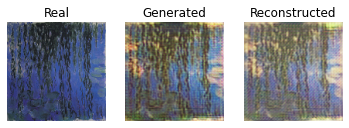

[INFO] Domain B to Domain A


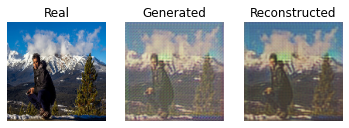

epoch: 20 step: 51 dA_loss: 0.146 dB_loss: 0.060 gAB_loss :5.087 gBA_loss: 4.979
epoch: 20 step: 52 dA_loss: 0.015 dB_loss: 0.007 gAB_loss :5.139 gBA_loss: 4.751
epoch: 20 step: 53 dA_loss: 0.123 dB_loss: 0.014 gAB_loss :4.579 gBA_loss: 4.658
epoch: 20 step: 54 dA_loss: 0.106 dB_loss: 0.065 gAB_loss :4.575 gBA_loss: 4.808
epoch: 20 step: 55 dA_loss: 0.016 dB_loss: 0.066 gAB_loss :5.224 gBA_loss: 4.845
epoch: 20 step: 56 dA_loss: 0.040 dB_loss: 0.001 gAB_loss :5.005 gBA_loss: 5.048
epoch: 20 step: 57 dA_loss: 0.074 dB_loss: 0.042 gAB_loss :4.789 gBA_loss: 4.849
epoch: 20 step: 58 dA_loss: 0.087 dB_loss: 0.003 gAB_loss :5.221 gBA_loss: 5.271
epoch: 20 step: 59 dA_loss: 0.051 dB_loss: 0.003 gAB_loss :4.526 gBA_loss: 4.724
epoch: 20 step: 60 dA_loss: 0.029 dB_loss: 0.011 gAB_loss :5.019 gBA_loss: 5.180
epoch: 20 step: 61 dA_loss: 0.029 dB_loss: 0.076 gAB_loss :5.179 gBA_loss: 5.044
epoch: 20 step: 62 dA_loss: 0.060 dB_loss: 0.001 gAB_loss :5.249 gBA_loss: 5.175
epoch: 20 step: 63 dA_loss: 

 21%|██        | 21/100 [34:46<2:08:59, 97.97s/it]

epoch: 20 step: 73 dA_loss: 0.026 dB_loss: 0.001 gAB_loss :5.088 gBA_loss: 5.016
epoch: 21 step: 0 dA_loss: 0.097 dB_loss: 0.115 gAB_loss :4.903 gBA_loss: 4.752
[INFO] Domain A to Domain B


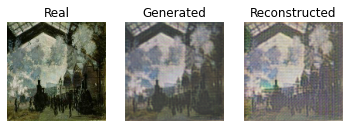

[INFO] Domain B to Domain A


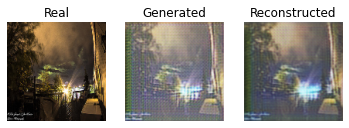

epoch: 21 step: 1 dA_loss: 0.122 dB_loss: 0.016 gAB_loss :4.708 gBA_loss: 4.930
epoch: 21 step: 2 dA_loss: 0.009 dB_loss: 0.004 gAB_loss :4.729 gBA_loss: 4.878
epoch: 21 step: 3 dA_loss: 0.077 dB_loss: 0.002 gAB_loss :4.915 gBA_loss: 5.135
epoch: 21 step: 4 dA_loss: 0.198 dB_loss: 0.001 gAB_loss :4.601 gBA_loss: 4.875
epoch: 21 step: 5 dA_loss: 0.045 dB_loss: 0.028 gAB_loss :5.065 gBA_loss: 5.605
epoch: 21 step: 6 dA_loss: 0.208 dB_loss: 0.105 gAB_loss :4.631 gBA_loss: 5.278
epoch: 21 step: 7 dA_loss: 0.012 dB_loss: 0.298 gAB_loss :5.294 gBA_loss: 5.162
epoch: 21 step: 8 dA_loss: 0.104 dB_loss: 0.307 gAB_loss :5.163 gBA_loss: 5.417
epoch: 21 step: 9 dA_loss: 0.037 dB_loss: 0.272 gAB_loss :5.639 gBA_loss: 5.851
epoch: 21 step: 10 dA_loss: 0.005 dB_loss: 0.578 gAB_loss :5.072 gBA_loss: 5.337
epoch: 21 step: 11 dA_loss: 0.003 dB_loss: 0.388 gAB_loss :4.489 gBA_loss: 4.964
epoch: 21 step: 12 dA_loss: 0.002 dB_loss: 0.374 gAB_loss :4.765 gBA_loss: 5.229
epoch: 21 step: 13 dA_loss: 0.112 dB_

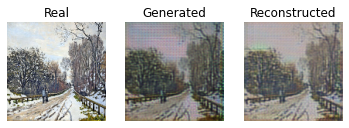

[INFO] Domain B to Domain A


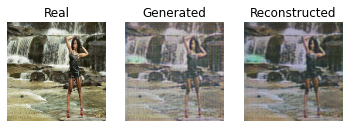

epoch: 21 step: 51 dA_loss: 0.005 dB_loss: 0.065 gAB_loss :5.034 gBA_loss: 5.014
epoch: 21 step: 52 dA_loss: 0.003 dB_loss: 0.022 gAB_loss :4.993 gBA_loss: 4.875
epoch: 21 step: 53 dA_loss: 0.118 dB_loss: 0.162 gAB_loss :4.740 gBA_loss: 4.728
epoch: 21 step: 54 dA_loss: 0.063 dB_loss: 0.332 gAB_loss :4.576 gBA_loss: 4.908
epoch: 21 step: 55 dA_loss: 0.003 dB_loss: 0.127 gAB_loss :5.091 gBA_loss: 4.916
epoch: 21 step: 56 dA_loss: 0.031 dB_loss: 0.050 gAB_loss :4.701 gBA_loss: 5.101
epoch: 21 step: 57 dA_loss: 0.059 dB_loss: 0.094 gAB_loss :4.747 gBA_loss: 4.825
epoch: 21 step: 58 dA_loss: 0.065 dB_loss: 0.014 gAB_loss :5.238 gBA_loss: 5.290
epoch: 21 step: 59 dA_loss: 0.057 dB_loss: 0.017 gAB_loss :4.541 gBA_loss: 4.710
epoch: 21 step: 60 dA_loss: 0.005 dB_loss: 0.063 gAB_loss :4.952 gBA_loss: 5.059
epoch: 21 step: 61 dA_loss: 0.016 dB_loss: 0.113 gAB_loss :5.063 gBA_loss: 4.905
epoch: 21 step: 62 dA_loss: 0.083 dB_loss: 0.014 gAB_loss :5.061 gBA_loss: 5.178
epoch: 21 step: 63 dA_loss: 

 22%|██▏       | 22/100 [36:24<2:07:20, 97.96s/it]

epoch: 21 step: 73 dA_loss: 0.101 dB_loss: 0.003 gAB_loss :5.040 gBA_loss: 4.909
epoch: 22 step: 0 dA_loss: 0.138 dB_loss: 0.117 gAB_loss :4.887 gBA_loss: 4.462
[INFO] Domain A to Domain B


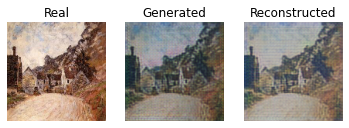

[INFO] Domain B to Domain A


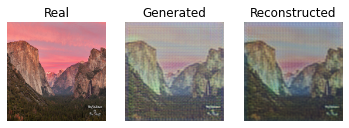

epoch: 22 step: 1 dA_loss: 0.264 dB_loss: 0.006 gAB_loss :4.614 gBA_loss: 4.642
epoch: 22 step: 2 dA_loss: 0.449 dB_loss: 0.050 gAB_loss :4.692 gBA_loss: 4.899
epoch: 22 step: 3 dA_loss: 0.123 dB_loss: 0.004 gAB_loss :4.843 gBA_loss: 5.157
epoch: 22 step: 4 dA_loss: 0.426 dB_loss: 0.004 gAB_loss :4.526 gBA_loss: 4.824
epoch: 22 step: 5 dA_loss: 0.085 dB_loss: 0.020 gAB_loss :5.004 gBA_loss: 5.489
epoch: 22 step: 6 dA_loss: 0.258 dB_loss: 0.150 gAB_loss :4.831 gBA_loss: 5.091
epoch: 22 step: 7 dA_loss: 0.033 dB_loss: 0.008 gAB_loss :5.099 gBA_loss: 4.978
epoch: 22 step: 8 dA_loss: 0.125 dB_loss: 0.067 gAB_loss :5.121 gBA_loss: 5.254
epoch: 22 step: 9 dA_loss: 0.040 dB_loss: 0.022 gAB_loss :5.582 gBA_loss: 5.707
epoch: 22 step: 10 dA_loss: 0.019 dB_loss: 0.129 gAB_loss :5.520 gBA_loss: 5.212
epoch: 22 step: 11 dA_loss: 0.014 dB_loss: 0.188 gAB_loss :5.022 gBA_loss: 4.826
epoch: 22 step: 12 dA_loss: 0.006 dB_loss: 0.250 gAB_loss :5.260 gBA_loss: 5.116
epoch: 22 step: 13 dA_loss: 0.130 dB_

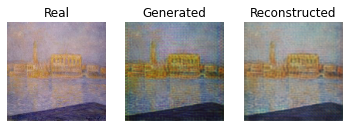

[INFO] Domain B to Domain A


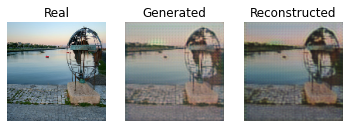

epoch: 22 step: 51 dA_loss: 0.011 dB_loss: 0.254 gAB_loss :4.753 gBA_loss: 4.854
epoch: 22 step: 52 dA_loss: 0.011 dB_loss: 0.120 gAB_loss :4.587 gBA_loss: 4.673
epoch: 22 step: 53 dA_loss: 0.121 dB_loss: 0.192 gAB_loss :4.171 gBA_loss: 4.564
epoch: 22 step: 54 dA_loss: 0.065 dB_loss: 0.093 gAB_loss :4.341 gBA_loss: 4.779
epoch: 22 step: 55 dA_loss: 0.007 dB_loss: 0.075 gAB_loss :5.066 gBA_loss: 4.850
epoch: 22 step: 56 dA_loss: 0.049 dB_loss: 0.033 gAB_loss :4.825 gBA_loss: 5.048
epoch: 22 step: 57 dA_loss: 0.094 dB_loss: 0.063 gAB_loss :4.633 gBA_loss: 4.711
epoch: 22 step: 58 dA_loss: 0.155 dB_loss: 0.050 gAB_loss :5.076 gBA_loss: 5.318
epoch: 22 step: 59 dA_loss: 0.060 dB_loss: 0.018 gAB_loss :4.364 gBA_loss: 4.695
epoch: 22 step: 60 dA_loss: 0.024 dB_loss: 0.043 gAB_loss :4.867 gBA_loss: 5.012
epoch: 22 step: 61 dA_loss: 0.059 dB_loss: 0.136 gAB_loss :5.083 gBA_loss: 4.912
epoch: 22 step: 62 dA_loss: 0.090 dB_loss: 0.012 gAB_loss :5.086 gBA_loss: 5.017
epoch: 22 step: 63 dA_loss: 

 23%|██▎       | 23/100 [38:02<2:05:40, 97.92s/it]

epoch: 22 step: 73 dA_loss: 0.043 dB_loss: 0.001 gAB_loss :5.027 gBA_loss: 4.775
epoch: 23 step: 0 dA_loss: 0.464 dB_loss: 0.122 gAB_loss :4.933 gBA_loss: 4.866
[INFO] Domain A to Domain B


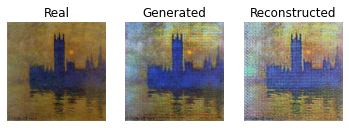

[INFO] Domain B to Domain A


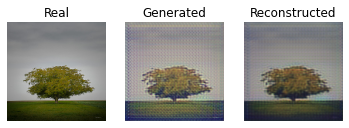

epoch: 23 step: 1 dA_loss: 0.146 dB_loss: 0.002 gAB_loss :4.652 gBA_loss: 4.902
epoch: 23 step: 2 dA_loss: 0.101 dB_loss: 0.021 gAB_loss :4.602 gBA_loss: 4.724
epoch: 23 step: 3 dA_loss: 0.089 dB_loss: 0.008 gAB_loss :4.790 gBA_loss: 4.922
epoch: 23 step: 4 dA_loss: 0.293 dB_loss: 0.003 gAB_loss :4.545 gBA_loss: 4.671
epoch: 23 step: 5 dA_loss: 0.085 dB_loss: 0.031 gAB_loss :4.926 gBA_loss: 5.590
epoch: 23 step: 6 dA_loss: 0.211 dB_loss: 0.404 gAB_loss :5.093 gBA_loss: 5.241
epoch: 23 step: 7 dA_loss: 0.012 dB_loss: 0.220 gAB_loss :5.187 gBA_loss: 5.104
epoch: 23 step: 8 dA_loss: 0.196 dB_loss: 0.089 gAB_loss :5.068 gBA_loss: 5.320
epoch: 23 step: 9 dA_loss: 0.022 dB_loss: 0.065 gAB_loss :5.608 gBA_loss: 5.670
epoch: 23 step: 10 dA_loss: 0.045 dB_loss: 0.023 gAB_loss :5.201 gBA_loss: 5.180
epoch: 23 step: 11 dA_loss: 0.026 dB_loss: 0.048 gAB_loss :4.767 gBA_loss: 4.923
epoch: 23 step: 12 dA_loss: 0.003 dB_loss: 0.125 gAB_loss :5.159 gBA_loss: 5.198
epoch: 23 step: 13 dA_loss: 0.126 dB_

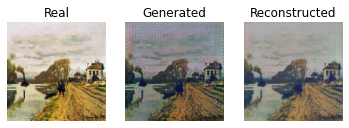

[INFO] Domain B to Domain A


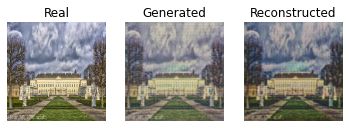

epoch: 23 step: 51 dA_loss: 0.048 dB_loss: 0.067 gAB_loss :4.946 gBA_loss: 4.782
epoch: 23 step: 52 dA_loss: 0.016 dB_loss: 0.047 gAB_loss :4.949 gBA_loss: 4.588
epoch: 23 step: 53 dA_loss: 0.121 dB_loss: 0.008 gAB_loss :4.289 gBA_loss: 4.491
epoch: 23 step: 54 dA_loss: 0.065 dB_loss: 0.063 gAB_loss :4.338 gBA_loss: 4.706
epoch: 23 step: 55 dA_loss: 0.006 dB_loss: 0.064 gAB_loss :5.024 gBA_loss: 4.788
epoch: 23 step: 56 dA_loss: 0.057 dB_loss: 0.005 gAB_loss :4.796 gBA_loss: 4.988
epoch: 23 step: 57 dA_loss: 0.110 dB_loss: 0.035 gAB_loss :4.612 gBA_loss: 4.722
epoch: 23 step: 58 dA_loss: 0.070 dB_loss: 0.016 gAB_loss :5.180 gBA_loss: 5.084
epoch: 23 step: 59 dA_loss: 0.139 dB_loss: 0.006 gAB_loss :4.501 gBA_loss: 4.612
epoch: 23 step: 60 dA_loss: 0.005 dB_loss: 0.003 gAB_loss :4.904 gBA_loss: 4.961
epoch: 23 step: 61 dA_loss: 0.061 dB_loss: 0.080 gAB_loss :5.096 gBA_loss: 4.885
epoch: 23 step: 62 dA_loss: 0.147 dB_loss: 0.020 gAB_loss :4.977 gBA_loss: 4.999
epoch: 23 step: 63 dA_loss: 

 24%|██▍       | 24/100 [39:40<2:03:59, 97.89s/it]

epoch: 23 step: 73 dA_loss: 0.126 dB_loss: 0.002 gAB_loss :4.973 gBA_loss: 5.067
epoch: 24 step: 0 dA_loss: 0.066 dB_loss: 0.127 gAB_loss :4.829 gBA_loss: 4.759
[INFO] Domain A to Domain B


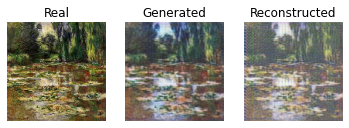

[INFO] Domain B to Domain A


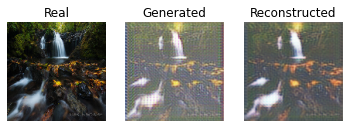

epoch: 24 step: 1 dA_loss: 0.051 dB_loss: 0.011 gAB_loss :4.546 gBA_loss: 4.669
epoch: 24 step: 2 dA_loss: 0.037 dB_loss: 0.007 gAB_loss :4.596 gBA_loss: 4.643
epoch: 24 step: 3 dA_loss: 0.156 dB_loss: 0.002 gAB_loss :4.795 gBA_loss: 5.060
epoch: 24 step: 4 dA_loss: 0.281 dB_loss: 0.001 gAB_loss :4.510 gBA_loss: 4.777
epoch: 24 step: 5 dA_loss: 0.031 dB_loss: 0.043 gAB_loss :4.938 gBA_loss: 5.459
epoch: 24 step: 6 dA_loss: 0.211 dB_loss: 0.139 gAB_loss :4.507 gBA_loss: 5.181
epoch: 24 step: 7 dA_loss: 0.031 dB_loss: 0.420 gAB_loss :5.140 gBA_loss: 5.030
epoch: 24 step: 8 dA_loss: 0.091 dB_loss: 0.234 gAB_loss :5.125 gBA_loss: 5.347
epoch: 24 step: 9 dA_loss: 0.018 dB_loss: 0.243 gAB_loss :5.598 gBA_loss: 5.710
epoch: 24 step: 10 dA_loss: 0.019 dB_loss: 0.580 gAB_loss :5.025 gBA_loss: 5.151
epoch: 24 step: 11 dA_loss: 0.020 dB_loss: 0.422 gAB_loss :4.465 gBA_loss: 4.797
epoch: 24 step: 12 dA_loss: 0.007 dB_loss: 0.358 gAB_loss :4.729 gBA_loss: 5.079
epoch: 24 step: 13 dA_loss: 0.102 dB_

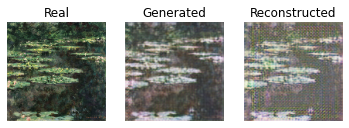

[INFO] Domain B to Domain A


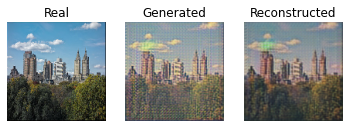

epoch: 24 step: 51 dA_loss: 0.006 dB_loss: 0.099 gAB_loss :4.898 gBA_loss: 4.904
epoch: 24 step: 52 dA_loss: 0.002 dB_loss: 0.056 gAB_loss :4.777 gBA_loss: 4.685
epoch: 24 step: 53 dA_loss: 0.117 dB_loss: 0.056 gAB_loss :4.240 gBA_loss: 4.488
epoch: 24 step: 54 dA_loss: 0.068 dB_loss: 0.064 gAB_loss :4.310 gBA_loss: 4.670
epoch: 24 step: 55 dA_loss: 0.008 dB_loss: 0.063 gAB_loss :5.028 gBA_loss: 4.739
epoch: 24 step: 56 dA_loss: 0.047 dB_loss: 0.003 gAB_loss :4.765 gBA_loss: 4.907
epoch: 24 step: 57 dA_loss: 0.060 dB_loss: 0.049 gAB_loss :4.602 gBA_loss: 4.604
epoch: 24 step: 58 dA_loss: 0.092 dB_loss: 0.020 gAB_loss :5.079 gBA_loss: 5.229
epoch: 24 step: 59 dA_loss: 0.061 dB_loss: 0.005 gAB_loss :4.313 gBA_loss: 4.599
epoch: 24 step: 60 dA_loss: 0.007 dB_loss: 0.056 gAB_loss :4.837 gBA_loss: 4.922
epoch: 24 step: 61 dA_loss: 0.060 dB_loss: 0.096 gAB_loss :5.073 gBA_loss: 4.855
epoch: 24 step: 62 dA_loss: 0.071 dB_loss: 0.059 gAB_loss :5.032 gBA_loss: 4.907
epoch: 24 step: 63 dA_loss: 

 25%|██▌       | 25/100 [41:18<2:02:29, 98.00s/it]

epoch: 24 step: 73 dA_loss: 0.102 dB_loss: 0.056 gAB_loss :4.704 gBA_loss: 4.776
epoch: 25 step: 0 dA_loss: 0.133 dB_loss: 0.148 gAB_loss :4.709 gBA_loss: 4.707
[INFO] Domain A to Domain B


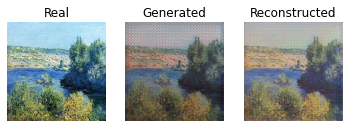

[INFO] Domain B to Domain A


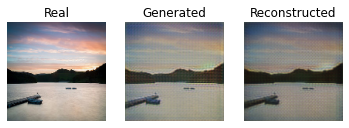

epoch: 25 step: 1 dA_loss: 0.027 dB_loss: 0.055 gAB_loss :4.510 gBA_loss: 4.787
epoch: 25 step: 2 dA_loss: 0.022 dB_loss: 0.018 gAB_loss :4.531 gBA_loss: 4.761
epoch: 25 step: 3 dA_loss: 0.059 dB_loss: 0.048 gAB_loss :4.697 gBA_loss: 4.974
epoch: 25 step: 4 dA_loss: 0.227 dB_loss: 0.014 gAB_loss :4.373 gBA_loss: 4.587
epoch: 25 step: 5 dA_loss: 0.086 dB_loss: 0.053 gAB_loss :4.854 gBA_loss: 5.497
epoch: 25 step: 6 dA_loss: 0.211 dB_loss: 0.174 gAB_loss :4.483 gBA_loss: 5.181
epoch: 25 step: 7 dA_loss: 0.010 dB_loss: 0.417 gAB_loss :5.105 gBA_loss: 4.989
epoch: 25 step: 8 dA_loss: 0.190 dB_loss: 0.156 gAB_loss :5.120 gBA_loss: 5.274
epoch: 25 step: 9 dA_loss: 0.048 dB_loss: 0.196 gAB_loss :5.594 gBA_loss: 5.615
epoch: 25 step: 10 dA_loss: 0.012 dB_loss: 0.444 gAB_loss :5.049 gBA_loss: 5.029
epoch: 25 step: 11 dA_loss: 0.018 dB_loss: 0.218 gAB_loss :4.485 gBA_loss: 4.656
epoch: 25 step: 12 dA_loss: 0.023 dB_loss: 0.133 gAB_loss :4.776 gBA_loss: 4.968
epoch: 25 step: 13 dA_loss: 0.039 dB_

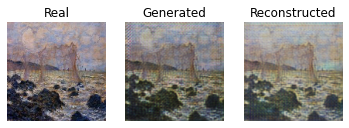

[INFO] Domain B to Domain A


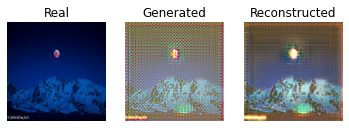

epoch: 25 step: 51 dA_loss: 0.005 dB_loss: 0.104 gAB_loss :4.762 gBA_loss: 4.829
epoch: 25 step: 52 dA_loss: 0.003 dB_loss: 0.059 gAB_loss :4.733 gBA_loss: 4.585
epoch: 25 step: 53 dA_loss: 0.123 dB_loss: 0.025 gAB_loss :4.055 gBA_loss: 4.421
epoch: 25 step: 54 dA_loss: 0.063 dB_loss: 0.090 gAB_loss :4.205 gBA_loss: 4.571
epoch: 25 step: 55 dA_loss: 0.007 dB_loss: 0.068 gAB_loss :4.952 gBA_loss: 4.665
epoch: 25 step: 56 dA_loss: 0.057 dB_loss: 0.006 gAB_loss :4.720 gBA_loss: 4.839
epoch: 25 step: 57 dA_loss: 0.076 dB_loss: 0.060 gAB_loss :4.579 gBA_loss: 4.646
epoch: 25 step: 58 dA_loss: 0.056 dB_loss: 0.028 gAB_loss :5.030 gBA_loss: 5.174
epoch: 25 step: 59 dA_loss: 0.057 dB_loss: 0.043 gAB_loss :4.376 gBA_loss: 4.493
epoch: 25 step: 60 dA_loss: 0.011 dB_loss: 0.038 gAB_loss :4.763 gBA_loss: 4.839
epoch: 25 step: 61 dA_loss: 0.051 dB_loss: 0.085 gAB_loss :4.996 gBA_loss: 4.806
epoch: 25 step: 62 dA_loss: 0.060 dB_loss: 0.034 gAB_loss :4.901 gBA_loss: 4.926
epoch: 25 step: 63 dA_loss: 

 26%|██▌       | 26/100 [42:56<2:00:48, 97.95s/it]

epoch: 25 step: 73 dA_loss: 0.047 dB_loss: 0.021 gAB_loss :4.732 gBA_loss: 4.811
epoch: 26 step: 0 dA_loss: 0.278 dB_loss: 0.209 gAB_loss :4.916 gBA_loss: 4.758
[INFO] Domain A to Domain B


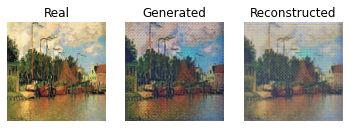

[INFO] Domain B to Domain A


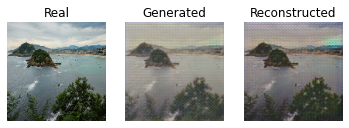

epoch: 26 step: 1 dA_loss: 0.155 dB_loss: 0.090 gAB_loss :4.573 gBA_loss: 4.741
epoch: 26 step: 2 dA_loss: 0.106 dB_loss: 0.057 gAB_loss :4.437 gBA_loss: 4.570
epoch: 26 step: 3 dA_loss: 0.174 dB_loss: 0.061 gAB_loss :4.714 gBA_loss: 5.031
epoch: 26 step: 4 dA_loss: 0.419 dB_loss: 0.087 gAB_loss :4.775 gBA_loss: 4.849
epoch: 26 step: 5 dA_loss: 0.086 dB_loss: 0.058 gAB_loss :5.243 gBA_loss: 5.573
epoch: 26 step: 6 dA_loss: 0.265 dB_loss: 0.307 gAB_loss :4.942 gBA_loss: 5.185
epoch: 26 step: 7 dA_loss: 0.077 dB_loss: 0.144 gAB_loss :4.939 gBA_loss: 5.169
epoch: 26 step: 8 dA_loss: 0.136 dB_loss: 0.060 gAB_loss :4.894 gBA_loss: 5.399
epoch: 26 step: 9 dA_loss: 0.067 dB_loss: 0.093 gAB_loss :5.398 gBA_loss: 5.539
epoch: 26 step: 10 dA_loss: 0.198 dB_loss: 0.045 gAB_loss :5.131 gBA_loss: 5.193
epoch: 26 step: 11 dA_loss: 0.019 dB_loss: 0.051 gAB_loss :4.750 gBA_loss: 4.767
epoch: 26 step: 12 dA_loss: 0.006 dB_loss: 0.118 gAB_loss :5.096 gBA_loss: 4.999
epoch: 26 step: 13 dA_loss: 0.122 dB_

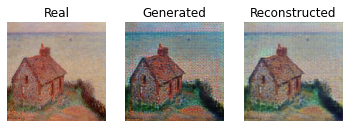

[INFO] Domain B to Domain A


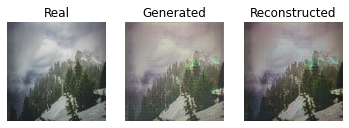

epoch: 26 step: 51 dA_loss: 0.005 dB_loss: 0.180 gAB_loss :4.810 gBA_loss: 4.782
epoch: 26 step: 52 dA_loss: 0.006 dB_loss: 0.095 gAB_loss :4.732 gBA_loss: 4.560
epoch: 26 step: 53 dA_loss: 0.110 dB_loss: 0.041 gAB_loss :4.112 gBA_loss: 4.393
epoch: 26 step: 54 dA_loss: 0.066 dB_loss: 0.075 gAB_loss :4.233 gBA_loss: 4.601
epoch: 26 step: 55 dA_loss: 0.007 dB_loss: 0.074 gAB_loss :4.963 gBA_loss: 4.661
epoch: 26 step: 56 dA_loss: 0.062 dB_loss: 0.025 gAB_loss :4.721 gBA_loss: 4.847
epoch: 26 step: 57 dA_loss: 0.060 dB_loss: 0.076 gAB_loss :4.579 gBA_loss: 4.604
epoch: 26 step: 58 dA_loss: 0.061 dB_loss: 0.021 gAB_loss :5.037 gBA_loss: 5.149
epoch: 26 step: 59 dA_loss: 0.067 dB_loss: 0.017 gAB_loss :4.301 gBA_loss: 4.539
epoch: 26 step: 60 dA_loss: 0.004 dB_loss: 0.032 gAB_loss :4.707 gBA_loss: 4.874
epoch: 26 step: 61 dA_loss: 0.049 dB_loss: 0.074 gAB_loss :5.007 gBA_loss: 4.847
epoch: 26 step: 62 dA_loss: 0.059 dB_loss: 0.012 gAB_loss :4.971 gBA_loss: 4.839
epoch: 26 step: 63 dA_loss: 

 27%|██▋       | 27/100 [44:34<1:59:07, 97.91s/it]

epoch: 26 step: 73 dA_loss: 0.022 dB_loss: 0.071 gAB_loss :4.795 gBA_loss: 4.821
epoch: 27 step: 0 dA_loss: 0.081 dB_loss: 0.203 gAB_loss :4.666 gBA_loss: 4.685
[INFO] Domain A to Domain B


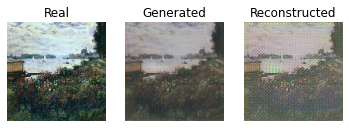

[INFO] Domain B to Domain A


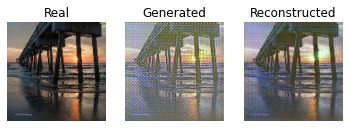

epoch: 27 step: 1 dA_loss: 0.078 dB_loss: 0.025 gAB_loss :4.277 gBA_loss: 4.529
epoch: 27 step: 2 dA_loss: 0.318 dB_loss: 0.058 gAB_loss :4.441 gBA_loss: 4.868
epoch: 27 step: 3 dA_loss: 0.212 dB_loss: 0.028 gAB_loss :4.631 gBA_loss: 4.998
epoch: 27 step: 4 dA_loss: 0.486 dB_loss: 0.006 gAB_loss :4.308 gBA_loss: 4.528
epoch: 27 step: 5 dA_loss: 0.155 dB_loss: 0.056 gAB_loss :4.807 gBA_loss: 5.169
epoch: 27 step: 6 dA_loss: 0.285 dB_loss: 0.240 gAB_loss :4.587 gBA_loss: 4.797
epoch: 27 step: 7 dA_loss: 0.064 dB_loss: 0.018 gAB_loss :4.629 gBA_loss: 4.592
epoch: 27 step: 8 dA_loss: 0.108 dB_loss: 0.055 gAB_loss :4.782 gBA_loss: 5.150
epoch: 27 step: 9 dA_loss: 0.097 dB_loss: 0.159 gAB_loss :5.491 gBA_loss: 5.562
epoch: 27 step: 10 dA_loss: 0.049 dB_loss: 0.105 gAB_loss :5.123 gBA_loss: 5.010
epoch: 27 step: 11 dA_loss: 0.015 dB_loss: 0.157 gAB_loss :4.652 gBA_loss: 4.555
epoch: 27 step: 12 dA_loss: 0.008 dB_loss: 0.121 gAB_loss :4.943 gBA_loss: 4.819
epoch: 27 step: 13 dA_loss: 0.078 dB_

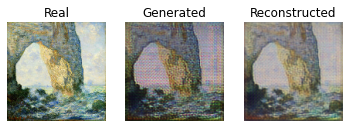

[INFO] Domain B to Domain A


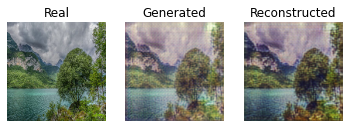

epoch: 27 step: 51 dA_loss: 0.005 dB_loss: 0.086 gAB_loss :4.801 gBA_loss: 4.772
epoch: 27 step: 52 dA_loss: 0.004 dB_loss: 0.045 gAB_loss :4.822 gBA_loss: 4.564
epoch: 27 step: 53 dA_loss: 0.223 dB_loss: 0.010 gAB_loss :4.142 gBA_loss: 4.301
epoch: 27 step: 54 dA_loss: 0.065 dB_loss: 0.067 gAB_loss :4.182 gBA_loss: 4.452
epoch: 27 step: 55 dA_loss: 0.058 dB_loss: 0.068 gAB_loss :4.871 gBA_loss: 4.631
epoch: 27 step: 56 dA_loss: 0.057 dB_loss: 0.047 gAB_loss :4.723 gBA_loss: 4.798
epoch: 27 step: 57 dA_loss: 0.092 dB_loss: 0.125 gAB_loss :4.580 gBA_loss: 4.558
epoch: 27 step: 58 dA_loss: 0.067 dB_loss: 0.029 gAB_loss :4.934 gBA_loss: 5.040
epoch: 27 step: 59 dA_loss: 0.056 dB_loss: 0.020 gAB_loss :4.168 gBA_loss: 4.354
epoch: 27 step: 60 dA_loss: 0.013 dB_loss: 0.092 gAB_loss :4.680 gBA_loss: 4.667
epoch: 27 step: 61 dA_loss: 0.068 dB_loss: 0.071 gAB_loss :4.984 gBA_loss: 4.767
epoch: 27 step: 62 dA_loss: 0.057 dB_loss: 0.054 gAB_loss :4.928 gBA_loss: 4.809
epoch: 27 step: 63 dA_loss: 

 28%|██▊       | 28/100 [46:12<1:57:27, 97.89s/it]

epoch: 27 step: 73 dA_loss: 0.059 dB_loss: 0.115 gAB_loss :4.808 gBA_loss: 4.633
epoch: 28 step: 0 dA_loss: 0.140 dB_loss: 0.236 gAB_loss :4.764 gBA_loss: 4.536
[INFO] Domain A to Domain B


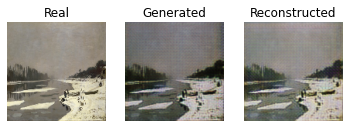

[INFO] Domain B to Domain A


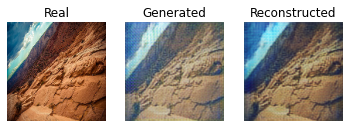

epoch: 28 step: 1 dA_loss: 0.054 dB_loss: 0.013 gAB_loss :4.339 gBA_loss: 4.525
epoch: 28 step: 2 dA_loss: 0.026 dB_loss: 0.011 gAB_loss :4.314 gBA_loss: 4.542
epoch: 28 step: 3 dA_loss: 0.074 dB_loss: 0.022 gAB_loss :4.550 gBA_loss: 4.903
epoch: 28 step: 4 dA_loss: 0.246 dB_loss: 0.007 gAB_loss :4.302 gBA_loss: 4.610
epoch: 28 step: 5 dA_loss: 0.010 dB_loss: 0.038 gAB_loss :4.752 gBA_loss: 5.323
epoch: 28 step: 6 dA_loss: 0.207 dB_loss: 0.195 gAB_loss :4.697 gBA_loss: 4.976
epoch: 28 step: 7 dA_loss: 0.143 dB_loss: 0.025 gAB_loss :4.957 gBA_loss: 4.932
epoch: 28 step: 8 dA_loss: 0.119 dB_loss: 0.062 gAB_loss :4.989 gBA_loss: 5.280
epoch: 28 step: 9 dA_loss: 0.084 dB_loss: 0.062 gAB_loss :5.455 gBA_loss: 5.601
epoch: 28 step: 10 dA_loss: 0.111 dB_loss: 0.061 gAB_loss :5.044 gBA_loss: 4.957
epoch: 28 step: 11 dA_loss: 0.010 dB_loss: 0.099 gAB_loss :4.559 gBA_loss: 4.533
epoch: 28 step: 12 dA_loss: 0.013 dB_loss: 0.119 gAB_loss :4.864 gBA_loss: 4.762
epoch: 28 step: 13 dA_loss: 0.075 dB_

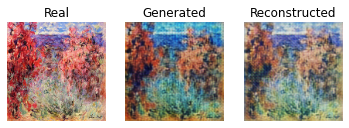

[INFO] Domain B to Domain A


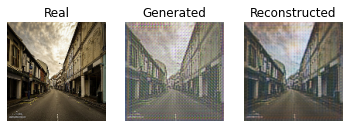

epoch: 28 step: 51 dA_loss: 0.007 dB_loss: 0.227 gAB_loss :4.630 gBA_loss: 4.748
epoch: 28 step: 52 dA_loss: 0.011 dB_loss: 0.189 gAB_loss :4.603 gBA_loss: 4.548
epoch: 28 step: 53 dA_loss: 0.131 dB_loss: 0.061 gAB_loss :3.984 gBA_loss: 4.355
epoch: 28 step: 54 dA_loss: 0.069 dB_loss: 0.096 gAB_loss :4.066 gBA_loss: 4.600
epoch: 28 step: 55 dA_loss: 0.017 dB_loss: 0.111 gAB_loss :4.816 gBA_loss: 4.631
epoch: 28 step: 56 dA_loss: 0.069 dB_loss: 0.074 gAB_loss :4.655 gBA_loss: 4.862
epoch: 28 step: 57 dA_loss: 0.074 dB_loss: 0.112 gAB_loss :4.514 gBA_loss: 4.587
epoch: 28 step: 58 dA_loss: 0.052 dB_loss: 0.052 gAB_loss :4.995 gBA_loss: 5.124
epoch: 28 step: 59 dA_loss: 0.059 dB_loss: 0.022 gAB_loss :4.148 gBA_loss: 4.426
epoch: 28 step: 60 dA_loss: 0.017 dB_loss: 0.099 gAB_loss :4.622 gBA_loss: 4.730
epoch: 28 step: 61 dA_loss: 0.043 dB_loss: 0.090 gAB_loss :4.842 gBA_loss: 4.748
epoch: 28 step: 62 dA_loss: 0.066 dB_loss: 0.035 gAB_loss :4.856 gBA_loss: 4.765
epoch: 28 step: 63 dA_loss: 

 29%|██▉       | 29/100 [47:50<1:55:50, 97.89s/it]

epoch: 28 step: 73 dA_loss: 0.055 dB_loss: 0.092 gAB_loss :4.614 gBA_loss: 4.762
epoch: 29 step: 0 dA_loss: 0.116 dB_loss: 0.195 gAB_loss :4.498 gBA_loss: 4.670
[INFO] Domain A to Domain B


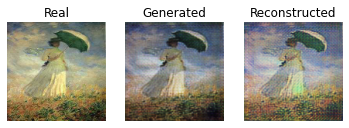

[INFO] Domain B to Domain A


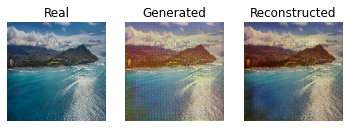

epoch: 29 step: 1 dA_loss: 0.101 dB_loss: 0.150 gAB_loss :4.304 gBA_loss: 4.606
epoch: 29 step: 2 dA_loss: 0.033 dB_loss: 0.019 gAB_loss :4.338 gBA_loss: 4.639
epoch: 29 step: 3 dA_loss: 0.041 dB_loss: 0.072 gAB_loss :4.586 gBA_loss: 4.971
epoch: 29 step: 4 dA_loss: 0.224 dB_loss: 0.092 gAB_loss :4.206 gBA_loss: 4.574
epoch: 29 step: 5 dA_loss: 0.008 dB_loss: 0.054 gAB_loss :4.635 gBA_loss: 5.258
epoch: 29 step: 6 dA_loss: 0.179 dB_loss: 0.162 gAB_loss :4.355 gBA_loss: 4.973
epoch: 29 step: 7 dA_loss: 0.155 dB_loss: 0.205 gAB_loss :4.930 gBA_loss: 4.909
epoch: 29 step: 8 dA_loss: 0.164 dB_loss: 0.071 gAB_loss :5.026 gBA_loss: 5.294
epoch: 29 step: 9 dA_loss: 0.135 dB_loss: 0.129 gAB_loss :5.449 gBA_loss: 5.545
epoch: 29 step: 10 dA_loss: 0.120 dB_loss: 0.271 gAB_loss :4.937 gBA_loss: 4.878
epoch: 29 step: 11 dA_loss: 0.040 dB_loss: 0.174 gAB_loss :4.409 gBA_loss: 4.455
epoch: 29 step: 12 dA_loss: 0.019 dB_loss: 0.113 gAB_loss :4.694 gBA_loss: 4.683
epoch: 29 step: 13 dA_loss: 0.035 dB_

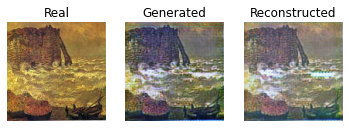

[INFO] Domain B to Domain A


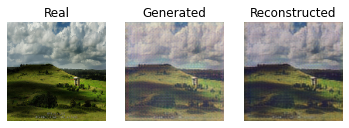

epoch: 29 step: 51 dA_loss: 0.007 dB_loss: 0.173 gAB_loss :4.707 gBA_loss: 4.719
epoch: 29 step: 52 dA_loss: 0.004 dB_loss: 0.110 gAB_loss :4.635 gBA_loss: 4.531
epoch: 29 step: 53 dA_loss: 0.129 dB_loss: 0.031 gAB_loss :3.878 gBA_loss: 4.239
epoch: 29 step: 54 dA_loss: 0.085 dB_loss: 0.128 gAB_loss :4.179 gBA_loss: 4.547
epoch: 29 step: 55 dA_loss: 0.017 dB_loss: 0.072 gAB_loss :4.899 gBA_loss: 4.634
epoch: 29 step: 56 dA_loss: 0.058 dB_loss: 0.027 gAB_loss :4.604 gBA_loss: 4.786
epoch: 29 step: 57 dA_loss: 0.065 dB_loss: 0.107 gAB_loss :4.430 gBA_loss: 4.493
epoch: 29 step: 58 dA_loss: 0.050 dB_loss: 0.022 gAB_loss :4.856 gBA_loss: 5.065
epoch: 29 step: 59 dA_loss: 0.059 dB_loss: 0.064 gAB_loss :4.256 gBA_loss: 4.350
epoch: 29 step: 60 dA_loss: 0.018 dB_loss: 0.087 gAB_loss :4.578 gBA_loss: 4.631
epoch: 29 step: 61 dA_loss: 0.019 dB_loss: 0.068 gAB_loss :4.837 gBA_loss: 4.700
epoch: 29 step: 62 dA_loss: 0.168 dB_loss: 0.010 gAB_loss :4.869 gBA_loss: 4.891
epoch: 29 step: 63 dA_loss: 

 30%|███       | 30/100 [49:27<1:54:12, 97.90s/it]

epoch: 29 step: 73 dA_loss: 0.039 dB_loss: 0.107 gAB_loss :4.749 gBA_loss: 4.660
epoch: 30 step: 0 dA_loss: 0.119 dB_loss: 0.166 gAB_loss :4.713 gBA_loss: 4.695
[INFO] Domain A to Domain B


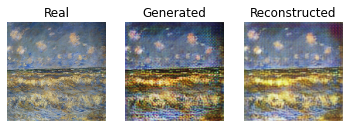

[INFO] Domain B to Domain A


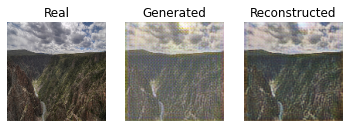

epoch: 30 step: 1 dA_loss: 0.152 dB_loss: 0.013 gAB_loss :4.268 gBA_loss: 4.545
epoch: 30 step: 2 dA_loss: 0.096 dB_loss: 0.024 gAB_loss :4.366 gBA_loss: 4.468
epoch: 30 step: 3 dA_loss: 0.021 dB_loss: 0.063 gAB_loss :4.606 gBA_loss: 4.660
epoch: 30 step: 4 dA_loss: 0.217 dB_loss: 0.009 gAB_loss :4.243 gBA_loss: 4.322
epoch: 30 step: 5 dA_loss: 0.053 dB_loss: 0.059 gAB_loss :4.716 gBA_loss: 5.116
epoch: 30 step: 6 dA_loss: 0.189 dB_loss: 0.177 gAB_loss :4.411 gBA_loss: 5.153
epoch: 30 step: 7 dA_loss: 0.023 dB_loss: 0.223 gAB_loss :4.811 gBA_loss: 4.784
epoch: 30 step: 8 dA_loss: 0.079 dB_loss: 0.147 gAB_loss :4.947 gBA_loss: 5.202
epoch: 30 step: 9 dA_loss: 0.014 dB_loss: 0.172 gAB_loss :5.366 gBA_loss: 5.569
epoch: 30 step: 10 dA_loss: 0.012 dB_loss: 0.332 gAB_loss :4.871 gBA_loss: 4.999
epoch: 30 step: 11 dA_loss: 0.045 dB_loss: 0.223 gAB_loss :4.392 gBA_loss: 4.611
epoch: 30 step: 12 dA_loss: 0.004 dB_loss: 0.129 gAB_loss :4.687 gBA_loss: 4.863
epoch: 30 step: 13 dA_loss: 0.095 dB_

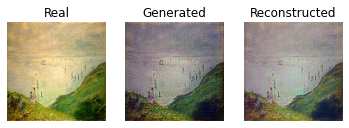

[INFO] Domain B to Domain A


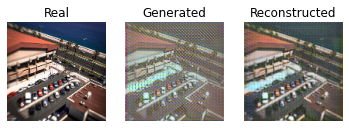

epoch: 30 step: 51 dA_loss: 0.005 dB_loss: 0.081 gAB_loss :4.641 gBA_loss: 4.713
epoch: 30 step: 52 dA_loss: 0.005 dB_loss: 0.081 gAB_loss :4.799 gBA_loss: 4.509
epoch: 30 step: 53 dA_loss: 0.148 dB_loss: 0.029 gAB_loss :4.145 gBA_loss: 4.096
epoch: 30 step: 54 dA_loss: 0.106 dB_loss: 0.098 gAB_loss :4.187 gBA_loss: 4.494
epoch: 30 step: 55 dA_loss: 0.051 dB_loss: 0.067 gAB_loss :4.775 gBA_loss: 4.664
epoch: 30 step: 56 dA_loss: 0.062 dB_loss: 0.036 gAB_loss :4.585 gBA_loss: 4.815
epoch: 30 step: 57 dA_loss: 0.122 dB_loss: 0.091 gAB_loss :4.410 gBA_loss: 4.465
epoch: 30 step: 58 dA_loss: 0.050 dB_loss: 0.024 gAB_loss :4.848 gBA_loss: 4.953
epoch: 30 step: 59 dA_loss: 0.052 dB_loss: 0.023 gAB_loss :4.156 gBA_loss: 4.249
epoch: 30 step: 60 dA_loss: 0.021 dB_loss: 0.053 gAB_loss :4.548 gBA_loss: 4.533
epoch: 30 step: 61 dA_loss: 0.023 dB_loss: 0.070 gAB_loss :4.832 gBA_loss: 4.612
epoch: 30 step: 62 dA_loss: 0.072 dB_loss: 0.018 gAB_loss :4.818 gBA_loss: 4.711
epoch: 30 step: 63 dA_loss: 

 31%|███       | 31/100 [51:05<1:52:34, 97.89s/it]

epoch: 30 step: 73 dA_loss: 0.100 dB_loss: 0.075 gAB_loss :4.577 gBA_loss: 4.590
epoch: 31 step: 0 dA_loss: 0.074 dB_loss: 0.154 gAB_loss :4.651 gBA_loss: 4.333
[INFO] Domain A to Domain B


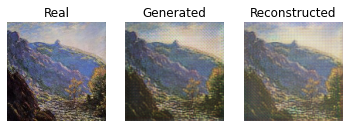

[INFO] Domain B to Domain A


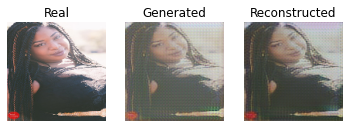

epoch: 31 step: 1 dA_loss: 0.085 dB_loss: 0.021 gAB_loss :4.221 gBA_loss: 4.301
epoch: 31 step: 2 dA_loss: 0.060 dB_loss: 0.018 gAB_loss :4.252 gBA_loss: 4.462
epoch: 31 step: 3 dA_loss: 0.024 dB_loss: 0.058 gAB_loss :4.477 gBA_loss: 4.877
epoch: 31 step: 4 dA_loss: 0.263 dB_loss: 0.047 gAB_loss :4.299 gBA_loss: 4.402
epoch: 31 step: 5 dA_loss: 0.044 dB_loss: 0.061 gAB_loss :4.786 gBA_loss: 5.289
epoch: 31 step: 6 dA_loss: 0.193 dB_loss: 0.250 gAB_loss :4.582 gBA_loss: 4.926
epoch: 31 step: 7 dA_loss: 0.043 dB_loss: 0.075 gAB_loss :4.529 gBA_loss: 4.738
epoch: 31 step: 8 dA_loss: 0.071 dB_loss: 0.048 gAB_loss :4.678 gBA_loss: 5.201
epoch: 31 step: 9 dA_loss: 0.011 dB_loss: 0.316 gAB_loss :5.356 gBA_loss: 5.551
epoch: 31 step: 10 dA_loss: 0.035 dB_loss: 0.095 gAB_loss :4.974 gBA_loss: 4.958
epoch: 31 step: 11 dA_loss: 0.020 dB_loss: 0.196 gAB_loss :4.503 gBA_loss: 4.489
epoch: 31 step: 12 dA_loss: 0.008 dB_loss: 0.137 gAB_loss :4.768 gBA_loss: 4.784
epoch: 31 step: 13 dA_loss: 0.039 dB_

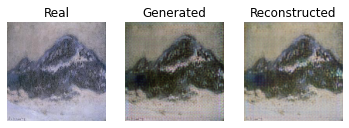

[INFO] Domain B to Domain A


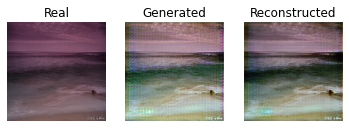

epoch: 31 step: 51 dA_loss: 0.011 dB_loss: 0.151 gAB_loss :4.615 gBA_loss: 4.642
epoch: 31 step: 52 dA_loss: 0.019 dB_loss: 0.094 gAB_loss :4.498 gBA_loss: 4.487
epoch: 31 step: 53 dA_loss: 0.181 dB_loss: 0.065 gAB_loss :3.908 gBA_loss: 4.095
epoch: 31 step: 54 dA_loss: 0.112 dB_loss: 0.107 gAB_loss :4.093 gBA_loss: 4.510
epoch: 31 step: 55 dA_loss: 0.031 dB_loss: 0.076 gAB_loss :4.787 gBA_loss: 4.513
epoch: 31 step: 56 dA_loss: 0.060 dB_loss: 0.076 gAB_loss :4.538 gBA_loss: 4.668
epoch: 31 step: 57 dA_loss: 0.061 dB_loss: 0.111 gAB_loss :4.358 gBA_loss: 4.310
epoch: 31 step: 58 dA_loss: 0.059 dB_loss: 0.018 gAB_loss :4.894 gBA_loss: 4.992
epoch: 31 step: 59 dA_loss: 0.056 dB_loss: 0.008 gAB_loss :4.082 gBA_loss: 4.285
epoch: 31 step: 60 dA_loss: 0.015 dB_loss: 0.075 gAB_loss :4.418 gBA_loss: 4.706
epoch: 31 step: 61 dA_loss: 0.029 dB_loss: 0.125 gAB_loss :4.973 gBA_loss: 4.706
epoch: 31 step: 62 dA_loss: 0.139 dB_loss: 0.051 gAB_loss :4.897 gBA_loss: 4.791
epoch: 31 step: 63 dA_loss: 

 32%|███▏      | 32/100 [52:43<1:50:57, 97.90s/it]

epoch: 31 step: 73 dA_loss: 0.018 dB_loss: 0.079 gAB_loss :4.489 gBA_loss: 4.679
epoch: 32 step: 0 dA_loss: 0.048 dB_loss: 0.171 gAB_loss :4.421 gBA_loss: 4.539
[INFO] Domain A to Domain B


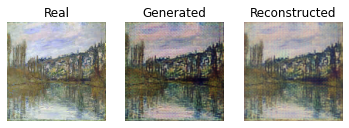

[INFO] Domain B to Domain A


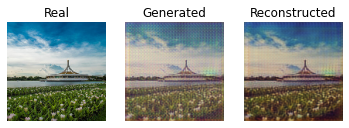

epoch: 32 step: 1 dA_loss: 0.051 dB_loss: 0.144 gAB_loss :4.160 gBA_loss: 4.516
epoch: 32 step: 2 dA_loss: 0.015 dB_loss: 0.019 gAB_loss :4.184 gBA_loss: 4.449
epoch: 32 step: 3 dA_loss: 0.009 dB_loss: 0.055 gAB_loss :4.478 gBA_loss: 4.683
epoch: 32 step: 4 dA_loss: 0.180 dB_loss: 0.082 gAB_loss :4.122 gBA_loss: 4.482
epoch: 32 step: 5 dA_loss: 0.005 dB_loss: 0.057 gAB_loss :4.610 gBA_loss: 5.268
epoch: 32 step: 6 dA_loss: 0.231 dB_loss: 0.143 gAB_loss :4.397 gBA_loss: 4.909
epoch: 32 step: 7 dA_loss: 0.013 dB_loss: 0.044 gAB_loss :4.453 gBA_loss: 4.621
epoch: 32 step: 8 dA_loss: 0.059 dB_loss: 0.069 gAB_loss :4.822 gBA_loss: 5.118
epoch: 32 step: 9 dA_loss: 0.011 dB_loss: 0.084 gAB_loss :5.324 gBA_loss: 5.470
epoch: 32 step: 10 dA_loss: 0.012 dB_loss: 0.054 gAB_loss :4.974 gBA_loss: 4.961
epoch: 32 step: 11 dA_loss: 0.010 dB_loss: 0.145 gAB_loss :4.483 gBA_loss: 4.524
epoch: 32 step: 12 dA_loss: 0.004 dB_loss: 0.111 gAB_loss :4.763 gBA_loss: 4.770
epoch: 32 step: 13 dA_loss: 0.017 dB_

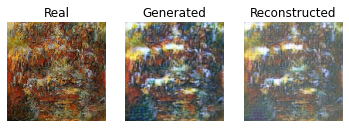

[INFO] Domain B to Domain A


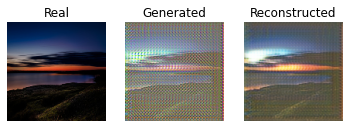

epoch: 32 step: 51 dA_loss: 0.016 dB_loss: 0.089 gAB_loss :4.577 gBA_loss: 4.568
epoch: 32 step: 52 dA_loss: 0.010 dB_loss: 0.042 gAB_loss :4.554 gBA_loss: 4.372
epoch: 32 step: 53 dA_loss: 0.129 dB_loss: 0.019 gAB_loss :3.883 gBA_loss: 4.006
epoch: 32 step: 54 dA_loss: 0.088 dB_loss: 0.109 gAB_loss :4.094 gBA_loss: 4.435
epoch: 32 step: 55 dA_loss: 0.046 dB_loss: 0.073 gAB_loss :4.786 gBA_loss: 4.475
epoch: 32 step: 56 dA_loss: 0.071 dB_loss: 0.033 gAB_loss :4.478 gBA_loss: 4.627
epoch: 32 step: 57 dA_loss: 0.058 dB_loss: 0.095 gAB_loss :4.166 gBA_loss: 4.361
epoch: 32 step: 58 dA_loss: 0.057 dB_loss: 0.062 gAB_loss :5.033 gBA_loss: 4.915
epoch: 32 step: 59 dA_loss: 0.060 dB_loss: 0.005 gAB_loss :4.244 gBA_loss: 4.273
epoch: 32 step: 60 dA_loss: 0.047 dB_loss: 0.070 gAB_loss :4.459 gBA_loss: 4.524
epoch: 32 step: 61 dA_loss: 0.066 dB_loss: 0.073 gAB_loss :4.699 gBA_loss: 4.766
epoch: 32 step: 62 dA_loss: 0.082 dB_loss: 0.060 gAB_loss :4.871 gBA_loss: 4.629
epoch: 32 step: 63 dA_loss: 

 33%|███▎      | 33/100 [54:21<1:49:19, 97.90s/it]

epoch: 32 step: 73 dA_loss: 0.074 dB_loss: 0.080 gAB_loss :4.524 gBA_loss: 4.525
epoch: 33 step: 0 dA_loss: 0.069 dB_loss: 0.189 gAB_loss :4.630 gBA_loss: 4.476
[INFO] Domain A to Domain B


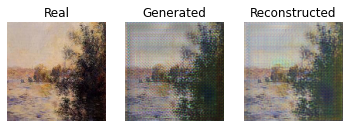

[INFO] Domain B to Domain A


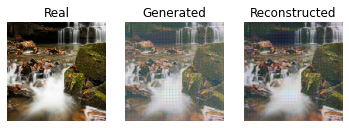

epoch: 33 step: 1 dA_loss: 0.063 dB_loss: 0.034 gAB_loss :4.224 gBA_loss: 4.508
epoch: 33 step: 2 dA_loss: 0.047 dB_loss: 0.021 gAB_loss :4.198 gBA_loss: 4.522
epoch: 33 step: 3 dA_loss: 0.020 dB_loss: 0.089 gAB_loss :4.596 gBA_loss: 4.742
epoch: 33 step: 4 dA_loss: 0.171 dB_loss: 0.067 gAB_loss :4.220 gBA_loss: 4.467
epoch: 33 step: 5 dA_loss: 0.019 dB_loss: 0.060 gAB_loss :4.643 gBA_loss: 5.252
epoch: 33 step: 6 dA_loss: 0.221 dB_loss: 0.188 gAB_loss :4.466 gBA_loss: 4.911
epoch: 33 step: 7 dA_loss: 0.024 dB_loss: 0.056 gAB_loss :4.536 gBA_loss: 4.668
epoch: 33 step: 8 dA_loss: 0.070 dB_loss: 0.052 gAB_loss :4.807 gBA_loss: 5.205
epoch: 33 step: 9 dA_loss: 0.010 dB_loss: 0.071 gAB_loss :5.205 gBA_loss: 5.538
epoch: 33 step: 10 dA_loss: 0.027 dB_loss: 0.010 gAB_loss :4.891 gBA_loss: 4.965
epoch: 33 step: 11 dA_loss: 0.030 dB_loss: 0.131 gAB_loss :4.448 gBA_loss: 4.519
epoch: 33 step: 12 dA_loss: 0.010 dB_loss: 0.120 gAB_loss :4.774 gBA_loss: 4.799
epoch: 33 step: 13 dA_loss: 0.027 dB_

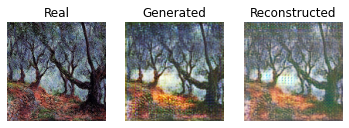

[INFO] Domain B to Domain A


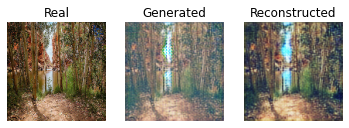

epoch: 33 step: 51 dA_loss: 0.005 dB_loss: 0.126 gAB_loss :4.694 gBA_loss: 4.656
epoch: 33 step: 52 dA_loss: 0.009 dB_loss: 0.133 gAB_loss :4.602 gBA_loss: 4.390
epoch: 33 step: 53 dA_loss: 0.203 dB_loss: 0.042 gAB_loss :3.766 gBA_loss: 4.067
epoch: 33 step: 54 dA_loss: 0.053 dB_loss: 0.153 gAB_loss :4.078 gBA_loss: 4.294
epoch: 33 step: 55 dA_loss: 0.029 dB_loss: 0.074 gAB_loss :4.715 gBA_loss: 4.338
epoch: 33 step: 56 dA_loss: 0.089 dB_loss: 0.047 gAB_loss :4.403 gBA_loss: 4.665
epoch: 33 step: 57 dA_loss: 0.049 dB_loss: 0.103 gAB_loss :4.184 gBA_loss: 4.387
epoch: 33 step: 58 dA_loss: 0.046 dB_loss: 0.014 gAB_loss :4.757 gBA_loss: 4.885
epoch: 33 step: 59 dA_loss: 0.074 dB_loss: 0.071 gAB_loss :4.180 gBA_loss: 4.249
epoch: 33 step: 60 dA_loss: 0.037 dB_loss: 0.153 gAB_loss :4.444 gBA_loss: 4.415
epoch: 33 step: 61 dA_loss: 0.040 dB_loss: 0.088 gAB_loss :4.578 gBA_loss: 4.513
epoch: 33 step: 62 dA_loss: 0.130 dB_loss: 0.047 gAB_loss :4.748 gBA_loss: 4.659
epoch: 33 step: 63 dA_loss: 

 34%|███▍      | 34/100 [55:59<1:47:41, 97.90s/it]

epoch: 33 step: 73 dA_loss: 0.042 dB_loss: 0.102 gAB_loss :4.378 gBA_loss: 4.637
epoch: 34 step: 0 dA_loss: 0.031 dB_loss: 0.179 gAB_loss :4.516 gBA_loss: 4.463
[INFO] Domain A to Domain B


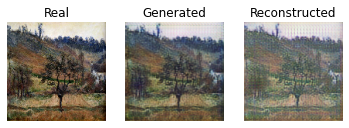

[INFO] Domain B to Domain A


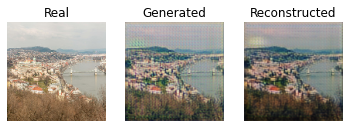

epoch: 34 step: 1 dA_loss: 0.119 dB_loss: 0.063 gAB_loss :4.229 gBA_loss: 4.551
epoch: 34 step: 2 dA_loss: 0.142 dB_loss: 0.050 gAB_loss :4.174 gBA_loss: 4.460
epoch: 34 step: 3 dA_loss: 0.069 dB_loss: 0.070 gAB_loss :4.385 gBA_loss: 4.638
epoch: 34 step: 4 dA_loss: 0.207 dB_loss: 0.043 gAB_loss :3.972 gBA_loss: 4.259
epoch: 34 step: 5 dA_loss: 0.030 dB_loss: 0.067 gAB_loss :4.583 gBA_loss: 5.075
epoch: 34 step: 6 dA_loss: 0.195 dB_loss: 0.206 gAB_loss :4.540 gBA_loss: 4.767
epoch: 34 step: 7 dA_loss: 0.043 dB_loss: 0.079 gAB_loss :4.583 gBA_loss: 4.515
epoch: 34 step: 8 dA_loss: 0.051 dB_loss: 0.039 gAB_loss :4.775 gBA_loss: 5.089
epoch: 34 step: 9 dA_loss: 0.012 dB_loss: 0.088 gAB_loss :5.170 gBA_loss: 5.423
epoch: 34 step: 10 dA_loss: 0.036 dB_loss: 0.019 gAB_loss :4.875 gBA_loss: 4.887
epoch: 34 step: 11 dA_loss: 0.067 dB_loss: 0.147 gAB_loss :4.422 gBA_loss: 4.504
epoch: 34 step: 12 dA_loss: 0.031 dB_loss: 0.131 gAB_loss :4.732 gBA_loss: 4.708
epoch: 34 step: 13 dA_loss: 0.047 dB_

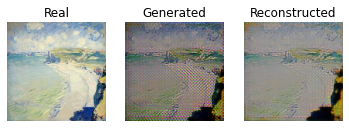

[INFO] Domain B to Domain A


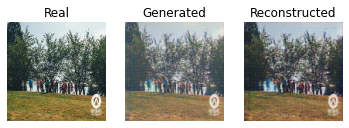

epoch: 34 step: 51 dA_loss: 0.004 dB_loss: 0.078 gAB_loss :4.553 gBA_loss: 4.598
epoch: 34 step: 52 dA_loss: 0.011 dB_loss: 0.066 gAB_loss :4.524 gBA_loss: 4.402
epoch: 34 step: 53 dA_loss: 0.154 dB_loss: 0.106 gAB_loss :4.032 gBA_loss: 4.059
epoch: 34 step: 54 dA_loss: 0.052 dB_loss: 0.151 gAB_loss :4.086 gBA_loss: 4.278
epoch: 34 step: 55 dA_loss: 0.027 dB_loss: 0.078 gAB_loss :4.646 gBA_loss: 4.281
epoch: 34 step: 56 dA_loss: 0.077 dB_loss: 0.035 gAB_loss :4.280 gBA_loss: 4.589
epoch: 34 step: 57 dA_loss: 0.069 dB_loss: 0.076 gAB_loss :4.208 gBA_loss: 4.365
epoch: 34 step: 58 dA_loss: 0.042 dB_loss: 0.018 gAB_loss :4.841 gBA_loss: 4.906
epoch: 34 step: 59 dA_loss: 0.073 dB_loss: 0.009 gAB_loss :4.135 gBA_loss: 4.265
epoch: 34 step: 60 dA_loss: 0.049 dB_loss: 0.045 gAB_loss :4.383 gBA_loss: 4.428
epoch: 34 step: 61 dA_loss: 0.042 dB_loss: 0.070 gAB_loss :4.664 gBA_loss: 4.486
epoch: 34 step: 62 dA_loss: 0.101 dB_loss: 0.014 gAB_loss :4.742 gBA_loss: 4.620
epoch: 34 step: 63 dA_loss: 

 35%|███▌      | 35/100 [57:37<1:46:02, 97.89s/it]

epoch: 34 step: 73 dA_loss: 0.042 dB_loss: 0.083 gAB_loss :4.496 gBA_loss: 4.497
epoch: 35 step: 0 dA_loss: 0.131 dB_loss: 0.135 gAB_loss :4.493 gBA_loss: 4.719
[INFO] Domain A to Domain B


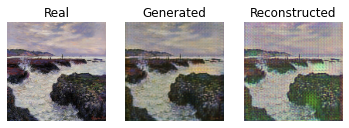

[INFO] Domain B to Domain A


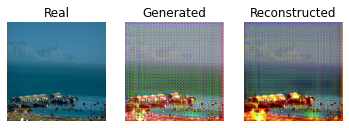

epoch: 35 step: 1 dA_loss: 0.068 dB_loss: 0.146 gAB_loss :4.321 gBA_loss: 4.585
epoch: 35 step: 2 dA_loss: 0.052 dB_loss: 0.070 gAB_loss :4.274 gBA_loss: 4.399
epoch: 35 step: 3 dA_loss: 0.026 dB_loss: 0.065 gAB_loss :4.496 gBA_loss: 4.677
epoch: 35 step: 4 dA_loss: 0.123 dB_loss: 0.117 gAB_loss :4.016 gBA_loss: 4.419
epoch: 35 step: 5 dA_loss: 0.007 dB_loss: 0.042 gAB_loss :4.521 gBA_loss: 5.211
epoch: 35 step: 6 dA_loss: 0.198 dB_loss: 0.158 gAB_loss :4.292 gBA_loss: 4.870
epoch: 35 step: 7 dA_loss: 0.014 dB_loss: 0.055 gAB_loss :4.517 gBA_loss: 4.552
epoch: 35 step: 8 dA_loss: 0.035 dB_loss: 0.019 gAB_loss :4.806 gBA_loss: 5.117
epoch: 35 step: 9 dA_loss: 0.018 dB_loss: 0.054 gAB_loss :5.143 gBA_loss: 5.418
epoch: 35 step: 10 dA_loss: 0.015 dB_loss: 0.010 gAB_loss :4.876 gBA_loss: 4.905
epoch: 35 step: 11 dA_loss: 0.012 dB_loss: 0.167 gAB_loss :4.436 gBA_loss: 4.437
epoch: 35 step: 12 dA_loss: 0.007 dB_loss: 0.130 gAB_loss :4.709 gBA_loss: 4.687
epoch: 35 step: 13 dA_loss: 0.015 dB_

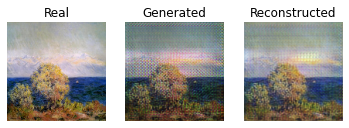

[INFO] Domain B to Domain A


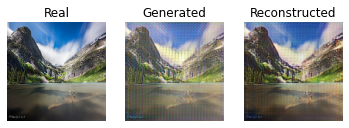

epoch: 35 step: 51 dA_loss: 0.008 dB_loss: 0.085 gAB_loss :4.531 gBA_loss: 4.594
epoch: 35 step: 52 dA_loss: 0.005 dB_loss: 0.067 gAB_loss :4.622 gBA_loss: 4.537
epoch: 35 step: 53 dA_loss: 0.115 dB_loss: 0.064 gAB_loss :4.040 gBA_loss: 4.132
epoch: 35 step: 54 dA_loss: 0.048 dB_loss: 0.106 gAB_loss :4.119 gBA_loss: 4.394
epoch: 35 step: 55 dA_loss: 0.017 dB_loss: 0.068 gAB_loss :4.688 gBA_loss: 4.418
epoch: 35 step: 56 dA_loss: 0.079 dB_loss: 0.043 gAB_loss :4.302 gBA_loss: 4.611
epoch: 35 step: 57 dA_loss: 0.041 dB_loss: 0.092 gAB_loss :4.171 gBA_loss: 4.313
epoch: 35 step: 58 dA_loss: 0.035 dB_loss: 0.016 gAB_loss :4.852 gBA_loss: 4.911
epoch: 35 step: 59 dA_loss: 0.059 dB_loss: 0.021 gAB_loss :4.204 gBA_loss: 4.225
epoch: 35 step: 60 dA_loss: 0.020 dB_loss: 0.040 gAB_loss :4.414 gBA_loss: 4.423
epoch: 35 step: 61 dA_loss: 0.017 dB_loss: 0.078 gAB_loss :4.711 gBA_loss: 4.615
epoch: 35 step: 62 dA_loss: 0.067 dB_loss: 0.003 gAB_loss :4.746 gBA_loss: 4.666
epoch: 35 step: 63 dA_loss: 

 36%|███▌      | 36/100 [59:15<1:44:34, 98.04s/it]

epoch: 35 step: 73 dA_loss: 0.056 dB_loss: 0.108 gAB_loss :4.629 gBA_loss: 4.616
epoch: 36 step: 0 dA_loss: 0.028 dB_loss: 0.151 gAB_loss :4.617 gBA_loss: 4.434
[INFO] Domain A to Domain B


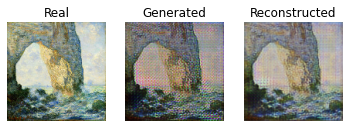

[INFO] Domain B to Domain A


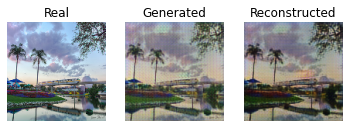

epoch: 36 step: 1 dA_loss: 0.038 dB_loss: 0.009 gAB_loss :4.147 gBA_loss: 4.473
epoch: 36 step: 2 dA_loss: 0.014 dB_loss: 0.009 gAB_loss :4.117 gBA_loss: 4.479
epoch: 36 step: 3 dA_loss: 0.006 dB_loss: 0.030 gAB_loss :4.342 gBA_loss: 4.758
epoch: 36 step: 4 dA_loss: 0.102 dB_loss: 0.031 gAB_loss :4.075 gBA_loss: 4.395
epoch: 36 step: 5 dA_loss: 0.009 dB_loss: 0.057 gAB_loss :4.704 gBA_loss: 5.217
epoch: 36 step: 6 dA_loss: 0.220 dB_loss: 0.162 gAB_loss :4.542 gBA_loss: 4.901
epoch: 36 step: 7 dA_loss: 0.062 dB_loss: 0.031 gAB_loss :4.621 gBA_loss: 4.911
epoch: 36 step: 8 dA_loss: 0.026 dB_loss: 0.007 gAB_loss :4.824 gBA_loss: 5.234
epoch: 36 step: 9 dA_loss: 0.025 dB_loss: 0.117 gAB_loss :5.280 gBA_loss: 5.432
epoch: 36 step: 10 dA_loss: 0.054 dB_loss: 0.014 gAB_loss :4.925 gBA_loss: 4.835
epoch: 36 step: 11 dA_loss: 0.009 dB_loss: 0.208 gAB_loss :4.409 gBA_loss: 4.324
epoch: 36 step: 12 dA_loss: 0.007 dB_loss: 0.163 gAB_loss :4.528 gBA_loss: 4.597
epoch: 36 step: 13 dA_loss: 0.006 dB_

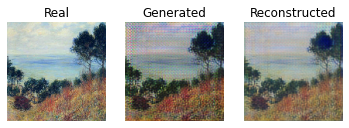

[INFO] Domain B to Domain A


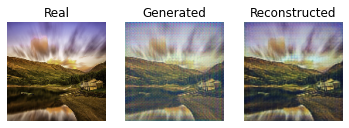

epoch: 36 step: 51 dA_loss: 0.007 dB_loss: 0.085 gAB_loss :4.513 gBA_loss: 4.606
epoch: 36 step: 52 dA_loss: 0.004 dB_loss: 0.071 gAB_loss :4.443 gBA_loss: 4.356
epoch: 36 step: 53 dA_loss: 0.127 dB_loss: 0.015 gAB_loss :3.767 gBA_loss: 4.037
epoch: 36 step: 54 dA_loss: 0.046 dB_loss: 0.081 gAB_loss :3.964 gBA_loss: 4.434
epoch: 36 step: 55 dA_loss: 0.009 dB_loss: 0.095 gAB_loss :4.789 gBA_loss: 4.455
epoch: 36 step: 56 dA_loss: 0.049 dB_loss: 0.067 gAB_loss :4.439 gBA_loss: 4.577
epoch: 36 step: 57 dA_loss: 0.035 dB_loss: 0.114 gAB_loss :4.198 gBA_loss: 4.240
epoch: 36 step: 58 dA_loss: 0.026 dB_loss: 0.007 gAB_loss :4.709 gBA_loss: 4.826
epoch: 36 step: 59 dA_loss: 0.055 dB_loss: 0.033 gAB_loss :4.110 gBA_loss: 4.219
epoch: 36 step: 60 dA_loss: 0.041 dB_loss: 0.024 gAB_loss :4.376 gBA_loss: 4.429
epoch: 36 step: 61 dA_loss: 0.022 dB_loss: 0.085 gAB_loss :4.656 gBA_loss: 4.643
epoch: 36 step: 62 dA_loss: 0.051 dB_loss: 0.010 gAB_loss :4.696 gBA_loss: 4.582
epoch: 36 step: 63 dA_loss: 

 37%|███▋      | 37/100 [1:00:53<1:42:53, 97.99s/it]

epoch: 36 step: 73 dA_loss: 0.099 dB_loss: 0.144 gAB_loss :4.673 gBA_loss: 4.620
epoch: 37 step: 0 dA_loss: 0.050 dB_loss: 0.203 gAB_loss :4.665 gBA_loss: 4.483
[INFO] Domain A to Domain B


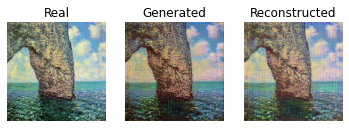

[INFO] Domain B to Domain A


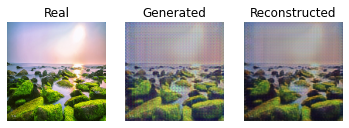

epoch: 37 step: 1 dA_loss: 0.074 dB_loss: 0.005 gAB_loss :4.113 gBA_loss: 4.488
epoch: 37 step: 2 dA_loss: 0.023 dB_loss: 0.010 gAB_loss :4.057 gBA_loss: 4.443
epoch: 37 step: 3 dA_loss: 0.033 dB_loss: 0.034 gAB_loss :4.353 gBA_loss: 4.842
epoch: 37 step: 4 dA_loss: 0.094 dB_loss: 0.071 gAB_loss :4.001 gBA_loss: 4.442
epoch: 37 step: 5 dA_loss: 0.006 dB_loss: 0.050 gAB_loss :4.593 gBA_loss: 5.196
epoch: 37 step: 6 dA_loss: 0.183 dB_loss: 0.262 gAB_loss :4.611 gBA_loss: 4.833
epoch: 37 step: 7 dA_loss: 0.048 dB_loss: 0.123 gAB_loss :4.603 gBA_loss: 4.597
epoch: 37 step: 8 dA_loss: 0.029 dB_loss: 0.015 gAB_loss :4.780 gBA_loss: 5.206
epoch: 37 step: 9 dA_loss: 0.009 dB_loss: 0.089 gAB_loss :5.054 gBA_loss: 5.443
epoch: 37 step: 10 dA_loss: 0.050 dB_loss: 0.007 gAB_loss :4.756 gBA_loss: 4.853
epoch: 37 step: 11 dA_loss: 0.008 dB_loss: 0.146 gAB_loss :4.293 gBA_loss: 4.372
epoch: 37 step: 12 dA_loss: 0.005 dB_loss: 0.146 gAB_loss :4.581 gBA_loss: 4.623
epoch: 37 step: 13 dA_loss: 0.028 dB_

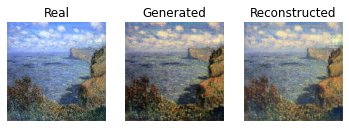

[INFO] Domain B to Domain A


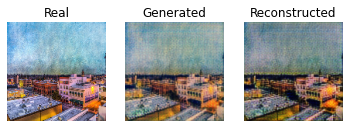

epoch: 37 step: 51 dA_loss: 0.008 dB_loss: 0.098 gAB_loss :4.498 gBA_loss: 4.535
epoch: 37 step: 52 dA_loss: 0.006 dB_loss: 0.092 gAB_loss :4.457 gBA_loss: 4.287
epoch: 37 step: 53 dA_loss: 0.101 dB_loss: 0.023 gAB_loss :3.715 gBA_loss: 4.035
epoch: 37 step: 54 dA_loss: 0.045 dB_loss: 0.152 gAB_loss :4.047 gBA_loss: 4.255
epoch: 37 step: 55 dA_loss: 0.014 dB_loss: 0.071 gAB_loss :4.648 gBA_loss: 4.311
epoch: 37 step: 56 dA_loss: 0.090 dB_loss: 0.099 gAB_loss :4.331 gBA_loss: 4.405
epoch: 37 step: 57 dA_loss: 0.132 dB_loss: 0.109 gAB_loss :4.130 gBA_loss: 4.343
epoch: 37 step: 58 dA_loss: 0.033 dB_loss: 0.008 gAB_loss :4.674 gBA_loss: 4.856
epoch: 37 step: 59 dA_loss: 0.178 dB_loss: 0.039 gAB_loss :4.061 gBA_loss: 4.125
epoch: 37 step: 60 dA_loss: 0.212 dB_loss: 0.028 gAB_loss :4.297 gBA_loss: 4.264
epoch: 37 step: 61 dA_loss: 0.043 dB_loss: 0.099 gAB_loss :4.622 gBA_loss: 4.298
epoch: 37 step: 62 dA_loss: 0.107 dB_loss: 0.008 gAB_loss :4.605 gBA_loss: 4.405
epoch: 37 step: 63 dA_loss: 

 38%|███▊      | 38/100 [1:02:31<1:41:12, 97.94s/it]

epoch: 37 step: 73 dA_loss: 0.102 dB_loss: 0.065 gAB_loss :4.499 gBA_loss: 4.382
epoch: 38 step: 0 dA_loss: 0.075 dB_loss: 0.130 gAB_loss :4.545 gBA_loss: 4.516
[INFO] Domain A to Domain B


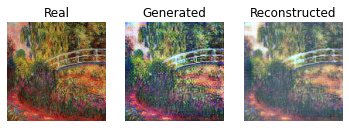

[INFO] Domain B to Domain A


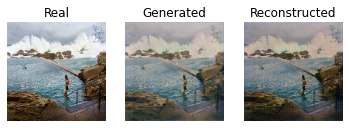

epoch: 38 step: 1 dA_loss: 0.047 dB_loss: 0.021 gAB_loss :4.171 gBA_loss: 4.369
epoch: 38 step: 2 dA_loss: 0.081 dB_loss: 0.012 gAB_loss :4.136 gBA_loss: 4.238
epoch: 38 step: 3 dA_loss: 0.057 dB_loss: 0.033 gAB_loss :4.384 gBA_loss: 4.417
epoch: 38 step: 4 dA_loss: 0.175 dB_loss: 0.036 gAB_loss :3.908 gBA_loss: 4.420
epoch: 38 step: 5 dA_loss: 0.010 dB_loss: 0.097 gAB_loss :4.730 gBA_loss: 5.205
epoch: 38 step: 6 dA_loss: 0.241 dB_loss: 0.133 gAB_loss :4.431 gBA_loss: 4.778
epoch: 38 step: 7 dA_loss: 0.051 dB_loss: 0.042 gAB_loss :4.403 gBA_loss: 4.446
epoch: 38 step: 8 dA_loss: 0.068 dB_loss: 0.005 gAB_loss :4.720 gBA_loss: 5.093
epoch: 38 step: 9 dA_loss: 0.015 dB_loss: 0.157 gAB_loss :5.181 gBA_loss: 5.417
epoch: 38 step: 10 dA_loss: 0.029 dB_loss: 0.025 gAB_loss :4.871 gBA_loss: 4.870
epoch: 38 step: 11 dA_loss: 0.008 dB_loss: 0.251 gAB_loss :4.348 gBA_loss: 4.398
epoch: 38 step: 12 dA_loss: 0.005 dB_loss: 0.330 gAB_loss :4.524 gBA_loss: 4.604
epoch: 38 step: 13 dA_loss: 0.051 dB_

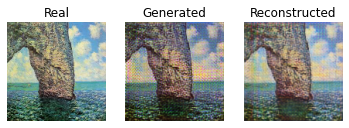

[INFO] Domain B to Domain A


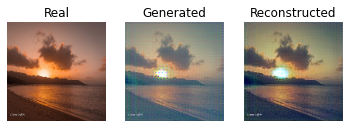

epoch: 38 step: 51 dA_loss: 0.063 dB_loss: 0.060 gAB_loss :4.552 gBA_loss: 4.564
epoch: 38 step: 52 dA_loss: 0.028 dB_loss: 0.070 gAB_loss :4.518 gBA_loss: 4.328
epoch: 38 step: 53 dA_loss: 0.123 dB_loss: 0.030 gAB_loss :3.790 gBA_loss: 4.024
epoch: 38 step: 54 dA_loss: 0.048 dB_loss: 0.070 gAB_loss :3.951 gBA_loss: 4.299
epoch: 38 step: 55 dA_loss: 0.016 dB_loss: 0.141 gAB_loss :4.808 gBA_loss: 4.371
epoch: 38 step: 56 dA_loss: 0.109 dB_loss: 0.074 gAB_loss :4.360 gBA_loss: 4.448
epoch: 38 step: 57 dA_loss: 0.044 dB_loss: 0.125 gAB_loss :4.173 gBA_loss: 4.127
epoch: 38 step: 58 dA_loss: 0.030 dB_loss: 0.018 gAB_loss :4.781 gBA_loss: 4.767
epoch: 38 step: 59 dA_loss: 0.066 dB_loss: 0.027 gAB_loss :3.943 gBA_loss: 4.184
epoch: 38 step: 60 dA_loss: 0.041 dB_loss: 0.064 gAB_loss :4.358 gBA_loss: 4.479
epoch: 38 step: 61 dA_loss: 0.041 dB_loss: 0.092 gAB_loss :4.673 gBA_loss: 4.608
epoch: 38 step: 62 dA_loss: 0.054 dB_loss: 0.018 gAB_loss :4.631 gBA_loss: 4.566
epoch: 38 step: 63 dA_loss: 

 39%|███▉      | 39/100 [1:04:09<1:39:32, 97.91s/it]

epoch: 38 step: 73 dA_loss: 0.080 dB_loss: 0.100 gAB_loss :4.585 gBA_loss: 4.518
epoch: 39 step: 0 dA_loss: 0.074 dB_loss: 0.150 gAB_loss :4.610 gBA_loss: 4.451
[INFO] Domain A to Domain B


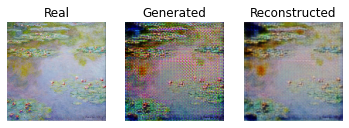

[INFO] Domain B to Domain A


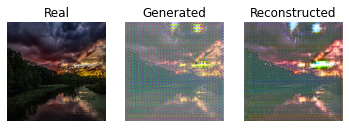

epoch: 39 step: 1 dA_loss: 0.037 dB_loss: 0.007 gAB_loss :4.095 gBA_loss: 4.278
epoch: 39 step: 2 dA_loss: 0.055 dB_loss: 0.013 gAB_loss :4.042 gBA_loss: 4.272
epoch: 39 step: 3 dA_loss: 0.038 dB_loss: 0.028 gAB_loss :4.257 gBA_loss: 4.553
epoch: 39 step: 4 dA_loss: 0.098 dB_loss: 0.063 gAB_loss :4.086 gBA_loss: 4.243
epoch: 39 step: 5 dA_loss: 0.016 dB_loss: 0.059 gAB_loss :4.678 gBA_loss: 5.148
epoch: 39 step: 6 dA_loss: 0.174 dB_loss: 0.172 gAB_loss :4.372 gBA_loss: 4.719
epoch: 39 step: 7 dA_loss: 0.089 dB_loss: 0.083 gAB_loss :4.418 gBA_loss: 4.653
epoch: 39 step: 8 dA_loss: 0.020 dB_loss: 0.010 gAB_loss :4.587 gBA_loss: 5.157
epoch: 39 step: 9 dA_loss: 0.013 dB_loss: 0.101 gAB_loss :5.058 gBA_loss: 5.365
epoch: 39 step: 10 dA_loss: 0.041 dB_loss: 0.006 gAB_loss :4.817 gBA_loss: 4.820
epoch: 39 step: 11 dA_loss: 0.020 dB_loss: 0.227 gAB_loss :4.354 gBA_loss: 4.409
epoch: 39 step: 12 dA_loss: 0.015 dB_loss: 0.217 gAB_loss :4.572 gBA_loss: 4.699
epoch: 39 step: 13 dA_loss: 0.057 dB_

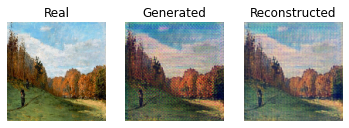

[INFO] Domain B to Domain A


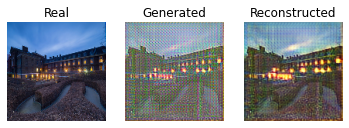

epoch: 39 step: 51 dA_loss: 0.121 dB_loss: 0.061 gAB_loss :4.537 gBA_loss: 4.540
epoch: 39 step: 52 dA_loss: 0.053 dB_loss: 0.064 gAB_loss :4.480 gBA_loss: 4.289
epoch: 39 step: 53 dA_loss: 0.131 dB_loss: 0.053 gAB_loss :3.762 gBA_loss: 3.962
epoch: 39 step: 54 dA_loss: 0.073 dB_loss: 0.088 gAB_loss :3.995 gBA_loss: 4.216
epoch: 39 step: 55 dA_loss: 0.022 dB_loss: 0.068 gAB_loss :4.684 gBA_loss: 4.257
epoch: 39 step: 56 dA_loss: 0.114 dB_loss: 0.048 gAB_loss :4.307 gBA_loss: 4.363
epoch: 39 step: 57 dA_loss: 0.085 dB_loss: 0.111 gAB_loss :4.063 gBA_loss: 4.215
epoch: 39 step: 58 dA_loss: 0.018 dB_loss: 0.074 gAB_loss :4.905 gBA_loss: 4.798
epoch: 39 step: 59 dA_loss: 0.102 dB_loss: 0.087 gAB_loss :4.114 gBA_loss: 4.100
epoch: 39 step: 60 dA_loss: 0.027 dB_loss: 0.010 gAB_loss :4.141 gBA_loss: 4.359
epoch: 39 step: 61 dA_loss: 0.036 dB_loss: 0.262 gAB_loss :4.758 gBA_loss: 4.535
epoch: 39 step: 62 dA_loss: 0.045 dB_loss: 0.164 gAB_loss :4.701 gBA_loss: 4.423
epoch: 39 step: 63 dA_loss: 

 40%|████      | 40/100 [1:05:47<1:37:53, 97.90s/it]

epoch: 39 step: 73 dA_loss: 0.114 dB_loss: 0.083 gAB_loss :4.437 gBA_loss: 4.383
epoch: 40 step: 0 dA_loss: 0.049 dB_loss: 0.118 gAB_loss :4.411 gBA_loss: 4.506
[INFO] Domain A to Domain B


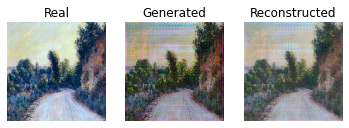

[INFO] Domain B to Domain A


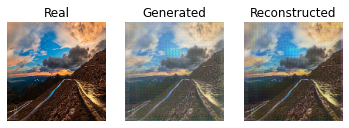

epoch: 40 step: 1 dA_loss: 0.036 dB_loss: 0.070 gAB_loss :4.113 gBA_loss: 4.342
epoch: 40 step: 2 dA_loss: 0.066 dB_loss: 0.035 gAB_loss :4.123 gBA_loss: 4.248
epoch: 40 step: 3 dA_loss: 0.083 dB_loss: 0.036 gAB_loss :4.386 gBA_loss: 4.586
epoch: 40 step: 4 dA_loss: 0.123 dB_loss: 0.040 gAB_loss :3.934 gBA_loss: 4.337
epoch: 40 step: 5 dA_loss: 0.008 dB_loss: 0.037 gAB_loss :4.511 gBA_loss: 5.147
epoch: 40 step: 6 dA_loss: 0.187 dB_loss: 0.221 gAB_loss :4.490 gBA_loss: 4.730
epoch: 40 step: 7 dA_loss: 0.043 dB_loss: 0.104 gAB_loss :4.545 gBA_loss: 4.585
epoch: 40 step: 8 dA_loss: 0.075 dB_loss: 0.006 gAB_loss :4.760 gBA_loss: 5.301
epoch: 40 step: 9 dA_loss: 0.029 dB_loss: 0.060 gAB_loss :4.995 gBA_loss: 5.422
epoch: 40 step: 10 dA_loss: 0.032 dB_loss: 0.008 gAB_loss :4.705 gBA_loss: 4.808
epoch: 40 step: 11 dA_loss: 0.005 dB_loss: 0.164 gAB_loss :4.224 gBA_loss: 4.239
epoch: 40 step: 12 dA_loss: 0.060 dB_loss: 0.102 gAB_loss :4.502 gBA_loss: 4.635
epoch: 40 step: 13 dA_loss: 0.069 dB_

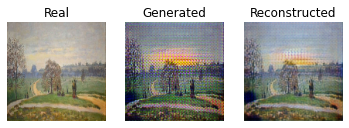

[INFO] Domain B to Domain A


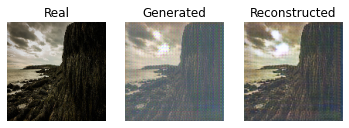

epoch: 40 step: 51 dA_loss: 0.026 dB_loss: 0.027 gAB_loss :4.428 gBA_loss: 4.352
epoch: 40 step: 52 dA_loss: 0.034 dB_loss: 0.098 gAB_loss :4.528 gBA_loss: 4.187
epoch: 40 step: 53 dA_loss: 0.070 dB_loss: 0.035 gAB_loss :3.898 gBA_loss: 3.920
epoch: 40 step: 54 dA_loss: 0.080 dB_loss: 0.073 gAB_loss :3.946 gBA_loss: 4.335
epoch: 40 step: 55 dA_loss: 0.008 dB_loss: 0.145 gAB_loss :4.699 gBA_loss: 4.343
epoch: 40 step: 56 dA_loss: 0.142 dB_loss: 0.078 gAB_loss :4.323 gBA_loss: 4.458
epoch: 40 step: 57 dA_loss: 0.034 dB_loss: 0.181 gAB_loss :3.908 gBA_loss: 4.096
epoch: 40 step: 58 dA_loss: 0.015 dB_loss: 0.048 gAB_loss :4.657 gBA_loss: 4.701
epoch: 40 step: 59 dA_loss: 0.076 dB_loss: 0.046 gAB_loss :4.000 gBA_loss: 4.098
epoch: 40 step: 60 dA_loss: 0.026 dB_loss: 0.041 gAB_loss :4.240 gBA_loss: 4.372
epoch: 40 step: 61 dA_loss: 0.033 dB_loss: 0.087 gAB_loss :4.576 gBA_loss: 4.588
epoch: 40 step: 62 dA_loss: 0.033 dB_loss: 0.020 gAB_loss :4.589 gBA_loss: 4.445
epoch: 40 step: 63 dA_loss: 

 41%|████      | 41/100 [1:07:25<1:36:16, 97.91s/it]

epoch: 40 step: 73 dA_loss: 0.119 dB_loss: 0.085 gAB_loss :4.526 gBA_loss: 4.409
epoch: 41 step: 0 dA_loss: 0.056 dB_loss: 0.141 gAB_loss :4.538 gBA_loss: 4.498
[INFO] Domain A to Domain B


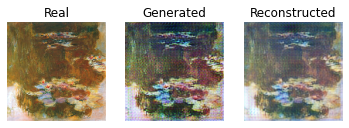

[INFO] Domain B to Domain A


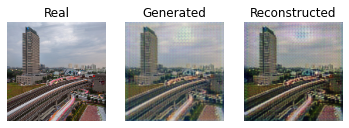

epoch: 41 step: 1 dA_loss: 0.061 dB_loss: 0.011 gAB_loss :4.050 gBA_loss: 4.255
epoch: 41 step: 2 dA_loss: 0.073 dB_loss: 0.017 gAB_loss :4.087 gBA_loss: 4.240
epoch: 41 step: 3 dA_loss: 0.143 dB_loss: 0.042 gAB_loss :4.369 gBA_loss: 4.632
epoch: 41 step: 4 dA_loss: 0.157 dB_loss: 0.049 gAB_loss :3.890 gBA_loss: 4.343
epoch: 41 step: 5 dA_loss: 0.014 dB_loss: 0.040 gAB_loss :4.485 gBA_loss: 5.177
epoch: 41 step: 6 dA_loss: 0.181 dB_loss: 0.390 gAB_loss :4.538 gBA_loss: 4.709
epoch: 41 step: 7 dA_loss: 0.059 dB_loss: 0.236 gAB_loss :4.465 gBA_loss: 4.370
epoch: 41 step: 8 dA_loss: 0.044 dB_loss: 0.035 gAB_loss :4.658 gBA_loss: 5.011
epoch: 41 step: 9 dA_loss: 0.033 dB_loss: 0.066 gAB_loss :4.860 gBA_loss: 5.356
epoch: 41 step: 10 dA_loss: 0.024 dB_loss: 0.017 gAB_loss :4.615 gBA_loss: 4.834
epoch: 41 step: 11 dA_loss: 0.007 dB_loss: 0.147 gAB_loss :4.237 gBA_loss: 4.355
epoch: 41 step: 12 dA_loss: 0.005 dB_loss: 0.139 gAB_loss :4.543 gBA_loss: 4.577
epoch: 41 step: 13 dA_loss: 0.061 dB_

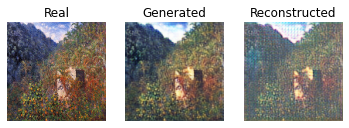

[INFO] Domain B to Domain A


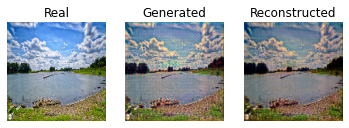

epoch: 41 step: 51 dA_loss: 0.172 dB_loss: 0.024 gAB_loss :4.525 gBA_loss: 4.694
epoch: 41 step: 52 dA_loss: 0.057 dB_loss: 0.077 gAB_loss :4.483 gBA_loss: 4.355
epoch: 41 step: 53 dA_loss: 0.132 dB_loss: 0.056 gAB_loss :3.952 gBA_loss: 3.950
epoch: 41 step: 54 dA_loss: 0.086 dB_loss: 0.083 gAB_loss :3.990 gBA_loss: 4.196
epoch: 41 step: 55 dA_loss: 0.045 dB_loss: 0.065 gAB_loss :4.524 gBA_loss: 4.206
epoch: 41 step: 56 dA_loss: 0.111 dB_loss: 0.032 gAB_loss :4.140 gBA_loss: 4.329
epoch: 41 step: 57 dA_loss: 0.067 dB_loss: 0.106 gAB_loss :4.122 gBA_loss: 4.122
epoch: 41 step: 58 dA_loss: 0.021 dB_loss: 0.008 gAB_loss :4.717 gBA_loss: 4.753
epoch: 41 step: 59 dA_loss: 0.097 dB_loss: 0.018 gAB_loss :3.996 gBA_loss: 4.101
epoch: 41 step: 60 dA_loss: 0.015 dB_loss: 0.011 gAB_loss :4.209 gBA_loss: 4.325
epoch: 41 step: 61 dA_loss: 0.034 dB_loss: 0.068 gAB_loss :4.598 gBA_loss: 4.448
epoch: 41 step: 62 dA_loss: 0.038 dB_loss: 0.011 gAB_loss :4.611 gBA_loss: 4.385
epoch: 41 step: 63 dA_loss: 

 42%|████▏     | 42/100 [1:09:03<1:34:37, 97.89s/it]

epoch: 41 step: 73 dA_loss: 0.071 dB_loss: 0.074 gAB_loss :4.422 gBA_loss: 4.486
epoch: 42 step: 0 dA_loss: 0.030 dB_loss: 0.127 gAB_loss :4.578 gBA_loss: 4.361
[INFO] Domain A to Domain B


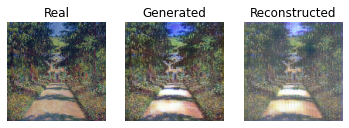

[INFO] Domain B to Domain A


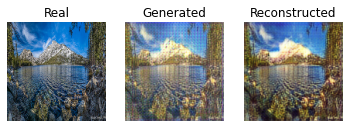

epoch: 42 step: 1 dA_loss: 0.049 dB_loss: 0.005 gAB_loss :4.098 gBA_loss: 4.313
epoch: 42 step: 2 dA_loss: 0.058 dB_loss: 0.021 gAB_loss :4.020 gBA_loss: 4.228
epoch: 42 step: 3 dA_loss: 0.038 dB_loss: 0.031 gAB_loss :4.289 gBA_loss: 4.479
epoch: 42 step: 4 dA_loss: 0.078 dB_loss: 0.018 gAB_loss :3.947 gBA_loss: 4.174
epoch: 42 step: 5 dA_loss: 0.012 dB_loss: 0.026 gAB_loss :4.598 gBA_loss: 5.064
epoch: 42 step: 6 dA_loss: 0.127 dB_loss: 0.153 gAB_loss :4.512 gBA_loss: 4.690
epoch: 42 step: 7 dA_loss: 0.030 dB_loss: 0.068 gAB_loss :4.509 gBA_loss: 4.445
epoch: 42 step: 8 dA_loss: 0.019 dB_loss: 0.003 gAB_loss :4.711 gBA_loss: 5.031
epoch: 42 step: 9 dA_loss: 0.036 dB_loss: 0.005 gAB_loss :4.947 gBA_loss: 5.355
epoch: 42 step: 10 dA_loss: 0.025 dB_loss: 0.005 gAB_loss :4.716 gBA_loss: 4.837
epoch: 42 step: 11 dA_loss: 0.006 dB_loss: 0.125 gAB_loss :4.282 gBA_loss: 4.357
epoch: 42 step: 12 dA_loss: 0.005 dB_loss: 0.114 gAB_loss :4.490 gBA_loss: 4.570
epoch: 42 step: 13 dA_loss: 0.062 dB_

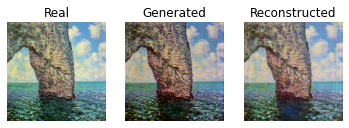

[INFO] Domain B to Domain A


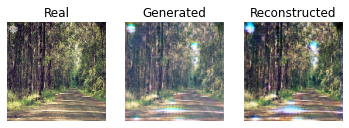

epoch: 42 step: 51 dA_loss: 0.005 dB_loss: 0.018 gAB_loss :4.372 gBA_loss: 4.478
epoch: 42 step: 52 dA_loss: 0.014 dB_loss: 0.069 gAB_loss :4.521 gBA_loss: 4.253
epoch: 42 step: 53 dA_loss: 0.063 dB_loss: 0.038 gAB_loss :3.843 gBA_loss: 3.957
epoch: 42 step: 54 dA_loss: 0.046 dB_loss: 0.056 gAB_loss :3.901 gBA_loss: 4.343
epoch: 42 step: 55 dA_loss: 0.008 dB_loss: 0.109 gAB_loss :4.653 gBA_loss: 4.355
epoch: 42 step: 56 dA_loss: 0.123 dB_loss: 0.047 gAB_loss :4.327 gBA_loss: 4.383
epoch: 42 step: 57 dA_loss: 0.053 dB_loss: 0.154 gAB_loss :4.059 gBA_loss: 4.322
epoch: 42 step: 58 dA_loss: 0.008 dB_loss: 0.053 gAB_loss :4.680 gBA_loss: 4.791
epoch: 42 step: 59 dA_loss: 0.081 dB_loss: 0.079 gAB_loss :3.892 gBA_loss: 4.098
epoch: 42 step: 60 dA_loss: 0.025 dB_loss: 0.064 gAB_loss :4.224 gBA_loss: 4.294
epoch: 42 step: 61 dA_loss: 0.028 dB_loss: 0.065 gAB_loss :4.582 gBA_loss: 4.448
epoch: 42 step: 62 dA_loss: 0.013 dB_loss: 0.014 gAB_loss :4.568 gBA_loss: 4.386
epoch: 42 step: 63 dA_loss: 

 43%|████▎     | 43/100 [1:10:40<1:32:58, 97.86s/it]

epoch: 42 step: 73 dA_loss: 0.081 dB_loss: 0.072 gAB_loss :4.404 gBA_loss: 4.315
epoch: 43 step: 0 dA_loss: 0.042 dB_loss: 0.114 gAB_loss :4.463 gBA_loss: 4.332
[INFO] Domain A to Domain B


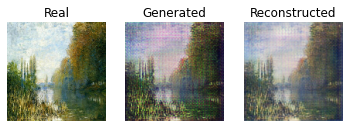

[INFO] Domain B to Domain A


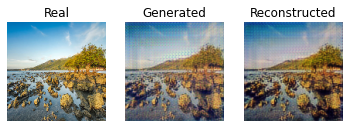

epoch: 43 step: 1 dA_loss: 0.059 dB_loss: 0.055 gAB_loss :4.151 gBA_loss: 4.226
epoch: 43 step: 2 dA_loss: 0.047 dB_loss: 0.107 gAB_loss :4.003 gBA_loss: 4.154
epoch: 43 step: 3 dA_loss: 0.093 dB_loss: 0.050 gAB_loss :4.274 gBA_loss: 4.458
epoch: 43 step: 4 dA_loss: 0.118 dB_loss: 0.120 gAB_loss :3.756 gBA_loss: 4.255
epoch: 43 step: 5 dA_loss: 0.007 dB_loss: 0.045 gAB_loss :4.370 gBA_loss: 5.132
epoch: 43 step: 6 dA_loss: 0.150 dB_loss: 0.152 gAB_loss :4.397 gBA_loss: 4.710
epoch: 43 step: 7 dA_loss: 0.045 dB_loss: 0.043 gAB_loss :4.496 gBA_loss: 4.477
epoch: 43 step: 8 dA_loss: 0.033 dB_loss: 0.006 gAB_loss :4.718 gBA_loss: 5.101
epoch: 43 step: 9 dA_loss: 0.034 dB_loss: 0.007 gAB_loss :4.980 gBA_loss: 5.415
epoch: 43 step: 10 dA_loss: 0.023 dB_loss: 0.008 gAB_loss :4.760 gBA_loss: 4.920
epoch: 43 step: 11 dA_loss: 0.007 dB_loss: 0.208 gAB_loss :4.250 gBA_loss: 4.356
epoch: 43 step: 12 dA_loss: 0.005 dB_loss: 0.098 gAB_loss :4.362 gBA_loss: 4.545
epoch: 43 step: 13 dA_loss: 0.048 dB_

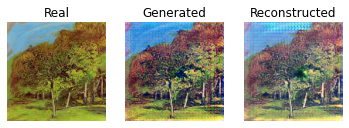

[INFO] Domain B to Domain A


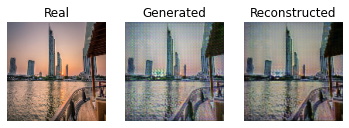

epoch: 43 step: 51 dA_loss: 0.067 dB_loss: 0.027 gAB_loss :4.459 gBA_loss: 4.521
epoch: 43 step: 52 dA_loss: 0.033 dB_loss: 0.070 gAB_loss :4.537 gBA_loss: 4.261
epoch: 43 step: 53 dA_loss: 0.069 dB_loss: 0.050 gAB_loss :3.835 gBA_loss: 3.916
epoch: 43 step: 54 dA_loss: 0.041 dB_loss: 0.065 gAB_loss :3.931 gBA_loss: 4.223
epoch: 43 step: 55 dA_loss: 0.017 dB_loss: 0.068 gAB_loss :4.536 gBA_loss: 4.294
epoch: 43 step: 56 dA_loss: 0.103 dB_loss: 0.157 gAB_loss :4.396 gBA_loss: 4.415
epoch: 43 step: 57 dA_loss: 0.041 dB_loss: 0.260 gAB_loss :4.169 gBA_loss: 4.211
epoch: 43 step: 58 dA_loss: 0.008 dB_loss: 0.034 gAB_loss :4.575 gBA_loss: 4.760
epoch: 43 step: 59 dA_loss: 0.072 dB_loss: 0.095 gAB_loss :3.771 gBA_loss: 4.083
epoch: 43 step: 60 dA_loss: 0.021 dB_loss: 0.069 gAB_loss :4.168 gBA_loss: 4.352
epoch: 43 step: 61 dA_loss: 0.024 dB_loss: 0.073 gAB_loss :4.571 gBA_loss: 4.523
epoch: 43 step: 62 dA_loss: 0.019 dB_loss: 0.026 gAB_loss :4.571 gBA_loss: 4.416
epoch: 43 step: 63 dA_loss: 

 44%|████▍     | 44/100 [1:12:18<1:31:19, 97.85s/it]

epoch: 43 step: 73 dA_loss: 0.100 dB_loss: 0.085 gAB_loss :4.495 gBA_loss: 4.486
epoch: 44 step: 0 dA_loss: 0.026 dB_loss: 0.113 gAB_loss :4.497 gBA_loss: 4.329
[INFO] Domain A to Domain B


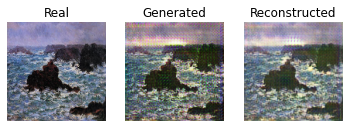

[INFO] Domain B to Domain A


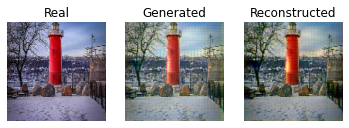

epoch: 44 step: 1 dA_loss: 0.035 dB_loss: 0.007 gAB_loss :4.001 gBA_loss: 4.223
epoch: 44 step: 2 dA_loss: 0.034 dB_loss: 0.024 gAB_loss :4.049 gBA_loss: 4.163
epoch: 44 step: 3 dA_loss: 0.067 dB_loss: 0.033 gAB_loss :4.332 gBA_loss: 4.490
epoch: 44 step: 4 dA_loss: 0.093 dB_loss: 0.016 gAB_loss :3.882 gBA_loss: 4.260
epoch: 44 step: 5 dA_loss: 0.007 dB_loss: 0.039 gAB_loss :4.548 gBA_loss: 5.133
epoch: 44 step: 6 dA_loss: 0.103 dB_loss: 0.118 gAB_loss :4.268 gBA_loss: 4.689
epoch: 44 step: 7 dA_loss: 0.030 dB_loss: 0.049 gAB_loss :4.341 gBA_loss: 4.536
epoch: 44 step: 8 dA_loss: 0.047 dB_loss: 0.031 gAB_loss :4.700 gBA_loss: 5.218
epoch: 44 step: 9 dA_loss: 0.008 dB_loss: 0.019 gAB_loss :4.964 gBA_loss: 5.336
epoch: 44 step: 10 dA_loss: 0.014 dB_loss: 0.003 gAB_loss :4.769 gBA_loss: 4.819
epoch: 44 step: 11 dA_loss: 0.006 dB_loss: 0.147 gAB_loss :4.275 gBA_loss: 4.283
epoch: 44 step: 12 dA_loss: 0.006 dB_loss: 0.109 gAB_loss :4.388 gBA_loss: 4.522
epoch: 44 step: 13 dA_loss: 0.063 dB_

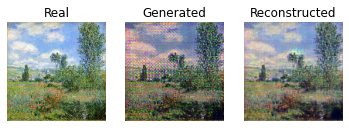

[INFO] Domain B to Domain A


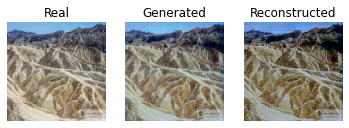

epoch: 44 step: 51 dA_loss: 0.079 dB_loss: 0.021 gAB_loss :4.456 gBA_loss: 4.453
epoch: 44 step: 52 dA_loss: 0.036 dB_loss: 0.090 gAB_loss :4.494 gBA_loss: 4.268
epoch: 44 step: 53 dA_loss: 0.071 dB_loss: 0.026 gAB_loss :3.747 gBA_loss: 3.930
epoch: 44 step: 54 dA_loss: 0.044 dB_loss: 0.111 gAB_loss :4.001 gBA_loss: 4.231
epoch: 44 step: 55 dA_loss: 0.024 dB_loss: 0.065 gAB_loss :4.529 gBA_loss: 4.242
epoch: 44 step: 56 dA_loss: 0.100 dB_loss: 0.063 gAB_loss :4.172 gBA_loss: 4.371
epoch: 44 step: 57 dA_loss: 0.022 dB_loss: 0.061 gAB_loss :4.056 gBA_loss: 4.021
epoch: 44 step: 58 dA_loss: 0.030 dB_loss: 0.010 gAB_loss :4.652 gBA_loss: 4.661
epoch: 44 step: 59 dA_loss: 0.051 dB_loss: 0.043 gAB_loss :3.814 gBA_loss: 4.094
epoch: 44 step: 60 dA_loss: 0.012 dB_loss: 0.167 gAB_loss :4.275 gBA_loss: 4.337
epoch: 44 step: 61 dA_loss: 0.015 dB_loss: 0.245 gAB_loss :4.468 gBA_loss: 4.503
epoch: 44 step: 62 dA_loss: 0.010 dB_loss: 0.226 gAB_loss :4.256 gBA_loss: 4.358
epoch: 44 step: 63 dA_loss: 

 45%|████▌     | 45/100 [1:13:56<1:29:45, 97.91s/it]

epoch: 44 step: 73 dA_loss: 0.094 dB_loss: 0.097 gAB_loss :4.330 gBA_loss: 4.471
epoch: 45 step: 0 dA_loss: 0.023 dB_loss: 0.180 gAB_loss :4.550 gBA_loss: 4.332
[INFO] Domain A to Domain B


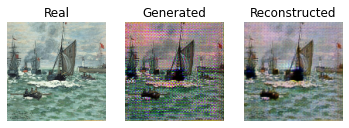

[INFO] Domain B to Domain A


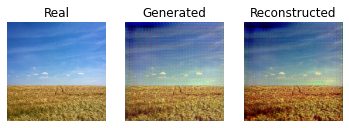

epoch: 45 step: 1 dA_loss: 0.024 dB_loss: 0.029 gAB_loss :3.992 gBA_loss: 4.172
epoch: 45 step: 2 dA_loss: 0.026 dB_loss: 0.017 gAB_loss :3.913 gBA_loss: 4.087
epoch: 45 step: 3 dA_loss: 0.088 dB_loss: 0.037 gAB_loss :4.279 gBA_loss: 4.416
epoch: 45 step: 4 dA_loss: 0.093 dB_loss: 0.021 gAB_loss :3.861 gBA_loss: 4.290
epoch: 45 step: 5 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :4.598 gBA_loss: 5.113
epoch: 45 step: 6 dA_loss: 0.120 dB_loss: 0.205 gAB_loss :4.255 gBA_loss: 4.693
epoch: 45 step: 7 dA_loss: 0.044 dB_loss: 0.058 gAB_loss :4.444 gBA_loss: 4.403
epoch: 45 step: 8 dA_loss: 0.036 dB_loss: 0.010 gAB_loss :4.732 gBA_loss: 5.061
epoch: 45 step: 9 dA_loss: 0.009 dB_loss: 0.032 gAB_loss :4.937 gBA_loss: 5.292
epoch: 45 step: 10 dA_loss: 0.009 dB_loss: 0.006 gAB_loss :4.682 gBA_loss: 4.831
epoch: 45 step: 11 dA_loss: 0.008 dB_loss: 0.168 gAB_loss :4.367 gBA_loss: 4.340
epoch: 45 step: 12 dA_loss: 0.006 dB_loss: 0.132 gAB_loss :4.400 gBA_loss: 4.578
epoch: 45 step: 13 dA_loss: 0.055 dB_

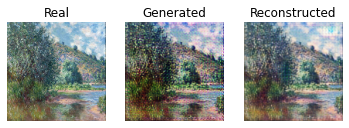

[INFO] Domain B to Domain A


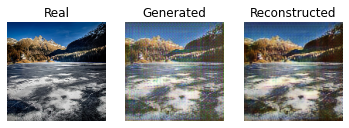

epoch: 45 step: 51 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :4.443 gBA_loss: 4.401
epoch: 45 step: 52 dA_loss: 0.048 dB_loss: 0.094 gAB_loss :4.392 gBA_loss: 4.118
epoch: 45 step: 53 dA_loss: 0.073 dB_loss: 0.028 gAB_loss :3.689 gBA_loss: 3.867
epoch: 45 step: 54 dA_loss: 0.037 dB_loss: 0.110 gAB_loss :3.965 gBA_loss: 4.186
epoch: 45 step: 55 dA_loss: 0.007 dB_loss: 0.094 gAB_loss :4.598 gBA_loss: 4.237
epoch: 45 step: 56 dA_loss: 0.085 dB_loss: 0.074 gAB_loss :4.225 gBA_loss: 4.368
epoch: 45 step: 57 dA_loss: 0.028 dB_loss: 0.095 gAB_loss :3.855 gBA_loss: 4.031
epoch: 45 step: 58 dA_loss: 0.024 dB_loss: 0.206 gAB_loss :4.843 gBA_loss: 4.631
epoch: 45 step: 59 dA_loss: 0.089 dB_loss: 0.172 gAB_loss :4.099 gBA_loss: 4.104
epoch: 45 step: 60 dA_loss: 0.011 dB_loss: 0.033 gAB_loss :4.129 gBA_loss: 4.301
epoch: 45 step: 61 dA_loss: 0.015 dB_loss: 0.085 gAB_loss :4.361 gBA_loss: 4.408
epoch: 45 step: 62 dA_loss: 0.020 dB_loss: 0.019 gAB_loss :4.451 gBA_loss: 4.394
epoch: 45 step: 63 dA_loss: 

 46%|████▌     | 46/100 [1:15:34<1:28:07, 97.91s/it]

epoch: 45 step: 73 dA_loss: 0.076 dB_loss: 0.066 gAB_loss :4.439 gBA_loss: 4.514
epoch: 46 step: 0 dA_loss: 0.034 dB_loss: 0.100 gAB_loss :4.509 gBA_loss: 4.374
[INFO] Domain A to Domain B


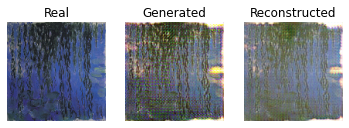

[INFO] Domain B to Domain A


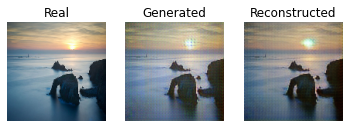

epoch: 46 step: 1 dA_loss: 0.015 dB_loss: 0.015 gAB_loss :4.041 gBA_loss: 4.075
epoch: 46 step: 2 dA_loss: 0.023 dB_loss: 0.007 gAB_loss :4.021 gBA_loss: 4.093
epoch: 46 step: 3 dA_loss: 0.052 dB_loss: 0.033 gAB_loss :4.290 gBA_loss: 4.406
epoch: 46 step: 4 dA_loss: 0.062 dB_loss: 0.011 gAB_loss :3.842 gBA_loss: 4.193
epoch: 46 step: 5 dA_loss: 0.006 dB_loss: 0.016 gAB_loss :4.554 gBA_loss: 5.073
epoch: 46 step: 6 dA_loss: 0.099 dB_loss: 0.119 gAB_loss :4.355 gBA_loss: 4.667
epoch: 46 step: 7 dA_loss: 0.019 dB_loss: 0.056 gAB_loss :4.431 gBA_loss: 4.513
epoch: 46 step: 8 dA_loss: 0.014 dB_loss: 0.005 gAB_loss :4.674 gBA_loss: 5.043
epoch: 46 step: 9 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :4.927 gBA_loss: 5.212
epoch: 46 step: 10 dA_loss: 0.011 dB_loss: 0.003 gAB_loss :4.687 gBA_loss: 4.761
epoch: 46 step: 11 dA_loss: 0.006 dB_loss: 0.144 gAB_loss :4.202 gBA_loss: 4.282
epoch: 46 step: 12 dA_loss: 0.006 dB_loss: 0.113 gAB_loss :4.474 gBA_loss: 4.502
epoch: 46 step: 13 dA_loss: 0.045 dB_

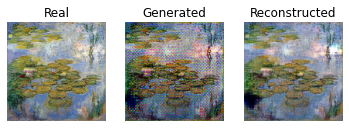

[INFO] Domain B to Domain A


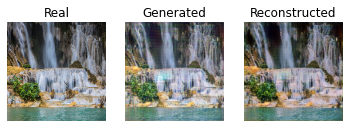

epoch: 46 step: 51 dA_loss: 0.019 dB_loss: 0.012 gAB_loss :4.457 gBA_loss: 4.379
epoch: 46 step: 52 dA_loss: 0.007 dB_loss: 0.150 gAB_loss :4.402 gBA_loss: 4.219
epoch: 46 step: 53 dA_loss: 0.031 dB_loss: 0.042 gAB_loss :3.748 gBA_loss: 3.922
epoch: 46 step: 54 dA_loss: 0.028 dB_loss: 0.055 gAB_loss :3.840 gBA_loss: 4.248
epoch: 46 step: 55 dA_loss: 0.004 dB_loss: 0.105 gAB_loss :4.544 gBA_loss: 4.306
epoch: 46 step: 56 dA_loss: 0.068 dB_loss: 0.061 gAB_loss :4.284 gBA_loss: 4.295
epoch: 46 step: 57 dA_loss: 0.034 dB_loss: 0.125 gAB_loss :3.969 gBA_loss: 4.231
epoch: 46 step: 58 dA_loss: 0.008 dB_loss: 0.071 gAB_loss :4.637 gBA_loss: 4.753
epoch: 46 step: 59 dA_loss: 0.056 dB_loss: 0.025 gAB_loss :4.041 gBA_loss: 4.090
epoch: 46 step: 60 dA_loss: 0.007 dB_loss: 0.014 gAB_loss :4.226 gBA_loss: 4.274
epoch: 46 step: 61 dA_loss: 0.009 dB_loss: 0.066 gAB_loss :4.479 gBA_loss: 4.443
epoch: 46 step: 62 dA_loss: 0.005 dB_loss: 0.028 gAB_loss :4.469 gBA_loss: 4.366
epoch: 46 step: 63 dA_loss: 

 47%|████▋     | 47/100 [1:17:12<1:26:28, 97.89s/it]

epoch: 46 step: 73 dA_loss: 0.058 dB_loss: 0.067 gAB_loss :4.423 gBA_loss: 4.538
epoch: 47 step: 0 dA_loss: 0.022 dB_loss: 0.100 gAB_loss :4.478 gBA_loss: 4.429
[INFO] Domain A to Domain B


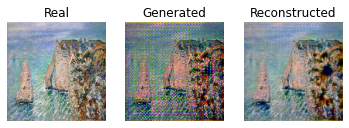

[INFO] Domain B to Domain A


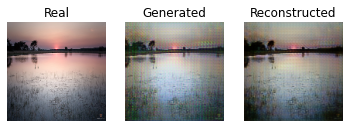

epoch: 47 step: 1 dA_loss: 0.013 dB_loss: 0.010 gAB_loss :3.977 gBA_loss: 4.123
epoch: 47 step: 2 dA_loss: 0.020 dB_loss: 0.015 gAB_loss :4.039 gBA_loss: 4.096
epoch: 47 step: 3 dA_loss: 0.035 dB_loss: 0.024 gAB_loss :4.317 gBA_loss: 4.457
epoch: 47 step: 4 dA_loss: 0.036 dB_loss: 0.012 gAB_loss :3.856 gBA_loss: 4.271
epoch: 47 step: 5 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :4.560 gBA_loss: 5.072
epoch: 47 step: 6 dA_loss: 0.078 dB_loss: 0.111 gAB_loss :4.262 gBA_loss: 4.697
epoch: 47 step: 7 dA_loss: 0.010 dB_loss: 0.092 gAB_loss :4.467 gBA_loss: 4.477
epoch: 47 step: 8 dA_loss: 0.015 dB_loss: 0.005 gAB_loss :4.641 gBA_loss: 5.007
epoch: 47 step: 9 dA_loss: 0.010 dB_loss: 0.072 gAB_loss :4.877 gBA_loss: 5.267
epoch: 47 step: 10 dA_loss: 0.014 dB_loss: 0.009 gAB_loss :4.656 gBA_loss: 4.866
epoch: 47 step: 11 dA_loss: 0.008 dB_loss: 0.199 gAB_loss :4.173 gBA_loss: 4.350
epoch: 47 step: 12 dA_loss: 0.008 dB_loss: 0.216 gAB_loss :4.312 gBA_loss: 4.507
epoch: 47 step: 13 dA_loss: 0.040 dB_

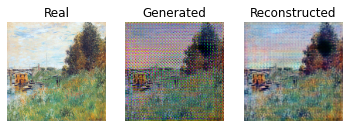

[INFO] Domain B to Domain A


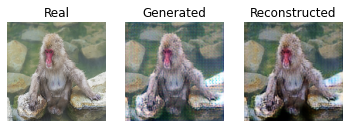

epoch: 47 step: 51 dA_loss: 0.091 dB_loss: 0.026 gAB_loss :4.455 gBA_loss: 4.503
epoch: 47 step: 52 dA_loss: 0.025 dB_loss: 0.144 gAB_loss :4.432 gBA_loss: 4.222
epoch: 47 step: 53 dA_loss: 0.044 dB_loss: 0.060 gAB_loss :3.793 gBA_loss: 3.877
epoch: 47 step: 54 dA_loss: 0.045 dB_loss: 0.099 gAB_loss :3.910 gBA_loss: 4.107
epoch: 47 step: 55 dA_loss: 0.017 dB_loss: 0.084 gAB_loss :4.449 gBA_loss: 4.185
epoch: 47 step: 56 dA_loss: 0.059 dB_loss: 0.118 gAB_loss :4.315 gBA_loss: 4.298
epoch: 47 step: 57 dA_loss: 0.071 dB_loss: 0.188 gAB_loss :4.024 gBA_loss: 4.249
epoch: 47 step: 58 dA_loss: 0.008 dB_loss: 0.021 gAB_loss :4.532 gBA_loss: 4.725
epoch: 47 step: 59 dA_loss: 0.102 dB_loss: 0.055 gAB_loss :3.936 gBA_loss: 3.959
epoch: 47 step: 60 dA_loss: 0.068 dB_loss: 0.014 gAB_loss :4.123 gBA_loss: 4.089
epoch: 47 step: 61 dA_loss: 0.017 dB_loss: 0.075 gAB_loss :4.426 gBA_loss: 4.313
epoch: 47 step: 62 dA_loss: 0.008 dB_loss: 0.037 gAB_loss :4.445 gBA_loss: 4.313
epoch: 47 step: 63 dA_loss: 

 48%|████▊     | 48/100 [1:18:50<1:24:55, 97.99s/it]

epoch: 47 step: 73 dA_loss: 0.051 dB_loss: 0.066 gAB_loss :4.287 gBA_loss: 4.510
epoch: 48 step: 0 dA_loss: 0.018 dB_loss: 0.104 gAB_loss :4.486 gBA_loss: 4.442
[INFO] Domain A to Domain B


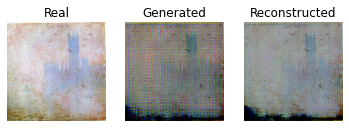

[INFO] Domain B to Domain A


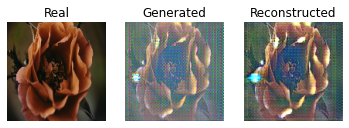

epoch: 48 step: 1 dA_loss: 0.012 dB_loss: 0.012 gAB_loss :3.990 gBA_loss: 4.196
epoch: 48 step: 2 dA_loss: 0.027 dB_loss: 0.015 gAB_loss :3.959 gBA_loss: 4.061
epoch: 48 step: 3 dA_loss: 0.051 dB_loss: 0.019 gAB_loss :4.234 gBA_loss: 4.459
epoch: 48 step: 4 dA_loss: 0.036 dB_loss: 0.017 gAB_loss :3.849 gBA_loss: 4.215
epoch: 48 step: 5 dA_loss: 0.005 dB_loss: 0.005 gAB_loss :4.562 gBA_loss: 5.036
epoch: 48 step: 6 dA_loss: 0.068 dB_loss: 0.122 gAB_loss :4.281 gBA_loss: 4.710
epoch: 48 step: 7 dA_loss: 0.008 dB_loss: 0.033 gAB_loss :4.378 gBA_loss: 4.483
epoch: 48 step: 8 dA_loss: 0.022 dB_loss: 0.007 gAB_loss :4.623 gBA_loss: 5.024
epoch: 48 step: 9 dA_loss: 0.012 dB_loss: 0.036 gAB_loss :4.987 gBA_loss: 5.233
epoch: 48 step: 10 dA_loss: 0.007 dB_loss: 0.003 gAB_loss :4.768 gBA_loss: 4.773
epoch: 48 step: 11 dA_loss: 0.004 dB_loss: 0.195 gAB_loss :4.286 gBA_loss: 4.270
epoch: 48 step: 12 dA_loss: 0.003 dB_loss: 0.175 gAB_loss :4.349 gBA_loss: 4.462
epoch: 48 step: 13 dA_loss: 0.036 dB_

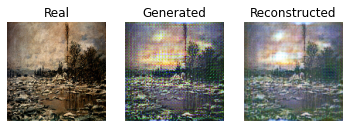

[INFO] Domain B to Domain A


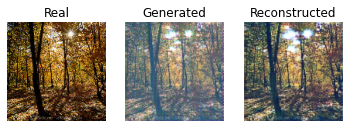

epoch: 48 step: 51 dA_loss: 0.032 dB_loss: 0.010 gAB_loss :4.396 gBA_loss: 4.384
epoch: 48 step: 52 dA_loss: 0.021 dB_loss: 0.087 gAB_loss :4.399 gBA_loss: 4.173
epoch: 48 step: 53 dA_loss: 0.029 dB_loss: 0.075 gAB_loss :3.819 gBA_loss: 3.858
epoch: 48 step: 54 dA_loss: 0.040 dB_loss: 0.055 gAB_loss :3.861 gBA_loss: 4.251
epoch: 48 step: 55 dA_loss: 0.009 dB_loss: 0.071 gAB_loss :4.443 gBA_loss: 4.236
epoch: 48 step: 56 dA_loss: 0.072 dB_loss: 0.073 gAB_loss :4.266 gBA_loss: 4.253
epoch: 48 step: 57 dA_loss: 0.024 dB_loss: 0.118 gAB_loss :4.002 gBA_loss: 3.845
epoch: 48 step: 58 dA_loss: 0.120 dB_loss: 0.005 gAB_loss :4.531 gBA_loss: 4.782
epoch: 48 step: 59 dA_loss: 0.063 dB_loss: 0.063 gAB_loss :4.044 gBA_loss: 4.094
epoch: 48 step: 60 dA_loss: 0.066 dB_loss: 0.010 gAB_loss :4.194 gBA_loss: 4.171
epoch: 48 step: 61 dA_loss: 0.025 dB_loss: 0.091 gAB_loss :4.495 gBA_loss: 4.267
epoch: 48 step: 62 dA_loss: 0.022 dB_loss: 0.020 gAB_loss :4.447 gBA_loss: 4.353
epoch: 48 step: 63 dA_loss: 

 49%|████▉     | 49/100 [1:20:28<1:23:14, 97.94s/it]

epoch: 48 step: 73 dA_loss: 0.057 dB_loss: 0.091 gAB_loss :4.363 gBA_loss: 4.419
epoch: 49 step: 0 dA_loss: 0.008 dB_loss: 0.085 gAB_loss :4.326 gBA_loss: 4.346
[INFO] Domain A to Domain B


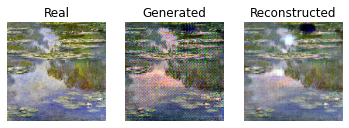

[INFO] Domain B to Domain A


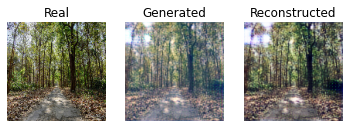

epoch: 49 step: 1 dA_loss: 0.012 dB_loss: 0.118 gAB_loss :4.077 gBA_loss: 4.162
epoch: 49 step: 2 dA_loss: 0.020 dB_loss: 0.133 gAB_loss :3.987 gBA_loss: 3.973
epoch: 49 step: 3 dA_loss: 0.040 dB_loss: 0.054 gAB_loss :4.234 gBA_loss: 4.417
epoch: 49 step: 4 dA_loss: 0.058 dB_loss: 0.173 gAB_loss :3.701 gBA_loss: 4.245
epoch: 49 step: 5 dA_loss: 0.005 dB_loss: 0.039 gAB_loss :4.357 gBA_loss: 5.100
epoch: 49 step: 6 dA_loss: 0.058 dB_loss: 0.094 gAB_loss :4.159 gBA_loss: 4.687
epoch: 49 step: 7 dA_loss: 0.015 dB_loss: 0.056 gAB_loss :4.275 gBA_loss: 4.474
epoch: 49 step: 8 dA_loss: 0.026 dB_loss: 0.015 gAB_loss :4.558 gBA_loss: 4.995
epoch: 49 step: 9 dA_loss: 0.006 dB_loss: 0.024 gAB_loss :4.925 gBA_loss: 5.168
epoch: 49 step: 10 dA_loss: 0.006 dB_loss: 0.006 gAB_loss :4.733 gBA_loss: 4.731
epoch: 49 step: 11 dA_loss: 0.006 dB_loss: 0.180 gAB_loss :4.213 gBA_loss: 4.288
epoch: 49 step: 12 dA_loss: 0.005 dB_loss: 0.148 gAB_loss :4.417 gBA_loss: 4.438
epoch: 49 step: 13 dA_loss: 0.053 dB_

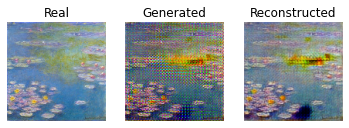

[INFO] Domain B to Domain A


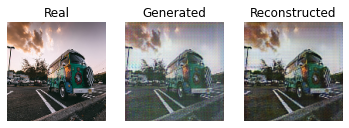

epoch: 49 step: 51 dA_loss: 0.015 dB_loss: 0.027 gAB_loss :4.420 gBA_loss: 4.418
epoch: 49 step: 52 dA_loss: 0.038 dB_loss: 0.065 gAB_loss :4.459 gBA_loss: 4.094
epoch: 49 step: 53 dA_loss: 0.023 dB_loss: 0.029 gAB_loss :3.705 gBA_loss: 3.814
epoch: 49 step: 54 dA_loss: 0.022 dB_loss: 0.066 gAB_loss :3.956 gBA_loss: 4.126
epoch: 49 step: 55 dA_loss: 0.004 dB_loss: 0.079 gAB_loss :4.553 gBA_loss: 4.155
epoch: 49 step: 56 dA_loss: 0.042 dB_loss: 0.047 gAB_loss :4.185 gBA_loss: 4.240
epoch: 49 step: 57 dA_loss: 0.040 dB_loss: 0.074 gAB_loss :4.016 gBA_loss: 4.193
epoch: 49 step: 58 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :4.604 gBA_loss: 4.663
epoch: 49 step: 59 dA_loss: 0.049 dB_loss: 0.024 gAB_loss :3.865 gBA_loss: 3.913
epoch: 49 step: 60 dA_loss: 0.021 dB_loss: 0.057 gAB_loss :4.223 gBA_loss: 4.122
epoch: 49 step: 61 dA_loss: 0.013 dB_loss: 0.065 gAB_loss :4.580 gBA_loss: 4.377
epoch: 49 step: 62 dA_loss: 0.012 dB_loss: 0.057 gAB_loss :4.487 gBA_loss: 4.382
epoch: 49 step: 63 dA_loss: 

 50%|█████     | 50/100 [1:22:06<1:21:35, 97.90s/it]

epoch: 49 step: 73 dA_loss: 0.042 dB_loss: 0.079 gAB_loss :4.396 gBA_loss: 4.464
epoch: 50 step: 0 dA_loss: 0.067 dB_loss: 0.075 gAB_loss :4.257 gBA_loss: 4.292
[INFO] Domain A to Domain B


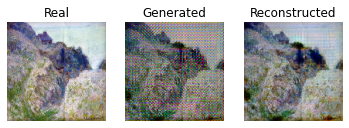

[INFO] Domain B to Domain A


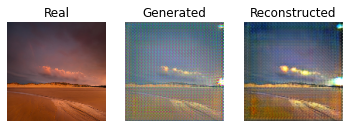

epoch: 50 step: 1 dA_loss: 0.030 dB_loss: 0.073 gAB_loss :3.980 gBA_loss: 3.996
epoch: 50 step: 2 dA_loss: 0.026 dB_loss: 0.071 gAB_loss :3.926 gBA_loss: 3.956
epoch: 50 step: 3 dA_loss: 0.031 dB_loss: 0.038 gAB_loss :4.194 gBA_loss: 4.380
epoch: 50 step: 4 dA_loss: 0.029 dB_loss: 0.052 gAB_loss :3.745 gBA_loss: 4.204
epoch: 50 step: 5 dA_loss: 0.008 dB_loss: 0.029 gAB_loss :4.428 gBA_loss: 5.034
epoch: 50 step: 6 dA_loss: 0.052 dB_loss: 0.089 gAB_loss :4.174 gBA_loss: 4.644
epoch: 50 step: 7 dA_loss: 0.018 dB_loss: 0.053 gAB_loss :4.298 gBA_loss: 4.290
epoch: 50 step: 8 dA_loss: 0.045 dB_loss: 0.010 gAB_loss :4.564 gBA_loss: 5.088
epoch: 50 step: 9 dA_loss: 0.008 dB_loss: 0.021 gAB_loss :4.929 gBA_loss: 5.175
epoch: 50 step: 10 dA_loss: 0.011 dB_loss: 0.005 gAB_loss :4.711 gBA_loss: 4.671
epoch: 50 step: 11 dA_loss: 0.007 dB_loss: 0.167 gAB_loss :4.195 gBA_loss: 4.156
epoch: 50 step: 12 dA_loss: 0.005 dB_loss: 0.099 gAB_loss :4.373 gBA_loss: 4.383
epoch: 50 step: 13 dA_loss: 0.044 dB_

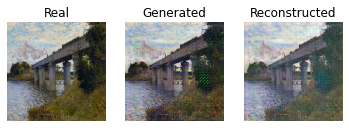

[INFO] Domain B to Domain A


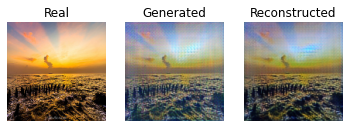

epoch: 50 step: 51 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :4.303 gBA_loss: 4.273
epoch: 50 step: 52 dA_loss: 0.013 dB_loss: 0.057 gAB_loss :4.318 gBA_loss: 4.056
epoch: 50 step: 53 dA_loss: 0.026 dB_loss: 0.038 gAB_loss :3.684 gBA_loss: 3.836
epoch: 50 step: 54 dA_loss: 0.027 dB_loss: 0.044 gAB_loss :3.851 gBA_loss: 4.159
epoch: 50 step: 55 dA_loss: 0.003 dB_loss: 0.078 gAB_loss :4.497 gBA_loss: 4.159
epoch: 50 step: 56 dA_loss: 0.042 dB_loss: 0.040 gAB_loss :4.241 gBA_loss: 4.233
epoch: 50 step: 57 dA_loss: 0.012 dB_loss: 0.095 gAB_loss :3.926 gBA_loss: 3.870
epoch: 50 step: 58 dA_loss: 0.042 dB_loss: 0.014 gAB_loss :4.586 gBA_loss: 4.670
epoch: 50 step: 59 dA_loss: 0.020 dB_loss: 0.054 gAB_loss :4.008 gBA_loss: 4.000
epoch: 50 step: 60 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :4.143 gBA_loss: 4.222
epoch: 50 step: 61 dA_loss: 0.007 dB_loss: 0.082 gAB_loss :4.465 gBA_loss: 4.293
epoch: 50 step: 62 dA_loss: 0.007 dB_loss: 0.027 gAB_loss :4.405 gBA_loss: 4.301
epoch: 50 step: 63 dA_loss: 

 51%|█████     | 51/100 [1:23:44<1:19:55, 97.87s/it]

epoch: 50 step: 73 dA_loss: 0.037 dB_loss: 0.077 gAB_loss :4.360 gBA_loss: 4.417
epoch: 51 step: 0 dA_loss: 0.032 dB_loss: 0.094 gAB_loss :4.374 gBA_loss: 4.283
[INFO] Domain A to Domain B


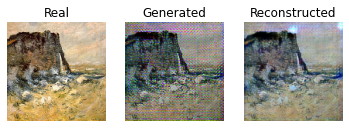

[INFO] Domain B to Domain A


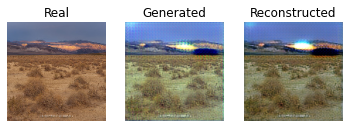

epoch: 51 step: 1 dA_loss: 0.025 dB_loss: 0.012 gAB_loss :3.966 gBA_loss: 4.034
epoch: 51 step: 2 dA_loss: 0.064 dB_loss: 0.034 gAB_loss :4.022 gBA_loss: 4.294
epoch: 51 step: 3 dA_loss: 0.033 dB_loss: 0.022 gAB_loss :4.386 gBA_loss: 4.558
epoch: 51 step: 4 dA_loss: 0.019 dB_loss: 0.039 gAB_loss :3.989 gBA_loss: 4.253
epoch: 51 step: 5 dA_loss: 0.009 dB_loss: 0.005 gAB_loss :4.500 gBA_loss: 5.031
epoch: 51 step: 6 dA_loss: 0.048 dB_loss: 0.115 gAB_loss :4.217 gBA_loss: 4.691
epoch: 51 step: 7 dA_loss: 0.018 dB_loss: 0.046 gAB_loss :4.300 gBA_loss: 4.316
epoch: 51 step: 8 dA_loss: 0.011 dB_loss: 0.012 gAB_loss :4.519 gBA_loss: 4.849
epoch: 51 step: 9 dA_loss: 0.052 dB_loss: 0.009 gAB_loss :4.816 gBA_loss: 5.209
epoch: 51 step: 10 dA_loss: 0.029 dB_loss: 0.005 gAB_loss :4.644 gBA_loss: 4.703
epoch: 51 step: 11 dA_loss: 0.011 dB_loss: 0.130 gAB_loss :4.143 gBA_loss: 4.159
epoch: 51 step: 12 dA_loss: 0.009 dB_loss: 0.110 gAB_loss :4.377 gBA_loss: 4.373
epoch: 51 step: 13 dA_loss: 0.043 dB_

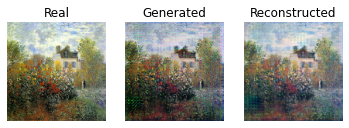

[INFO] Domain B to Domain A


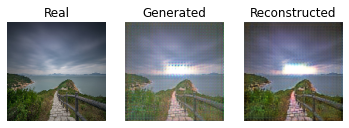

epoch: 51 step: 51 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :4.338 gBA_loss: 4.292
epoch: 51 step: 52 dA_loss: 0.022 dB_loss: 0.076 gAB_loss :4.376 gBA_loss: 4.137
epoch: 51 step: 53 dA_loss: 0.018 dB_loss: 0.038 gAB_loss :3.887 gBA_loss: 4.022
epoch: 51 step: 54 dA_loss: 0.021 dB_loss: 0.035 gAB_loss :3.987 gBA_loss: 4.302
epoch: 51 step: 55 dA_loss: 0.004 dB_loss: 0.081 gAB_loss :4.570 gBA_loss: 4.294
epoch: 51 step: 56 dA_loss: 0.020 dB_loss: 0.040 gAB_loss :4.314 gBA_loss: 4.379
epoch: 51 step: 57 dA_loss: 0.019 dB_loss: 0.078 gAB_loss :3.884 gBA_loss: 4.057
epoch: 51 step: 58 dA_loss: 0.019 dB_loss: 0.023 gAB_loss :4.624 gBA_loss: 4.687
epoch: 51 step: 59 dA_loss: 0.018 dB_loss: 0.023 gAB_loss :4.045 gBA_loss: 4.052
epoch: 51 step: 60 dA_loss: 0.007 dB_loss: 0.007 gAB_loss :4.199 gBA_loss: 4.275
epoch: 51 step: 61 dA_loss: 0.005 dB_loss: 0.062 gAB_loss :4.473 gBA_loss: 4.325
epoch: 51 step: 62 dA_loss: 0.005 dB_loss: 0.017 gAB_loss :4.418 gBA_loss: 4.295
epoch: 51 step: 63 dA_loss: 

 52%|█████▏    | 52/100 [1:25:21<1:18:16, 97.85s/it]

epoch: 51 step: 73 dA_loss: 0.036 dB_loss: 0.069 gAB_loss :4.325 gBA_loss: 4.431
epoch: 52 step: 0 dA_loss: 0.007 dB_loss: 0.058 gAB_loss :4.335 gBA_loss: 4.326
[INFO] Domain A to Domain B


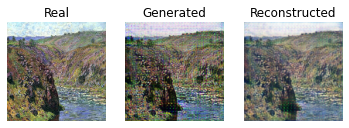

[INFO] Domain B to Domain A


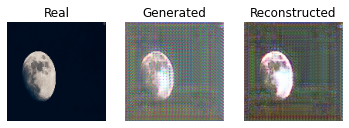

epoch: 52 step: 1 dA_loss: 0.007 dB_loss: 0.010 gAB_loss :3.964 gBA_loss: 4.132
epoch: 52 step: 2 dA_loss: 0.028 dB_loss: 0.021 gAB_loss :3.971 gBA_loss: 4.007
epoch: 52 step: 3 dA_loss: 0.022 dB_loss: 0.009 gAB_loss :4.275 gBA_loss: 4.326
epoch: 52 step: 4 dA_loss: 0.023 dB_loss: 0.023 gAB_loss :3.845 gBA_loss: 4.223
epoch: 52 step: 5 dA_loss: 0.007 dB_loss: 0.004 gAB_loss :4.495 gBA_loss: 5.063
epoch: 52 step: 6 dA_loss: 0.037 dB_loss: 0.097 gAB_loss :4.191 gBA_loss: 4.708
epoch: 52 step: 7 dA_loss: 0.005 dB_loss: 0.038 gAB_loss :4.245 gBA_loss: 4.423
epoch: 52 step: 8 dA_loss: 0.008 dB_loss: 0.013 gAB_loss :4.509 gBA_loss: 4.866
epoch: 52 step: 9 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :4.822 gBA_loss: 5.033
epoch: 52 step: 10 dA_loss: 0.010 dB_loss: 0.005 gAB_loss :4.636 gBA_loss: 4.669
epoch: 52 step: 11 dA_loss: 0.008 dB_loss: 0.132 gAB_loss :4.165 gBA_loss: 4.337
epoch: 52 step: 12 dA_loss: 0.005 dB_loss: 0.148 gAB_loss :4.582 gBA_loss: 4.475
epoch: 52 step: 13 dA_loss: 0.023 dB_

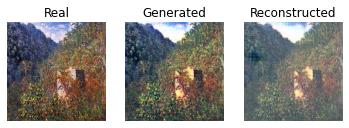

[INFO] Domain B to Domain A


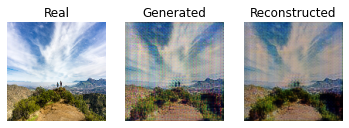

epoch: 52 step: 51 dA_loss: 0.004 dB_loss: 0.021 gAB_loss :4.466 gBA_loss: 4.275
epoch: 52 step: 52 dA_loss: 0.007 dB_loss: 0.277 gAB_loss :4.175 gBA_loss: 4.101
epoch: 52 step: 53 dA_loss: 0.031 dB_loss: 0.164 gAB_loss :3.728 gBA_loss: 3.786
epoch: 52 step: 54 dA_loss: 0.043 dB_loss: 0.102 gAB_loss :3.739 gBA_loss: 4.246
epoch: 52 step: 55 dA_loss: 0.004 dB_loss: 0.157 gAB_loss :4.199 gBA_loss: 4.194
epoch: 52 step: 56 dA_loss: 0.075 dB_loss: 0.221 gAB_loss :4.218 gBA_loss: 4.189
epoch: 52 step: 57 dA_loss: 0.036 dB_loss: 0.205 gAB_loss :3.980 gBA_loss: 3.828
epoch: 52 step: 58 dA_loss: 0.051 dB_loss: 0.175 gAB_loss :4.351 gBA_loss: 4.650
epoch: 52 step: 59 dA_loss: 0.028 dB_loss: 0.116 gAB_loss :3.587 gBA_loss: 3.989
epoch: 52 step: 60 dA_loss: 0.015 dB_loss: 0.202 gAB_loss :4.018 gBA_loss: 4.100
epoch: 52 step: 61 dA_loss: 0.012 dB_loss: 0.086 gAB_loss :4.417 gBA_loss: 4.260
epoch: 52 step: 62 dA_loss: 0.006 dB_loss: 0.097 gAB_loss :4.376 gBA_loss: 4.278
epoch: 52 step: 63 dA_loss: 

 53%|█████▎    | 53/100 [1:26:59<1:16:38, 97.85s/it]

epoch: 52 step: 73 dA_loss: 0.047 dB_loss: 0.076 gAB_loss :4.325 gBA_loss: 4.421
epoch: 53 step: 0 dA_loss: 0.005 dB_loss: 0.098 gAB_loss :4.319 gBA_loss: 4.321
[INFO] Domain A to Domain B


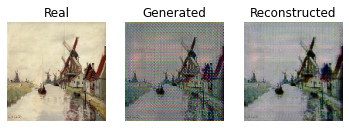

[INFO] Domain B to Domain A


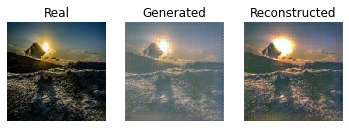

epoch: 53 step: 1 dA_loss: 0.008 dB_loss: 0.022 gAB_loss :3.968 gBA_loss: 4.183
epoch: 53 step: 2 dA_loss: 0.020 dB_loss: 0.007 gAB_loss :3.940 gBA_loss: 4.049
epoch: 53 step: 3 dA_loss: 0.009 dB_loss: 0.012 gAB_loss :4.246 gBA_loss: 4.346
epoch: 53 step: 4 dA_loss: 0.031 dB_loss: 0.005 gAB_loss :3.911 gBA_loss: 4.374
epoch: 53 step: 5 dA_loss: 0.009 dB_loss: 0.004 gAB_loss :4.489 gBA_loss: 5.039
epoch: 53 step: 6 dA_loss: 0.037 dB_loss: 0.108 gAB_loss :4.206 gBA_loss: 4.669
epoch: 53 step: 7 dA_loss: 0.022 dB_loss: 0.040 gAB_loss :4.237 gBA_loss: 4.148
epoch: 53 step: 8 dA_loss: 0.067 dB_loss: 0.013 gAB_loss :4.435 gBA_loss: 5.008
epoch: 53 step: 9 dA_loss: 0.101 dB_loss: 0.019 gAB_loss :4.781 gBA_loss: 4.898
epoch: 53 step: 10 dA_loss: 0.020 dB_loss: 0.003 gAB_loss :4.577 gBA_loss: 4.499
epoch: 53 step: 11 dA_loss: 0.084 dB_loss: 0.135 gAB_loss :4.061 gBA_loss: 4.304
epoch: 53 step: 12 dA_loss: 0.056 dB_loss: 0.103 gAB_loss :4.268 gBA_loss: 4.328
epoch: 53 step: 13 dA_loss: 0.054 dB_

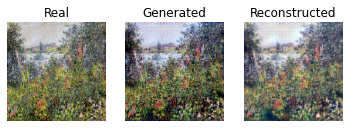

[INFO] Domain B to Domain A


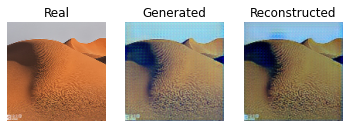

epoch: 53 step: 51 dA_loss: 0.023 dB_loss: 0.034 gAB_loss :4.344 gBA_loss: 4.271
epoch: 53 step: 52 dA_loss: 0.028 dB_loss: 0.061 gAB_loss :4.298 gBA_loss: 4.033
epoch: 53 step: 53 dA_loss: 0.053 dB_loss: 0.024 gAB_loss :3.607 gBA_loss: 3.743
epoch: 53 step: 54 dA_loss: 0.033 dB_loss: 0.044 gAB_loss :3.856 gBA_loss: 4.106
epoch: 53 step: 55 dA_loss: 0.004 dB_loss: 0.075 gAB_loss :4.453 gBA_loss: 4.085
epoch: 53 step: 56 dA_loss: 0.050 dB_loss: 0.028 gAB_loss :4.118 gBA_loss: 4.176
epoch: 53 step: 57 dA_loss: 0.028 dB_loss: 0.083 gAB_loss :3.835 gBA_loss: 3.840
epoch: 53 step: 58 dA_loss: 0.013 dB_loss: 0.029 gAB_loss :4.511 gBA_loss: 4.434
epoch: 53 step: 59 dA_loss: 0.024 dB_loss: 0.020 gAB_loss :3.838 gBA_loss: 3.854
epoch: 53 step: 60 dA_loss: 0.024 dB_loss: 0.007 gAB_loss :4.036 gBA_loss: 4.153
epoch: 53 step: 61 dA_loss: 0.014 dB_loss: 0.081 gAB_loss :4.482 gBA_loss: 4.275
epoch: 53 step: 62 dA_loss: 0.012 dB_loss: 0.027 gAB_loss :4.377 gBA_loss: 4.193
epoch: 53 step: 63 dA_loss: 

 54%|█████▍    | 54/100 [1:28:37<1:15:00, 97.83s/it]

epoch: 53 step: 73 dA_loss: 0.045 dB_loss: 0.072 gAB_loss :4.298 gBA_loss: 4.326
epoch: 54 step: 0 dA_loss: 0.007 dB_loss: 0.074 gAB_loss :4.354 gBA_loss: 4.247
[INFO] Domain A to Domain B


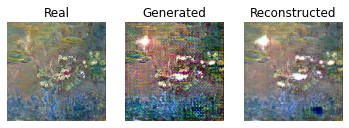

[INFO] Domain B to Domain A


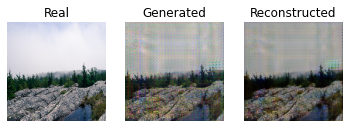

epoch: 54 step: 1 dA_loss: 0.016 dB_loss: 0.009 gAB_loss :3.851 gBA_loss: 4.161
epoch: 54 step: 2 dA_loss: 0.017 dB_loss: 0.033 gAB_loss :3.922 gBA_loss: 3.993
epoch: 54 step: 3 dA_loss: 0.014 dB_loss: 0.008 gAB_loss :4.235 gBA_loss: 4.298
epoch: 54 step: 4 dA_loss: 0.021 dB_loss: 0.053 gAB_loss :3.783 gBA_loss: 4.051
epoch: 54 step: 5 dA_loss: 0.008 dB_loss: 0.005 gAB_loss :4.397 gBA_loss: 4.935
epoch: 54 step: 6 dA_loss: 0.043 dB_loss: 0.074 gAB_loss :4.112 gBA_loss: 4.542
epoch: 54 step: 7 dA_loss: 0.035 dB_loss: 0.029 gAB_loss :4.126 gBA_loss: 4.215
epoch: 54 step: 8 dA_loss: 0.029 dB_loss: 0.016 gAB_loss :4.440 gBA_loss: 4.815
epoch: 54 step: 9 dA_loss: 0.027 dB_loss: 0.008 gAB_loss :4.746 gBA_loss: 5.094
epoch: 54 step: 10 dA_loss: 0.030 dB_loss: 0.005 gAB_loss :4.545 gBA_loss: 4.588
epoch: 54 step: 11 dA_loss: 0.009 dB_loss: 0.120 gAB_loss :4.106 gBA_loss: 4.087
epoch: 54 step: 12 dA_loss: 0.011 dB_loss: 0.104 gAB_loss :4.291 gBA_loss: 4.339
epoch: 54 step: 13 dA_loss: 0.033 dB_

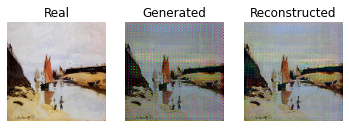

[INFO] Domain B to Domain A


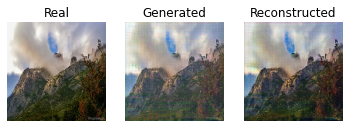

epoch: 54 step: 51 dA_loss: 0.006 dB_loss: 0.043 gAB_loss :4.335 gBA_loss: 4.168
epoch: 54 step: 52 dA_loss: 0.058 dB_loss: 0.182 gAB_loss :4.159 gBA_loss: 4.194
epoch: 54 step: 53 dA_loss: 0.077 dB_loss: 0.047 gAB_loss :3.582 gBA_loss: 3.755
epoch: 54 step: 54 dA_loss: 0.089 dB_loss: 0.049 gAB_loss :3.848 gBA_loss: 3.923
epoch: 54 step: 55 dA_loss: 0.013 dB_loss: 0.075 gAB_loss :4.382 gBA_loss: 3.878
epoch: 54 step: 56 dA_loss: 0.156 dB_loss: 0.046 gAB_loss :4.157 gBA_loss: 4.278
epoch: 54 step: 57 dA_loss: 0.031 dB_loss: 0.144 gAB_loss :3.808 gBA_loss: 3.935
epoch: 54 step: 58 dA_loss: 0.008 dB_loss: 0.012 gAB_loss :4.372 gBA_loss: 4.480
epoch: 54 step: 59 dA_loss: 0.025 dB_loss: 0.054 gAB_loss :3.999 gBA_loss: 3.815
epoch: 54 step: 60 dA_loss: 0.035 dB_loss: 0.011 gAB_loss :4.149 gBA_loss: 3.935
epoch: 54 step: 61 dA_loss: 0.037 dB_loss: 0.077 gAB_loss :4.386 gBA_loss: 4.269
epoch: 54 step: 62 dA_loss: 0.014 dB_loss: 0.035 gAB_loss :4.355 gBA_loss: 4.364
epoch: 54 step: 63 dA_loss: 

 55%|█████▌    | 55/100 [1:30:15<1:13:22, 97.83s/it]

epoch: 54 step: 73 dA_loss: 0.055 dB_loss: 0.077 gAB_loss :4.260 gBA_loss: 4.176
epoch: 55 step: 0 dA_loss: 0.028 dB_loss: 0.076 gAB_loss :4.210 gBA_loss: 4.194
[INFO] Domain A to Domain B


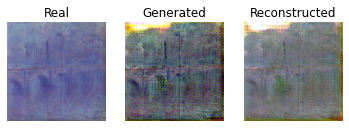

[INFO] Domain B to Domain A


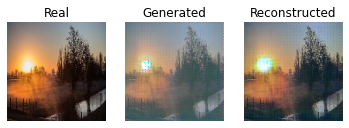

epoch: 55 step: 1 dA_loss: 0.017 dB_loss: 0.013 gAB_loss :3.750 gBA_loss: 4.068
epoch: 55 step: 2 dA_loss: 0.045 dB_loss: 0.016 gAB_loss :3.900 gBA_loss: 3.922
epoch: 55 step: 3 dA_loss: 0.020 dB_loss: 0.019 gAB_loss :4.237 gBA_loss: 4.305
epoch: 55 step: 4 dA_loss: 0.026 dB_loss: 0.020 gAB_loss :3.853 gBA_loss: 4.062
epoch: 55 step: 5 dA_loss: 0.015 dB_loss: 0.010 gAB_loss :4.408 gBA_loss: 4.894
epoch: 55 step: 6 dA_loss: 0.062 dB_loss: 0.104 gAB_loss :4.098 gBA_loss: 4.479
epoch: 55 step: 7 dA_loss: 0.037 dB_loss: 0.028 gAB_loss :4.111 gBA_loss: 4.316
epoch: 55 step: 8 dA_loss: 0.039 dB_loss: 0.013 gAB_loss :4.362 gBA_loss: 4.949
epoch: 55 step: 9 dA_loss: 0.045 dB_loss: 0.018 gAB_loss :4.735 gBA_loss: 4.894
epoch: 55 step: 10 dA_loss: 0.020 dB_loss: 0.005 gAB_loss :4.536 gBA_loss: 4.517
epoch: 55 step: 11 dA_loss: 0.028 dB_loss: 0.127 gAB_loss :4.058 gBA_loss: 4.224
epoch: 55 step: 12 dA_loss: 0.034 dB_loss: 0.093 gAB_loss :4.261 gBA_loss: 4.285
epoch: 55 step: 13 dA_loss: 0.020 dB_

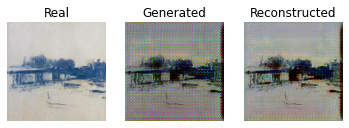

[INFO] Domain B to Domain A


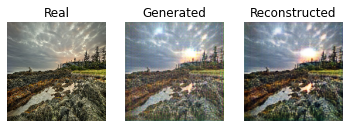

epoch: 55 step: 51 dA_loss: 0.006 dB_loss: 0.014 gAB_loss :4.312 gBA_loss: 4.224
epoch: 55 step: 52 dA_loss: 0.006 dB_loss: 0.111 gAB_loss :4.226 gBA_loss: 3.978
epoch: 55 step: 53 dA_loss: 0.044 dB_loss: 0.032 gAB_loss :3.544 gBA_loss: 3.631
epoch: 55 step: 54 dA_loss: 0.076 dB_loss: 0.019 gAB_loss :3.762 gBA_loss: 4.033
epoch: 55 step: 55 dA_loss: 0.015 dB_loss: 0.081 gAB_loss :4.428 gBA_loss: 4.011
epoch: 55 step: 56 dA_loss: 0.032 dB_loss: 0.036 gAB_loss :4.190 gBA_loss: 4.201
epoch: 55 step: 57 dA_loss: 0.026 dB_loss: 0.105 gAB_loss :3.730 gBA_loss: 3.876
epoch: 55 step: 58 dA_loss: 0.015 dB_loss: 0.031 gAB_loss :4.461 gBA_loss: 4.404
epoch: 55 step: 59 dA_loss: 0.019 dB_loss: 0.013 gAB_loss :3.866 gBA_loss: 3.812
epoch: 55 step: 60 dA_loss: 0.040 dB_loss: 0.010 gAB_loss :4.060 gBA_loss: 4.056
epoch: 55 step: 61 dA_loss: 0.011 dB_loss: 0.062 gAB_loss :4.413 gBA_loss: 4.275
epoch: 55 step: 62 dA_loss: 0.016 dB_loss: 0.018 gAB_loss :4.326 gBA_loss: 4.205
epoch: 55 step: 63 dA_loss: 

 56%|█████▌    | 56/100 [1:31:53<1:11:44, 97.83s/it]

epoch: 55 step: 73 dA_loss: 0.053 dB_loss: 0.069 gAB_loss :4.242 gBA_loss: 4.231
epoch: 56 step: 0 dA_loss: 0.022 dB_loss: 0.050 gAB_loss :4.169 gBA_loss: 4.112
[INFO] Domain A to Domain B


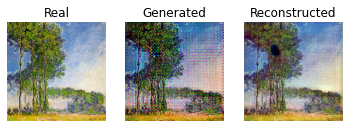

[INFO] Domain B to Domain A


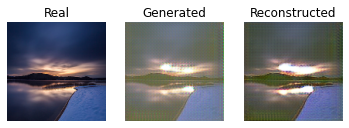

epoch: 56 step: 1 dA_loss: 0.047 dB_loss: 0.024 gAB_loss :3.808 gBA_loss: 3.848
epoch: 56 step: 2 dA_loss: 0.044 dB_loss: 0.007 gAB_loss :3.832 gBA_loss: 3.843
epoch: 56 step: 3 dA_loss: 0.027 dB_loss: 0.005 gAB_loss :4.147 gBA_loss: 4.346
epoch: 56 step: 4 dA_loss: 0.028 dB_loss: 0.010 gAB_loss :3.889 gBA_loss: 4.137
epoch: 56 step: 5 dA_loss: 0.031 dB_loss: 0.004 gAB_loss :4.430 gBA_loss: 4.928
epoch: 56 step: 6 dA_loss: 0.068 dB_loss: 0.071 gAB_loss :4.127 gBA_loss: 4.359
epoch: 56 step: 7 dA_loss: 0.160 dB_loss: 0.021 gAB_loss :4.142 gBA_loss: 4.473
epoch: 56 step: 8 dA_loss: 0.031 dB_loss: 0.009 gAB_loss :4.360 gBA_loss: 4.809
epoch: 56 step: 9 dA_loss: 0.124 dB_loss: 0.009 gAB_loss :4.728 gBA_loss: 4.786
epoch: 56 step: 10 dA_loss: 0.122 dB_loss: 0.025 gAB_loss :4.529 gBA_loss: 4.286
epoch: 56 step: 11 dA_loss: 0.027 dB_loss: 0.134 gAB_loss :4.023 gBA_loss: 3.868
epoch: 56 step: 12 dA_loss: 0.071 dB_loss: 0.088 gAB_loss :4.211 gBA_loss: 4.116
epoch: 56 step: 13 dA_loss: 0.033 dB_

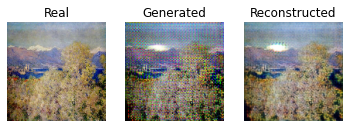

[INFO] Domain B to Domain A


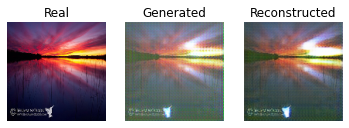

epoch: 56 step: 51 dA_loss: 0.018 dB_loss: 0.043 gAB_loss :4.389 gBA_loss: 4.165
epoch: 56 step: 52 dA_loss: 0.006 dB_loss: 0.056 gAB_loss :4.317 gBA_loss: 3.917
epoch: 56 step: 53 dA_loss: 0.037 dB_loss: 0.079 gAB_loss :3.530 gBA_loss: 3.639
epoch: 56 step: 54 dA_loss: 0.078 dB_loss: 0.032 gAB_loss :3.869 gBA_loss: 4.158
epoch: 56 step: 55 dA_loss: 0.007 dB_loss: 0.071 gAB_loss :4.354 gBA_loss: 4.118
epoch: 56 step: 56 dA_loss: 0.044 dB_loss: 0.055 gAB_loss :4.251 gBA_loss: 4.153
epoch: 56 step: 57 dA_loss: 0.038 dB_loss: 0.138 gAB_loss :3.720 gBA_loss: 3.747
epoch: 56 step: 58 dA_loss: 0.014 dB_loss: 0.023 gAB_loss :4.375 gBA_loss: 4.352
epoch: 56 step: 59 dA_loss: 0.022 dB_loss: 0.032 gAB_loss :3.836 gBA_loss: 3.787
epoch: 56 step: 60 dA_loss: 0.022 dB_loss: 0.009 gAB_loss :4.061 gBA_loss: 4.059
epoch: 56 step: 61 dA_loss: 0.022 dB_loss: 0.067 gAB_loss :4.370 gBA_loss: 4.245
epoch: 56 step: 62 dA_loss: 0.009 dB_loss: 0.019 gAB_loss :4.307 gBA_loss: 4.208
epoch: 56 step: 63 dA_loss: 

 57%|█████▋    | 57/100 [1:33:31<1:10:07, 97.84s/it]

epoch: 56 step: 73 dA_loss: 0.040 dB_loss: 0.062 gAB_loss :4.265 gBA_loss: 4.196
epoch: 57 step: 0 dA_loss: 0.053 dB_loss: 0.048 gAB_loss :4.335 gBA_loss: 4.398
[INFO] Domain A to Domain B


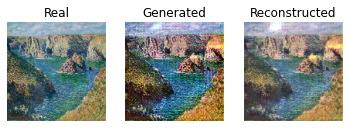

[INFO] Domain B to Domain A


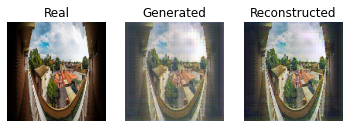

epoch: 57 step: 1 dA_loss: 0.007 dB_loss: 0.010 gAB_loss :3.846 gBA_loss: 4.200
epoch: 57 step: 2 dA_loss: 0.109 dB_loss: 0.009 gAB_loss :3.918 gBA_loss: 3.893
epoch: 57 step: 3 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :4.210 gBA_loss: 4.176
epoch: 57 step: 4 dA_loss: 0.021 dB_loss: 0.014 gAB_loss :3.886 gBA_loss: 3.958
epoch: 57 step: 5 dA_loss: 0.009 dB_loss: 0.004 gAB_loss :4.409 gBA_loss: 4.792
epoch: 57 step: 6 dA_loss: 0.031 dB_loss: 0.065 gAB_loss :4.141 gBA_loss: 4.510
epoch: 57 step: 7 dA_loss: 0.022 dB_loss: 0.021 gAB_loss :4.135 gBA_loss: 4.201
epoch: 57 step: 8 dA_loss: 0.023 dB_loss: 0.006 gAB_loss :4.435 gBA_loss: 4.797
epoch: 57 step: 9 dA_loss: 0.033 dB_loss: 0.006 gAB_loss :4.737 gBA_loss: 5.036
epoch: 57 step: 10 dA_loss: 0.064 dB_loss: 0.005 gAB_loss :4.481 gBA_loss: 4.466
epoch: 57 step: 11 dA_loss: 0.006 dB_loss: 0.102 gAB_loss :4.038 gBA_loss: 3.975
epoch: 57 step: 12 dA_loss: 0.014 dB_loss: 0.081 gAB_loss :4.405 gBA_loss: 4.191
epoch: 57 step: 13 dA_loss: 0.022 dB_

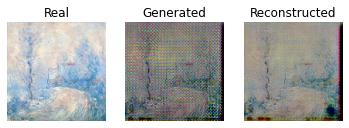

[INFO] Domain B to Domain A


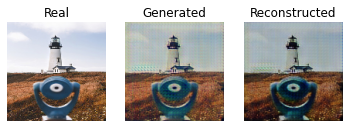

epoch: 57 step: 51 dA_loss: 0.035 dB_loss: 0.023 gAB_loss :4.276 gBA_loss: 4.254
epoch: 57 step: 52 dA_loss: 0.015 dB_loss: 0.115 gAB_loss :4.197 gBA_loss: 3.924
epoch: 57 step: 53 dA_loss: 0.031 dB_loss: 0.023 gAB_loss :3.594 gBA_loss: 3.619
epoch: 57 step: 54 dA_loss: 0.021 dB_loss: 0.024 gAB_loss :3.675 gBA_loss: 3.931
epoch: 57 step: 55 dA_loss: 0.047 dB_loss: 0.116 gAB_loss :4.421 gBA_loss: 4.089
epoch: 57 step: 56 dA_loss: 0.023 dB_loss: 0.048 gAB_loss :4.163 gBA_loss: 4.330
epoch: 57 step: 57 dA_loss: 0.034 dB_loss: 0.094 gAB_loss :3.848 gBA_loss: 3.898
epoch: 57 step: 58 dA_loss: 0.004 dB_loss: 0.023 gAB_loss :4.491 gBA_loss: 4.358
epoch: 57 step: 59 dA_loss: 0.016 dB_loss: 0.029 gAB_loss :3.739 gBA_loss: 3.736
epoch: 57 step: 60 dA_loss: 0.019 dB_loss: 0.037 gAB_loss :4.072 gBA_loss: 3.983
epoch: 57 step: 61 dA_loss: 0.015 dB_loss: 0.069 gAB_loss :4.473 gBA_loss: 4.192
epoch: 57 step: 62 dA_loss: 0.009 dB_loss: 0.040 gAB_loss :4.335 gBA_loss: 4.142
epoch: 57 step: 63 dA_loss: 

 58%|█████▊    | 58/100 [1:35:08<1:08:28, 97.82s/it]

epoch: 57 step: 73 dA_loss: 0.026 dB_loss: 0.079 gAB_loss :4.277 gBA_loss: 4.162
epoch: 58 step: 0 dA_loss: 0.013 dB_loss: 0.041 gAB_loss :4.234 gBA_loss: 4.176
[INFO] Domain A to Domain B


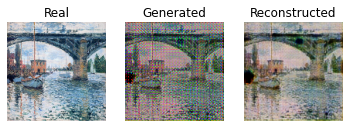

[INFO] Domain B to Domain A


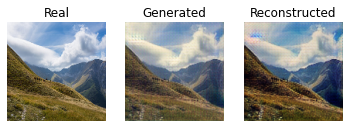

epoch: 58 step: 1 dA_loss: 0.021 dB_loss: 0.008 gAB_loss :3.778 gBA_loss: 4.044
epoch: 58 step: 2 dA_loss: 0.051 dB_loss: 0.007 gAB_loss :3.805 gBA_loss: 3.857
epoch: 58 step: 3 dA_loss: 0.015 dB_loss: 0.010 gAB_loss :4.151 gBA_loss: 4.209
epoch: 58 step: 4 dA_loss: 0.012 dB_loss: 0.015 gAB_loss :3.819 gBA_loss: 3.985
epoch: 58 step: 5 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :4.415 gBA_loss: 4.776
epoch: 58 step: 6 dA_loss: 0.067 dB_loss: 0.062 gAB_loss :4.108 gBA_loss: 4.346
epoch: 58 step: 7 dA_loss: 0.025 dB_loss: 0.023 gAB_loss :4.098 gBA_loss: 4.106
epoch: 58 step: 8 dA_loss: 0.059 dB_loss: 0.007 gAB_loss :4.507 gBA_loss: 4.961
epoch: 58 step: 9 dA_loss: 0.051 dB_loss: 0.008 gAB_loss :4.757 gBA_loss: 4.947
epoch: 58 step: 10 dA_loss: 0.036 dB_loss: 0.005 gAB_loss :4.507 gBA_loss: 4.425
epoch: 58 step: 11 dA_loss: 0.013 dB_loss: 0.098 gAB_loss :4.064 gBA_loss: 3.960
epoch: 58 step: 12 dA_loss: 0.046 dB_loss: 0.082 gAB_loss :4.400 gBA_loss: 4.156
epoch: 58 step: 13 dA_loss: 0.019 dB_

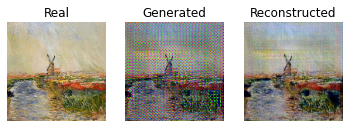

[INFO] Domain B to Domain A


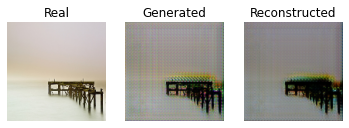

epoch: 58 step: 51 dA_loss: 0.008 dB_loss: 0.028 gAB_loss :4.296 gBA_loss: 4.166
epoch: 58 step: 52 dA_loss: 0.005 dB_loss: 0.072 gAB_loss :4.220 gBA_loss: 3.937
epoch: 58 step: 53 dA_loss: 0.081 dB_loss: 0.025 gAB_loss :3.679 gBA_loss: 3.552
epoch: 58 step: 54 dA_loss: 0.014 dB_loss: 0.023 gAB_loss :3.758 gBA_loss: 3.834
epoch: 58 step: 55 dA_loss: 0.044 dB_loss: 0.072 gAB_loss :4.211 gBA_loss: 4.007
epoch: 58 step: 56 dA_loss: 0.031 dB_loss: 0.112 gAB_loss :4.300 gBA_loss: 4.262
epoch: 58 step: 57 dA_loss: 0.027 dB_loss: 0.186 gAB_loss :3.886 gBA_loss: 3.871
epoch: 58 step: 58 dA_loss: 0.011 dB_loss: 0.037 gAB_loss :4.122 gBA_loss: 4.317
epoch: 58 step: 59 dA_loss: 0.024 dB_loss: 0.043 gAB_loss :3.444 gBA_loss: 3.672
epoch: 58 step: 60 dA_loss: 0.020 dB_loss: 0.187 gAB_loss :4.100 gBA_loss: 3.922
epoch: 58 step: 61 dA_loss: 0.024 dB_loss: 0.154 gAB_loss :4.317 gBA_loss: 4.139
epoch: 58 step: 62 dA_loss: 0.012 dB_loss: 0.153 gAB_loss :4.143 gBA_loss: 4.123
epoch: 58 step: 63 dA_loss: 

 59%|█████▉    | 59/100 [1:36:47<1:06:55, 97.94s/it]

epoch: 58 step: 73 dA_loss: 0.041 dB_loss: 0.075 gAB_loss :4.267 gBA_loss: 4.150
epoch: 59 step: 0 dA_loss: 0.010 dB_loss: 0.054 gAB_loss :4.368 gBA_loss: 4.043
[INFO] Domain A to Domain B


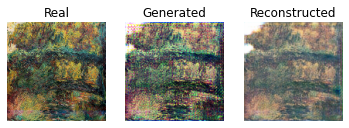

[INFO] Domain B to Domain A


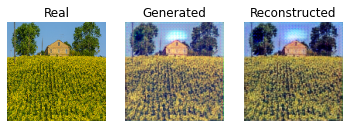

epoch: 59 step: 1 dA_loss: 0.011 dB_loss: 0.024 gAB_loss :3.765 gBA_loss: 3.890
epoch: 59 step: 2 dA_loss: 0.081 dB_loss: 0.007 gAB_loss :3.759 gBA_loss: 3.797
epoch: 59 step: 3 dA_loss: 0.007 dB_loss: 0.021 gAB_loss :4.128 gBA_loss: 4.171
epoch: 59 step: 4 dA_loss: 0.012 dB_loss: 0.033 gAB_loss :3.794 gBA_loss: 3.923
epoch: 59 step: 5 dA_loss: 0.019 dB_loss: 0.006 gAB_loss :4.384 gBA_loss: 4.760
epoch: 59 step: 6 dA_loss: 0.110 dB_loss: 0.060 gAB_loss :4.128 gBA_loss: 4.401
epoch: 59 step: 7 dA_loss: 0.015 dB_loss: 0.025 gAB_loss :4.169 gBA_loss: 4.165
epoch: 59 step: 8 dA_loss: 0.025 dB_loss: 0.006 gAB_loss :4.419 gBA_loss: 4.819
epoch: 59 step: 9 dA_loss: 0.025 dB_loss: 0.010 gAB_loss :4.644 gBA_loss: 4.991
epoch: 59 step: 10 dA_loss: 0.019 dB_loss: 0.008 gAB_loss :4.458 gBA_loss: 4.519
epoch: 59 step: 11 dA_loss: 0.013 dB_loss: 0.104 gAB_loss :3.995 gBA_loss: 4.052
epoch: 59 step: 12 dA_loss: 0.027 dB_loss: 0.085 gAB_loss :4.244 gBA_loss: 4.167
epoch: 59 step: 13 dA_loss: 0.009 dB_

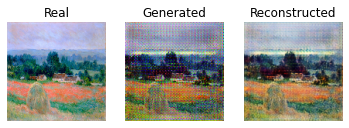

[INFO] Domain B to Domain A


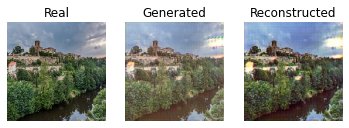

epoch: 59 step: 51 dA_loss: 0.028 dB_loss: 0.015 gAB_loss :4.585 gBA_loss: 4.356
epoch: 59 step: 52 dA_loss: 0.004 dB_loss: 0.029 gAB_loss :4.543 gBA_loss: 4.007
epoch: 59 step: 53 dA_loss: 0.053 dB_loss: 0.019 gAB_loss :3.909 gBA_loss: 3.902
epoch: 59 step: 54 dA_loss: 0.038 dB_loss: 0.014 gAB_loss :3.846 gBA_loss: 4.063
epoch: 59 step: 55 dA_loss: 0.060 dB_loss: 0.041 gAB_loss :4.322 gBA_loss: 4.083
epoch: 59 step: 56 dA_loss: 0.034 dB_loss: 0.037 gAB_loss :4.284 gBA_loss: 4.190
epoch: 59 step: 57 dA_loss: 0.019 dB_loss: 0.026 gAB_loss :3.980 gBA_loss: 3.834
epoch: 59 step: 58 dA_loss: 0.014 dB_loss: 0.011 gAB_loss :4.478 gBA_loss: 4.359
epoch: 59 step: 59 dA_loss: 0.019 dB_loss: 0.029 gAB_loss :3.731 gBA_loss: 3.756
epoch: 59 step: 60 dA_loss: 0.025 dB_loss: 0.009 gAB_loss :3.951 gBA_loss: 3.758
epoch: 59 step: 61 dA_loss: 0.084 dB_loss: 0.101 gAB_loss :4.470 gBA_loss: 4.266
epoch: 59 step: 62 dA_loss: 0.011 dB_loss: 0.013 gAB_loss :4.328 gBA_loss: 4.184
epoch: 59 step: 63 dA_loss: 

 60%|██████    | 60/100 [1:38:24<1:05:15, 97.90s/it]

epoch: 59 step: 73 dA_loss: 0.030 dB_loss: 0.042 gAB_loss :4.260 gBA_loss: 4.204
epoch: 60 step: 0 dA_loss: 0.007 dB_loss: 0.028 gAB_loss :4.308 gBA_loss: 4.088
[INFO] Domain A to Domain B


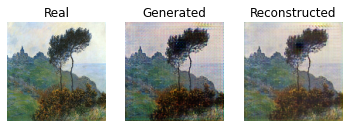

[INFO] Domain B to Domain A


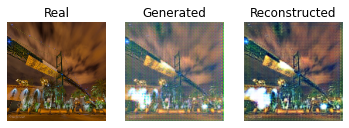

epoch: 60 step: 1 dA_loss: 0.090 dB_loss: 0.007 gAB_loss :3.771 gBA_loss: 3.790
epoch: 60 step: 2 dA_loss: 0.028 dB_loss: 0.016 gAB_loss :3.772 gBA_loss: 3.722
epoch: 60 step: 3 dA_loss: 0.016 dB_loss: 0.021 gAB_loss :4.128 gBA_loss: 4.125
epoch: 60 step: 4 dA_loss: 0.015 dB_loss: 0.008 gAB_loss :3.824 gBA_loss: 3.977
epoch: 60 step: 5 dA_loss: 0.021 dB_loss: 0.003 gAB_loss :4.329 gBA_loss: 4.823
epoch: 60 step: 6 dA_loss: 0.034 dB_loss: 0.048 gAB_loss :4.155 gBA_loss: 4.452
epoch: 60 step: 7 dA_loss: 0.031 dB_loss: 0.019 gAB_loss :4.153 gBA_loss: 4.131
epoch: 60 step: 8 dA_loss: 0.095 dB_loss: 0.007 gAB_loss :4.358 gBA_loss: 4.874
epoch: 60 step: 9 dA_loss: 0.039 dB_loss: 0.010 gAB_loss :4.719 gBA_loss: 4.868
epoch: 60 step: 10 dA_loss: 0.037 dB_loss: 0.005 gAB_loss :4.416 gBA_loss: 4.363
epoch: 60 step: 11 dA_loss: 0.039 dB_loss: 0.082 gAB_loss :3.973 gBA_loss: 3.816
epoch: 60 step: 12 dA_loss: 0.042 dB_loss: 0.067 gAB_loss :4.346 gBA_loss: 4.132
epoch: 60 step: 13 dA_loss: 0.064 dB_

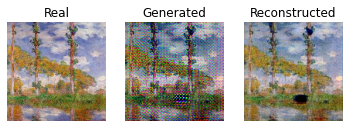

[INFO] Domain B to Domain A


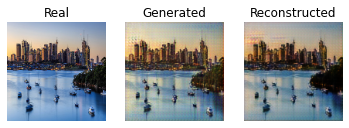

epoch: 60 step: 51 dA_loss: 0.025 dB_loss: 0.012 gAB_loss :4.260 gBA_loss: 4.120
epoch: 60 step: 52 dA_loss: 0.004 dB_loss: 0.034 gAB_loss :4.181 gBA_loss: 3.882
epoch: 60 step: 53 dA_loss: 0.042 dB_loss: 0.015 gAB_loss :3.631 gBA_loss: 3.708
epoch: 60 step: 54 dA_loss: 0.023 dB_loss: 0.015 gAB_loss :3.781 gBA_loss: 4.076
epoch: 60 step: 55 dA_loss: 0.012 dB_loss: 0.056 gAB_loss :4.329 gBA_loss: 3.979
epoch: 60 step: 56 dA_loss: 0.050 dB_loss: 0.018 gAB_loss :4.213 gBA_loss: 4.238
epoch: 60 step: 57 dA_loss: 0.031 dB_loss: 0.061 gAB_loss :4.029 gBA_loss: 3.801
epoch: 60 step: 58 dA_loss: 0.023 dB_loss: 0.008 gAB_loss :4.433 gBA_loss: 4.240
epoch: 60 step: 59 dA_loss: 0.021 dB_loss: 0.027 gAB_loss :3.683 gBA_loss: 3.671
epoch: 60 step: 60 dA_loss: 0.033 dB_loss: 0.007 gAB_loss :3.932 gBA_loss: 3.871
epoch: 60 step: 61 dA_loss: 0.042 dB_loss: 0.124 gAB_loss :4.480 gBA_loss: 4.267
epoch: 60 step: 62 dA_loss: 0.007 dB_loss: 0.044 gAB_loss :4.253 gBA_loss: 4.138
epoch: 60 step: 63 dA_loss: 

 61%|██████    | 61/100 [1:40:02<1:03:37, 97.88s/it]

epoch: 60 step: 73 dA_loss: 0.015 dB_loss: 0.053 gAB_loss :4.240 gBA_loss: 4.201
epoch: 61 step: 0 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :4.254 gBA_loss: 4.057
[INFO] Domain A to Domain B


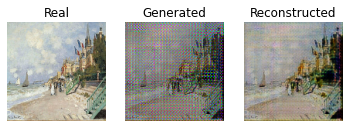

[INFO] Domain B to Domain A


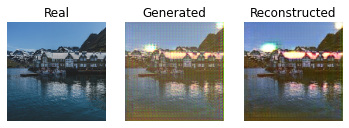

epoch: 61 step: 1 dA_loss: 0.104 dB_loss: 0.018 gAB_loss :3.789 gBA_loss: 3.760
epoch: 61 step: 2 dA_loss: 0.060 dB_loss: 0.019 gAB_loss :3.881 gBA_loss: 3.624
epoch: 61 step: 3 dA_loss: 0.021 dB_loss: 0.006 gAB_loss :4.112 gBA_loss: 4.063
epoch: 61 step: 4 dA_loss: 0.028 dB_loss: 0.013 gAB_loss :3.765 gBA_loss: 3.919
epoch: 61 step: 5 dA_loss: 0.023 dB_loss: 0.004 gAB_loss :4.306 gBA_loss: 4.750
epoch: 61 step: 6 dA_loss: 0.029 dB_loss: 0.051 gAB_loss :4.070 gBA_loss: 4.443
epoch: 61 step: 7 dA_loss: 0.048 dB_loss: 0.022 gAB_loss :4.109 gBA_loss: 4.236
epoch: 61 step: 8 dA_loss: 0.033 dB_loss: 0.015 gAB_loss :4.405 gBA_loss: 4.784
epoch: 61 step: 9 dA_loss: 0.026 dB_loss: 0.015 gAB_loss :4.786 gBA_loss: 4.935
epoch: 61 step: 10 dA_loss: 0.032 dB_loss: 0.005 gAB_loss :4.501 gBA_loss: 4.434
epoch: 61 step: 11 dA_loss: 0.018 dB_loss: 0.110 gAB_loss :3.931 gBA_loss: 3.889
epoch: 61 step: 12 dA_loss: 0.013 dB_loss: 0.080 gAB_loss :4.257 gBA_loss: 4.134
epoch: 61 step: 13 dA_loss: 0.056 dB_

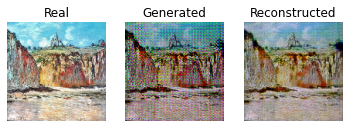

[INFO] Domain B to Domain A


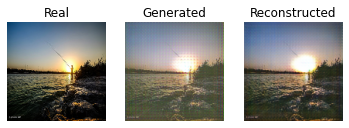

epoch: 61 step: 51 dA_loss: 0.145 dB_loss: 0.017 gAB_loss :4.261 gBA_loss: 4.096
epoch: 61 step: 52 dA_loss: 0.092 dB_loss: 0.080 gAB_loss :4.126 gBA_loss: 3.703
epoch: 61 step: 53 dA_loss: 0.125 dB_loss: 0.034 gAB_loss :3.659 gBA_loss: 3.222
epoch: 61 step: 54 dA_loss: 0.115 dB_loss: 0.021 gAB_loss :3.822 gBA_loss: 3.912
epoch: 61 step: 55 dA_loss: 0.045 dB_loss: 0.060 gAB_loss :4.262 gBA_loss: 3.948
epoch: 61 step: 56 dA_loss: 0.104 dB_loss: 0.025 gAB_loss :4.115 gBA_loss: 4.107
epoch: 61 step: 57 dA_loss: 0.035 dB_loss: 0.054 gAB_loss :3.900 gBA_loss: 3.652
epoch: 61 step: 58 dA_loss: 0.036 dB_loss: 0.014 gAB_loss :4.458 gBA_loss: 4.328
epoch: 61 step: 59 dA_loss: 0.038 dB_loss: 0.017 gAB_loss :3.830 gBA_loss: 3.755
epoch: 61 step: 60 dA_loss: 0.038 dB_loss: 0.010 gAB_loss :4.032 gBA_loss: 3.895
epoch: 61 step: 61 dA_loss: 0.027 dB_loss: 0.053 gAB_loss :4.261 gBA_loss: 4.143
epoch: 61 step: 62 dA_loss: 0.059 dB_loss: 0.015 gAB_loss :4.215 gBA_loss: 4.263
epoch: 61 step: 63 dA_loss: 

 62%|██████▏   | 62/100 [1:41:40<1:01:59, 97.89s/it]

epoch: 61 step: 73 dA_loss: 0.018 dB_loss: 0.055 gAB_loss :4.255 gBA_loss: 4.283
epoch: 62 step: 0 dA_loss: 0.010 dB_loss: 0.030 gAB_loss :4.280 gBA_loss: 4.089
[INFO] Domain A to Domain B


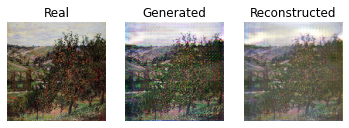

[INFO] Domain B to Domain A


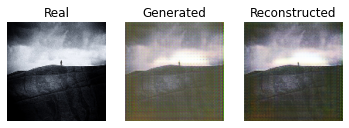

epoch: 62 step: 1 dA_loss: 0.119 dB_loss: 0.018 gAB_loss :3.727 gBA_loss: 3.746
epoch: 62 step: 2 dA_loss: 0.064 dB_loss: 0.009 gAB_loss :3.787 gBA_loss: 3.526
epoch: 62 step: 3 dA_loss: 0.043 dB_loss: 0.015 gAB_loss :4.147 gBA_loss: 4.068
epoch: 62 step: 4 dA_loss: 0.036 dB_loss: 0.035 gAB_loss :3.743 gBA_loss: 3.888
epoch: 62 step: 5 dA_loss: 0.021 dB_loss: 0.005 gAB_loss :4.235 gBA_loss: 4.771
epoch: 62 step: 6 dA_loss: 0.070 dB_loss: 0.045 gAB_loss :4.091 gBA_loss: 4.328
epoch: 62 step: 7 dA_loss: 0.029 dB_loss: 0.016 gAB_loss :4.151 gBA_loss: 4.241
epoch: 62 step: 8 dA_loss: 0.020 dB_loss: 0.005 gAB_loss :4.361 gBA_loss: 4.700
epoch: 62 step: 9 dA_loss: 0.044 dB_loss: 0.005 gAB_loss :4.659 gBA_loss: 4.928
epoch: 62 step: 10 dA_loss: 0.024 dB_loss: 0.005 gAB_loss :4.400 gBA_loss: 4.534
epoch: 62 step: 11 dA_loss: 0.054 dB_loss: 0.080 gAB_loss :4.086 gBA_loss: 3.947
epoch: 62 step: 12 dA_loss: 0.015 dB_loss: 0.084 gAB_loss :4.278 gBA_loss: 4.130
epoch: 62 step: 13 dA_loss: 0.047 dB_

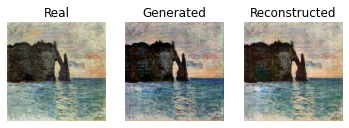

[INFO] Domain B to Domain A


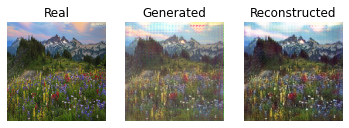

epoch: 62 step: 51 dA_loss: 0.008 dB_loss: 0.026 gAB_loss :4.336 gBA_loss: 4.168
epoch: 62 step: 52 dA_loss: 0.009 dB_loss: 0.118 gAB_loss :4.091 gBA_loss: 3.931
epoch: 62 step: 53 dA_loss: 0.047 dB_loss: 0.024 gAB_loss :3.590 gBA_loss: 3.552
epoch: 62 step: 54 dA_loss: 0.055 dB_loss: 0.037 gAB_loss :3.820 gBA_loss: 4.122
epoch: 62 step: 55 dA_loss: 0.025 dB_loss: 0.064 gAB_loss :4.314 gBA_loss: 4.017
epoch: 62 step: 56 dA_loss: 0.057 dB_loss: 0.028 gAB_loss :4.031 gBA_loss: 4.098
epoch: 62 step: 57 dA_loss: 0.023 dB_loss: 0.052 gAB_loss :3.820 gBA_loss: 3.695
epoch: 62 step: 58 dA_loss: 0.045 dB_loss: 0.026 gAB_loss :4.447 gBA_loss: 4.326
epoch: 62 step: 59 dA_loss: 0.013 dB_loss: 0.028 gAB_loss :3.723 gBA_loss: 3.714
epoch: 62 step: 60 dA_loss: 0.048 dB_loss: 0.013 gAB_loss :3.915 gBA_loss: 3.741
epoch: 62 step: 61 dA_loss: 0.028 dB_loss: 0.070 gAB_loss :4.336 gBA_loss: 3.974
epoch: 62 step: 62 dA_loss: 0.015 dB_loss: 0.013 gAB_loss :4.212 gBA_loss: 4.102
epoch: 62 step: 63 dA_loss: 

 63%|██████▎   | 63/100 [1:43:18<1:00:22, 97.91s/it]

epoch: 62 step: 73 dA_loss: 0.010 dB_loss: 0.043 gAB_loss :4.210 gBA_loss: 4.219
epoch: 63 step: 0 dA_loss: 0.018 dB_loss: 0.028 gAB_loss :4.267 gBA_loss: 4.269
[INFO] Domain A to Domain B


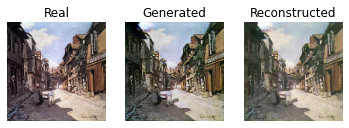

[INFO] Domain B to Domain A


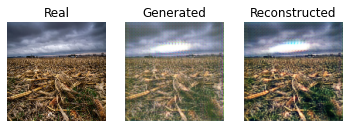

epoch: 63 step: 1 dA_loss: 0.033 dB_loss: 0.013 gAB_loss :3.854 gBA_loss: 4.011
epoch: 63 step: 2 dA_loss: 0.065 dB_loss: 0.007 gAB_loss :3.797 gBA_loss: 3.750
epoch: 63 step: 3 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :4.120 gBA_loss: 4.105
epoch: 63 step: 4 dA_loss: 0.048 dB_loss: 0.016 gAB_loss :3.793 gBA_loss: 3.835
epoch: 63 step: 5 dA_loss: 0.066 dB_loss: 0.004 gAB_loss :4.271 gBA_loss: 4.814
epoch: 63 step: 6 dA_loss: 0.070 dB_loss: 0.034 gAB_loss :4.102 gBA_loss: 4.438
epoch: 63 step: 7 dA_loss: 0.013 dB_loss: 0.010 gAB_loss :4.097 gBA_loss: 4.181
epoch: 63 step: 8 dA_loss: 0.025 dB_loss: 0.005 gAB_loss :4.362 gBA_loss: 4.628
epoch: 63 step: 9 dA_loss: 0.017 dB_loss: 0.006 gAB_loss :4.629 gBA_loss: 4.834
epoch: 63 step: 10 dA_loss: 0.010 dB_loss: 0.005 gAB_loss :4.360 gBA_loss: 4.379
epoch: 63 step: 11 dA_loss: 0.019 dB_loss: 0.073 gAB_loss :3.898 gBA_loss: 3.994
epoch: 63 step: 12 dA_loss: 0.014 dB_loss: 0.071 gAB_loss :4.299 gBA_loss: 4.157
epoch: 63 step: 13 dA_loss: 0.036 dB_

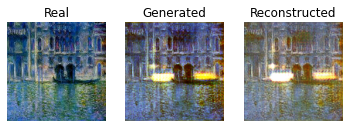

[INFO] Domain B to Domain A


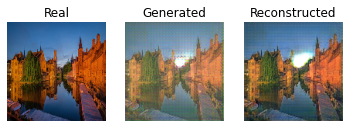

epoch: 63 step: 51 dA_loss: 0.039 dB_loss: 0.037 gAB_loss :4.338 gBA_loss: 4.058
epoch: 63 step: 52 dA_loss: 0.007 dB_loss: 0.106 gAB_loss :3.921 gBA_loss: 3.904
epoch: 63 step: 53 dA_loss: 0.047 dB_loss: 0.129 gAB_loss :3.764 gBA_loss: 3.778
epoch: 63 step: 54 dA_loss: 0.036 dB_loss: 0.072 gAB_loss :3.691 gBA_loss: 4.069
epoch: 63 step: 55 dA_loss: 0.042 dB_loss: 0.069 gAB_loss :4.106 gBA_loss: 4.019
epoch: 63 step: 56 dA_loss: 0.043 dB_loss: 0.069 gAB_loss :4.211 gBA_loss: 4.170
epoch: 63 step: 57 dA_loss: 0.017 dB_loss: 0.108 gAB_loss :3.774 gBA_loss: 3.719
epoch: 63 step: 58 dA_loss: 0.012 dB_loss: 0.016 gAB_loss :4.217 gBA_loss: 4.256
epoch: 63 step: 59 dA_loss: 0.017 dB_loss: 0.046 gAB_loss :3.801 gBA_loss: 3.708
epoch: 63 step: 60 dA_loss: 0.023 dB_loss: 0.025 gAB_loss :4.069 gBA_loss: 3.993
epoch: 63 step: 61 dA_loss: 0.006 dB_loss: 0.064 gAB_loss :4.279 gBA_loss: 4.069
epoch: 63 step: 62 dA_loss: 0.008 dB_loss: 0.045 gAB_loss :4.126 gBA_loss: 4.013
epoch: 63 step: 63 dA_loss: 

 64%|██████▍   | 64/100 [1:44:56<58:45, 97.93s/it]  

epoch: 63 step: 73 dA_loss: 0.013 dB_loss: 0.048 gAB_loss :4.160 gBA_loss: 4.374
epoch: 64 step: 0 dA_loss: 0.011 dB_loss: 0.068 gAB_loss :4.332 gBA_loss: 4.194
[INFO] Domain A to Domain B


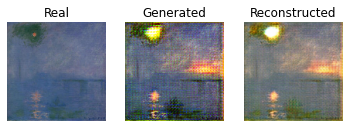

[INFO] Domain B to Domain A


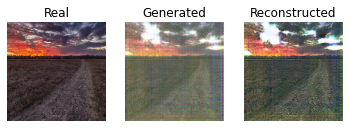

epoch: 64 step: 1 dA_loss: 0.016 dB_loss: 0.043 gAB_loss :3.730 gBA_loss: 3.812
epoch: 64 step: 2 dA_loss: 0.047 dB_loss: 0.008 gAB_loss :3.771 gBA_loss: 3.707
epoch: 64 step: 3 dA_loss: 0.006 dB_loss: 0.018 gAB_loss :4.088 gBA_loss: 4.018
epoch: 64 step: 4 dA_loss: 0.034 dB_loss: 0.019 gAB_loss :3.779 gBA_loss: 4.025
epoch: 64 step: 5 dA_loss: 0.022 dB_loss: 0.006 gAB_loss :4.263 gBA_loss: 4.734
epoch: 64 step: 6 dA_loss: 0.067 dB_loss: 0.044 gAB_loss :4.035 gBA_loss: 4.252
epoch: 64 step: 7 dA_loss: 0.018 dB_loss: 0.022 gAB_loss :4.039 gBA_loss: 4.066
epoch: 64 step: 8 dA_loss: 0.036 dB_loss: 0.008 gAB_loss :4.319 gBA_loss: 4.705
epoch: 64 step: 9 dA_loss: 0.010 dB_loss: 0.018 gAB_loss :4.635 gBA_loss: 4.805
epoch: 64 step: 10 dA_loss: 0.010 dB_loss: 0.009 gAB_loss :4.394 gBA_loss: 4.359
epoch: 64 step: 11 dA_loss: 0.018 dB_loss: 0.093 gAB_loss :3.884 gBA_loss: 3.829
epoch: 64 step: 12 dA_loss: 0.009 dB_loss: 0.099 gAB_loss :4.072 gBA_loss: 4.112
epoch: 64 step: 13 dA_loss: 0.056 dB_

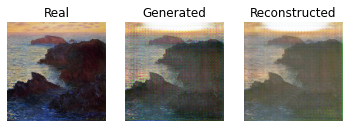

[INFO] Domain B to Domain A


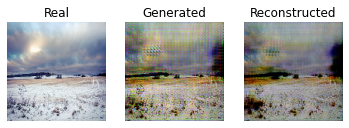

epoch: 64 step: 51 dA_loss: 0.038 dB_loss: 0.023 gAB_loss :4.234 gBA_loss: 4.000
epoch: 64 step: 52 dA_loss: 0.004 dB_loss: 0.084 gAB_loss :4.130 gBA_loss: 3.846
epoch: 64 step: 53 dA_loss: 0.021 dB_loss: 0.017 gAB_loss :3.515 gBA_loss: 3.690
epoch: 64 step: 54 dA_loss: 0.010 dB_loss: 0.055 gAB_loss :3.933 gBA_loss: 4.014
epoch: 64 step: 55 dA_loss: 0.024 dB_loss: 0.085 gAB_loss :4.211 gBA_loss: 3.964
epoch: 64 step: 56 dA_loss: 0.036 dB_loss: 0.031 gAB_loss :3.947 gBA_loss: 4.200
epoch: 64 step: 57 dA_loss: 0.027 dB_loss: 0.078 gAB_loss :3.997 gBA_loss: 3.782
epoch: 64 step: 58 dA_loss: 0.005 dB_loss: 0.021 gAB_loss :4.362 gBA_loss: 4.252
epoch: 64 step: 59 dA_loss: 0.018 dB_loss: 0.069 gAB_loss :3.617 gBA_loss: 3.690
epoch: 64 step: 60 dA_loss: 0.018 dB_loss: 0.031 gAB_loss :4.006 gBA_loss: 3.932
epoch: 64 step: 61 dA_loss: 0.008 dB_loss: 0.094 gAB_loss :4.457 gBA_loss: 4.056
epoch: 64 step: 62 dA_loss: 0.031 dB_loss: 0.051 gAB_loss :4.170 gBA_loss: 4.175
epoch: 64 step: 63 dA_loss: 

 65%|██████▌   | 65/100 [1:46:34<57:08, 97.95s/it]

epoch: 64 step: 73 dA_loss: 0.009 dB_loss: 0.045 gAB_loss :4.206 gBA_loss: 4.217
epoch: 65 step: 0 dA_loss: 0.008 dB_loss: 0.028 gAB_loss :4.125 gBA_loss: 4.146
[INFO] Domain A to Domain B


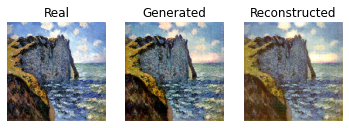

[INFO] Domain B to Domain A


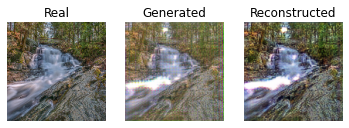

epoch: 65 step: 1 dA_loss: 0.012 dB_loss: 0.048 gAB_loss :3.819 gBA_loss: 3.883
epoch: 65 step: 2 dA_loss: 0.040 dB_loss: 0.018 gAB_loss :3.781 gBA_loss: 3.696
epoch: 65 step: 3 dA_loss: 0.010 dB_loss: 0.013 gAB_loss :4.061 gBA_loss: 4.084
epoch: 65 step: 4 dA_loss: 0.057 dB_loss: 0.050 gAB_loss :3.617 gBA_loss: 4.010
epoch: 65 step: 5 dA_loss: 0.034 dB_loss: 0.007 gAB_loss :4.139 gBA_loss: 4.766
epoch: 65 step: 6 dA_loss: 0.057 dB_loss: 0.069 gAB_loss :4.192 gBA_loss: 4.320
epoch: 65 step: 7 dA_loss: 0.016 dB_loss: 0.023 gAB_loss :4.220 gBA_loss: 4.095
epoch: 65 step: 8 dA_loss: 0.015 dB_loss: 0.006 gAB_loss :4.409 gBA_loss: 4.604
epoch: 65 step: 9 dA_loss: 0.042 dB_loss: 0.011 gAB_loss :4.610 gBA_loss: 4.873
epoch: 65 step: 10 dA_loss: 0.015 dB_loss: 0.006 gAB_loss :4.331 gBA_loss: 4.393
epoch: 65 step: 11 dA_loss: 0.039 dB_loss: 0.075 gAB_loss :3.860 gBA_loss: 3.816
epoch: 65 step: 12 dA_loss: 0.009 dB_loss: 0.099 gAB_loss :4.321 gBA_loss: 4.020
epoch: 65 step: 13 dA_loss: 0.030 dB_

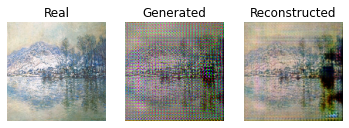

[INFO] Domain B to Domain A


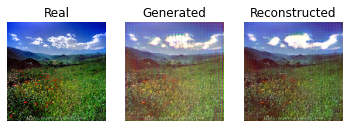

epoch: 65 step: 51 dA_loss: 0.074 dB_loss: 0.012 gAB_loss :4.203 gBA_loss: 4.050
epoch: 65 step: 52 dA_loss: 0.006 dB_loss: 0.039 gAB_loss :4.113 gBA_loss: 3.799
epoch: 65 step: 53 dA_loss: 0.085 dB_loss: 0.018 gAB_loss :3.618 gBA_loss: 3.432
epoch: 65 step: 54 dA_loss: 0.024 dB_loss: 0.011 gAB_loss :3.739 gBA_loss: 3.816
epoch: 65 step: 55 dA_loss: 0.028 dB_loss: 0.044 gAB_loss :4.258 gBA_loss: 4.064
epoch: 65 step: 56 dA_loss: 0.025 dB_loss: 0.030 gAB_loss :4.017 gBA_loss: 4.124
epoch: 65 step: 57 dA_loss: 0.009 dB_loss: 0.040 gAB_loss :3.813 gBA_loss: 3.746
epoch: 65 step: 58 dA_loss: 0.012 dB_loss: 0.024 gAB_loss :4.316 gBA_loss: 4.227
epoch: 65 step: 59 dA_loss: 0.009 dB_loss: 0.040 gAB_loss :3.855 gBA_loss: 3.765
epoch: 65 step: 60 dA_loss: 0.036 dB_loss: 0.014 gAB_loss :4.017 gBA_loss: 3.932
epoch: 65 step: 61 dA_loss: 0.008 dB_loss: 0.049 gAB_loss :4.207 gBA_loss: 3.991
epoch: 65 step: 62 dA_loss: 0.012 dB_loss: 0.011 gAB_loss :4.108 gBA_loss: 3.926
epoch: 65 step: 63 dA_loss: 

 66%|██████▌   | 66/100 [1:48:12<55:29, 97.94s/it]

epoch: 65 step: 73 dA_loss: 0.006 dB_loss: 0.032 gAB_loss :4.213 gBA_loss: 4.229
epoch: 66 step: 0 dA_loss: 0.005 dB_loss: 0.024 gAB_loss :4.318 gBA_loss: 4.173
[INFO] Domain A to Domain B


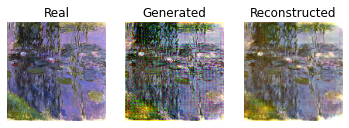

[INFO] Domain B to Domain A


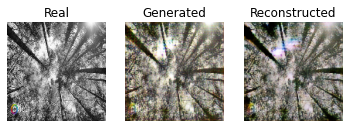

epoch: 66 step: 1 dA_loss: 0.009 dB_loss: 0.016 gAB_loss :3.823 gBA_loss: 4.005
epoch: 66 step: 2 dA_loss: 0.038 dB_loss: 0.014 gAB_loss :3.817 gBA_loss: 3.782
epoch: 66 step: 3 dA_loss: 0.006 dB_loss: 0.017 gAB_loss :4.161 gBA_loss: 4.092
epoch: 66 step: 4 dA_loss: 0.027 dB_loss: 0.015 gAB_loss :3.812 gBA_loss: 3.768
epoch: 66 step: 5 dA_loss: 0.081 dB_loss: 0.005 gAB_loss :4.240 gBA_loss: 4.865
epoch: 66 step: 6 dA_loss: 0.029 dB_loss: 0.023 gAB_loss :4.120 gBA_loss: 4.476
epoch: 66 step: 7 dA_loss: 0.033 dB_loss: 0.013 gAB_loss :4.145 gBA_loss: 4.042
epoch: 66 step: 8 dA_loss: 0.014 dB_loss: 0.004 gAB_loss :4.390 gBA_loss: 4.589
epoch: 66 step: 9 dA_loss: 0.021 dB_loss: 0.004 gAB_loss :4.667 gBA_loss: 4.795
epoch: 66 step: 10 dA_loss: 0.007 dB_loss: 0.005 gAB_loss :4.440 gBA_loss: 4.445
epoch: 66 step: 11 dA_loss: 0.009 dB_loss: 0.053 gAB_loss :3.982 gBA_loss: 3.985
epoch: 66 step: 12 dA_loss: 0.017 dB_loss: 0.056 gAB_loss :4.198 gBA_loss: 4.165
epoch: 66 step: 13 dA_loss: 0.021 dB_

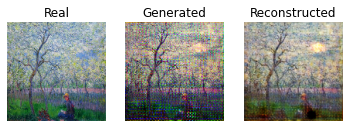

[INFO] Domain B to Domain A


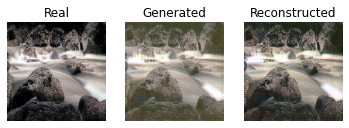

epoch: 66 step: 51 dA_loss: 0.019 dB_loss: 0.012 gAB_loss :4.185 gBA_loss: 4.123
epoch: 66 step: 52 dA_loss: 0.007 dB_loss: 0.069 gAB_loss :4.064 gBA_loss: 3.921
epoch: 66 step: 53 dA_loss: 0.040 dB_loss: 0.014 gAB_loss :3.622 gBA_loss: 3.583
epoch: 66 step: 54 dA_loss: 0.021 dB_loss: 0.012 gAB_loss :3.741 gBA_loss: 3.849
epoch: 66 step: 55 dA_loss: 0.039 dB_loss: 0.050 gAB_loss :4.284 gBA_loss: 3.942
epoch: 66 step: 56 dA_loss: 0.028 dB_loss: 0.038 gAB_loss :4.064 gBA_loss: 4.203
epoch: 66 step: 57 dA_loss: 0.033 dB_loss: 0.034 gAB_loss :3.791 gBA_loss: 3.780
epoch: 66 step: 58 dA_loss: 0.006 dB_loss: 0.023 gAB_loss :4.324 gBA_loss: 4.196
epoch: 66 step: 59 dA_loss: 0.009 dB_loss: 0.033 gAB_loss :3.691 gBA_loss: 3.686
epoch: 66 step: 60 dA_loss: 0.029 dB_loss: 0.014 gAB_loss :3.979 gBA_loss: 4.045
epoch: 66 step: 61 dA_loss: 0.010 dB_loss: 0.058 gAB_loss :4.304 gBA_loss: 4.052
epoch: 66 step: 62 dA_loss: 0.010 dB_loss: 0.010 gAB_loss :4.201 gBA_loss: 3.942
epoch: 66 step: 63 dA_loss: 

 67%|██████▋   | 67/100 [1:49:50<53:51, 97.93s/it]

epoch: 66 step: 73 dA_loss: 0.004 dB_loss: 0.032 gAB_loss :4.268 gBA_loss: 4.202
epoch: 67 step: 0 dA_loss: 0.005 dB_loss: 0.042 gAB_loss :4.330 gBA_loss: 4.057
[INFO] Domain A to Domain B


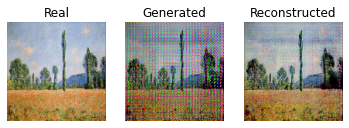

[INFO] Domain B to Domain A


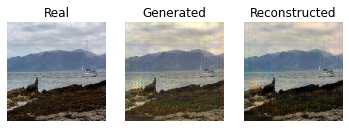

epoch: 67 step: 1 dA_loss: 0.016 dB_loss: 0.019 gAB_loss :3.779 gBA_loss: 4.037
epoch: 67 step: 2 dA_loss: 0.024 dB_loss: 0.010 gAB_loss :3.938 gBA_loss: 3.818
epoch: 67 step: 3 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :4.071 gBA_loss: 4.183
epoch: 67 step: 4 dA_loss: 0.042 dB_loss: 0.018 gAB_loss :3.691 gBA_loss: 3.777
epoch: 67 step: 5 dA_loss: 0.026 dB_loss: 0.006 gAB_loss :4.231 gBA_loss: 4.650
epoch: 67 step: 6 dA_loss: 0.056 dB_loss: 0.026 gAB_loss :4.171 gBA_loss: 4.605
epoch: 67 step: 7 dA_loss: 0.027 dB_loss: 0.013 gAB_loss :4.204 gBA_loss: 4.172
epoch: 67 step: 8 dA_loss: 0.021 dB_loss: 0.005 gAB_loss :4.420 gBA_loss: 4.472
epoch: 67 step: 9 dA_loss: 0.045 dB_loss: 0.005 gAB_loss :4.540 gBA_loss: 4.714
epoch: 67 step: 10 dA_loss: 0.014 dB_loss: 0.006 gAB_loss :4.318 gBA_loss: 4.289
epoch: 67 step: 11 dA_loss: 0.023 dB_loss: 0.060 gAB_loss :3.865 gBA_loss: 3.721
epoch: 67 step: 12 dA_loss: 0.015 dB_loss: 0.059 gAB_loss :4.173 gBA_loss: 4.082
epoch: 67 step: 13 dA_loss: 0.057 dB_

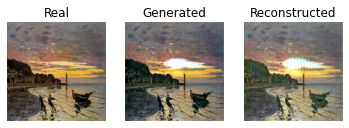

[INFO] Domain B to Domain A


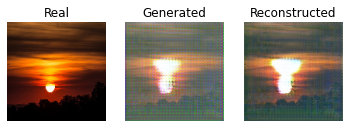

epoch: 67 step: 51 dA_loss: 0.012 dB_loss: 0.121 gAB_loss :4.171 gBA_loss: 3.986
epoch: 67 step: 52 dA_loss: 0.007 dB_loss: 0.164 gAB_loss :4.100 gBA_loss: 3.826
epoch: 67 step: 53 dA_loss: 0.026 dB_loss: 0.111 gAB_loss :3.435 gBA_loss: 3.509
epoch: 67 step: 54 dA_loss: 0.019 dB_loss: 0.055 gAB_loss :3.636 gBA_loss: 3.984
epoch: 67 step: 55 dA_loss: 0.007 dB_loss: 0.075 gAB_loss :4.241 gBA_loss: 3.925
epoch: 67 step: 56 dA_loss: 0.041 dB_loss: 0.036 gAB_loss :4.060 gBA_loss: 4.157
epoch: 67 step: 57 dA_loss: 0.022 dB_loss: 0.060 gAB_loss :3.749 gBA_loss: 3.705
epoch: 67 step: 58 dA_loss: 0.006 dB_loss: 0.063 gAB_loss :3.992 gBA_loss: 4.150
epoch: 67 step: 59 dA_loss: 0.016 dB_loss: 0.057 gAB_loss :3.688 gBA_loss: 3.602
epoch: 67 step: 60 dA_loss: 0.012 dB_loss: 0.064 gAB_loss :4.075 gBA_loss: 3.803
epoch: 67 step: 61 dA_loss: 0.023 dB_loss: 0.069 gAB_loss :4.215 gBA_loss: 3.997
epoch: 67 step: 62 dA_loss: 0.005 dB_loss: 0.027 gAB_loss :4.072 gBA_loss: 3.982
epoch: 67 step: 63 dA_loss: 

 68%|██████▊   | 68/100 [1:51:28<52:13, 97.93s/it]

epoch: 67 step: 73 dA_loss: 0.004 dB_loss: 0.031 gAB_loss :4.224 gBA_loss: 4.123
epoch: 68 step: 0 dA_loss: 0.004 dB_loss: 0.038 gAB_loss :4.295 gBA_loss: 4.014
[INFO] Domain A to Domain B


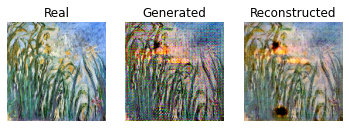

[INFO] Domain B to Domain A


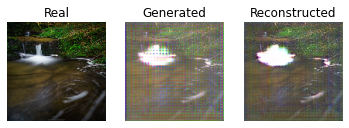

epoch: 68 step: 1 dA_loss: 0.014 dB_loss: 0.015 gAB_loss :3.750 gBA_loss: 3.916
epoch: 68 step: 2 dA_loss: 0.027 dB_loss: 0.010 gAB_loss :3.823 gBA_loss: 3.756
epoch: 68 step: 3 dA_loss: 0.006 dB_loss: 0.010 gAB_loss :4.112 gBA_loss: 4.010
epoch: 68 step: 4 dA_loss: 0.025 dB_loss: 0.069 gAB_loss :3.538 gBA_loss: 3.722
epoch: 68 step: 5 dA_loss: 0.027 dB_loss: 0.030 gAB_loss :4.170 gBA_loss: 4.569
epoch: 68 step: 6 dA_loss: 0.037 dB_loss: 0.048 gAB_loss :4.140 gBA_loss: 4.523
epoch: 68 step: 7 dA_loss: 0.010 dB_loss: 0.017 gAB_loss :4.131 gBA_loss: 4.195
epoch: 68 step: 8 dA_loss: 0.022 dB_loss: 0.007 gAB_loss :4.362 gBA_loss: 4.566
epoch: 68 step: 9 dA_loss: 0.007 dB_loss: 0.007 gAB_loss :4.547 gBA_loss: 4.548
epoch: 68 step: 10 dA_loss: 0.012 dB_loss: 0.008 gAB_loss :4.304 gBA_loss: 4.179
epoch: 68 step: 11 dA_loss: 0.017 dB_loss: 0.069 gAB_loss :3.805 gBA_loss: 3.832
epoch: 68 step: 12 dA_loss: 0.031 dB_loss: 0.077 gAB_loss :4.098 gBA_loss: 4.030
epoch: 68 step: 13 dA_loss: 0.036 dB_

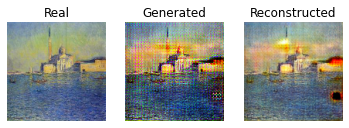

[INFO] Domain B to Domain A


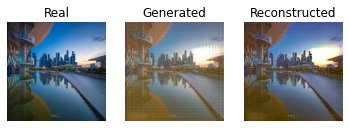

epoch: 68 step: 51 dA_loss: 0.032 dB_loss: 0.017 gAB_loss :4.163 gBA_loss: 3.997
epoch: 68 step: 52 dA_loss: 0.005 dB_loss: 0.068 gAB_loss :4.030 gBA_loss: 3.747
epoch: 68 step: 53 dA_loss: 0.038 dB_loss: 0.048 gAB_loss :3.724 gBA_loss: 3.539
epoch: 68 step: 54 dA_loss: 0.010 dB_loss: 0.041 gAB_loss :3.728 gBA_loss: 3.921
epoch: 68 step: 55 dA_loss: 0.019 dB_loss: 0.058 gAB_loss :3.987 gBA_loss: 3.784
epoch: 68 step: 56 dA_loss: 0.026 dB_loss: 0.062 gAB_loss :4.100 gBA_loss: 3.996
epoch: 68 step: 57 dA_loss: 0.041 dB_loss: 0.025 gAB_loss :3.962 gBA_loss: 3.812
epoch: 68 step: 58 dA_loss: 0.009 dB_loss: 0.017 gAB_loss :4.238 gBA_loss: 4.184
epoch: 68 step: 59 dA_loss: 0.025 dB_loss: 0.065 gAB_loss :3.574 gBA_loss: 3.666
epoch: 68 step: 60 dA_loss: 0.034 dB_loss: 0.037 gAB_loss :3.984 gBA_loss: 3.672
epoch: 68 step: 61 dA_loss: 0.015 dB_loss: 0.065 gAB_loss :4.201 gBA_loss: 3.807
epoch: 68 step: 62 dA_loss: 0.015 dB_loss: 0.017 gAB_loss :4.091 gBA_loss: 3.871
epoch: 68 step: 63 dA_loss: 

 69%|██████▉   | 69/100 [1:53:06<50:35, 97.92s/it]

epoch: 68 step: 73 dA_loss: 0.004 dB_loss: 0.024 gAB_loss :4.136 gBA_loss: 4.110
epoch: 69 step: 0 dA_loss: 0.004 dB_loss: 0.025 gAB_loss :4.212 gBA_loss: 3.970
[INFO] Domain A to Domain B


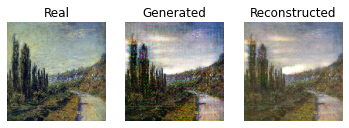

[INFO] Domain B to Domain A


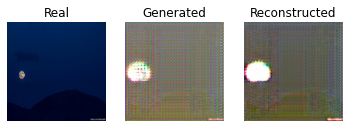

epoch: 69 step: 1 dA_loss: 0.006 dB_loss: 0.029 gAB_loss :3.769 gBA_loss: 3.753
epoch: 69 step: 2 dA_loss: 0.023 dB_loss: 0.011 gAB_loss :3.814 gBA_loss: 3.783
epoch: 69 step: 3 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :4.059 gBA_loss: 4.047
epoch: 69 step: 4 dA_loss: 0.012 dB_loss: 0.058 gAB_loss :3.536 gBA_loss: 3.820
epoch: 69 step: 5 dA_loss: 0.008 dB_loss: 0.029 gAB_loss :4.170 gBA_loss: 4.654
epoch: 69 step: 6 dA_loss: 0.019 dB_loss: 0.083 gAB_loss :4.433 gBA_loss: 4.462
epoch: 69 step: 7 dA_loss: 0.026 dB_loss: 0.095 gAB_loss :3.979 gBA_loss: 4.398
epoch: 69 step: 8 dA_loss: 0.013 dB_loss: 0.058 gAB_loss :4.484 gBA_loss: 4.772
epoch: 69 step: 9 dA_loss: 0.040 dB_loss: 0.053 gAB_loss :4.709 gBA_loss: 4.697
epoch: 69 step: 10 dA_loss: 0.008 dB_loss: 0.018 gAB_loss :4.433 gBA_loss: 4.207
epoch: 69 step: 11 dA_loss: 0.010 dB_loss: 0.121 gAB_loss :3.885 gBA_loss: 3.792
epoch: 69 step: 12 dA_loss: 0.011 dB_loss: 0.124 gAB_loss :4.026 gBA_loss: 4.176
epoch: 69 step: 13 dA_loss: 0.029 dB_

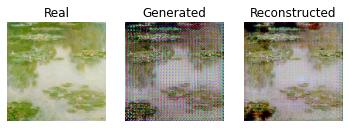

[INFO] Domain B to Domain A


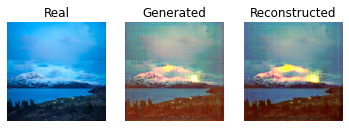

epoch: 69 step: 51 dA_loss: 0.009 dB_loss: 0.011 gAB_loss :4.192 gBA_loss: 3.943
epoch: 69 step: 52 dA_loss: 0.003 dB_loss: 0.055 gAB_loss :4.091 gBA_loss: 3.750
epoch: 69 step: 53 dA_loss: 0.009 dB_loss: 0.011 gAB_loss :3.571 gBA_loss: 3.531
epoch: 69 step: 54 dA_loss: 0.003 dB_loss: 0.011 gAB_loss :3.746 gBA_loss: 3.942
epoch: 69 step: 55 dA_loss: 0.004 dB_loss: 0.044 gAB_loss :4.138 gBA_loss: 3.839
epoch: 69 step: 56 dA_loss: 0.015 dB_loss: 0.025 gAB_loss :3.985 gBA_loss: 4.038
epoch: 69 step: 57 dA_loss: 0.004 dB_loss: 0.054 gAB_loss :4.020 gBA_loss: 3.714
epoch: 69 step: 58 dA_loss: 0.003 dB_loss: 0.031 gAB_loss :4.198 gBA_loss: 4.195
epoch: 69 step: 59 dA_loss: 0.004 dB_loss: 0.061 gAB_loss :3.640 gBA_loss: 3.663
epoch: 69 step: 60 dA_loss: 0.005 dB_loss: 0.029 gAB_loss :3.869 gBA_loss: 3.818
epoch: 69 step: 61 dA_loss: 0.003 dB_loss: 0.094 gAB_loss :4.362 gBA_loss: 3.911
epoch: 69 step: 62 dA_loss: 0.004 dB_loss: 0.022 gAB_loss :4.128 gBA_loss: 3.752
epoch: 69 step: 63 dA_loss: 

 70%|███████   | 70/100 [1:54:44<49:01, 98.06s/it]

epoch: 69 step: 73 dA_loss: 0.002 dB_loss: 0.029 gAB_loss :4.126 gBA_loss: 4.150
epoch: 70 step: 0 dA_loss: 0.002 dB_loss: 0.043 gAB_loss :4.200 gBA_loss: 3.983
[INFO] Domain A to Domain B


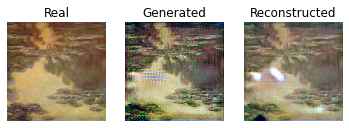

[INFO] Domain B to Domain A


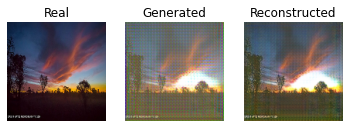

epoch: 70 step: 1 dA_loss: 0.004 dB_loss: 0.053 gAB_loss :3.511 gBA_loss: 3.721
epoch: 70 step: 2 dA_loss: 0.014 dB_loss: 0.033 gAB_loss :3.805 gBA_loss: 3.659
epoch: 70 step: 3 dA_loss: 0.007 dB_loss: 0.032 gAB_loss :4.192 gBA_loss: 3.987
epoch: 70 step: 4 dA_loss: 0.008 dB_loss: 0.070 gAB_loss :3.573 gBA_loss: 3.821
epoch: 70 step: 5 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :4.078 gBA_loss: 4.636
epoch: 70 step: 6 dA_loss: 0.010 dB_loss: 0.078 gAB_loss :4.249 gBA_loss: 4.269
epoch: 70 step: 7 dA_loss: 0.009 dB_loss: 0.015 gAB_loss :4.141 gBA_loss: 4.130
epoch: 70 step: 8 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :4.351 gBA_loss: 4.594
epoch: 70 step: 9 dA_loss: 0.006 dB_loss: 0.018 gAB_loss :4.508 gBA_loss: 4.565
epoch: 70 step: 10 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :4.286 gBA_loss: 4.229
epoch: 70 step: 11 dA_loss: 0.003 dB_loss: 0.071 gAB_loss :3.805 gBA_loss: 3.749
epoch: 70 step: 12 dA_loss: 0.002 dB_loss: 0.129 gAB_loss :4.038 gBA_loss: 4.027
epoch: 70 step: 13 dA_loss: 0.012 dB_

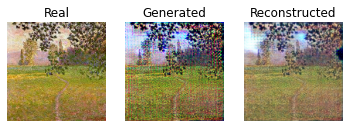

[INFO] Domain B to Domain A


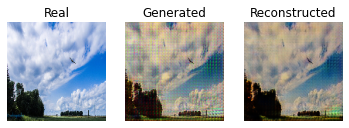

epoch: 70 step: 51 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :4.186 gBA_loss: 4.012
epoch: 70 step: 52 dA_loss: 0.003 dB_loss: 0.056 gAB_loss :4.058 gBA_loss: 3.736
epoch: 70 step: 53 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :3.542 gBA_loss: 3.584
epoch: 70 step: 54 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :3.692 gBA_loss: 3.948
epoch: 70 step: 55 dA_loss: 0.003 dB_loss: 0.048 gAB_loss :4.171 gBA_loss: 3.821
epoch: 70 step: 56 dA_loss: 0.007 dB_loss: 0.020 gAB_loss :4.087 gBA_loss: 4.026
epoch: 70 step: 57 dA_loss: 0.005 dB_loss: 0.027 gAB_loss :3.963 gBA_loss: 3.658
epoch: 70 step: 58 dA_loss: 0.007 dB_loss: 0.016 gAB_loss :4.322 gBA_loss: 4.184
epoch: 70 step: 59 dA_loss: 0.003 dB_loss: 0.046 gAB_loss :3.612 gBA_loss: 3.642
epoch: 70 step: 60 dA_loss: 0.004 dB_loss: 0.016 gAB_loss :3.737 gBA_loss: 3.815
epoch: 70 step: 61 dA_loss: 0.003 dB_loss: 0.073 gAB_loss :4.304 gBA_loss: 3.850
epoch: 70 step: 62 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :4.099 gBA_loss: 3.729
epoch: 70 step: 63 dA_loss: 

 71%|███████   | 71/100 [1:56:22<47:22, 98.01s/it]

epoch: 70 step: 73 dA_loss: 0.004 dB_loss: 0.023 gAB_loss :4.115 gBA_loss: 4.195
epoch: 71 step: 0 dA_loss: 0.003 dB_loss: 0.048 gAB_loss :4.334 gBA_loss: 3.998
[INFO] Domain A to Domain B


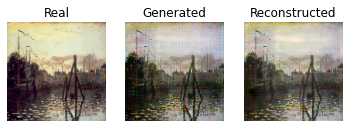

[INFO] Domain B to Domain A


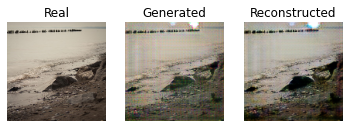

epoch: 71 step: 1 dA_loss: 0.009 dB_loss: 0.056 gAB_loss :3.676 gBA_loss: 3.671
epoch: 71 step: 2 dA_loss: 0.012 dB_loss: 0.010 gAB_loss :3.705 gBA_loss: 3.600
epoch: 71 step: 3 dA_loss: 0.013 dB_loss: 0.011 gAB_loss :4.011 gBA_loss: 4.016
epoch: 71 step: 4 dA_loss: 0.010 dB_loss: 0.017 gAB_loss :3.762 gBA_loss: 3.824
epoch: 71 step: 5 dA_loss: 0.007 dB_loss: 0.007 gAB_loss :4.239 gBA_loss: 4.612
epoch: 71 step: 6 dA_loss: 0.014 dB_loss: 0.019 gAB_loss :4.092 gBA_loss: 4.234
epoch: 71 step: 7 dA_loss: 0.005 dB_loss: 0.040 gAB_loss :3.952 gBA_loss: 4.114
epoch: 71 step: 8 dA_loss: 0.004 dB_loss: 0.011 gAB_loss :4.325 gBA_loss: 4.589
epoch: 71 step: 9 dA_loss: 0.004 dB_loss: 0.020 gAB_loss :4.578 gBA_loss: 4.617
epoch: 71 step: 10 dA_loss: 0.004 dB_loss: 0.006 gAB_loss :4.375 gBA_loss: 4.280
epoch: 71 step: 11 dA_loss: 0.004 dB_loss: 0.039 gAB_loss :3.954 gBA_loss: 3.811
epoch: 71 step: 12 dA_loss: 0.002 dB_loss: 0.053 gAB_loss :4.112 gBA_loss: 4.050
epoch: 71 step: 13 dA_loss: 0.009 dB_

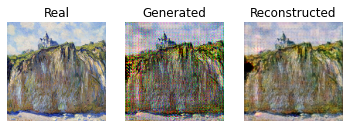

[INFO] Domain B to Domain A


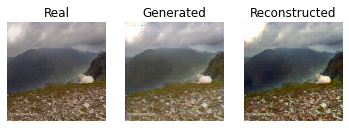

epoch: 71 step: 51 dA_loss: 0.003 dB_loss: 0.038 gAB_loss :4.282 gBA_loss: 4.085
epoch: 71 step: 52 dA_loss: 0.002 dB_loss: 0.045 gAB_loss :4.242 gBA_loss: 3.770
epoch: 71 step: 53 dA_loss: 0.004 dB_loss: 0.030 gAB_loss :3.552 gBA_loss: 3.547
epoch: 71 step: 54 dA_loss: 0.002 dB_loss: 0.034 gAB_loss :3.740 gBA_loss: 3.915
epoch: 71 step: 55 dA_loss: 0.003 dB_loss: 0.048 gAB_loss :4.225 gBA_loss: 3.826
epoch: 71 step: 56 dA_loss: 0.005 dB_loss: 0.038 gAB_loss :3.982 gBA_loss: 4.062
epoch: 71 step: 57 dA_loss: 0.003 dB_loss: 0.034 gAB_loss :3.789 gBA_loss: 3.635
epoch: 71 step: 58 dA_loss: 0.002 dB_loss: 0.035 gAB_loss :4.156 gBA_loss: 4.105
epoch: 71 step: 59 dA_loss: 0.004 dB_loss: 0.063 gAB_loss :3.850 gBA_loss: 3.618
epoch: 71 step: 60 dA_loss: 0.009 dB_loss: 0.056 gAB_loss :3.822 gBA_loss: 3.870
epoch: 71 step: 61 dA_loss: 0.004 dB_loss: 0.048 gAB_loss :3.995 gBA_loss: 3.954
epoch: 71 step: 62 dA_loss: 0.005 dB_loss: 0.094 gAB_loss :4.243 gBA_loss: 3.734
epoch: 71 step: 63 dA_loss: 

 72%|███████▏  | 72/100 [1:58:00<45:43, 97.97s/it]

epoch: 71 step: 73 dA_loss: 0.002 dB_loss: 0.026 gAB_loss :4.162 gBA_loss: 4.093
epoch: 72 step: 0 dA_loss: 0.002 dB_loss: 0.055 gAB_loss :4.119 gBA_loss: 3.983
[INFO] Domain A to Domain B


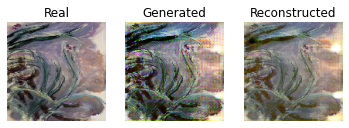

[INFO] Domain B to Domain A


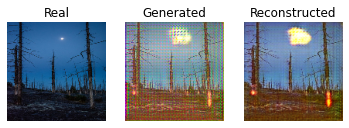

epoch: 72 step: 1 dA_loss: 0.005 dB_loss: 0.044 gAB_loss :3.868 gBA_loss: 3.738
epoch: 72 step: 2 dA_loss: 0.009 dB_loss: 0.019 gAB_loss :3.773 gBA_loss: 3.661
epoch: 72 step: 3 dA_loss: 0.002 dB_loss: 0.016 gAB_loss :3.979 gBA_loss: 3.934
epoch: 72 step: 4 dA_loss: 0.006 dB_loss: 0.105 gAB_loss :3.333 gBA_loss: 3.747
epoch: 72 step: 5 dA_loss: 0.005 dB_loss: 0.045 gAB_loss :4.083 gBA_loss: 4.549
epoch: 72 step: 6 dA_loss: 0.016 dB_loss: 0.053 gAB_loss :4.144 gBA_loss: 4.203
epoch: 72 step: 7 dA_loss: 0.005 dB_loss: 0.051 gAB_loss :4.244 gBA_loss: 3.974
epoch: 72 step: 8 dA_loss: 0.006 dB_loss: 0.027 gAB_loss :4.394 gBA_loss: 4.478
epoch: 72 step: 9 dA_loss: 0.003 dB_loss: 0.010 gAB_loss :4.404 gBA_loss: 4.498
epoch: 72 step: 10 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :4.191 gBA_loss: 4.252
epoch: 72 step: 11 dA_loss: 0.007 dB_loss: 0.051 gAB_loss :3.735 gBA_loss: 3.837
epoch: 72 step: 12 dA_loss: 0.006 dB_loss: 0.094 gAB_loss :4.231 gBA_loss: 4.041
epoch: 72 step: 13 dA_loss: 0.010 dB_

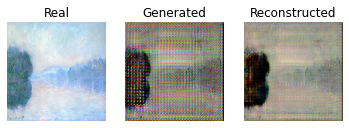

[INFO] Domain B to Domain A


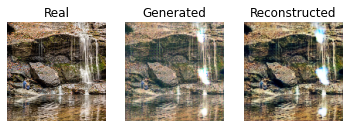

epoch: 72 step: 51 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :4.120 gBA_loss: 3.926
epoch: 72 step: 52 dA_loss: 0.001 dB_loss: 0.054 gAB_loss :4.074 gBA_loss: 3.728
epoch: 72 step: 53 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :3.587 gBA_loss: 3.503
epoch: 72 step: 54 dA_loss: 0.002 dB_loss: 0.026 gAB_loss :3.648 gBA_loss: 3.852
epoch: 72 step: 55 dA_loss: 0.003 dB_loss: 0.043 gAB_loss :4.007 gBA_loss: 3.752
epoch: 72 step: 56 dA_loss: 0.007 dB_loss: 0.057 gAB_loss :4.254 gBA_loss: 3.950
epoch: 72 step: 57 dA_loss: 0.002 dB_loss: 0.042 gAB_loss :3.861 gBA_loss: 3.576
epoch: 72 step: 58 dA_loss: 0.005 dB_loss: 0.098 gAB_loss :3.867 gBA_loss: 4.096
epoch: 72 step: 59 dA_loss: 0.004 dB_loss: 0.071 gAB_loss :3.673 gBA_loss: 3.601
epoch: 72 step: 60 dA_loss: 0.003 dB_loss: 0.033 gAB_loss :3.903 gBA_loss: 3.756
epoch: 72 step: 61 dA_loss: 0.004 dB_loss: 0.088 gAB_loss :3.964 gBA_loss: 3.850
epoch: 72 step: 62 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :4.033 gBA_loss: 3.732
epoch: 72 step: 63 dA_loss: 

 73%|███████▎  | 73/100 [1:59:38<44:04, 97.94s/it]

epoch: 72 step: 73 dA_loss: 0.001 dB_loss: 0.034 gAB_loss :4.103 gBA_loss: 4.086
epoch: 73 step: 0 dA_loss: 0.002 dB_loss: 0.043 gAB_loss :4.160 gBA_loss: 3.955
[INFO] Domain A to Domain B


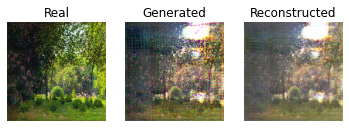

[INFO] Domain B to Domain A


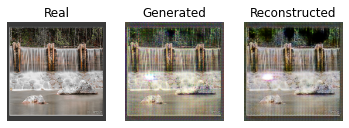

epoch: 73 step: 1 dA_loss: 0.006 dB_loss: 0.028 gAB_loss :3.798 gBA_loss: 3.776
epoch: 73 step: 2 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.792 gBA_loss: 3.654
epoch: 73 step: 3 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :4.005 gBA_loss: 3.934
epoch: 73 step: 4 dA_loss: 0.009 dB_loss: 0.041 gAB_loss :3.494 gBA_loss: 3.731
epoch: 73 step: 5 dA_loss: 0.008 dB_loss: 0.014 gAB_loss :4.089 gBA_loss: 4.545
epoch: 73 step: 6 dA_loss: 0.010 dB_loss: 0.022 gAB_loss :4.042 gBA_loss: 4.304
epoch: 73 step: 7 dA_loss: 0.010 dB_loss: 0.037 gAB_loss :4.197 gBA_loss: 4.104
epoch: 73 step: 8 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :4.428 gBA_loss: 4.536
epoch: 73 step: 9 dA_loss: 0.004 dB_loss: 0.010 gAB_loss :4.430 gBA_loss: 4.459
epoch: 73 step: 10 dA_loss: 0.008 dB_loss: 0.016 gAB_loss :4.201 gBA_loss: 4.154
epoch: 73 step: 11 dA_loss: 0.003 dB_loss: 0.035 gAB_loss :3.819 gBA_loss: 3.719
epoch: 73 step: 12 dA_loss: 0.012 dB_loss: 0.053 gAB_loss :4.102 gBA_loss: 4.037
epoch: 73 step: 13 dA_loss: 0.013 dB_

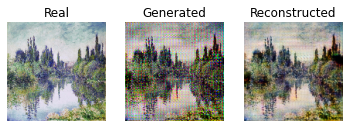

[INFO] Domain B to Domain A


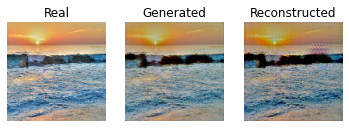

epoch: 73 step: 51 dA_loss: 0.039 dB_loss: 0.010 gAB_loss :4.207 gBA_loss: 3.941
epoch: 73 step: 52 dA_loss: 0.004 dB_loss: 0.026 gAB_loss :4.062 gBA_loss: 3.694
epoch: 73 step: 53 dA_loss: 0.011 dB_loss: 0.015 gAB_loss :3.557 gBA_loss: 3.538
epoch: 73 step: 54 dA_loss: 0.017 dB_loss: 0.018 gAB_loss :3.761 gBA_loss: 3.936
epoch: 73 step: 55 dA_loss: 0.005 dB_loss: 0.052 gAB_loss :4.048 gBA_loss: 3.924
epoch: 73 step: 56 dA_loss: 0.031 dB_loss: 0.011 gAB_loss :3.889 gBA_loss: 3.924
epoch: 73 step: 57 dA_loss: 0.031 dB_loss: 0.041 gAB_loss :3.915 gBA_loss: 3.672
epoch: 73 step: 58 dA_loss: 0.003 dB_loss: 0.015 gAB_loss :4.330 gBA_loss: 4.105
epoch: 73 step: 59 dA_loss: 0.013 dB_loss: 0.055 gAB_loss :3.649 gBA_loss: 3.589
epoch: 73 step: 60 dA_loss: 0.015 dB_loss: 0.029 gAB_loss :3.830 gBA_loss: 3.687
epoch: 73 step: 61 dA_loss: 0.008 dB_loss: 0.053 gAB_loss :4.244 gBA_loss: 3.801
epoch: 73 step: 62 dA_loss: 0.007 dB_loss: 0.037 gAB_loss :3.974 gBA_loss: 3.724
epoch: 73 step: 63 dA_loss: 

 74%|███████▍  | 74/100 [2:01:16<42:25, 97.91s/it]

epoch: 73 step: 73 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :4.179 gBA_loss: 4.078
epoch: 74 step: 0 dA_loss: 0.002 dB_loss: 0.042 gAB_loss :4.118 gBA_loss: 3.936
[INFO] Domain A to Domain B


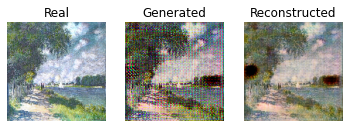

[INFO] Domain B to Domain A


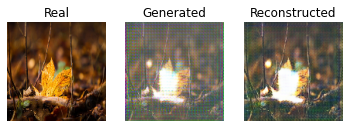

epoch: 74 step: 1 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :3.611 gBA_loss: 3.678
epoch: 74 step: 2 dA_loss: 0.009 dB_loss: 0.014 gAB_loss :3.630 gBA_loss: 3.608
epoch: 74 step: 3 dA_loss: 0.005 dB_loss: 0.017 gAB_loss :4.000 gBA_loss: 3.902
epoch: 74 step: 4 dA_loss: 0.006 dB_loss: 0.024 gAB_loss :3.560 gBA_loss: 3.743
epoch: 74 step: 5 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :4.073 gBA_loss: 4.502
epoch: 74 step: 6 dA_loss: 0.015 dB_loss: 0.008 gAB_loss :3.948 gBA_loss: 4.143
epoch: 74 step: 7 dA_loss: 0.005 dB_loss: 0.034 gAB_loss :3.985 gBA_loss: 3.946
epoch: 74 step: 8 dA_loss: 0.005 dB_loss: 0.014 gAB_loss :4.299 gBA_loss: 4.441
epoch: 74 step: 9 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :4.398 gBA_loss: 4.403
epoch: 74 step: 10 dA_loss: 0.005 dB_loss: 0.007 gAB_loss :4.227 gBA_loss: 4.157
epoch: 74 step: 11 dA_loss: 0.005 dB_loss: 0.032 gAB_loss :3.811 gBA_loss: 3.705
epoch: 74 step: 12 dA_loss: 0.003 dB_loss: 0.032 gAB_loss :4.135 gBA_loss: 3.978
epoch: 74 step: 13 dA_loss: 0.022 dB_

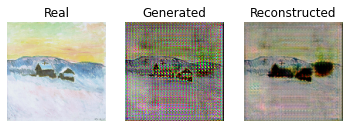

[INFO] Domain B to Domain A


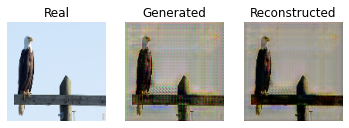

epoch: 74 step: 51 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :4.179 gBA_loss: 3.921
epoch: 74 step: 52 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :4.091 gBA_loss: 3.709
epoch: 74 step: 53 dA_loss: 0.018 dB_loss: 0.013 gAB_loss :3.538 gBA_loss: 3.456
epoch: 74 step: 54 dA_loss: 0.005 dB_loss: 0.016 gAB_loss :3.682 gBA_loss: 3.816
epoch: 74 step: 55 dA_loss: 0.004 dB_loss: 0.041 gAB_loss :4.287 gBA_loss: 3.744
epoch: 74 step: 56 dA_loss: 0.033 dB_loss: 0.036 gAB_loss :3.924 gBA_loss: 4.052
epoch: 74 step: 57 dA_loss: 0.020 dB_loss: 0.020 gAB_loss :3.699 gBA_loss: 3.582
epoch: 74 step: 58 dA_loss: 0.003 dB_loss: 0.056 gAB_loss :4.268 gBA_loss: 4.001
epoch: 74 step: 59 dA_loss: 0.008 dB_loss: 0.016 gAB_loss :3.634 gBA_loss: 3.539
epoch: 74 step: 60 dA_loss: 0.007 dB_loss: 0.036 gAB_loss :3.981 gBA_loss: 3.740
epoch: 74 step: 61 dA_loss: 0.007 dB_loss: 0.051 gAB_loss :4.161 gBA_loss: 3.840
epoch: 74 step: 62 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :4.032 gBA_loss: 3.717
epoch: 74 step: 63 dA_loss: 

 75%|███████▌  | 75/100 [2:02:53<40:47, 97.92s/it]

epoch: 74 step: 73 dA_loss: 0.004 dB_loss: 0.014 gAB_loss :4.118 gBA_loss: 4.054
epoch: 75 step: 0 dA_loss: 0.003 dB_loss: 0.022 gAB_loss :4.140 gBA_loss: 3.917
[INFO] Domain A to Domain B


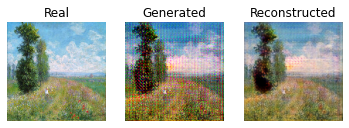

[INFO] Domain B to Domain A


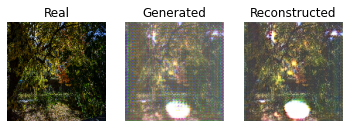

epoch: 75 step: 1 dA_loss: 0.006 dB_loss: 0.026 gAB_loss :3.711 gBA_loss: 3.766
epoch: 75 step: 2 dA_loss: 0.013 dB_loss: 0.005 gAB_loss :3.757 gBA_loss: 3.579
epoch: 75 step: 3 dA_loss: 0.003 dB_loss: 0.013 gAB_loss :3.953 gBA_loss: 3.916
epoch: 75 step: 4 dA_loss: 0.027 dB_loss: 0.009 gAB_loss :3.581 gBA_loss: 3.710
epoch: 75 step: 5 dA_loss: 0.010 dB_loss: 0.008 gAB_loss :4.109 gBA_loss: 4.574
epoch: 75 step: 6 dA_loss: 0.014 dB_loss: 0.014 gAB_loss :3.989 gBA_loss: 4.348
epoch: 75 step: 7 dA_loss: 0.013 dB_loss: 0.019 gAB_loss :3.992 gBA_loss: 4.008
epoch: 75 step: 8 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :4.314 gBA_loss: 4.530
epoch: 75 step: 9 dA_loss: 0.005 dB_loss: 0.007 gAB_loss :4.429 gBA_loss: 4.410
epoch: 75 step: 10 dA_loss: 0.009 dB_loss: 0.009 gAB_loss :4.251 gBA_loss: 4.235
epoch: 75 step: 11 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.880 gBA_loss: 3.719
epoch: 75 step: 12 dA_loss: 0.007 dB_loss: 0.030 gAB_loss :4.114 gBA_loss: 3.982
epoch: 75 step: 13 dA_loss: 0.005 dB_

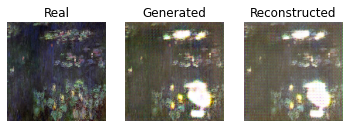

[INFO] Domain B to Domain A


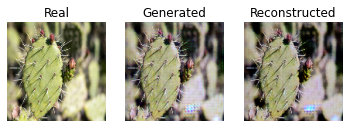

epoch: 75 step: 51 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :4.163 gBA_loss: 4.016
epoch: 75 step: 52 dA_loss: 0.003 dB_loss: 0.043 gAB_loss :4.032 gBA_loss: 3.726
epoch: 75 step: 53 dA_loss: 0.006 dB_loss: 0.014 gAB_loss :3.504 gBA_loss: 3.454
epoch: 75 step: 54 dA_loss: 0.004 dB_loss: 0.011 gAB_loss :3.633 gBA_loss: 3.958
epoch: 75 step: 55 dA_loss: 0.003 dB_loss: 0.029 gAB_loss :4.347 gBA_loss: 3.804
epoch: 75 step: 56 dA_loss: 0.009 dB_loss: 0.013 gAB_loss :3.999 gBA_loss: 3.961
epoch: 75 step: 57 dA_loss: 0.005 dB_loss: 0.016 gAB_loss :3.787 gBA_loss: 3.580
epoch: 75 step: 58 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :4.189 gBA_loss: 4.059
epoch: 75 step: 59 dA_loss: 0.008 dB_loss: 0.029 gAB_loss :3.737 gBA_loss: 3.578
epoch: 75 step: 60 dA_loss: 0.018 dB_loss: 0.024 gAB_loss :3.831 gBA_loss: 3.747
epoch: 75 step: 61 dA_loss: 0.005 dB_loss: 0.040 gAB_loss :4.090 gBA_loss: 3.798
epoch: 75 step: 62 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :4.071 gBA_loss: 3.671
epoch: 75 step: 63 dA_loss: 

 76%|███████▌  | 76/100 [2:04:31<39:09, 97.91s/it]

epoch: 75 step: 73 dA_loss: 0.003 dB_loss: 0.013 gAB_loss :4.167 gBA_loss: 4.109
epoch: 76 step: 0 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :4.236 gBA_loss: 3.934
[INFO] Domain A to Domain B


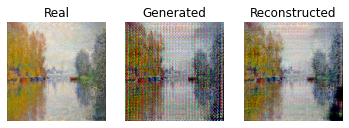

[INFO] Domain B to Domain A


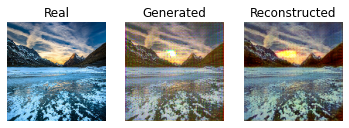

epoch: 76 step: 1 dA_loss: 0.017 dB_loss: 0.011 gAB_loss :3.654 gBA_loss: 3.566
epoch: 76 step: 2 dA_loss: 0.061 dB_loss: 0.006 gAB_loss :3.701 gBA_loss: 3.629
epoch: 76 step: 3 dA_loss: 0.026 dB_loss: 0.009 gAB_loss :3.951 gBA_loss: 3.830
epoch: 76 step: 4 dA_loss: 0.034 dB_loss: 0.020 gAB_loss :3.481 gBA_loss: 3.656
epoch: 76 step: 5 dA_loss: 0.013 dB_loss: 0.006 gAB_loss :4.109 gBA_loss: 4.574
epoch: 76 step: 6 dA_loss: 0.105 dB_loss: 0.007 gAB_loss :4.004 gBA_loss: 4.043
epoch: 76 step: 7 dA_loss: 0.057 dB_loss: 0.014 gAB_loss :4.079 gBA_loss: 4.007
epoch: 76 step: 8 dA_loss: 0.007 dB_loss: 0.008 gAB_loss :4.386 gBA_loss: 4.475
epoch: 76 step: 9 dA_loss: 0.049 dB_loss: 0.007 gAB_loss :4.436 gBA_loss: 4.206
epoch: 76 step: 10 dA_loss: 0.033 dB_loss: 0.009 gAB_loss :4.214 gBA_loss: 4.211
epoch: 76 step: 11 dA_loss: 0.016 dB_loss: 0.017 gAB_loss :3.853 gBA_loss: 3.812
epoch: 76 step: 12 dA_loss: 0.018 dB_loss: 0.023 gAB_loss :4.201 gBA_loss: 3.960
epoch: 76 step: 13 dA_loss: 0.011 dB_

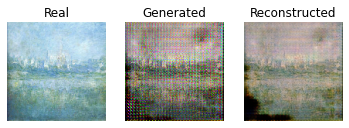

[INFO] Domain B to Domain A


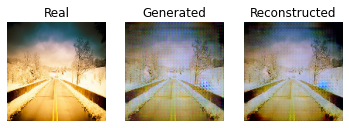

epoch: 76 step: 51 dA_loss: 0.005 dB_loss: 0.018 gAB_loss :4.156 gBA_loss: 3.917
epoch: 76 step: 52 dA_loss: 0.003 dB_loss: 0.046 gAB_loss :4.132 gBA_loss: 3.699
epoch: 76 step: 53 dA_loss: 0.005 dB_loss: 0.032 gAB_loss :3.441 gBA_loss: 3.483
epoch: 76 step: 54 dA_loss: 0.005 dB_loss: 0.030 gAB_loss :3.642 gBA_loss: 3.925
epoch: 76 step: 55 dA_loss: 0.002 dB_loss: 0.037 gAB_loss :4.194 gBA_loss: 3.753
epoch: 76 step: 56 dA_loss: 0.005 dB_loss: 0.017 gAB_loss :4.057 gBA_loss: 4.003
epoch: 76 step: 57 dA_loss: 0.008 dB_loss: 0.019 gAB_loss :3.767 gBA_loss: 3.640
epoch: 76 step: 58 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :4.014 gBA_loss: 4.022
epoch: 76 step: 59 dA_loss: 0.002 dB_loss: 0.042 gAB_loss :3.736 gBA_loss: 3.553
epoch: 76 step: 60 dA_loss: 0.007 dB_loss: 0.014 gAB_loss :4.027 gBA_loss: 3.684
epoch: 76 step: 61 dA_loss: 0.006 dB_loss: 0.052 gAB_loss :4.029 gBA_loss: 3.741
epoch: 76 step: 62 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.926 gBA_loss: 3.623
epoch: 76 step: 63 dA_loss: 

 77%|███████▋  | 77/100 [2:06:09<37:32, 97.92s/it]

epoch: 76 step: 73 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :4.108 gBA_loss: 4.032
epoch: 77 step: 0 dA_loss: 0.003 dB_loss: 0.034 gAB_loss :4.150 gBA_loss: 3.852
[INFO] Domain A to Domain B


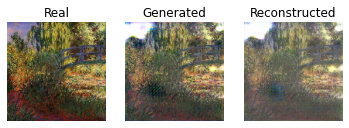

[INFO] Domain B to Domain A


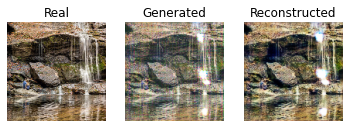

epoch: 77 step: 1 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :3.550 gBA_loss: 3.599
epoch: 77 step: 2 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.576 gBA_loss: 3.542
epoch: 77 step: 3 dA_loss: 0.009 dB_loss: 0.044 gAB_loss :4.073 gBA_loss: 3.893
epoch: 77 step: 4 dA_loss: 0.017 dB_loss: 0.047 gAB_loss :3.457 gBA_loss: 3.613
epoch: 77 step: 5 dA_loss: 0.005 dB_loss: 0.014 gAB_loss :4.097 gBA_loss: 4.491
epoch: 77 step: 6 dA_loss: 0.017 dB_loss: 0.009 gAB_loss :3.949 gBA_loss: 4.120
epoch: 77 step: 7 dA_loss: 0.010 dB_loss: 0.041 gAB_loss :3.905 gBA_loss: 3.980
epoch: 77 step: 8 dA_loss: 0.005 dB_loss: 0.017 gAB_loss :4.260 gBA_loss: 4.415
epoch: 77 step: 9 dA_loss: 0.011 dB_loss: 0.016 gAB_loss :4.385 gBA_loss: 4.474
epoch: 77 step: 10 dA_loss: 0.010 dB_loss: 0.005 gAB_loss :4.287 gBA_loss: 4.209
epoch: 77 step: 11 dA_loss: 0.006 dB_loss: 0.047 gAB_loss :3.777 gBA_loss: 3.666
epoch: 77 step: 12 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :4.056 gBA_loss: 3.929
epoch: 77 step: 13 dA_loss: 0.011 dB_

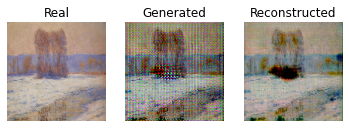

[INFO] Domain B to Domain A


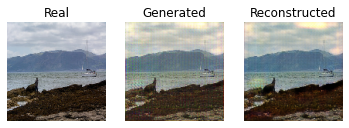

epoch: 77 step: 51 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :4.013 gBA_loss: 3.848
epoch: 77 step: 52 dA_loss: 0.001 dB_loss: 0.024 gAB_loss :4.041 gBA_loss: 3.629
epoch: 77 step: 53 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.508 gBA_loss: 3.371
epoch: 77 step: 54 dA_loss: 0.002 dB_loss: 0.025 gAB_loss :3.571 gBA_loss: 3.796
epoch: 77 step: 55 dA_loss: 0.002 dB_loss: 0.031 gAB_loss :3.966 gBA_loss: 3.694
epoch: 77 step: 56 dA_loss: 0.005 dB_loss: 0.035 gAB_loss :4.077 gBA_loss: 3.930
epoch: 77 step: 57 dA_loss: 0.003 dB_loss: 0.030 gAB_loss :3.820 gBA_loss: 3.499
epoch: 77 step: 58 dA_loss: 0.010 dB_loss: 0.040 gAB_loss :3.906 gBA_loss: 4.018
epoch: 77 step: 59 dA_loss: 0.003 dB_loss: 0.032 gAB_loss :3.419 gBA_loss: 3.520
epoch: 77 step: 60 dA_loss: 0.004 dB_loss: 0.142 gAB_loss :4.048 gBA_loss: 3.642
epoch: 77 step: 61 dA_loss: 0.003 dB_loss: 0.117 gAB_loss :4.082 gBA_loss: 3.703
epoch: 77 step: 62 dA_loss: 0.002 dB_loss: 0.126 gAB_loss :3.710 gBA_loss: 3.593
epoch: 77 step: 63 dA_loss: 

 78%|███████▊  | 78/100 [2:07:47<35:54, 97.91s/it]

epoch: 77 step: 73 dA_loss: 0.002 dB_loss: 0.024 gAB_loss :4.135 gBA_loss: 4.027
epoch: 78 step: 0 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :4.239 gBA_loss: 3.853
[INFO] Domain A to Domain B


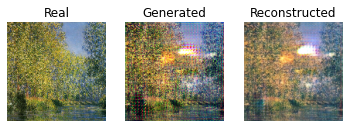

[INFO] Domain B to Domain A


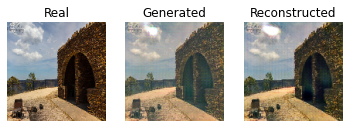

epoch: 78 step: 1 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :3.686 gBA_loss: 3.677
epoch: 78 step: 2 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :3.769 gBA_loss: 3.586
epoch: 78 step: 3 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :4.031 gBA_loss: 3.899
epoch: 78 step: 4 dA_loss: 0.005 dB_loss: 0.013 gAB_loss :3.569 gBA_loss: 3.689
epoch: 78 step: 5 dA_loss: 0.004 dB_loss: 0.006 gAB_loss :4.131 gBA_loss: 4.491
epoch: 78 step: 6 dA_loss: 0.008 dB_loss: 0.008 gAB_loss :3.964 gBA_loss: 4.053
epoch: 78 step: 7 dA_loss: 0.004 dB_loss: 0.016 gAB_loss :3.928 gBA_loss: 3.886
epoch: 78 step: 8 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :4.183 gBA_loss: 4.355
epoch: 78 step: 9 dA_loss: 0.008 dB_loss: 0.011 gAB_loss :4.289 gBA_loss: 4.310
epoch: 78 step: 10 dA_loss: 0.004 dB_loss: 0.005 gAB_loss :4.186 gBA_loss: 4.078
epoch: 78 step: 11 dA_loss: 0.003 dB_loss: 0.018 gAB_loss :3.807 gBA_loss: 3.622
epoch: 78 step: 12 dA_loss: 0.002 dB_loss: 0.027 gAB_loss :4.093 gBA_loss: 3.923
epoch: 78 step: 13 dA_loss: 0.003 dB_

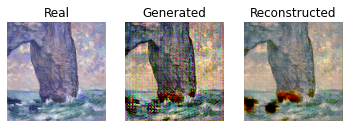

[INFO] Domain B to Domain A


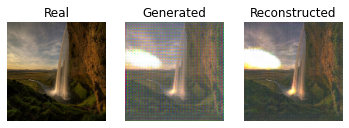

epoch: 78 step: 51 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :4.028 gBA_loss: 3.805
epoch: 78 step: 52 dA_loss: 0.003 dB_loss: 0.026 gAB_loss :3.885 gBA_loss: 3.613
epoch: 78 step: 53 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :3.505 gBA_loss: 3.383
epoch: 78 step: 54 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :3.679 gBA_loss: 3.736
epoch: 78 step: 55 dA_loss: 0.002 dB_loss: 0.039 gAB_loss :3.943 gBA_loss: 3.691
epoch: 78 step: 56 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.860 gBA_loss: 3.869
epoch: 78 step: 57 dA_loss: 0.003 dB_loss: 0.023 gAB_loss :3.848 gBA_loss: 3.532
epoch: 78 step: 58 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :4.174 gBA_loss: 3.939
epoch: 78 step: 59 dA_loss: 0.002 dB_loss: 0.044 gAB_loss :3.484 gBA_loss: 3.432
epoch: 78 step: 60 dA_loss: 0.003 dB_loss: 0.011 gAB_loss :3.638 gBA_loss: 3.638
epoch: 78 step: 61 dA_loss: 0.005 dB_loss: 0.124 gAB_loss :4.159 gBA_loss: 3.686
epoch: 78 step: 62 dA_loss: 0.002 dB_loss: 0.070 gAB_loss :3.906 gBA_loss: 3.544
epoch: 78 step: 63 dA_loss: 

 79%|███████▉  | 79/100 [2:09:25<34:15, 97.89s/it]

epoch: 78 step: 73 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :4.129 gBA_loss: 4.016
epoch: 79 step: 0 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :4.111 gBA_loss: 3.819
[INFO] Domain A to Domain B


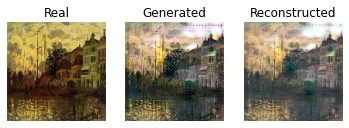

[INFO] Domain B to Domain A


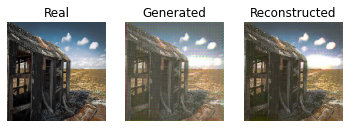

epoch: 79 step: 1 dA_loss: 0.006 dB_loss: 0.017 gAB_loss :3.548 gBA_loss: 3.617
epoch: 79 step: 2 dA_loss: 0.010 dB_loss: 0.008 gAB_loss :3.597 gBA_loss: 3.500
epoch: 79 step: 3 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.937 gBA_loss: 3.828
epoch: 79 step: 4 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.596 gBA_loss: 3.676
epoch: 79 step: 5 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :4.095 gBA_loss: 4.428
epoch: 79 step: 6 dA_loss: 0.009 dB_loss: 0.009 gAB_loss :3.937 gBA_loss: 4.073
epoch: 79 step: 7 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.876 gBA_loss: 3.916
epoch: 79 step: 8 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :4.126 gBA_loss: 4.330
epoch: 79 step: 9 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :4.252 gBA_loss: 4.257
epoch: 79 step: 10 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :4.154 gBA_loss: 4.042
epoch: 79 step: 11 dA_loss: 0.004 dB_loss: 0.016 gAB_loss :3.865 gBA_loss: 3.610
epoch: 79 step: 12 dA_loss: 0.003 dB_loss: 0.028 gAB_loss :4.080 gBA_loss: 3.885
epoch: 79 step: 13 dA_loss: 0.004 dB_

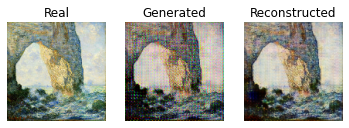

[INFO] Domain B to Domain A


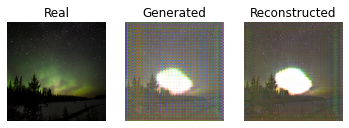

epoch: 79 step: 51 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :4.101 gBA_loss: 3.855
epoch: 79 step: 52 dA_loss: 0.001 dB_loss: 0.028 gAB_loss :3.999 gBA_loss: 3.652
epoch: 79 step: 53 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :3.400 gBA_loss: 3.378
epoch: 79 step: 54 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.574 gBA_loss: 3.763
epoch: 79 step: 55 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :4.057 gBA_loss: 3.629
epoch: 79 step: 56 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.803 gBA_loss: 3.828
epoch: 79 step: 57 dA_loss: 0.002 dB_loss: 0.015 gAB_loss :3.600 gBA_loss: 3.438
epoch: 79 step: 58 dA_loss: 0.002 dB_loss: 0.025 gAB_loss :4.154 gBA_loss: 3.921
epoch: 79 step: 59 dA_loss: 0.003 dB_loss: 0.015 gAB_loss :3.634 gBA_loss: 3.520
epoch: 79 step: 60 dA_loss: 0.003 dB_loss: 0.023 gAB_loss :3.711 gBA_loss: 3.618
epoch: 79 step: 61 dA_loss: 0.003 dB_loss: 0.030 gAB_loss :3.900 gBA_loss: 3.732
epoch: 79 step: 62 dA_loss: 0.001 dB_loss: 0.023 gAB_loss :3.930 gBA_loss: 3.543
epoch: 79 step: 63 dA_loss: 

 80%|████████  | 80/100 [2:11:03<32:37, 97.87s/it]

epoch: 79 step: 73 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.967 gBA_loss: 3.934
epoch: 80 step: 0 dA_loss: 0.001 dB_loss: 0.013 gAB_loss :4.118 gBA_loss: 3.805
[INFO] Domain A to Domain B


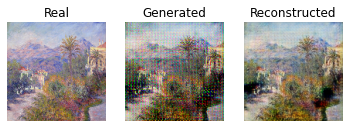

[INFO] Domain B to Domain A


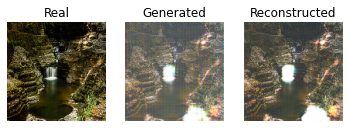

epoch: 80 step: 1 dA_loss: 0.004 dB_loss: 0.022 gAB_loss :3.650 gBA_loss: 3.623
epoch: 80 step: 2 dA_loss: 0.004 dB_loss: 0.010 gAB_loss :3.661 gBA_loss: 3.568
epoch: 80 step: 3 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :3.870 gBA_loss: 3.863
epoch: 80 step: 4 dA_loss: 0.005 dB_loss: 0.036 gAB_loss :3.439 gBA_loss: 3.664
epoch: 80 step: 5 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :4.049 gBA_loss: 4.415
epoch: 80 step: 6 dA_loss: 0.010 dB_loss: 0.011 gAB_loss :3.887 gBA_loss: 4.097
epoch: 80 step: 7 dA_loss: 0.013 dB_loss: 0.012 gAB_loss :3.974 gBA_loss: 3.830
epoch: 80 step: 8 dA_loss: 0.024 dB_loss: 0.005 gAB_loss :4.211 gBA_loss: 4.380
epoch: 80 step: 9 dA_loss: 0.035 dB_loss: 0.004 gAB_loss :4.264 gBA_loss: 4.251
epoch: 80 step: 10 dA_loss: 0.025 dB_loss: 0.004 gAB_loss :4.132 gBA_loss: 3.891
epoch: 80 step: 11 dA_loss: 0.099 dB_loss: 0.014 gAB_loss :3.881 gBA_loss: 3.716
epoch: 80 step: 12 dA_loss: 0.112 dB_loss: 0.022 gAB_loss :4.131 gBA_loss: 3.821
epoch: 80 step: 13 dA_loss: 0.216 dB_

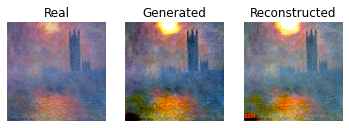

[INFO] Domain B to Domain A


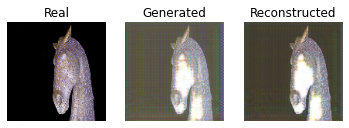

epoch: 80 step: 51 dA_loss: 0.097 dB_loss: 0.008 gAB_loss :4.009 gBA_loss: 3.994
epoch: 80 step: 52 dA_loss: 0.038 dB_loss: 0.017 gAB_loss :3.958 gBA_loss: 3.636
epoch: 80 step: 53 dA_loss: 0.204 dB_loss: 0.014 gAB_loss :3.495 gBA_loss: 3.055
epoch: 80 step: 54 dA_loss: 0.076 dB_loss: 0.009 gAB_loss :3.555 gBA_loss: 3.610
epoch: 80 step: 55 dA_loss: 0.065 dB_loss: 0.029 gAB_loss :4.150 gBA_loss: 3.688
epoch: 80 step: 56 dA_loss: 0.159 dB_loss: 0.023 gAB_loss :3.854 gBA_loss: 3.661
epoch: 80 step: 57 dA_loss: 0.068 dB_loss: 0.010 gAB_loss :3.674 gBA_loss: 3.496
epoch: 80 step: 58 dA_loss: 0.016 dB_loss: 0.014 gAB_loss :4.067 gBA_loss: 4.010
epoch: 80 step: 59 dA_loss: 0.054 dB_loss: 0.015 gAB_loss :3.623 gBA_loss: 3.402
epoch: 80 step: 60 dA_loss: 0.048 dB_loss: 0.009 gAB_loss :3.810 gBA_loss: 3.547
epoch: 80 step: 61 dA_loss: 0.071 dB_loss: 0.031 gAB_loss :3.977 gBA_loss: 3.837
epoch: 80 step: 62 dA_loss: 0.033 dB_loss: 0.007 gAB_loss :3.893 gBA_loss: 3.592
epoch: 80 step: 63 dA_loss: 

 81%|████████  | 81/100 [2:12:41<31:01, 97.97s/it]

epoch: 80 step: 73 dA_loss: 0.012 dB_loss: 0.010 gAB_loss :4.110 gBA_loss: 3.962
epoch: 81 step: 0 dA_loss: 0.005 dB_loss: 0.026 gAB_loss :4.010 gBA_loss: 3.782
[INFO] Domain A to Domain B


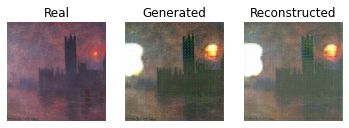

[INFO] Domain B to Domain A


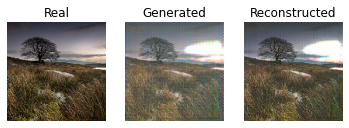

epoch: 81 step: 1 dA_loss: 0.046 dB_loss: 0.006 gAB_loss :3.499 gBA_loss: 3.426
epoch: 81 step: 2 dA_loss: 0.025 dB_loss: 0.016 gAB_loss :3.498 gBA_loss: 3.525
epoch: 81 step: 3 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :3.863 gBA_loss: 3.800
epoch: 81 step: 4 dA_loss: 0.016 dB_loss: 0.016 gAB_loss :3.573 gBA_loss: 3.617
epoch: 81 step: 5 dA_loss: 0.059 dB_loss: 0.008 gAB_loss :4.034 gBA_loss: 4.349
epoch: 81 step: 6 dA_loss: 0.055 dB_loss: 0.030 gAB_loss :3.826 gBA_loss: 3.982
epoch: 81 step: 7 dA_loss: 0.053 dB_loss: 0.025 gAB_loss :3.843 gBA_loss: 3.931
epoch: 81 step: 8 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :4.108 gBA_loss: 4.341
epoch: 81 step: 9 dA_loss: 0.071 dB_loss: 0.007 gAB_loss :4.248 gBA_loss: 4.066
epoch: 81 step: 10 dA_loss: 0.018 dB_loss: 0.007 gAB_loss :4.125 gBA_loss: 3.934
epoch: 81 step: 11 dA_loss: 0.015 dB_loss: 0.012 gAB_loss :3.820 gBA_loss: 3.470
epoch: 81 step: 12 dA_loss: 0.058 dB_loss: 0.012 gAB_loss :4.217 gBA_loss: 3.949
epoch: 81 step: 13 dA_loss: 0.109 dB_

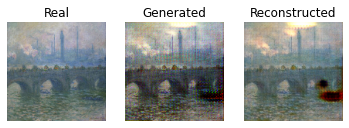

[INFO] Domain B to Domain A


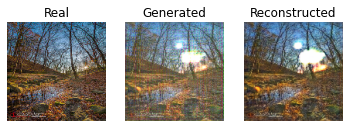

epoch: 81 step: 51 dA_loss: 0.034 dB_loss: 0.008 gAB_loss :4.022 gBA_loss: 3.736
epoch: 81 step: 52 dA_loss: 0.008 dB_loss: 0.046 gAB_loss :3.723 gBA_loss: 3.574
epoch: 81 step: 53 dA_loss: 0.023 dB_loss: 0.030 gAB_loss :3.522 gBA_loss: 3.523
epoch: 81 step: 54 dA_loss: 0.036 dB_loss: 0.016 gAB_loss :3.738 gBA_loss: 3.866
epoch: 81 step: 55 dA_loss: 0.005 dB_loss: 0.030 gAB_loss :4.039 gBA_loss: 3.714
epoch: 81 step: 56 dA_loss: 0.115 dB_loss: 0.045 gAB_loss :4.063 gBA_loss: 4.003
epoch: 81 step: 57 dA_loss: 0.033 dB_loss: 0.016 gAB_loss :3.748 gBA_loss: 3.531
epoch: 81 step: 58 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :4.070 gBA_loss: 3.874
epoch: 81 step: 59 dA_loss: 0.008 dB_loss: 0.020 gAB_loss :3.435 gBA_loss: 3.368
epoch: 81 step: 60 dA_loss: 0.019 dB_loss: 0.011 gAB_loss :3.726 gBA_loss: 3.587
epoch: 81 step: 61 dA_loss: 0.005 dB_loss: 0.061 gAB_loss :4.094 gBA_loss: 3.658
epoch: 81 step: 62 dA_loss: 0.020 dB_loss: 0.054 gAB_loss :3.855 gBA_loss: 3.607
epoch: 81 step: 63 dA_loss: 

 82%|████████▏ | 82/100 [2:14:19<29:22, 97.93s/it]

epoch: 81 step: 73 dA_loss: 0.010 dB_loss: 0.031 gAB_loss :4.024 gBA_loss: 3.909
epoch: 82 step: 0 dA_loss: 0.031 dB_loss: 0.013 gAB_loss :4.047 gBA_loss: 3.670
[INFO] Domain A to Domain B


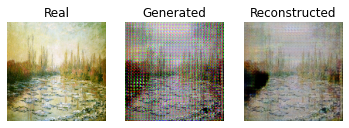

[INFO] Domain B to Domain A


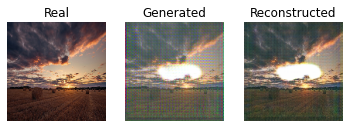

epoch: 82 step: 1 dA_loss: 0.011 dB_loss: 0.016 gAB_loss :3.457 gBA_loss: 3.565
epoch: 82 step: 2 dA_loss: 0.017 dB_loss: 0.018 gAB_loss :3.522 gBA_loss: 3.515
epoch: 82 step: 3 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.798 gBA_loss: 3.847
epoch: 82 step: 4 dA_loss: 0.040 dB_loss: 0.021 gAB_loss :3.470 gBA_loss: 3.436
epoch: 82 step: 5 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :4.033 gBA_loss: 4.280
epoch: 82 step: 6 dA_loss: 0.017 dB_loss: 0.007 gAB_loss :3.872 gBA_loss: 4.013
epoch: 82 step: 7 dA_loss: 0.034 dB_loss: 0.009 gAB_loss :3.846 gBA_loss: 3.932
epoch: 82 step: 8 dA_loss: 0.005 dB_loss: 0.005 gAB_loss :4.070 gBA_loss: 4.282
epoch: 82 step: 9 dA_loss: 0.030 dB_loss: 0.005 gAB_loss :4.120 gBA_loss: 4.144
epoch: 82 step: 10 dA_loss: 0.018 dB_loss: 0.004 gAB_loss :4.062 gBA_loss: 3.948
epoch: 82 step: 11 dA_loss: 0.010 dB_loss: 0.009 gAB_loss :3.816 gBA_loss: 3.559
epoch: 82 step: 12 dA_loss: 0.004 dB_loss: 0.024 gAB_loss :4.137 gBA_loss: 3.873
epoch: 82 step: 13 dA_loss: 0.016 dB_

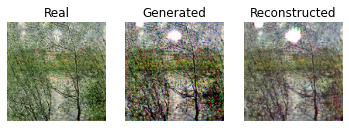

[INFO] Domain B to Domain A


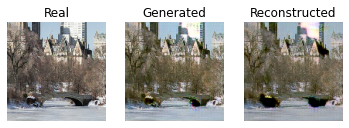

epoch: 82 step: 51 dA_loss: 0.004 dB_loss: 0.005 gAB_loss :3.990 gBA_loss: 3.815
epoch: 82 step: 52 dA_loss: 0.002 dB_loss: 0.020 gAB_loss :4.006 gBA_loss: 3.546
epoch: 82 step: 53 dA_loss: 0.006 dB_loss: 0.022 gAB_loss :3.441 gBA_loss: 3.399
epoch: 82 step: 54 dA_loss: 0.002 dB_loss: 0.024 gAB_loss :3.378 gBA_loss: 3.736
epoch: 82 step: 55 dA_loss: 0.002 dB_loss: 0.046 gAB_loss :4.175 gBA_loss: 3.790
epoch: 82 step: 56 dA_loss: 0.004 dB_loss: 0.015 gAB_loss :3.917 gBA_loss: 3.852
epoch: 82 step: 57 dA_loss: 0.004 dB_loss: 0.026 gAB_loss :3.678 gBA_loss: 3.490
epoch: 82 step: 58 dA_loss: 0.009 dB_loss: 0.030 gAB_loss :4.031 gBA_loss: 3.916
epoch: 82 step: 59 dA_loss: 0.005 dB_loss: 0.007 gAB_loss :3.450 gBA_loss: 3.344
epoch: 82 step: 60 dA_loss: 0.006 dB_loss: 0.010 gAB_loss :3.653 gBA_loss: 3.522
epoch: 82 step: 61 dA_loss: 0.005 dB_loss: 0.046 gAB_loss :4.006 gBA_loss: 3.572
epoch: 82 step: 62 dA_loss: 0.003 dB_loss: 0.016 gAB_loss :3.863 gBA_loss: 3.462
epoch: 82 step: 63 dA_loss: 

 83%|████████▎ | 83/100 [2:15:57<27:44, 97.90s/it]

epoch: 82 step: 73 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :4.006 gBA_loss: 3.953
epoch: 83 step: 0 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :4.047 gBA_loss: 3.757
[INFO] Domain A to Domain B


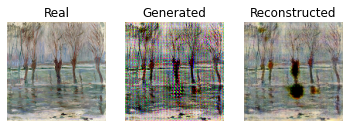

[INFO] Domain B to Domain A


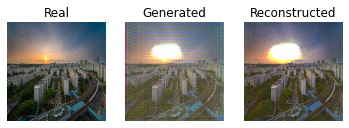

epoch: 83 step: 1 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :3.500 gBA_loss: 3.455
epoch: 83 step: 2 dA_loss: 0.013 dB_loss: 0.006 gAB_loss :3.464 gBA_loss: 3.334
epoch: 83 step: 3 dA_loss: 0.010 dB_loss: 0.008 gAB_loss :3.780 gBA_loss: 3.682
epoch: 83 step: 4 dA_loss: 0.011 dB_loss: 0.012 gAB_loss :3.483 gBA_loss: 3.560
epoch: 83 step: 5 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :3.983 gBA_loss: 4.336
epoch: 83 step: 6 dA_loss: 0.057 dB_loss: 0.033 gAB_loss :3.754 gBA_loss: 3.890
epoch: 83 step: 7 dA_loss: 0.009 dB_loss: 0.014 gAB_loss :3.777 gBA_loss: 3.741
epoch: 83 step: 8 dA_loss: 0.019 dB_loss: 0.010 gAB_loss :4.091 gBA_loss: 4.277
epoch: 83 step: 9 dA_loss: 0.011 dB_loss: 0.038 gAB_loss :4.324 gBA_loss: 4.224
epoch: 83 step: 10 dA_loss: 0.006 dB_loss: 0.009 gAB_loss :4.155 gBA_loss: 4.052
epoch: 83 step: 11 dA_loss: 0.010 dB_loss: 0.042 gAB_loss :3.666 gBA_loss: 3.566
epoch: 83 step: 12 dA_loss: 0.002 dB_loss: 0.040 gAB_loss :4.231 gBA_loss: 3.818
epoch: 83 step: 13 dA_loss: 0.017 dB_

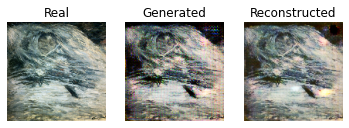

[INFO] Domain B to Domain A


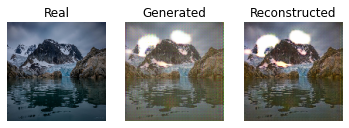

epoch: 83 step: 51 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :3.945 gBA_loss: 3.701
epoch: 83 step: 52 dA_loss: 0.001 dB_loss: 0.054 gAB_loss :3.987 gBA_loss: 3.557
epoch: 83 step: 53 dA_loss: 0.007 dB_loss: 0.015 gAB_loss :3.334 gBA_loss: 3.284
epoch: 83 step: 54 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.472 gBA_loss: 3.673
epoch: 83 step: 55 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :3.953 gBA_loss: 3.587
epoch: 83 step: 56 dA_loss: 0.004 dB_loss: 0.017 gAB_loss :3.883 gBA_loss: 3.799
epoch: 83 step: 57 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :3.690 gBA_loss: 3.433
epoch: 83 step: 58 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :4.106 gBA_loss: 3.872
epoch: 83 step: 59 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :3.518 gBA_loss: 3.459
epoch: 83 step: 60 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.630 gBA_loss: 3.552
epoch: 83 step: 61 dA_loss: 0.003 dB_loss: 0.029 gAB_loss :3.857 gBA_loss: 3.571
epoch: 83 step: 62 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.858 gBA_loss: 3.468
epoch: 83 step: 63 dA_loss: 

 84%|████████▍ | 84/100 [2:17:35<26:06, 97.89s/it]

epoch: 83 step: 73 dA_loss: 0.007 dB_loss: 0.031 gAB_loss :3.941 gBA_loss: 3.894
epoch: 84 step: 0 dA_loss: 0.012 dB_loss: 0.016 gAB_loss :4.118 gBA_loss: 3.883
[INFO] Domain A to Domain B


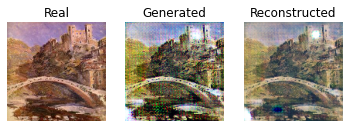

[INFO] Domain B to Domain A


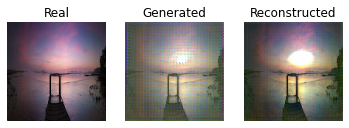

epoch: 84 step: 1 dA_loss: 0.004 dB_loss: 0.019 gAB_loss :3.469 gBA_loss: 3.654
epoch: 84 step: 2 dA_loss: 0.010 dB_loss: 0.022 gAB_loss :3.461 gBA_loss: 3.452
epoch: 84 step: 3 dA_loss: 0.002 dB_loss: 0.015 gAB_loss :3.807 gBA_loss: 3.700
epoch: 84 step: 4 dA_loss: 0.008 dB_loss: 0.018 gAB_loss :3.526 gBA_loss: 3.544
epoch: 84 step: 5 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :4.015 gBA_loss: 4.352
epoch: 84 step: 6 dA_loss: 0.006 dB_loss: 0.013 gAB_loss :3.869 gBA_loss: 4.072
epoch: 84 step: 7 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :3.838 gBA_loss: 3.885
epoch: 84 step: 8 dA_loss: 0.002 dB_loss: 0.006 gAB_loss :4.089 gBA_loss: 4.220
epoch: 84 step: 9 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :4.117 gBA_loss: 4.120
epoch: 84 step: 10 dA_loss: 0.002 dB_loss: 0.005 gAB_loss :4.027 gBA_loss: 3.980
epoch: 84 step: 11 dA_loss: 0.003 dB_loss: 0.011 gAB_loss :3.759 gBA_loss: 3.495
epoch: 84 step: 12 dA_loss: 0.003 dB_loss: 0.015 gAB_loss :4.048 gBA_loss: 3.789
epoch: 84 step: 13 dA_loss: 0.006 dB_

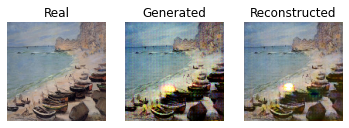

[INFO] Domain B to Domain A


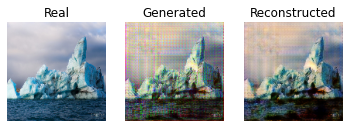

epoch: 84 step: 51 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :3.931 gBA_loss: 3.675
epoch: 84 step: 52 dA_loss: 0.001 dB_loss: 0.027 gAB_loss :3.899 gBA_loss: 3.512
epoch: 84 step: 53 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.376 gBA_loss: 3.263
epoch: 84 step: 54 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.471 gBA_loss: 3.631
epoch: 84 step: 55 dA_loss: 0.002 dB_loss: 0.030 gAB_loss :3.995 gBA_loss: 3.540
epoch: 84 step: 56 dA_loss: 0.006 dB_loss: 0.017 gAB_loss :3.810 gBA_loss: 3.773
epoch: 84 step: 57 dA_loss: 0.003 dB_loss: 0.028 gAB_loss :3.515 gBA_loss: 3.376
epoch: 84 step: 58 dA_loss: 0.002 dB_loss: 0.068 gAB_loss :4.182 gBA_loss: 3.769
epoch: 84 step: 59 dA_loss: 0.005 dB_loss: 0.020 gAB_loss :3.480 gBA_loss: 3.402
epoch: 84 step: 60 dA_loss: 0.008 dB_loss: 0.050 gAB_loss :3.565 gBA_loss: 3.540
epoch: 84 step: 61 dA_loss: 0.005 dB_loss: 0.036 gAB_loss :3.854 gBA_loss: 3.557
epoch: 84 step: 62 dA_loss: 0.001 dB_loss: 0.064 gAB_loss :3.696 gBA_loss: 3.437
epoch: 84 step: 63 dA_loss: 

 85%|████████▌ | 85/100 [2:19:12<24:28, 97.88s/it]

epoch: 84 step: 73 dA_loss: 0.001 dB_loss: 0.013 gAB_loss :3.913 gBA_loss: 3.817
epoch: 85 step: 0 dA_loss: 0.001 dB_loss: 0.031 gAB_loss :4.050 gBA_loss: 3.663
[INFO] Domain A to Domain B


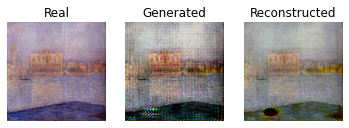

[INFO] Domain B to Domain A


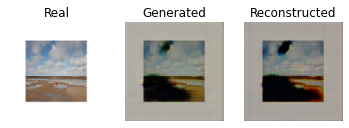

epoch: 85 step: 1 dA_loss: 0.006 dB_loss: 0.033 gAB_loss :3.574 gBA_loss: 3.446
epoch: 85 step: 2 dA_loss: 0.007 dB_loss: 0.025 gAB_loss :3.450 gBA_loss: 3.404
epoch: 85 step: 3 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.726 gBA_loss: 3.703
epoch: 85 step: 4 dA_loss: 0.004 dB_loss: 0.025 gAB_loss :3.320 gBA_loss: 3.455
epoch: 85 step: 5 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :3.970 gBA_loss: 4.296
epoch: 85 step: 6 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.801 gBA_loss: 3.929
epoch: 85 step: 7 dA_loss: 0.002 dB_loss: 0.025 gAB_loss :3.956 gBA_loss: 3.839
epoch: 85 step: 8 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :4.078 gBA_loss: 4.229
epoch: 85 step: 9 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :4.157 gBA_loss: 4.104
epoch: 85 step: 10 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :4.023 gBA_loss: 3.908
epoch: 85 step: 11 dA_loss: 0.002 dB_loss: 0.029 gAB_loss :3.651 gBA_loss: 3.440
epoch: 85 step: 12 dA_loss: 0.002 dB_loss: 0.016 gAB_loss :3.999 gBA_loss: 3.781
epoch: 85 step: 13 dA_loss: 0.003 dB_

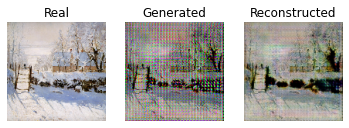

[INFO] Domain B to Domain A


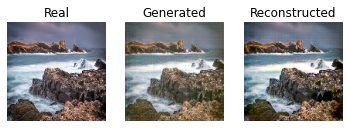

epoch: 85 step: 51 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.968 gBA_loss: 3.734
epoch: 85 step: 52 dA_loss: 0.001 dB_loss: 0.015 gAB_loss :3.859 gBA_loss: 3.572
epoch: 85 step: 53 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.343 gBA_loss: 3.286
epoch: 85 step: 54 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.532 gBA_loss: 3.649
epoch: 85 step: 55 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :3.961 gBA_loss: 3.628
epoch: 85 step: 56 dA_loss: 0.002 dB_loss: 0.015 gAB_loss :3.922 gBA_loss: 3.796
epoch: 85 step: 57 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.709 gBA_loss: 3.427
epoch: 85 step: 58 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :4.015 gBA_loss: 3.779
epoch: 85 step: 59 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.489 gBA_loss: 3.358
epoch: 85 step: 60 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.672 gBA_loss: 3.525
epoch: 85 step: 61 dA_loss: 0.002 dB_loss: 0.034 gAB_loss :3.867 gBA_loss: 3.544
epoch: 85 step: 62 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.844 gBA_loss: 3.466
epoch: 85 step: 63 dA_loss: 

 86%|████████▌ | 86/100 [2:20:50<22:50, 97.89s/it]

epoch: 85 step: 73 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.956 gBA_loss: 3.859
epoch: 86 step: 0 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :4.125 gBA_loss: 3.704
[INFO] Domain A to Domain B


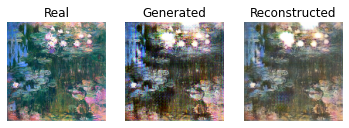

[INFO] Domain B to Domain A


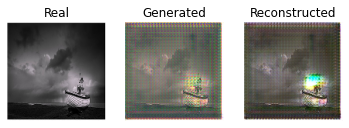

epoch: 86 step: 1 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.481 gBA_loss: 3.494
epoch: 86 step: 2 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :3.535 gBA_loss: 3.372
epoch: 86 step: 3 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.798 gBA_loss: 3.702
epoch: 86 step: 4 dA_loss: 0.008 dB_loss: 0.022 gAB_loss :3.472 gBA_loss: 3.501
epoch: 86 step: 5 dA_loss: 0.004 dB_loss: 0.005 gAB_loss :3.964 gBA_loss: 4.280
epoch: 86 step: 6 dA_loss: 0.011 dB_loss: 0.020 gAB_loss :3.715 gBA_loss: 3.912
epoch: 86 step: 7 dA_loss: 0.002 dB_loss: 0.022 gAB_loss :3.867 gBA_loss: 3.857
epoch: 86 step: 8 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :4.004 gBA_loss: 4.245
epoch: 86 step: 9 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :4.096 gBA_loss: 4.174
epoch: 86 step: 10 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :4.108 gBA_loss: 4.052
epoch: 86 step: 11 dA_loss: 0.003 dB_loss: 0.011 gAB_loss :3.848 gBA_loss: 3.547
epoch: 86 step: 12 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :4.113 gBA_loss: 3.830
epoch: 86 step: 13 dA_loss: 0.002 dB_

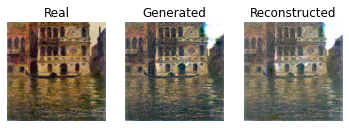

[INFO] Domain B to Domain A


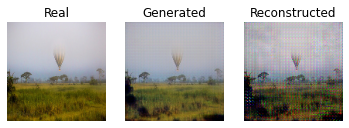

epoch: 86 step: 51 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.915 gBA_loss: 3.717
epoch: 86 step: 52 dA_loss: 0.001 dB_loss: 0.020 gAB_loss :3.962 gBA_loss: 3.594
epoch: 86 step: 53 dA_loss: 0.002 dB_loss: 0.015 gAB_loss :3.464 gBA_loss: 3.401
epoch: 86 step: 54 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.458 gBA_loss: 3.745
epoch: 86 step: 55 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :4.022 gBA_loss: 3.751
epoch: 86 step: 56 dA_loss: 0.003 dB_loss: 0.013 gAB_loss :3.808 gBA_loss: 3.894
epoch: 86 step: 57 dA_loss: 0.002 dB_loss: 0.017 gAB_loss :3.732 gBA_loss: 3.514
epoch: 86 step: 58 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.970 gBA_loss: 3.873
epoch: 86 step: 59 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :3.444 gBA_loss: 3.524
epoch: 86 step: 60 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :3.776 gBA_loss: 3.560
epoch: 86 step: 61 dA_loss: 0.002 dB_loss: 0.021 gAB_loss :3.966 gBA_loss: 3.614
epoch: 86 step: 62 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.901 gBA_loss: 3.488
epoch: 86 step: 63 dA_loss: 

 87%|████████▋ | 87/100 [2:22:28<21:12, 97.89s/it]

epoch: 86 step: 73 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :3.824 gBA_loss: 3.815
epoch: 87 step: 0 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :4.017 gBA_loss: 3.665
[INFO] Domain A to Domain B


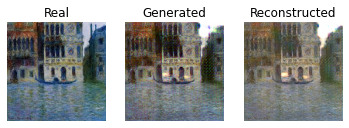

[INFO] Domain B to Domain A


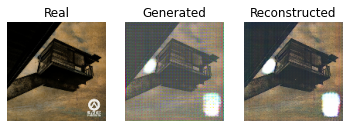

epoch: 87 step: 1 dA_loss: 0.001 dB_loss: 0.011 gAB_loss :3.466 gBA_loss: 3.547
epoch: 87 step: 2 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.488 gBA_loss: 3.362
epoch: 87 step: 3 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.726 gBA_loss: 3.764
epoch: 87 step: 4 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.590 gBA_loss: 3.644
epoch: 87 step: 5 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :4.032 gBA_loss: 4.442
epoch: 87 step: 6 dA_loss: 0.002 dB_loss: 0.005 gAB_loss :3.882 gBA_loss: 4.054
epoch: 87 step: 7 dA_loss: 0.002 dB_loss: 0.005 gAB_loss :3.931 gBA_loss: 3.957
epoch: 87 step: 8 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :4.037 gBA_loss: 4.205
epoch: 87 step: 9 dA_loss: 0.003 dB_loss: 0.004 gAB_loss :4.069 gBA_loss: 4.082
epoch: 87 step: 10 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :3.980 gBA_loss: 3.953
epoch: 87 step: 11 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.659 gBA_loss: 3.456
epoch: 87 step: 12 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :4.051 gBA_loss: 3.802
epoch: 87 step: 13 dA_loss: 0.002 dB_

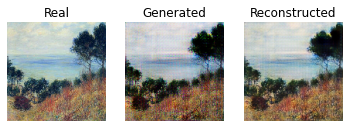

[INFO] Domain B to Domain A


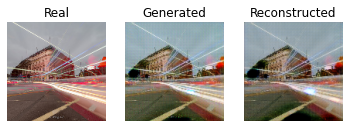

epoch: 87 step: 51 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.867 gBA_loss: 3.679
epoch: 87 step: 52 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :4.007 gBA_loss: 3.542
epoch: 87 step: 53 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.408 gBA_loss: 3.271
epoch: 87 step: 54 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :3.381 gBA_loss: 3.652
epoch: 87 step: 55 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :3.959 gBA_loss: 3.557
epoch: 87 step: 56 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.766 gBA_loss: 3.789
epoch: 87 step: 57 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.689 gBA_loss: 3.436
epoch: 87 step: 58 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :4.021 gBA_loss: 3.795
epoch: 87 step: 59 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.483 gBA_loss: 3.314
epoch: 87 step: 60 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.631 gBA_loss: 3.488
epoch: 87 step: 61 dA_loss: 0.002 dB_loss: 0.022 gAB_loss :3.812 gBA_loss: 3.480
epoch: 87 step: 62 dA_loss: 0.001 dB_loss: 0.024 gAB_loss :3.658 gBA_loss: 3.398
epoch: 87 step: 63 dA_loss: 

 88%|████████▊ | 88/100 [2:24:06<19:34, 97.89s/it]

epoch: 87 step: 73 dA_loss: 0.001 dB_loss: 0.032 gAB_loss :3.884 gBA_loss: 3.781
epoch: 88 step: 0 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :4.023 gBA_loss: 3.638
[INFO] Domain A to Domain B


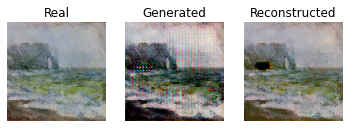

[INFO] Domain B to Domain A


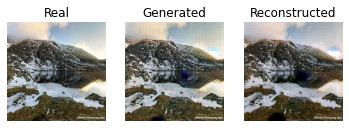

epoch: 88 step: 1 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.453 gBA_loss: 3.424
epoch: 88 step: 2 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.362 gBA_loss: 3.323
epoch: 88 step: 3 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.718 gBA_loss: 3.666
epoch: 88 step: 4 dA_loss: 0.002 dB_loss: 0.017 gAB_loss :3.453 gBA_loss: 3.412
epoch: 88 step: 5 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.947 gBA_loss: 4.231
epoch: 88 step: 6 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.697 gBA_loss: 3.877
epoch: 88 step: 7 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :3.674 gBA_loss: 3.763
epoch: 88 step: 8 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.923 gBA_loss: 4.092
epoch: 88 step: 9 dA_loss: 0.001 dB_loss: 0.045 gAB_loss :4.061 gBA_loss: 3.995
epoch: 88 step: 10 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.976 gBA_loss: 3.854
epoch: 88 step: 11 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.659 gBA_loss: 3.375
epoch: 88 step: 12 dA_loss: 0.001 dB_loss: 0.034 gAB_loss :3.907 gBA_loss: 3.698
epoch: 88 step: 13 dA_loss: 0.001 dB_

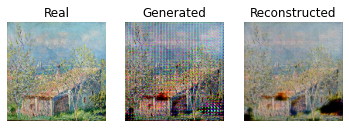

[INFO] Domain B to Domain A


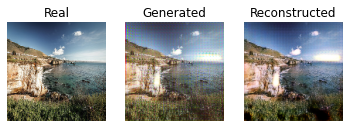

epoch: 88 step: 51 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.848 gBA_loss: 3.586
epoch: 88 step: 52 dA_loss: 0.001 dB_loss: 0.047 gAB_loss :3.685 gBA_loss: 3.485
epoch: 88 step: 53 dA_loss: 0.001 dB_loss: 0.029 gAB_loss :3.302 gBA_loss: 3.243
epoch: 88 step: 54 dA_loss: 0.001 dB_loss: 0.024 gAB_loss :3.513 gBA_loss: 3.599
epoch: 88 step: 55 dA_loss: 0.001 dB_loss: 0.032 gAB_loss :3.869 gBA_loss: 3.522
epoch: 88 step: 56 dA_loss: 0.011 dB_loss: 0.040 gAB_loss :3.804 gBA_loss: 3.686
epoch: 88 step: 57 dA_loss: 0.004 dB_loss: 0.023 gAB_loss :3.588 gBA_loss: 3.308
epoch: 88 step: 58 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :4.022 gBA_loss: 3.704
epoch: 88 step: 59 dA_loss: 0.002 dB_loss: 0.024 gAB_loss :3.498 gBA_loss: 3.358
epoch: 88 step: 60 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.597 gBA_loss: 3.469
epoch: 88 step: 61 dA_loss: 0.006 dB_loss: 0.037 gAB_loss :3.788 gBA_loss: 3.488
epoch: 88 step: 62 dA_loss: 0.002 dB_loss: 0.046 gAB_loss :3.617 gBA_loss: 3.485
epoch: 88 step: 63 dA_loss: 

 89%|████████▉ | 89/100 [2:25:44<17:56, 97.87s/it]

epoch: 88 step: 73 dA_loss: 0.001 dB_loss: 0.033 gAB_loss :3.925 gBA_loss: 3.727
epoch: 89 step: 0 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :4.059 gBA_loss: 3.576
[INFO] Domain A to Domain B


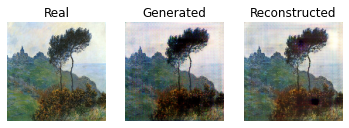

[INFO] Domain B to Domain A


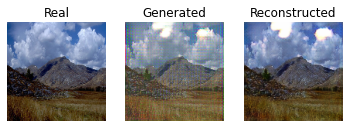

epoch: 89 step: 1 dA_loss: 0.001 dB_loss: 0.021 gAB_loss :3.471 gBA_loss: 3.389
epoch: 89 step: 2 dA_loss: 0.003 dB_loss: 0.024 gAB_loss :3.298 gBA_loss: 3.247
epoch: 89 step: 3 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.642 gBA_loss: 3.614
epoch: 89 step: 4 dA_loss: 0.002 dB_loss: 0.057 gAB_loss :3.473 gBA_loss: 3.348
epoch: 89 step: 5 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.922 gBA_loss: 4.141
epoch: 89 step: 6 dA_loss: 0.002 dB_loss: 0.038 gAB_loss :3.631 gBA_loss: 3.797
epoch: 89 step: 7 dA_loss: 0.001 dB_loss: 0.029 gAB_loss :3.596 gBA_loss: 3.710
epoch: 89 step: 8 dA_loss: 0.001 dB_loss: 0.034 gAB_loss :3.824 gBA_loss: 4.045
epoch: 89 step: 9 dA_loss: 0.001 dB_loss: 0.042 gAB_loss :4.059 gBA_loss: 3.966
epoch: 89 step: 10 dA_loss: 0.003 dB_loss: 0.022 gAB_loss :4.034 gBA_loss: 3.836
epoch: 89 step: 11 dA_loss: 0.001 dB_loss: 0.039 gAB_loss :3.576 gBA_loss: 3.394
epoch: 89 step: 12 dA_loss: 0.001 dB_loss: 0.033 gAB_loss :4.036 gBA_loss: 3.679
epoch: 89 step: 13 dA_loss: 0.001 dB_

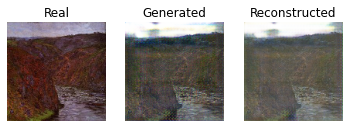

[INFO] Domain B to Domain A


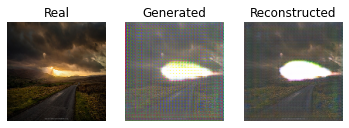

epoch: 89 step: 51 dA_loss: 0.009 dB_loss: 0.013 gAB_loss :3.805 gBA_loss: 3.506
epoch: 89 step: 52 dA_loss: 0.030 dB_loss: 0.042 gAB_loss :3.914 gBA_loss: 3.517
epoch: 89 step: 53 dA_loss: 0.027 dB_loss: 0.027 gAB_loss :3.255 gBA_loss: 3.153
epoch: 89 step: 54 dA_loss: 0.047 dB_loss: 0.015 gAB_loss :3.354 gBA_loss: 3.518
epoch: 89 step: 55 dA_loss: 0.011 dB_loss: 0.060 gAB_loss :4.093 gBA_loss: 3.521
epoch: 89 step: 56 dA_loss: 0.024 dB_loss: 0.029 gAB_loss :3.749 gBA_loss: 3.796
epoch: 89 step: 57 dA_loss: 0.022 dB_loss: 0.052 gAB_loss :3.335 gBA_loss: 3.335
epoch: 89 step: 58 dA_loss: 0.003 dB_loss: 0.114 gAB_loss :4.025 gBA_loss: 3.660
epoch: 89 step: 59 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :3.450 gBA_loss: 3.221
epoch: 89 step: 60 dA_loss: 0.037 dB_loss: 0.026 gAB_loss :3.477 gBA_loss: 3.478
epoch: 89 step: 61 dA_loss: 0.016 dB_loss: 0.027 gAB_loss :3.683 gBA_loss: 3.443
epoch: 89 step: 62 dA_loss: 0.008 dB_loss: 0.021 gAB_loss :3.637 gBA_loss: 3.362
epoch: 89 step: 63 dA_loss: 

 90%|█████████ | 90/100 [2:27:22<16:18, 97.87s/it]

epoch: 89 step: 73 dA_loss: 0.005 dB_loss: 0.022 gAB_loss :3.751 gBA_loss: 3.753
epoch: 90 step: 0 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.910 gBA_loss: 3.555
[INFO] Domain A to Domain B


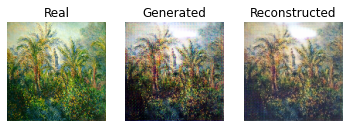

[INFO] Domain B to Domain A


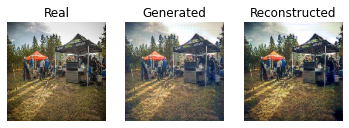

epoch: 90 step: 1 dA_loss: 0.016 dB_loss: 0.026 gAB_loss :3.486 gBA_loss: 3.461
epoch: 90 step: 2 dA_loss: 0.014 dB_loss: 0.015 gAB_loss :3.405 gBA_loss: 3.303
epoch: 90 step: 3 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :3.637 gBA_loss: 3.531
epoch: 90 step: 4 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :3.279 gBA_loss: 3.322
epoch: 90 step: 5 dA_loss: 0.016 dB_loss: 0.004 gAB_loss :3.827 gBA_loss: 4.132
epoch: 90 step: 6 dA_loss: 0.009 dB_loss: 0.006 gAB_loss :3.640 gBA_loss: 3.757
epoch: 90 step: 7 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :3.803 gBA_loss: 3.813
epoch: 90 step: 8 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :3.957 gBA_loss: 4.147
epoch: 90 step: 9 dA_loss: 0.015 dB_loss: 0.011 gAB_loss :4.025 gBA_loss: 4.008
epoch: 90 step: 10 dA_loss: 0.020 dB_loss: 0.004 gAB_loss :3.917 gBA_loss: 3.913
epoch: 90 step: 11 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :3.603 gBA_loss: 3.448
epoch: 90 step: 12 dA_loss: 0.010 dB_loss: 0.035 gAB_loss :4.050 gBA_loss: 3.726
epoch: 90 step: 13 dA_loss: 0.005 dB_

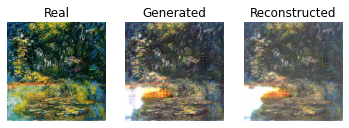

[INFO] Domain B to Domain A


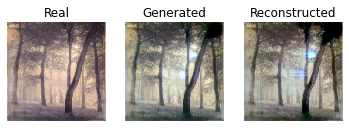

epoch: 90 step: 51 dA_loss: 0.006 dB_loss: 0.018 gAB_loss :3.818 gBA_loss: 3.532
epoch: 90 step: 52 dA_loss: 0.014 dB_loss: 0.052 gAB_loss :3.746 gBA_loss: 3.525
epoch: 90 step: 53 dA_loss: 0.018 dB_loss: 0.016 gAB_loss :3.197 gBA_loss: 3.337
epoch: 90 step: 54 dA_loss: 0.035 dB_loss: 0.079 gAB_loss :3.525 gBA_loss: 3.583
epoch: 90 step: 55 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.955 gBA_loss: 3.512
epoch: 90 step: 56 dA_loss: 0.033 dB_loss: 0.018 gAB_loss :3.687 gBA_loss: 3.539
epoch: 90 step: 57 dA_loss: 0.033 dB_loss: 0.041 gAB_loss :3.387 gBA_loss: 3.407
epoch: 90 step: 58 dA_loss: 0.012 dB_loss: 0.032 gAB_loss :3.872 gBA_loss: 3.772
epoch: 90 step: 59 dA_loss: 0.037 dB_loss: 0.022 gAB_loss :3.484 gBA_loss: 3.145
epoch: 90 step: 60 dA_loss: 0.011 dB_loss: 0.030 gAB_loss :3.649 gBA_loss: 3.371
epoch: 90 step: 61 dA_loss: 0.034 dB_loss: 0.047 gAB_loss :3.711 gBA_loss: 3.496
epoch: 90 step: 62 dA_loss: 0.005 dB_loss: 0.035 gAB_loss :3.554 gBA_loss: 3.400
epoch: 90 step: 63 dA_loss: 

 91%|█████████ | 91/100 [2:29:00<14:40, 97.87s/it]

epoch: 90 step: 73 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.762 gBA_loss: 3.874
epoch: 91 step: 0 dA_loss: 0.004 dB_loss: 0.038 gAB_loss :3.972 gBA_loss: 3.580
[INFO] Domain A to Domain B


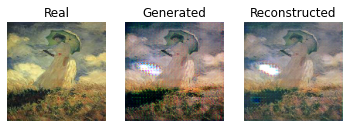

[INFO] Domain B to Domain A


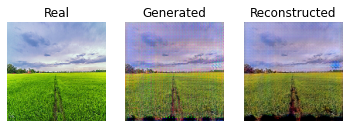

epoch: 91 step: 1 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.469 gBA_loss: 3.437
epoch: 91 step: 2 dA_loss: 0.008 dB_loss: 0.014 gAB_loss :3.376 gBA_loss: 3.277
epoch: 91 step: 3 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :3.691 gBA_loss: 3.590
epoch: 91 step: 4 dA_loss: 0.006 dB_loss: 0.018 gAB_loss :3.382 gBA_loss: 3.364
epoch: 91 step: 5 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :3.871 gBA_loss: 4.176
epoch: 91 step: 6 dA_loss: 0.019 dB_loss: 0.013 gAB_loss :3.688 gBA_loss: 3.759
epoch: 91 step: 7 dA_loss: 0.011 dB_loss: 0.027 gAB_loss :3.685 gBA_loss: 3.681
epoch: 91 step: 8 dA_loss: 0.004 dB_loss: 0.006 gAB_loss :3.841 gBA_loss: 3.989
epoch: 91 step: 9 dA_loss: 0.035 dB_loss: 0.010 gAB_loss :3.929 gBA_loss: 4.135
epoch: 91 step: 10 dA_loss: 0.020 dB_loss: 0.005 gAB_loss :3.903 gBA_loss: 3.860
epoch: 91 step: 11 dA_loss: 0.005 dB_loss: 0.024 gAB_loss :3.693 gBA_loss: 3.345
epoch: 91 step: 12 dA_loss: 0.003 dB_loss: 0.034 gAB_loss :3.897 gBA_loss: 3.633
epoch: 91 step: 13 dA_loss: 0.015 dB_

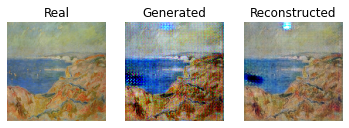

[INFO] Domain B to Domain A


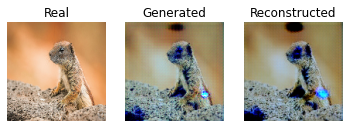

epoch: 91 step: 51 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :3.862 gBA_loss: 3.596
epoch: 91 step: 52 dA_loss: 0.006 dB_loss: 0.028 gAB_loss :3.775 gBA_loss: 3.436
epoch: 91 step: 53 dA_loss: 0.017 dB_loss: 0.010 gAB_loss :3.304 gBA_loss: 3.131
epoch: 91 step: 54 dA_loss: 0.009 dB_loss: 0.010 gAB_loss :3.368 gBA_loss: 3.649
epoch: 91 step: 55 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :3.926 gBA_loss: 3.544
epoch: 91 step: 56 dA_loss: 0.009 dB_loss: 0.012 gAB_loss :3.796 gBA_loss: 3.653
epoch: 91 step: 57 dA_loss: 0.029 dB_loss: 0.015 gAB_loss :3.554 gBA_loss: 3.378
epoch: 91 step: 58 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.845 gBA_loss: 3.681
epoch: 91 step: 59 dA_loss: 0.005 dB_loss: 0.011 gAB_loss :3.379 gBA_loss: 3.291
epoch: 91 step: 60 dA_loss: 0.069 dB_loss: 0.032 gAB_loss :3.637 gBA_loss: 3.293
epoch: 91 step: 61 dA_loss: 0.015 dB_loss: 0.025 gAB_loss :3.858 gBA_loss: 3.247
epoch: 91 step: 62 dA_loss: 0.024 dB_loss: 0.074 gAB_loss :3.556 gBA_loss: 3.437
epoch: 91 step: 63 dA_loss: 

 92%|█████████▏| 92/100 [2:30:38<13:02, 97.87s/it]

epoch: 91 step: 73 dA_loss: 0.013 dB_loss: 0.013 gAB_loss :3.707 gBA_loss: 3.666
epoch: 92 step: 0 dA_loss: 0.004 dB_loss: 0.013 gAB_loss :3.941 gBA_loss: 3.481
[INFO] Domain A to Domain B


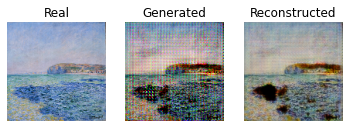

[INFO] Domain B to Domain A


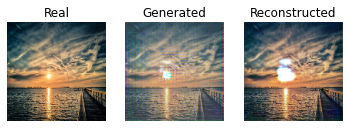

epoch: 92 step: 1 dA_loss: 0.006 dB_loss: 0.032 gAB_loss :3.466 gBA_loss: 3.417
epoch: 92 step: 2 dA_loss: 0.022 dB_loss: 0.021 gAB_loss :3.333 gBA_loss: 3.309
epoch: 92 step: 3 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :3.667 gBA_loss: 3.629
epoch: 92 step: 4 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :3.319 gBA_loss: 3.346
epoch: 92 step: 5 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.799 gBA_loss: 4.103
epoch: 92 step: 6 dA_loss: 0.014 dB_loss: 0.011 gAB_loss :3.622 gBA_loss: 3.803
epoch: 92 step: 7 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :3.657 gBA_loss: 3.710
epoch: 92 step: 8 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.852 gBA_loss: 4.011
epoch: 92 step: 9 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :3.891 gBA_loss: 3.917
epoch: 92 step: 10 dA_loss: 0.009 dB_loss: 0.005 gAB_loss :3.885 gBA_loss: 3.826
epoch: 92 step: 11 dA_loss: 0.003 dB_loss: 0.015 gAB_loss :3.605 gBA_loss: 3.437
epoch: 92 step: 12 dA_loss: 0.003 dB_loss: 0.041 gAB_loss :4.166 gBA_loss: 3.766
epoch: 92 step: 13 dA_loss: 0.005 dB_

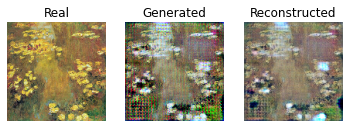

[INFO] Domain B to Domain A


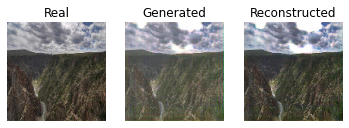

epoch: 92 step: 51 dA_loss: 0.006 dB_loss: 0.013 gAB_loss :3.829 gBA_loss: 3.538
epoch: 92 step: 52 dA_loss: 0.007 dB_loss: 0.025 gAB_loss :3.868 gBA_loss: 3.457
epoch: 92 step: 53 dA_loss: 0.014 dB_loss: 0.012 gAB_loss :3.239 gBA_loss: 3.227
epoch: 92 step: 54 dA_loss: 0.004 dB_loss: 0.027 gAB_loss :3.194 gBA_loss: 3.613
epoch: 92 step: 55 dA_loss: 0.005 dB_loss: 0.105 gAB_loss :4.062 gBA_loss: 3.595
epoch: 92 step: 56 dA_loss: 0.025 dB_loss: 0.013 gAB_loss :3.734 gBA_loss: 3.690
epoch: 92 step: 57 dA_loss: 0.005 dB_loss: 0.053 gAB_loss :3.414 gBA_loss: 3.341
epoch: 92 step: 58 dA_loss: 0.003 dB_loss: 0.034 gAB_loss :3.783 gBA_loss: 3.681
epoch: 92 step: 59 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.390 gBA_loss: 3.212
epoch: 92 step: 60 dA_loss: 0.008 dB_loss: 0.040 gAB_loss :3.652 gBA_loss: 3.413
epoch: 92 step: 61 dA_loss: 0.005 dB_loss: 0.024 gAB_loss :3.745 gBA_loss: 3.401
epoch: 92 step: 62 dA_loss: 0.003 dB_loss: 0.054 gAB_loss :3.574 gBA_loss: 3.356
epoch: 92 step: 63 dA_loss: 

 93%|█████████▎| 93/100 [2:32:16<11:26, 98.12s/it]

epoch: 92 step: 73 dA_loss: 0.005 dB_loss: 0.021 gAB_loss :3.746 gBA_loss: 3.614
epoch: 93 step: 0 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :3.871 gBA_loss: 3.517
[INFO] Domain A to Domain B


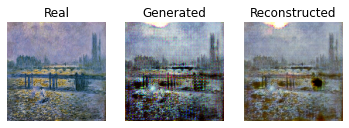

[INFO] Domain B to Domain A


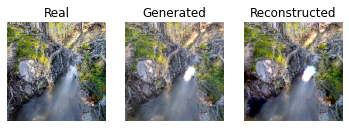

epoch: 93 step: 1 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.366 gBA_loss: 3.304
epoch: 93 step: 2 dA_loss: 0.014 dB_loss: 0.019 gAB_loss :3.263 gBA_loss: 3.234
epoch: 93 step: 3 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.635 gBA_loss: 3.568
epoch: 93 step: 4 dA_loss: 0.023 dB_loss: 0.012 gAB_loss :3.347 gBA_loss: 3.445
epoch: 93 step: 5 dA_loss: 0.012 dB_loss: 0.004 gAB_loss :3.827 gBA_loss: 4.138
epoch: 93 step: 6 dA_loss: 0.052 dB_loss: 0.011 gAB_loss :3.588 gBA_loss: 3.536
epoch: 93 step: 7 dA_loss: 0.018 dB_loss: 0.007 gAB_loss :3.702 gBA_loss: 3.607
epoch: 93 step: 8 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.826 gBA_loss: 3.978
epoch: 93 step: 9 dA_loss: 0.012 dB_loss: 0.014 gAB_loss :3.898 gBA_loss: 3.922
epoch: 93 step: 10 dA_loss: 0.005 dB_loss: 0.005 gAB_loss :3.866 gBA_loss: 3.802
epoch: 93 step: 11 dA_loss: 0.016 dB_loss: 0.015 gAB_loss :3.578 gBA_loss: 3.412
epoch: 93 step: 12 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.917 gBA_loss: 3.711
epoch: 93 step: 13 dA_loss: 0.005 dB_

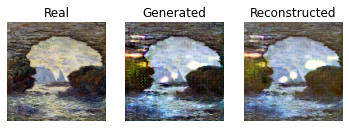

[INFO] Domain B to Domain A


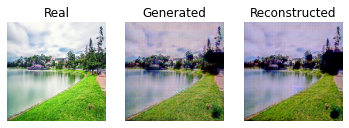

epoch: 93 step: 51 dA_loss: 0.017 dB_loss: 0.009 gAB_loss :3.791 gBA_loss: 3.595
epoch: 93 step: 52 dA_loss: 0.038 dB_loss: 0.013 gAB_loss :3.891 gBA_loss: 3.354
epoch: 93 step: 53 dA_loss: 0.021 dB_loss: 0.024 gAB_loss :3.238 gBA_loss: 3.179
epoch: 93 step: 54 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :3.325 gBA_loss: 3.569
epoch: 93 step: 55 dA_loss: 0.009 dB_loss: 0.008 gAB_loss :3.823 gBA_loss: 3.579
epoch: 93 step: 56 dA_loss: 0.026 dB_loss: 0.037 gAB_loss :3.737 gBA_loss: 3.652
epoch: 93 step: 57 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :3.614 gBA_loss: 3.358
epoch: 93 step: 58 dA_loss: 0.009 dB_loss: 0.037 gAB_loss :3.852 gBA_loss: 3.728
epoch: 93 step: 59 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :3.297 gBA_loss: 3.322
epoch: 93 step: 60 dA_loss: 0.020 dB_loss: 0.014 gAB_loss :3.426 gBA_loss: 3.348
epoch: 93 step: 61 dA_loss: 0.014 dB_loss: 0.070 gAB_loss :3.857 gBA_loss: 3.356
epoch: 93 step: 62 dA_loss: 0.003 dB_loss: 0.017 gAB_loss :3.788 gBA_loss: 3.354
epoch: 93 step: 63 dA_loss: 

 94%|█████████▍| 94/100 [2:33:55<09:49, 98.17s/it]

epoch: 93 step: 73 dA_loss: 0.013 dB_loss: 0.070 gAB_loss :3.763 gBA_loss: 3.573
epoch: 94 step: 0 dA_loss: 0.007 dB_loss: 0.029 gAB_loss :3.936 gBA_loss: 3.429
[INFO] Domain A to Domain B


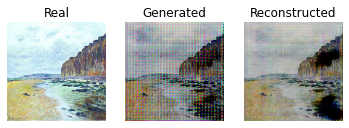

[INFO] Domain B to Domain A


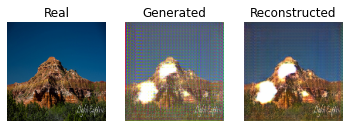

epoch: 94 step: 1 dA_loss: 0.009 dB_loss: 0.071 gAB_loss :2.984 gBA_loss: 3.351
epoch: 94 step: 2 dA_loss: 0.008 dB_loss: 0.169 gAB_loss :3.547 gBA_loss: 3.265
epoch: 94 step: 3 dA_loss: 0.004 dB_loss: 0.034 gAB_loss :3.755 gBA_loss: 3.564
epoch: 94 step: 4 dA_loss: 0.008 dB_loss: 0.094 gAB_loss :3.128 gBA_loss: 3.443
epoch: 94 step: 5 dA_loss: 0.004 dB_loss: 0.037 gAB_loss :3.769 gBA_loss: 4.152
epoch: 94 step: 6 dA_loss: 0.017 dB_loss: 0.023 gAB_loss :3.606 gBA_loss: 3.850
epoch: 94 step: 7 dA_loss: 0.033 dB_loss: 0.039 gAB_loss :3.756 gBA_loss: 3.647
epoch: 94 step: 8 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :3.918 gBA_loss: 3.872
epoch: 94 step: 9 dA_loss: 0.054 dB_loss: 0.023 gAB_loss :3.896 gBA_loss: 4.075
epoch: 94 step: 10 dA_loss: 0.088 dB_loss: 0.014 gAB_loss :3.910 gBA_loss: 3.810
epoch: 94 step: 11 dA_loss: 0.014 dB_loss: 0.037 gAB_loss :3.566 gBA_loss: 3.293
epoch: 94 step: 12 dA_loss: 0.034 dB_loss: 0.033 gAB_loss :3.922 gBA_loss: 3.637
epoch: 94 step: 13 dA_loss: 0.018 dB_

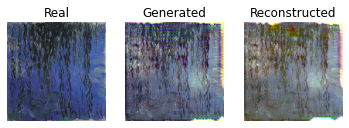

[INFO] Domain B to Domain A


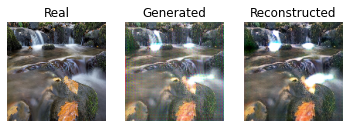

epoch: 94 step: 51 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.781 gBA_loss: 3.582
epoch: 94 step: 52 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :3.786 gBA_loss: 3.395
epoch: 94 step: 53 dA_loss: 0.014 dB_loss: 0.012 gAB_loss :3.231 gBA_loss: 3.171
epoch: 94 step: 54 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :3.362 gBA_loss: 3.473
epoch: 94 step: 55 dA_loss: 0.003 dB_loss: 0.025 gAB_loss :3.867 gBA_loss: 3.445
epoch: 94 step: 56 dA_loss: 0.010 dB_loss: 0.015 gAB_loss :3.677 gBA_loss: 3.780
epoch: 94 step: 57 dA_loss: 0.004 dB_loss: 0.020 gAB_loss :3.561 gBA_loss: 3.385
epoch: 94 step: 58 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :3.848 gBA_loss: 3.672
epoch: 94 step: 59 dA_loss: 0.004 dB_loss: 0.026 gAB_loss :3.434 gBA_loss: 3.223
epoch: 94 step: 60 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.562 gBA_loss: 3.455
epoch: 94 step: 61 dA_loss: 0.013 dB_loss: 0.025 gAB_loss :3.727 gBA_loss: 3.383
epoch: 94 step: 62 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.663 gBA_loss: 3.337
epoch: 94 step: 63 dA_loss: 

 95%|█████████▌| 95/100 [2:35:33<08:10, 98.18s/it]

epoch: 94 step: 73 dA_loss: 0.002 dB_loss: 0.024 gAB_loss :3.707 gBA_loss: 3.669
epoch: 95 step: 0 dA_loss: 0.002 dB_loss: 0.009 gAB_loss :3.767 gBA_loss: 3.462
[INFO] Domain A to Domain B


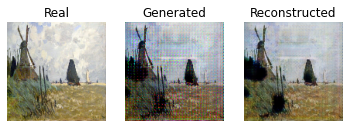

[INFO] Domain B to Domain A


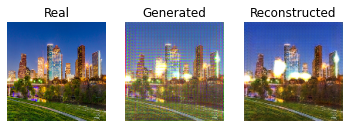

epoch: 95 step: 1 dA_loss: 0.002 dB_loss: 0.032 gAB_loss :3.489 gBA_loss: 3.318
epoch: 95 step: 2 dA_loss: 0.008 dB_loss: 0.075 gAB_loss :3.153 gBA_loss: 3.199
epoch: 95 step: 3 dA_loss: 0.002 dB_loss: 0.033 gAB_loss :3.532 gBA_loss: 3.500
epoch: 95 step: 4 dA_loss: 0.005 dB_loss: 0.095 gAB_loss :3.419 gBA_loss: 3.344
epoch: 95 step: 5 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.845 gBA_loss: 4.039
epoch: 95 step: 6 dA_loss: 0.004 dB_loss: 0.080 gAB_loss :3.488 gBA_loss: 3.727
epoch: 95 step: 7 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.529 gBA_loss: 3.661
epoch: 95 step: 8 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :3.729 gBA_loss: 3.991
epoch: 95 step: 9 dA_loss: 0.019 dB_loss: 0.022 gAB_loss :3.910 gBA_loss: 3.855
epoch: 95 step: 10 dA_loss: 0.012 dB_loss: 0.047 gAB_loss :3.914 gBA_loss: 3.712
epoch: 95 step: 11 dA_loss: 0.005 dB_loss: 0.035 gAB_loss :3.516 gBA_loss: 3.300
epoch: 95 step: 12 dA_loss: 0.005 dB_loss: 0.026 gAB_loss :3.921 gBA_loss: 3.642
epoch: 95 step: 13 dA_loss: 0.004 dB_

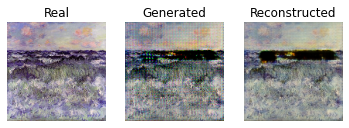

[INFO] Domain B to Domain A


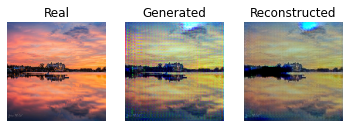

epoch: 95 step: 51 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.802 gBA_loss: 3.451
epoch: 95 step: 52 dA_loss: 0.002 dB_loss: 0.046 gAB_loss :3.646 gBA_loss: 3.379
epoch: 95 step: 53 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.146 gBA_loss: 3.155
epoch: 95 step: 54 dA_loss: 0.002 dB_loss: 0.016 gAB_loss :3.281 gBA_loss: 3.454
epoch: 95 step: 55 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :3.875 gBA_loss: 3.445
epoch: 95 step: 56 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :3.717 gBA_loss: 3.595
epoch: 95 step: 57 dA_loss: 0.003 dB_loss: 0.018 gAB_loss :3.462 gBA_loss: 3.257
epoch: 95 step: 58 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.759 gBA_loss: 3.558
epoch: 95 step: 59 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.291 gBA_loss: 3.139
epoch: 95 step: 60 dA_loss: 0.005 dB_loss: 0.004 gAB_loss :3.436 gBA_loss: 3.333
epoch: 95 step: 61 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.669 gBA_loss: 3.375
epoch: 95 step: 62 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :3.681 gBA_loss: 3.299
epoch: 95 step: 63 dA_loss: 

 96%|█████████▌| 96/100 [2:37:11<06:32, 98.21s/it]

epoch: 95 step: 73 dA_loss: 0.001 dB_loss: 0.013 gAB_loss :3.726 gBA_loss: 3.673
epoch: 96 step: 0 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :3.858 gBA_loss: 3.484
[INFO] Domain A to Domain B


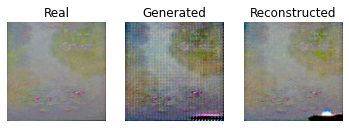

[INFO] Domain B to Domain A


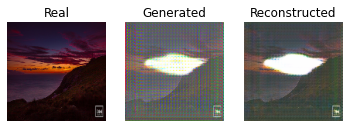

epoch: 96 step: 1 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :3.342 gBA_loss: 3.289
epoch: 96 step: 2 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.307 gBA_loss: 3.160
epoch: 96 step: 3 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.572 gBA_loss: 3.521
epoch: 96 step: 4 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :3.278 gBA_loss: 3.321
epoch: 96 step: 5 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.728 gBA_loss: 4.025
epoch: 96 step: 6 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.591 gBA_loss: 3.714
epoch: 96 step: 7 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :3.691 gBA_loss: 3.703
epoch: 96 step: 8 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.836 gBA_loss: 3.975
epoch: 96 step: 9 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.888 gBA_loss: 3.925
epoch: 96 step: 10 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :3.845 gBA_loss: 3.779
epoch: 96 step: 11 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.594 gBA_loss: 3.293
epoch: 96 step: 12 dA_loss: 0.001 dB_loss: 0.021 gAB_loss :3.904 gBA_loss: 3.661
epoch: 96 step: 13 dA_loss: 0.003 dB_

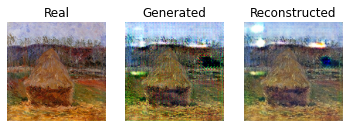

[INFO] Domain B to Domain A


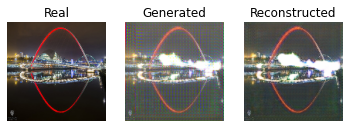

epoch: 96 step: 51 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.637 gBA_loss: 3.442
epoch: 96 step: 52 dA_loss: 0.001 dB_loss: 0.042 gAB_loss :3.900 gBA_loss: 3.354
epoch: 96 step: 53 dA_loss: 0.002 dB_loss: 0.078 gAB_loss :3.106 gBA_loss: 3.116
epoch: 96 step: 54 dA_loss: 0.001 dB_loss: 0.035 gAB_loss :3.083 gBA_loss: 3.466
epoch: 96 step: 55 dA_loss: 0.001 dB_loss: 0.126 gAB_loss :4.044 gBA_loss: 3.460
epoch: 96 step: 56 dA_loss: 0.002 dB_loss: 0.017 gAB_loss :3.650 gBA_loss: 3.635
epoch: 96 step: 57 dA_loss: 0.001 dB_loss: 0.172 gAB_loss :3.258 gBA_loss: 3.309
epoch: 96 step: 58 dA_loss: 0.001 dB_loss: 0.048 gAB_loss :3.642 gBA_loss: 3.616
epoch: 96 step: 59 dA_loss: 0.002 dB_loss: 0.028 gAB_loss :3.388 gBA_loss: 3.202
epoch: 96 step: 60 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.508 gBA_loss: 3.357
epoch: 96 step: 61 dA_loss: 0.002 dB_loss: 0.016 gAB_loss :3.713 gBA_loss: 3.330
epoch: 96 step: 62 dA_loss: 0.001 dB_loss: 0.025 gAB_loss :3.637 gBA_loss: 3.268
epoch: 96 step: 63 dA_loss: 

 97%|█████████▋| 97/100 [2:38:49<04:54, 98.22s/it]

epoch: 96 step: 73 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :3.686 gBA_loss: 3.624
epoch: 97 step: 0 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.831 gBA_loss: 3.424
[INFO] Domain A to Domain B


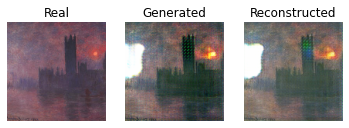

[INFO] Domain B to Domain A


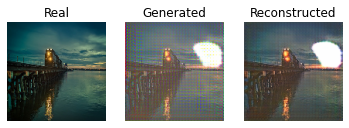

epoch: 97 step: 1 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :3.361 gBA_loss: 3.232
epoch: 97 step: 2 dA_loss: 0.004 dB_loss: 0.021 gAB_loss :3.192 gBA_loss: 3.135
epoch: 97 step: 3 dA_loss: 0.002 dB_loss: 0.006 gAB_loss :3.466 gBA_loss: 3.459
epoch: 97 step: 4 dA_loss: 0.002 dB_loss: 0.037 gAB_loss :3.279 gBA_loss: 3.272
epoch: 97 step: 5 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.792 gBA_loss: 4.038
epoch: 97 step: 6 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :3.578 gBA_loss: 3.712
epoch: 97 step: 7 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.639 gBA_loss: 3.648
epoch: 97 step: 8 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :3.742 gBA_loss: 3.913
epoch: 97 step: 9 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.811 gBA_loss: 3.812
epoch: 97 step: 10 dA_loss: 0.001 dB_loss: 0.023 gAB_loss :3.816 gBA_loss: 3.706
epoch: 97 step: 11 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.576 gBA_loss: 3.280
epoch: 97 step: 12 dA_loss: 0.001 dB_loss: 0.032 gAB_loss :3.823 gBA_loss: 3.548
epoch: 97 step: 13 dA_loss: 0.002 dB_

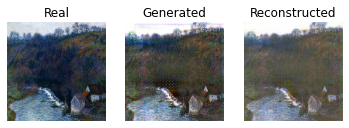

[INFO] Domain B to Domain A


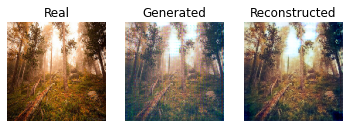

epoch: 97 step: 51 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.664 gBA_loss: 3.422
epoch: 97 step: 52 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :3.706 gBA_loss: 3.305
epoch: 97 step: 53 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :3.209 gBA_loss: 3.119
epoch: 97 step: 54 dA_loss: 0.001 dB_loss: 0.019 gAB_loss :3.251 gBA_loss: 3.428
epoch: 97 step: 55 dA_loss: 0.001 dB_loss: 0.020 gAB_loss :3.716 gBA_loss: 3.417
epoch: 97 step: 56 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :3.641 gBA_loss: 3.593
epoch: 97 step: 57 dA_loss: 0.001 dB_loss: 0.049 gAB_loss :3.562 gBA_loss: 3.206
epoch: 97 step: 58 dA_loss: 0.001 dB_loss: 0.038 gAB_loss :3.815 gBA_loss: 3.567
epoch: 97 step: 59 dA_loss: 0.001 dB_loss: 0.020 gAB_loss :3.303 gBA_loss: 3.238
epoch: 97 step: 60 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.417 gBA_loss: 3.358
epoch: 97 step: 61 dA_loss: 0.002 dB_loss: 0.027 gAB_loss :3.709 gBA_loss: 3.329
epoch: 97 step: 62 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.741 gBA_loss: 3.310
epoch: 97 step: 63 dA_loss: 

 98%|█████████▊| 98/100 [2:40:28<03:16, 98.23s/it]

epoch: 97 step: 73 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.714 gBA_loss: 3.636
epoch: 98 step: 0 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.762 gBA_loss: 3.475
[INFO] Domain A to Domain B


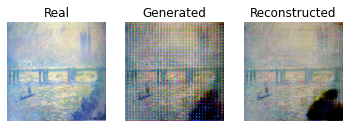

[INFO] Domain B to Domain A


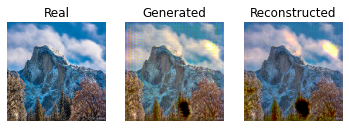

epoch: 98 step: 1 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.388 gBA_loss: 3.307
epoch: 98 step: 2 dA_loss: 0.004 dB_loss: 0.005 gAB_loss :3.306 gBA_loss: 3.149
epoch: 98 step: 3 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.563 gBA_loss: 3.472
epoch: 98 step: 4 dA_loss: 0.002 dB_loss: 0.005 gAB_loss :3.218 gBA_loss: 3.262
epoch: 98 step: 5 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :3.710 gBA_loss: 4.013
epoch: 98 step: 6 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.563 gBA_loss: 3.672
epoch: 98 step: 7 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.662 gBA_loss: 3.585
epoch: 98 step: 8 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.803 gBA_loss: 3.898
epoch: 98 step: 9 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.826 gBA_loss: 3.802
epoch: 98 step: 10 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :3.762 gBA_loss: 3.693
epoch: 98 step: 11 dA_loss: 0.001 dB_loss: 0.011 gAB_loss :3.515 gBA_loss: 3.221
epoch: 98 step: 12 dA_loss: 0.001 dB_loss: 0.015 gAB_loss :3.953 gBA_loss: 3.534
epoch: 98 step: 13 dA_loss: 0.001 dB_

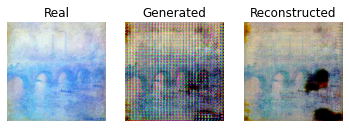

[INFO] Domain B to Domain A


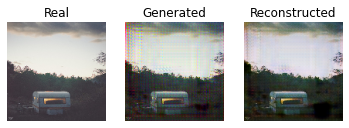

epoch: 98 step: 51 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.652 gBA_loss: 3.447
epoch: 98 step: 52 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.693 gBA_loss: 3.331
epoch: 98 step: 53 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.189 gBA_loss: 3.062
epoch: 98 step: 54 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.288 gBA_loss: 3.440
epoch: 98 step: 55 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :3.702 gBA_loss: 3.365
epoch: 98 step: 56 dA_loss: 0.002 dB_loss: 0.006 gAB_loss :3.520 gBA_loss: 3.555
epoch: 98 step: 57 dA_loss: 0.001 dB_loss: 0.023 gAB_loss :3.461 gBA_loss: 3.223
epoch: 98 step: 58 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.830 gBA_loss: 3.502
epoch: 98 step: 59 dA_loss: 0.001 dB_loss: 0.015 gAB_loss :3.308 gBA_loss: 3.090
epoch: 98 step: 60 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.450 gBA_loss: 3.284
epoch: 98 step: 61 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :3.608 gBA_loss: 3.314
epoch: 98 step: 62 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.588 gBA_loss: 3.235
epoch: 98 step: 63 dA_loss: 

 99%|█████████▉| 99/100 [2:42:06<01:38, 98.24s/it]

epoch: 98 step: 73 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :3.627 gBA_loss: 3.547
epoch: 99 step: 0 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.702 gBA_loss: 3.440
[INFO] Domain A to Domain B


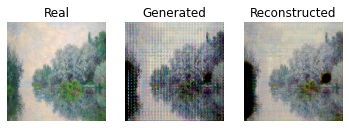

[INFO] Domain B to Domain A


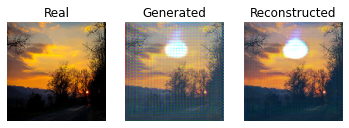

epoch: 99 step: 1 dA_loss: 0.001 dB_loss: 0.011 gAB_loss :3.295 gBA_loss: 3.242
epoch: 99 step: 2 dA_loss: 0.001 dB_loss: 0.011 gAB_loss :3.248 gBA_loss: 3.157
epoch: 99 step: 3 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.564 gBA_loss: 3.468
epoch: 99 step: 4 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :3.225 gBA_loss: 3.295
epoch: 99 step: 5 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :3.738 gBA_loss: 4.023
epoch: 99 step: 6 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :3.537 gBA_loss: 3.677
epoch: 99 step: 7 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.686 gBA_loss: 3.603
epoch: 99 step: 8 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :3.785 gBA_loss: 3.905
epoch: 99 step: 9 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :3.854 gBA_loss: 3.828
epoch: 99 step: 10 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.812 gBA_loss: 3.711
epoch: 99 step: 11 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.517 gBA_loss: 3.228
epoch: 99 step: 12 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.859 gBA_loss: 3.593
epoch: 99 step: 13 dA_loss: 0.002 dB_

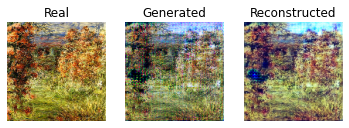

[INFO] Domain B to Domain A


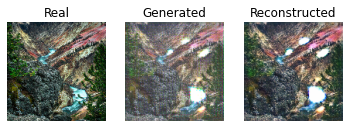

epoch: 99 step: 51 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.649 gBA_loss: 3.379
epoch: 99 step: 52 dA_loss: 0.001 dB_loss: 0.026 gAB_loss :3.617 gBA_loss: 3.307
epoch: 99 step: 53 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :3.111 gBA_loss: 3.092
epoch: 99 step: 54 dA_loss: 0.001 dB_loss: 0.010 gAB_loss :3.264 gBA_loss: 3.438
epoch: 99 step: 55 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.726 gBA_loss: 3.482
epoch: 99 step: 56 dA_loss: 0.002 dB_loss: 0.005 gAB_loss :3.529 gBA_loss: 3.520
epoch: 99 step: 57 dA_loss: 0.001 dB_loss: 0.009 gAB_loss :3.418 gBA_loss: 3.207
epoch: 99 step: 58 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :3.746 gBA_loss: 3.513
epoch: 99 step: 59 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.252 gBA_loss: 3.120
epoch: 99 step: 60 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :3.403 gBA_loss: 3.282
epoch: 99 step: 61 dA_loss: 0.001 dB_loss: 0.012 gAB_loss :3.644 gBA_loss: 3.272
epoch: 99 step: 62 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :3.614 gBA_loss: 3.229
epoch: 99 step: 63 dA_loss: 

100%|██████████| 100/100 [2:43:44<00:00, 98.25s/it]

epoch: 99 step: 73 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :3.554 gBA_loss: 3.521


In [26]:
# training loop
for epoch in tqdm(range(epochs)):
    # reset the iterators after each epoch
    iter_A = iter(data_A_TF)
    iter_B = iter(data_B_TF)
    # iterate through the steps per epoch
    for step in range(steps_per_epoch):
        # get the images
        images_A = iter_A.next()
        images_B = iter_B.next()

        # train the discriminator A
        dA_loss = train_discriminator_A(d_model_A, g_model_BtoA, images_B, images_A, d_model_A_opt)
        disc_A_metric(dA_loss)

        # train the discriminator B
        dB_loss = train_discriminator_B(d_model_B, g_model_AtoB, images_A, images_B, d_model_B_opt)
        disc_B_metric(dB_loss)

        # train generator AB
        gen_AB_loss = train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, images_A, images_B, g_AtoB_opt)
        gen_AB_metric(gen_AB_loss)

        # train generator BA
        gen_BA_loss = train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, images_B, images_A, g_BtoA_opt)
        gen_BA_metric(gen_BA_loss)

        # logging
        print(f"epoch: {epoch} step: {step} dA_loss: {disc_A_metric.result():.3f} dB_loss: {disc_B_metric.result():.3f} "
            f"gAB_loss :{gen_AB_metric.result():.3f} gBA_loss: {gen_BA_metric.result():.3f}")

        # visualization
        if step % visualize_every == 0:
            show_model_progress(g_model_AtoB, g_model_BtoA, scaled_dataA, scaled_dataB)

        # reset metrics
        disc_A_metric.reset_states()
        disc_B_metric.reset_states()
        gen_AB_metric.reset_states()
        gen_BA_metric.reset_states()